# Auswertung Mapps 632nm


## Pakete

In [115]:
#import Pakete
#plotten:
import matplotlib as mlp
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

#rechnen:
import numpy as np

#fitten:
import scipy 
from scipy.optimize import curve_fit
from scipy import sparse
from scipy.sparse.linalg import spsolve
from scipy.signal import argrelextrema
import scipy.special as sp
#import scipy.constants as sp # für grundlegende Konstanten --> https://docs.scipy.org/doc/scipy/reference/constants.html
#--> eher selbst machen 

#paket für automatische invertierung Funktion --> sehr nützlich
#from pynverse import inversefunc

#dateneinlesen einfach
import pylab as py 

import IPython
from IPython import get_ipython
get_ipython().run_line_magic('matplotlib', 'inline')

import os  

## Funktionsdefinitionen

In [116]:
#definition Fitfunktionen
def Lorentz(x,a,d,w):
#c Konstante, a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable
# y = a/(1+ ((x-w) / (d/2) )**2)
    return  a/(1+ ((x-w) / (d/2) )**2)

def Lorentz_und_Konstante(x,a,d,w,h):
#c Konstante, a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
    return  a/(1+ ((x-w) / (d/2) )**2) + h

def gaussian(x, a, c, b):
    # a Amplitude, b Position, c Breite
    return a*np.exp(-np.power(x - b, 2)/(2*np.power(c, 2)))

def asymmgauss(x,amp,fwhm, pos, shape):
    #scew normal distribution
    normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
    normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
    return 2*normpdf*normcdf

def asymmgauss_und_Konstante(x,amp,fwhm, pos, shape, h):
    #scew normal distribution
    normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
    normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
    return 2*normpdf*normcdf + h

def L_x2(x,a,d,w,aa,dd,ww):#two lorentz-functions
#c Konstante, a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable
# y = a/(1+ ((x-w) / (d/2) )**2)
    return  a/(1+ ((x-w) / (d/2) )**2) + aa/(1+ ((x-ww) / (dd/2) )**2)

def L_x3(x,A1,D1,W1, A2,D2,W2, A3,D3,W3):
    # 3 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3)

def L_x3_AG(x,A1,D1,W1, A2,D2,W2, A3,D3,W3,amp,fwhm, pos, shape):
    # 3 Lorentzpeaks + Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + asymmgauss(x,amp,fwhm, pos, shape)

def L_x3_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 3 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)


def L_x4(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4):
    # 4 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4)

def L_x4_AG(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4,amp,fwhm, pos, shape):
    # 4 Lorentzpeaks+ Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4)+ asymmgauss(x,amp,fwhm, pos, shape)

def L_x4_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 4 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)


def L_x5(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5):
    # 5 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5)


def L_x6(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6):
    # 6 Lorentzpeaks
    return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + Lorentz(x,A6,D6,W6)


def L_x9_AG_x1(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape):
    # 9 Lorentzpeaks + 1 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1)+ Lorentz(x,A2,D2,W2)+ Lorentz(x,A3,D3,W3)+ Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5)+ Lorentz(x,A6,D6,W6)+ Lorentz(x,A7,D7,W7)+ Lorentz(x,A8,D8,W8) + Lorentz(x,A9,D9,W9) + asymmgauss(x,amp,fwhm, pos, shape)

def L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
    # 9 Lorentzpeaks + 2 Asymmetrischer gauß
    return Lorentz(x,A1,D1,W1)+ Lorentz(x,A2,D2,W2)+ Lorentz(x,A3,D3,W3)+ Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5)+ Lorentz(x,A6,D6,W6)+ Lorentz(x,A7,D7,W7)+ Lorentz(x,A8,D8,W8) + Lorentz(x,A9,D9,W9) + asymmgauss(x,amp,fwhm, pos, shape)+ asymmgauss(x,amp2,fwhm2, pos2, shape2)



def GLL(x, ga, gb, gw, La, Ld, Lw, L2a, L2d, L2w):
    # 1x Gauß + 2x lorentz
    return ga*np.exp(-np.power(x - gw, 2)/(2*np.power(gb, 2))) + La/(1+ ((x-Lw) / (Ld/2) )**2) + L2a/(1+ ((x-L2w) / (L2d/2) )**2)

def Polynom_5_Grad(x,a,b,c,d,e,f):
    return a*x**5 + b*x**4 + c*x**3 + d*x**2 + e*x + f

def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

def Druck_in_Probe(w_s, w_0, w_per_P):
    #aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
    #rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
    return (w_s - w_0) / w_per_P

## Pfad

In [117]:
#Path zu daten definieren
path = "./Daten_632nm//"  

# Kalibrierung an Saphir Substrat

### Datenladen MEPA

In [118]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "MEPA_Mapping_632nm_Bild1_D0_2x60s.txt") as f1:
        data_MEPA_D0_632nm_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MEPA_D0_632nm_array_str = np.array(data_MEPA_D0_632nm_txt)               #in np array umwandeln um listen von listen zu entkommen
data_MEPA_D0_632nm_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MEPA_D0_632nm_array_float = data_MEPA_D0_632nm_array_str.astype(float)   #str zu float in Arrayform
print(data_MEPA_D0_632nm_array_float)

[[  0.      657.95062 657.64545 ... 335.83398 335.50693 335.17987]
 [ 17.        2.79744   2.75989 ...   2.18202   2.15973   2.1436 ]
 [ 17.1       2.84758   2.83164 ...   2.28173   2.25379   2.23776]
 ...
 [ 24.8       2.43827   2.47195 ...   1.89107   1.87885   1.84319]
 [ 24.9       2.31535   2.34903 ...   1.84663   1.86093   1.8862 ]
 [ 25.        2.35247   2.35548 ...   1.89189   1.90353   1.91347]]


Position: 17.0
x-Daten: [657.95062 657.64545 657.34167 ... 335.83398 335.50693 335.17987]
y-Daten: [2.79744 2.75989 2.72886 ... 2.18202 2.15973 2.1436 ]
Hintergrund Parameter:  [ 6.33681320e-12 -1.58432725e-08  1.55530297e-05 -7.50934867e-03
  1.79094513e+00 -1.67045023e+02]
Fitparameter Saphir 378: [0.22561159209229378, 6.678025090922458, 381.1461118709664]
Fitparameter Saphir 418: [3.778645735559666, 1.739634111908943, 419.74081260379614]
Fitparameter Saphir 432: [0.0001581400998832383, 0.00021911213295518488, 459.92424506767213]
Fitparameter Saphir 451: [0.43674418941997867, 9.999999999997472, 452.8686371245049]
Fitparameter InN E2: [0.5923491364214961, 8.081802225174863, 492.92390121974285]
Fitparameter Saphir 578: [0.3169431491893225, 3.0753939941912485, 579.5682698682364]
Fitparameter InN LO: [1.3785316176035511, 15.798038242758407, 596.4515477193387]
Fitparameter Saphir 645: [0.00024157278292682606, 0.00020780923795312372, 635.5446297453173]
Fitparameter Saphir 751: [0.001096547

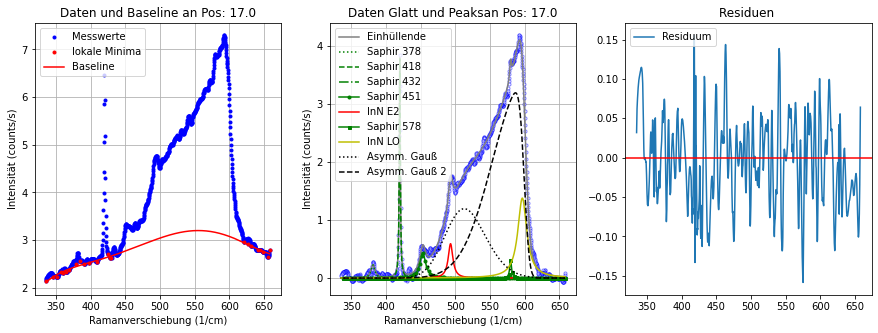

In [119]:
# Punkt/Position der messung
position = data_MEPA_D0_632nm_array_float[1][0]
print("Position:", position) 

#daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
x=np.delete(data_MEPA_D0_632nm_array_float[0],[0])
y=np.delete(data_MEPA_D0_632nm_array_float[1],[0])
print("x-Daten:", x)
#print(x.shape)
print("y-Daten:", y)
#print(y.shape)
        
# lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
yzw=y[argrelextrema(y, np.less,order=3)[0]]
xzw=x[argrelextrema(y, np.less,order=3)[0]]
#print(yzw)
#print(xzw)
        
#minima an problematischen stellen nicht mitnehmen
xmin=[]
ymin=[]
xmin.append(x[0])
ymin.append(y[0]) 
for j in range(len(xzw)):
    if xzw[j]<=430 or xzw[j]>=620:
        xmin.append(xzw[j])
        ymin.append(yzw[j])
xmin.append(x[len(x)-1])
ymin.append(y[len(y)-1]) 
#print(ymin)
#print(xmin)
        
# Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
print("Hintergrund Parameter: ", fitParams_base)
# Hintergrund von Messdaten entfernen --> glatt
y_glatt=y-ybase
#print(y)
#print(ybase)
#print(y_glatt)
        
#fitten 4 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 498, saphir_578, InN LO 595, saphir_645, saphir_751,
#+ 2Asymmetrischer Gauß
#L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
# 9 Lorentzpeaks + 2 Asymmetrischer gauß
init_vals_L_x9_AG_x2 = [1,1,378, 1,1,424, 1,1,440, 1,1,448, 1,1,498, 1,1,580, 1,1,595, 1,1,645, 1,1,751, 1,40,500,6, 1,40,600,-6]
param_bounds_L_x9_AG_x2= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,490, 0,0,565, 0,0,585, 0,0,635, 0,0,735, 0,0,470,0, 0,0,0,-30],
                          [np.inf,np.inf,390, np.inf,np.inf,430, np.inf,np.inf,460, np.inf,10,470, np.inf,np.inf,510, np.inf,10,590, np.inf,np.inf,610, np.inf,np.inf,655, np.inf,np.inf,760, np.inf,np.inf,525,np.inf, np.inf,np.inf,610,np.inf])
fitParams_L_x9_AG_x2, cov_L_x9_AG_x2 = curve_fit(f=L_x9_AG_x2, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x2, bounds=param_bounds_L_x9_AG_x2)
fitParams_L_Saphir_378=[fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2]]
fitParams_L_Saphir_418=[fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5]]
fitParams_L_Saphir_432=[fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8]]
fitParams_L_Saphir_451=[fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11]]
fitParams_L_InN_E2=[fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14]]
fitParams_L_Saphir_578=[fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17]]
fitParams_L_InN_LO=[fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20]]
fitParams_L_Saphir_645=[fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23]]
fitParams_L_Saphir_751=[fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26]]
fitParams_AG_1=[fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30]]
fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
print("Fitparameter InN E2:",fitParams_L_InN_E2)
print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
print("Fitparameter InN LO:",fitParams_L_InN_LO)
print("Fitparameter Saphir 645:",fitParams_L_Saphir_645)
print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
        
        
        
# plotten
fig = plt.figure(figsize=(15,5))
# Plot 1 für Daten roh und baseline
plt.subplot(1, 3, 1) 
plt.title('Daten und Baseline an Pos: '+str(position))
plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
plt.plot(x, ybase,'r', label='Baseline') 
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot für Daten glatt und peaks
plt.subplot(1, 3, 2)
plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
plt.plot(x,L_x9_AG_x2(x, fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2],fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5],fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8],fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11],fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14],fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17],fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20],fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23],fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26],fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30],fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]), color='gray'  ,markersize=2, label='Einhüllende')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
#plt.plot(x,Lorentz(x, fitParams_L_Saphir_645[0],fitParams_L_Saphir_645[1],fitParams_L_Saphir_645[2]),'-d', markevery=8, color='g'  ,markersize=3, label='Saphir 645')
#plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot Residuen Fitt
plt.subplot(1, 3, 3)
plt.title('Residuen ')
plt.plot(x,y_glatt-L_x9_AG_x2(x, fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2],fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5],fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8],fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11],fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14],fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17],fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20],fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23],fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26],fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30],fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]), label=("Residuum"))
plt.axhline(y = 0, color = 'r', linestyle = '-')
#plt.grid(True)
plt.legend(loc='upper left')
plt.savefig('Bilder_Graphen_632nm/Kalibration MEPA Amplituden Saphir Peaks nach Positionen D0 632nm')

plt.show()

In [120]:
#nutzen Peaks 418, 451, 751 da die besten ersichtlichen Peaks und am besten zu fitten
ExpWerte=[fitParams_L_Saphir_418[2],fitParams_L_Saphir_451[2]] 
Literatur=[418, 451]
Abweichung=[]
print(ExpWerte)
print(Literatur)

for i in range(len(ExpWerte)):
    Abweichung.append(ExpWerte[i]-Literatur[i])

print(Abweichung)
Mittlere_Abweichung=np.mean(Abweichung)
print(Mittlere_Abweichung)

[419.74081260379614, 452.8686371245049]
[418, 451]
[1.7408126037961438, 1.8686371245049145]
1.8047248641505291


### Datenladen A-Plane

### Datenladen

In [121]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "Aplane_Mapping_632nm_Bild1_D0_2x60s.txt") as f1:
        data_aPlane_632nm_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_aPlane_632nm_array_str = np.array(data_aPlane_632nm_txt)               #in np array umwandeln um listen von listen zu entkommen
data_aPlane_632nm_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_aPlane_632nm_array_float = data_aPlane_632nm_array_str.astype(float)   #str zu float in Arrayform
print(data_aPlane_632nm_array_float)

[[  0.       657.95062  657.64545  ... 335.83398  335.50693  335.17987 ]
 [  5.         1.81865    1.77631  ...   1.86689    1.86772    1.86995 ]
 [  5.1        1.95712    1.93513  ...   1.88961    1.92196    1.94331 ]
 ...
 [  9.8        1.11544    1.11662  ...   0.984776   0.983955   0.982876]
 [  9.9        1.04426    0.981504 ...   0.991127   0.99449    1.00013 ]
 [ 10.         0.928635   0.935192 ...   1.00008    0.992045   0.969083]]


## Kalibrierung an Saphir Substrat
dafür nutzung Einzelmessung aus Mapp, eine der tiefsten als Allg betrachtung

Position: 5.0
x-Daten: [657.95062 657.64545 657.34167 ... 335.83398 335.50693 335.17987]
y-Daten: [1.81865 1.77631 1.78719 ... 1.86689 1.86772 1.86995]
Hintergrund Parameter:  [-4.53200896e-12  1.15123107e-08 -1.15624127e-05  5.72127654e-03
 -1.38996655e+00  1.34241414e+02]
Fitparameter Saphir 378: [1.0993986950583379, 2.268644190544628, 380.89750036788143]
Fitparameter Saphir 418: [4.514216900108728, 1.6480175188318948, 419.35381074089014]
Fitparameter Saphir 432: [0.13927487794216234, 0.06605153072736941, 459.8191449467046]
Fitparameter Saphir 451: [0.2798776690397265, 4.2215670047728695, 450.3210335144373]
Fitparameter InN E2: [1.0197080613195233, 5.7007327851936775, 493.3135246768706]
Fitparameter Saphir 578: [0.07483519380887589, 2.3220293849843805, 579.0786559543409]
Fitparameter InN LO: [2.9069163112045033, 13.832465151104829, 599.2124347559883]
Fitparameter Saphir 645: [1.6593731902625524e-06, 2.2745441988875237e-07, 654.9744523100095]
Fitparameter Saphir 751: [5.48229560002998

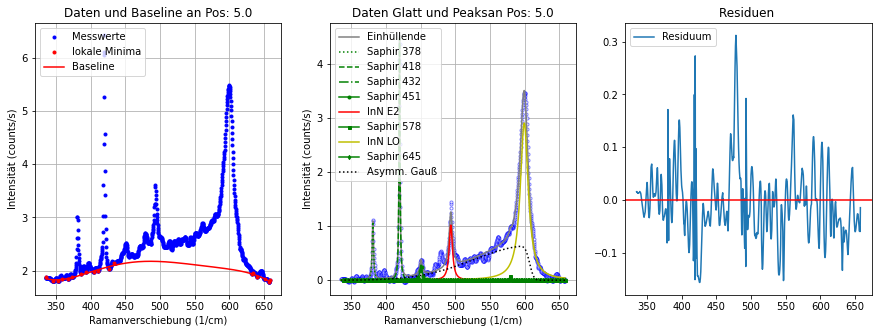

In [122]:
# Punkt/Position der messung
position = data_aPlane_632nm_array_float[1][0]
print("Position:", position) 

#daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
x=np.delete(data_aPlane_632nm_array_float[0],[0])
y=np.delete(data_aPlane_632nm_array_float[1],[0])
print("x-Daten:", x)
#print(x.shape)
print("y-Daten:", y)
#print(y.shape)
        
# lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
yzw=y[argrelextrema(y, np.less,order=5)[0]]
xzw=x[argrelextrema(y, np.less,order=5)[0]]
#print(yzw)
#print(xzw)
        
#minima an problematischen stellen nicht mitnehmen
xmin=[]
ymin=[]
xmin.append(x[0])
ymin.append(y[0]) 
for j in range(len(xzw)):
    if xzw[j]<=440 or xzw[j]>=620:
        xmin.append(xzw[j])
        ymin.append(yzw[j])
xmin.append(x[len(x)-1])
ymin.append(y[len(y)-1]) 
#print(ymin)
#print(xmin)
        
# Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
print("Hintergrund Parameter: ", fitParams_base)
# Hintergrund von Messdaten entfernen --> glatt
y_glatt=y-ybase
#print(y)
#print(ybase)
#print(y_glatt)
        
#fitten 4 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 498, saphir_578, InN LO 595, saphir_645, saphir_751,
#+ 2Asymmetrischer Gauß
#L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
# 9 Lorentzpeaks + 2 Asymmetrischer gauß
init_vals_L_x9_AG_x1 = [1,1,378, 1,1,418, 1,1,432, 1,1,451, 1,1,498, 1,1,580, 1,1,595, 1,1,650, 1,1,751, 1,70,600,0.00001]
param_bounds_L_x9_AG_x1= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,490, 0,0,565, 0,0,585, 0,0,635, 0,0,735, 0,50,500,-np.inf],
                          [np.inf,np.inf,395, np.inf,np.inf,430, np.inf,np.inf,460, np.inf,10,470, np.inf,np.inf,510, np.inf,10,590, np.inf,np.inf,610, np.inf,np.inf,655, np.inf,np.inf,760, 2,np.inf,610,np.inf])
fitParams_L_x9_AG_x1, cov_L_x9_AG_x1 = curve_fit(f=L_x9_AG_x1, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x1, bounds=param_bounds_L_x9_AG_x1)
fitParams_L_Saphir_378=[fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2]]
fitParams_L_Saphir_418=[fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5]]
fitParams_L_Saphir_432=[fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8]]
fitParams_L_Saphir_451=[fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11]]
fitParams_L_InN_E2=[fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14]]
fitParams_L_Saphir_578=[fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17]]
fitParams_L_InN_LO=[fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20]]
fitParams_L_Saphir_645=[fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23]]
fitParams_L_Saphir_751=[fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26]]
fitParams_AG_1=[fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]]
#fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
print("Fitparameter InN E2:",fitParams_L_InN_E2)
print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
print("Fitparameter InN LO:",fitParams_L_InN_LO)
print("Fitparameter Saphir 645:",fitParams_L_Saphir_645)
print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
#print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
        
        
        
# plotten
fig = plt.figure(figsize=(15,5))
# Plot 1 für Daten roh und baseline
plt.subplot(1, 3, 1) 
plt.title('Daten und Baseline an Pos: '+str(position))
plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
plt.plot(x, ybase,'r', label='Baseline') 
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot für Daten glatt und peaks
plt.subplot(1, 3, 2)
plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
plt.plot(x,L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), color='gray'  ,markersize=2, label='Einhüllende')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
plt.plot(x,Lorentz(x, fitParams_L_Saphir_645[0],fitParams_L_Saphir_645[1],fitParams_L_Saphir_645[2]),'-d', markevery=8, color='g'  ,markersize=3, label='Saphir 645')
#plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
#plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
plt.xlabel('Ramanverschiebung (1/cm)')
plt.ylabel('Intensität (counts/s)')
plt.grid(True)
plt.legend(loc='upper left')
# Plot Residuen Fitt
plt.subplot(1, 3, 3)
plt.title('Residuen ')
plt.plot(x,y_glatt-L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), label=("Residuum"))
plt.axhline(y = 0, color = 'r', linestyle = '-')
#plt.grid(True)
plt.legend(loc='upper left')
plt.savefig('Bilder_Graphen_632nm/Kalibration A-Plane Amplituden Saphir Peaks nach Positionen D0 632nm')

plt.show()

In [123]:
#nutzen Peaks 418, 451, 751 da die besten ersichtlichen Peaks und am besten zu fitten
ExpWerte=[fitParams_L_Saphir_418[2]] 
Literatur=[418]
Abweichung=[]
print(ExpWerte)
print(Literatur)

for i in range(len(ExpWerte)):
    Abweichung.append(ExpWerte[i]-Literatur[i])

print(Abweichung)
Mittlere_Abweichung=np.mean(Abweichung)
print(Mittlere_Abweichung)

[419.35381074089014]
[418]
[1.3538107408901396]
1.3538107408901396


In [124]:
Verschiebung_A_plane=1.3538107408901396
Verschiebung_MEPA=1.8047248641505291

## Messung MEPA D0 

Probenoberfläche vor Messung
<img src="Daten_632nm/MEPA_Mapping_632nm_Bild1.jpg" style="width:300px;"/>

### Datenladen

In [125]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "MEPA_Mapping_632nm_Bild1_D0_2x60s.txt") as f1:
        data_MEPA_D0_632nm_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MEPA_D0_632nm_array_str = np.array(data_MEPA_D0_632nm_txt)               #in np array umwandeln um listen von listen zu entkommen
data_MEPA_D0_632nm_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MEPA_D0_632nm_array_float = data_MEPA_D0_632nm_array_str.astype(float)   #str zu float in Arrayform
print(data_MEPA_D0_632nm_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_MEPA_D0_632nm_array_float[0])):
    data_MEPA_D0_632nm_array_float[0][k]=data_MEPA_D0_632nm_array_float[0][k]-Verschiebung_MEPA
print(data_MEPA_D0_632nm_array_float)

[[  0.      657.95062 657.64545 ... 335.83398 335.50693 335.17987]
 [ 17.        2.79744   2.75989 ...   2.18202   2.15973   2.1436 ]
 [ 17.1       2.84758   2.83164 ...   2.28173   2.25379   2.23776]
 ...
 [ 24.8       2.43827   2.47195 ...   1.89107   1.87885   1.84319]
 [ 24.9       2.31535   2.34903 ...   1.84663   1.86093   1.8862 ]
 [ 25.        2.35247   2.35548 ...   1.89189   1.90353   1.91347]]
[[ -1.80472486 656.14589514 655.84072514 ... 334.02925514 333.70220514
  333.37514514]
 [ 17.           2.79744      2.75989    ...   2.18202      2.15973
    2.1436    ]
 [ 17.1          2.84758      2.83164    ...   2.28173      2.25379
    2.23776   ]
 ...
 [ 24.8          2.43827      2.47195    ...   1.89107      1.87885
    1.84319   ]
 [ 24.9          2.31535      2.34903    ...   1.84663      1.86093
    1.8862    ]
 [ 25.           2.35247      2.35548    ...   1.89189      1.90353
    1.91347   ]]


### Fitten und Plotten

Position: 17.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.79744 2.75989 2.72886 ... 2.18202 2.15973 2.1436 ]
Hintergrund Parameter:  [ 4.54281539e-12 -1.15326016e-08  1.14971422e-05 -5.64064058e-03
  1.36846066e+00 -1.29444600e+02]
Fitparameter Saphir 378: [0.2265893728571861, 6.285682112366471, 379.3616121417494]
Fitparameter Saphir 418: [3.7821758169369297, 1.755726211463093, 417.9361974315861]
Fitparameter Saphir 432: [0.1454559530772062, 1.3012180494076424, 431.34256867953883]
Fitparameter Saphir 451: [0.46743300089179746, 9.999999999999998, 450.97316982698527]
Fitparameter InN E2: [0.582470554616236, 7.878172416477156, 491.15289625228803]
Fitparameter Saphir 578: [0.3316200552965623, 3.455579142681644, 577.8109210121903]
Fitparameter InN LO: [1.0344009535142986, 18.248920285310042, 593.47046667995]
Fitparameter Saphir 645: [2.7729635050792884e-07, 3.5011464054259623e-07, 638.2872821886367]
Fitparameter Saphir 751: [0.1

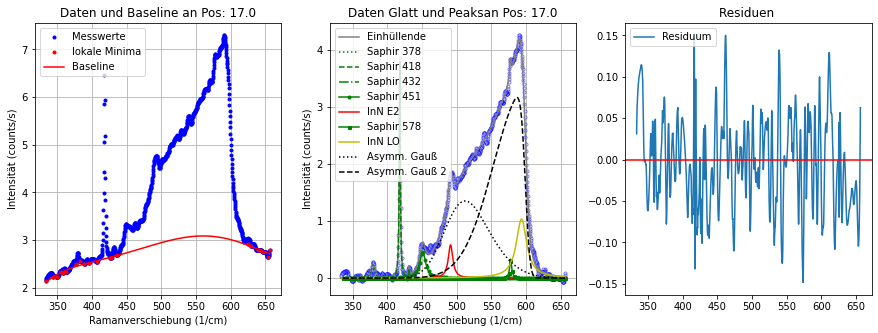

----------------------------------------------------------------------------------------------------
Position: 17.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.84758 2.83164 2.82428 ... 2.28173 2.25379 2.23776]
Hintergrund Parameter:  [ 2.32487591e-12 -6.13681877e-09  6.32035971e-06 -3.19580362e-03
  8.00967565e-01 -7.76064238e+01]
Fitparameter Saphir 378: [0.26152335981127905, 5.236511011086756, 379.890908371082]
Fitparameter Saphir 418: [3.483134779571127, 1.8121981755210812, 417.9971117685278]
Fitparameter Saphir 432: [0.10296324755784962, 0.8100962258606239, 429.98091072335603]
Fitparameter Saphir 451: [0.5075542634630585, 8.607198806169654, 450.633382897044]
Fitparameter InN E2: [0.6095213587191487, 11.086796808953853, 491.412704651245]
Fitparameter Saphir 578: [0.39911941802241546, 2.488663755044667, 577.4492912263976]
Fitparameter InN LO: [0.9602802511814513, 18.78953806766249, 591.7405221051854]
Fitparameter Saphir 6

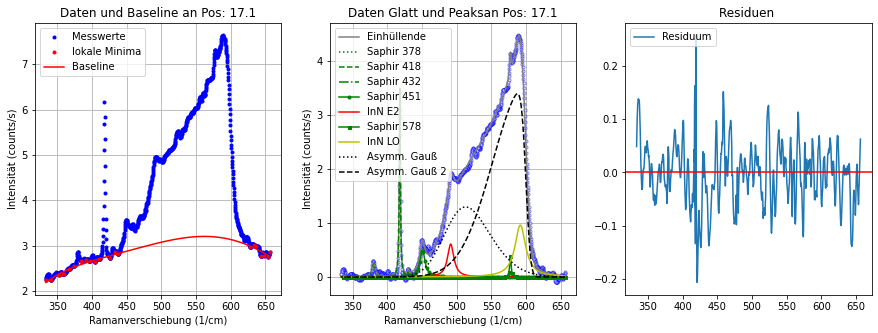

----------------------------------------------------------------------------------------------------
Position: 17.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.99463 3.00758 3.013   ... 2.41057 2.42894 2.46119]
Hintergrund Parameter:  [ 2.17974855e-12 -5.38582333e-09  5.19971643e-06 -2.46696948e-03
  5.82107692e-01 -5.25986480e+01]
Fitparameter Saphir 378: [0.3006580419000992, 5.2001525134241025, 379.41943329419934]
Fitparameter Saphir 418: [3.9558473953812134, 1.6841213845655878, 417.95438348128147]
Fitparameter Saphir 432: [0.06523257168247304, 0.9154897230822694, 432.3943642588273]
Fitparameter Saphir 451: [0.554023622296764, 8.723738769030321, 450.73724596323467]
Fitparameter InN E2: [0.5111591618738002, 9.838837641435605, 491.0557296100021]
Fitparameter Saphir 578: [0.32909029850206856, 2.860258733635858, 577.2700003745078]
Fitparameter InN LO: [1.2153649369735593, 19.954418207151964, 593.9999999999999]
Fitparameter Sap

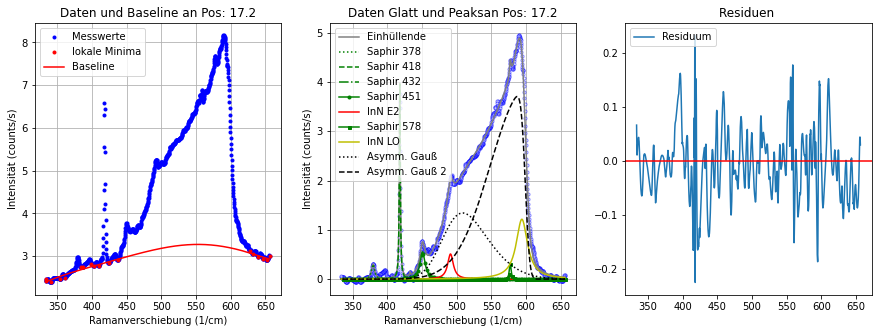

----------------------------------------------------------------------------------------------------
Position: 17.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.26645 3.23693 3.19984 ... 2.46039 2.45766 2.454  ]
Hintergrund Parameter:  [ 1.81678573e-12 -4.57806910e-09  4.56011458e-06 -2.25818847e-03
  5.61625420e-01 -5.37314867e+01]
Fitparameter Saphir 378: [0.2977841315239579, 5.445798736539241, 379.8547205404803]
Fitparameter Saphir 418: [3.6272753260595754, 1.7545073182042625, 417.9577352101342]
Fitparameter Saphir 432: [0.10299689522444512, 0.13482185632740584, 431.5416776103411]
Fitparameter Saphir 451: [0.5455932230047921, 8.490377639544528, 450.4093728743531]
Fitparameter InN E2: [0.6092138216145839, 8.729689165719105, 491.4626528159333]
Fitparameter Saphir 578: [0.2833188682199631, 2.7446867131647092, 576.9857578155835]
Fitparameter InN LO: [1.1885323646938792, 19.999999999999996, 593.9999999999999]
Fitparameter Saphi

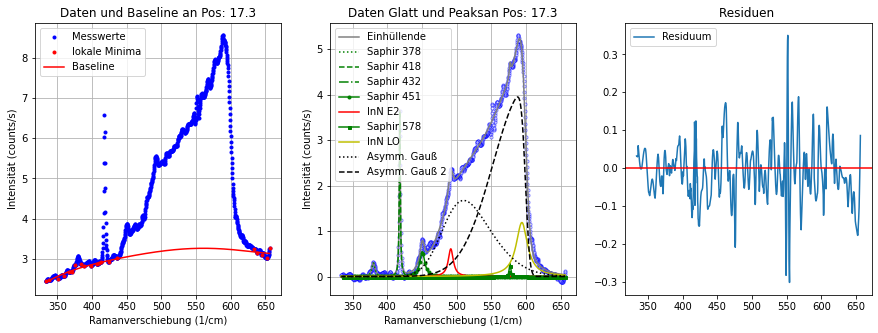

----------------------------------------------------------------------------------------------------
Position: 17.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.25662 3.21291 3.17565 ... 2.53261 2.53243 2.52766]
Hintergrund Parameter:  [-2.84865409e-13  5.21530603e-10 -3.62038377e-07  9.97294136e-05
  2.88246864e-03 -1.42032920e+00]
Fitparameter Saphir 378: [0.29252302065126806, 9.522687807908508, 380.12779879662094]
Fitparameter Saphir 418: [4.023867504830183, 1.5703313157446745, 418.0048873275208]
Fitparameter Saphir 432: [0.13408149206111553, 0.9877308968103766, 430.63748218765045]
Fitparameter Saphir 451: [0.5768158079668598, 8.44824809601562, 450.609530242511]
Fitparameter InN E2: [0.7634044925161395, 7.397639163810226, 491.5935996344259]
Fitparameter Saphir 578: [0.4587480042895199, 2.13951821782192, 577.3285638138636]
Fitparameter InN LO: [1.4018464267840967, 18.136675844747014, 593.1905696953856]
Fitparameter Saphir 6

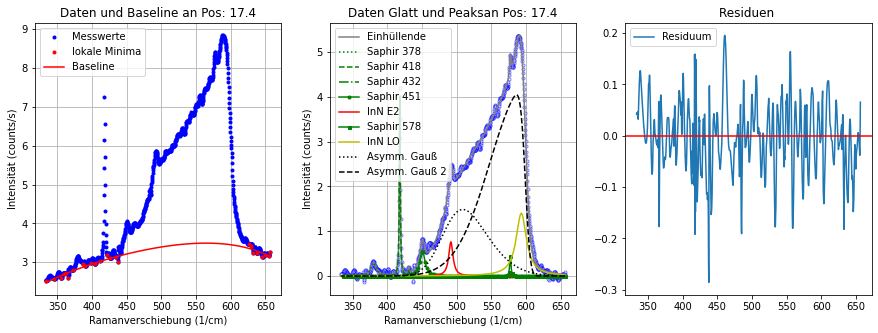

----------------------------------------------------------------------------------------------------
Position: 17.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.41667 3.35967 3.31702 ... 2.71726 2.71954 2.70715]
Hintergrund Parameter:  [ 5.16049251e-12 -1.25021995e-08  1.18430856e-05 -5.50106152e-03
  1.26232620e+00 -1.12423257e+02]
Fitparameter Saphir 378: [0.31380286142460795, 8.163028546291732, 379.5728789326293]
Fitparameter Saphir 418: [3.881449902423465, 1.6094479923254326, 417.99324590747443]
Fitparameter Saphir 432: [0.08527020792948055, 0.43794917983241893, 430.9421041236142]
Fitparameter Saphir 451: [0.6369112445393545, 7.976683105050056, 451.2514741378506]
Fitparameter InN E2: [0.7367359525381085, 6.753138615010471, 490.8748354700109]
Fitparameter Saphir 578: [0.5093496107010411, 3.910909441313366, 578.306965685174]
Fitparameter InN LO: [1.4934418337164799, 16.153940615956884, 593.0229236854868]
Fitparameter Saphir

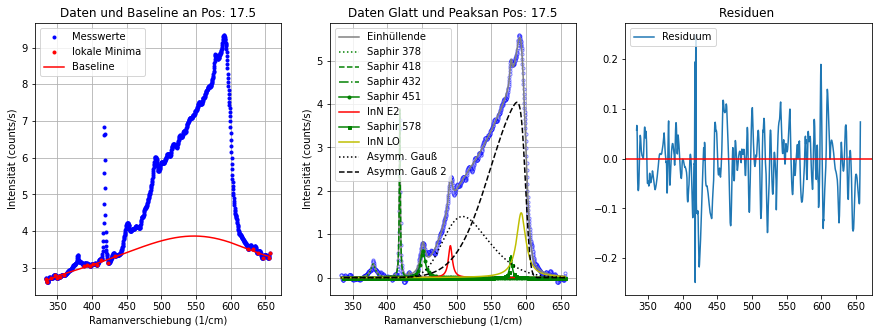

----------------------------------------------------------------------------------------------------
Position: 17.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.43847 3.2869  3.3072  ... 2.83179 2.79921 2.76009]
Hintergrund Parameter:  [ 1.77022928e-12 -5.16373359e-09  5.71836551e-06 -3.05261491e-03
  7.97589258e-01 -7.92889706e+01]
Fitparameter Saphir 378: [0.2581594758926476, 7.579022482623658, 379.5480759597123]
Fitparameter Saphir 418: [3.9070601300262044, 1.6572567333891979, 418.0155370511043]
Fitparameter Saphir 432: [0.10500979325715995, 1.0510552525353212, 430.82598774811714]
Fitparameter Saphir 451: [0.664925853076522, 8.532731842448152, 450.71556667593694]
Fitparameter InN E2: [0.6743748853651779, 8.885556853906431, 491.24456064845117]
Fitparameter Saphir 578: [0.3568956466210069, 2.745043922669868, 577.7659238739787]
Fitparameter InN LO: [1.3986382293794104, 16.076812929719907, 593.3399502468575]
Fitparameter Saphi

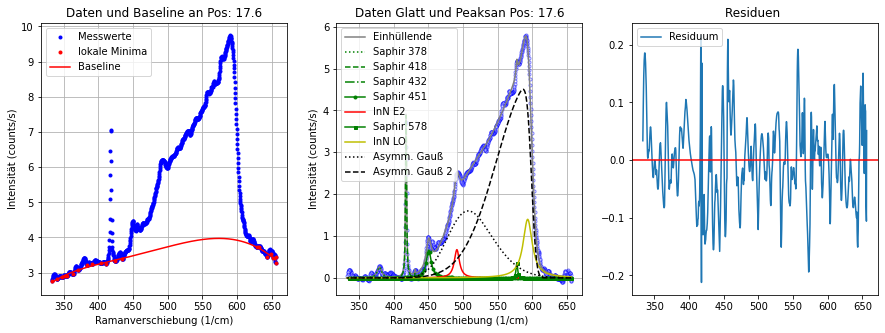

----------------------------------------------------------------------------------------------------
Position: 17.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.56728 3.61829 3.66146 ... 2.97045 2.98016 2.99394]
Hintergrund Parameter:  [-6.77732816e-13  1.17925692e-09 -7.49886093e-07  1.88876410e-04
  8.67535623e-12 -2.07486996e+00]
Fitparameter Saphir 378: [0.2979753652843663, 7.541965319417224, 380.49034052566594]
Fitparameter Saphir 418: [3.9565419776935884, 1.598822576207791, 417.98840246680294]
Fitparameter Saphir 432: [9.715920582414479e-05, 3.6399879691891774e-05, 443.6994117734608]
Fitparameter Saphir 451: [0.5916502762477183, 9.999999999999998, 451.33044085820603]
Fitparameter InN E2: [0.7721399381149674, 9.946942522301516, 491.09343604227394]
Fitparameter Saphir 578: [0.2828576819847697, 2.2100802808703177, 577.1414654168591]
Fitparameter InN LO: [1.538365666138403, 14.673858326621074, 593.5677519050372]
Fitparamete

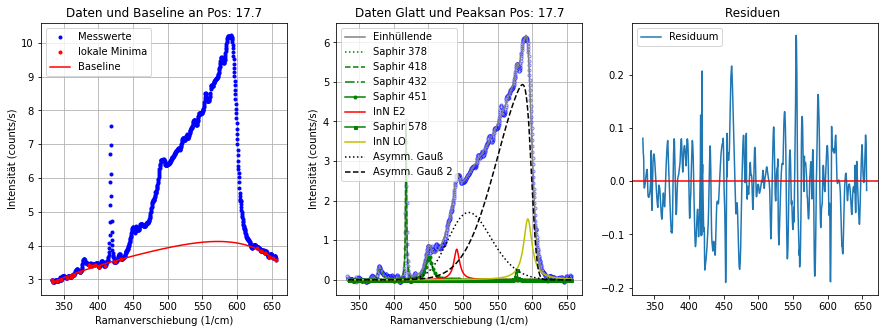

----------------------------------------------------------------------------------------------------
Position: 17.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.85545 3.88504 3.90929 ... 3.04011 3.03803 3.03885]
Hintergrund Parameter:  [ 6.70645169e-12 -1.65150732e-08  1.59449879e-05 -7.56465603e-03
  1.77351650e+00 -1.61910079e+02]
Fitparameter Saphir 378: [0.37634050822316123, 6.321159965315209, 379.64305619613805]
Fitparameter Saphir 418: [4.085233193951723, 1.5639019736254565, 418.08578374098965]
Fitparameter Saphir 432: [0.005022998593792744, 0.002149181154726861, 431.7258911722908]
Fitparameter Saphir 451: [0.5596411730136794, 9.99999999999922, 450.52048174903666]
Fitparameter InN E2: [0.7905907227266861, 7.375745475565242, 491.0680819969689]
Fitparameter Saphir 578: [0.40761167002449533, 2.307114384537062, 576.9087272513902]
Fitparameter InN LO: [1.7324987676205246, 16.854305480364516, 593.3035668421583]
Fitparameter S

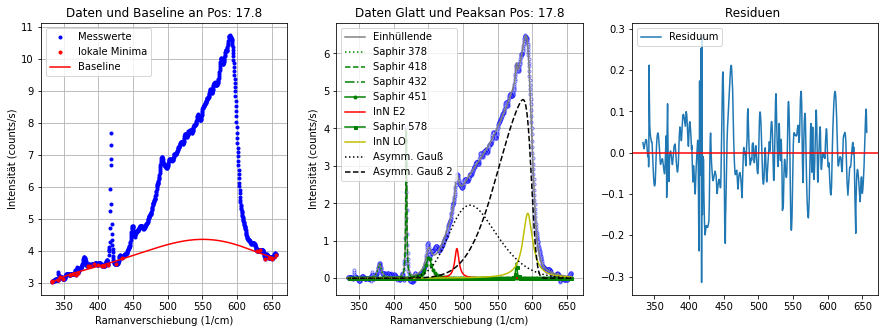

----------------------------------------------------------------------------------------------------
Position: 17.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.01839 4.01923 4.02547 ... 3.19128 3.21226 3.23575]
Hintergrund Parameter:  [ 2.40242538e-12 -5.88478029e-09  5.59056193e-06 -2.59383883e-03
  5.97464893e-01 -5.20642542e+01]
Fitparameter Saphir 378: [0.24306638265943856, 13.740218721072818, 379.3040160857444]
Fitparameter Saphir 418: [3.6846086942070104, 1.8569149872462887, 418.02606928494714]
Fitparameter Saphir 432: [0.11454127019933084, 0.4392742631886454, 430.92646264610255]
Fitparameter Saphir 451: [0.6910529734833437, 9.999999999999998, 451.7414168479748]
Fitparameter InN E2: [0.9991433388122214, 7.765785409901022, 490.8667937145442]
Fitparameter Saphir 578: [0.3182134730275209, 1.8090417409855233, 577.733211950298]
Fitparameter InN LO: [1.8110978253527144, 17.932827449276797, 593.5593612688908]
Fitparameter Sap

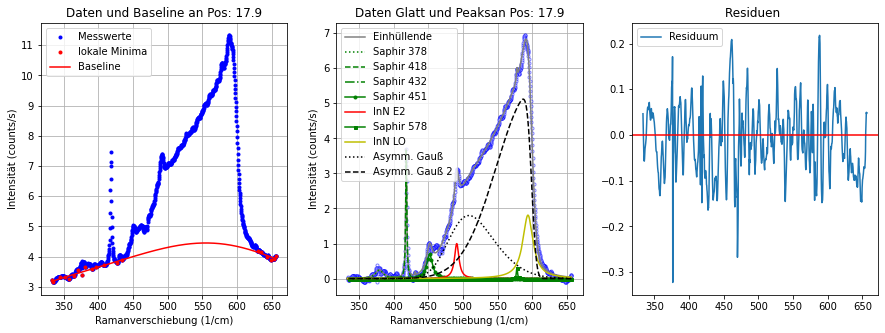

----------------------------------------------------------------------------------------------------
Position: 18.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.37083 4.33278 4.30503 ... 3.47989 3.50966 3.55062]
Hintergrund Parameter:  [ 3.31008345e-12 -7.75016597e-09  7.08324949e-06 -3.17799164e-03
  7.10150235e-01 -6.04410985e+01]
Fitparameter Saphir 378: [0.2899669002635, 8.222848244766006, 379.8535843179507]
Fitparameter Saphir 418: [3.550853645735288, 1.7174922094145646, 418.01032008986834]
Fitparameter Saphir 432: [4.935088595022979e-05, 8.545785487179468e-07, 437.77153773542636]
Fitparameter Saphir 451: [0.8207895054361628, 9.164297621221136, 450.79406608834444]
Fitparameter InN E2: [0.9581830410037454, 8.47306380563778, 491.5009644006519]
Fitparameter Saphir 578: [0.49582216109244825, 2.153830285117497, 577.6784287142953]
Fitparameter InN LO: [2.010630480304043, 19.999999938829838, 593.6185685764464]
Fitparameter Saph

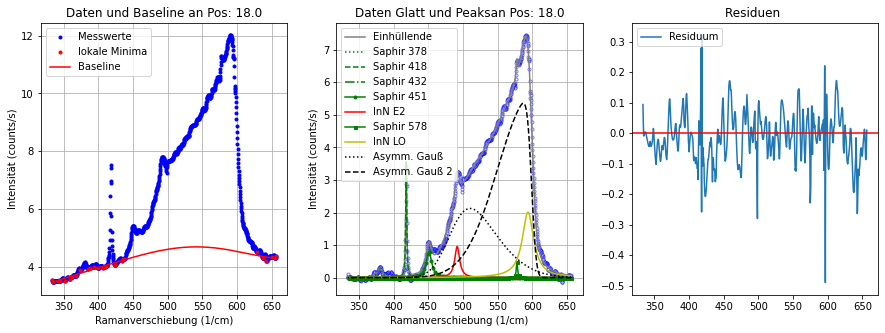

----------------------------------------------------------------------------------------------------
Position: 18.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.57544 4.59461 4.59374 ... 3.637   3.67339 3.70323]
Hintergrund Parameter:  [ 1.85183994e-12 -4.85613237e-09  4.92898962e-06 -2.44773884e-03
  6.05422710e-01 -5.64394851e+01]
Fitparameter Saphir 378: [0.3240123984765032, 8.781911238683604, 379.3346066430886]
Fitparameter Saphir 418: [3.7005632734018037, 1.8129626013035456, 417.9717632489476]
Fitparameter Saphir 432: [0.113284067470968, 0.4675797467986467, 431.581039084221]
Fitparameter Saphir 451: [0.8116288392139456, 9.999999999999998, 450.8951001973251]
Fitparameter InN E2: [1.1347046181012534, 7.4044943264027845, 491.05663545849853]
Fitparameter Saphir 578: [0.08905562755459925, 0.7858732714780137, 577.8107610811547]
Fitparameter InN LO: [1.9467522129430281, 19.17831260290163, 593.8825299192977]
Fitparameter Saphir 

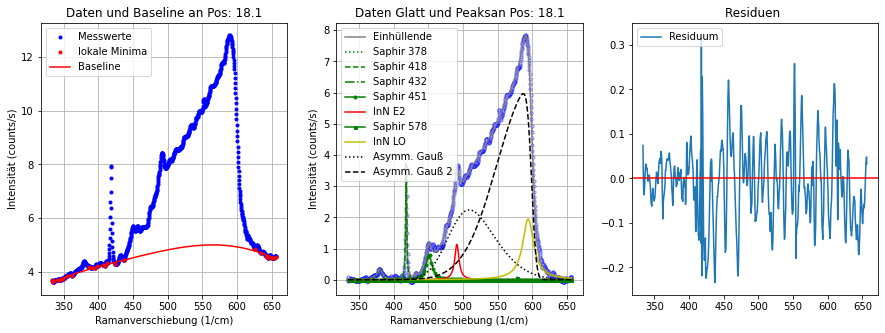

----------------------------------------------------------------------------------------------------
Position: 18.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.82964 4.80873 4.7762  ... 3.71869 3.74526 3.77572]
Hintergrund Parameter:  [ 6.35131998e-12 -1.64571881e-08  1.67385977e-05 -8.37965871e-03
  2.07565786e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.2677485166028626, 6.512906947050959, 381.9270068625786]
Fitparameter Saphir 418: [4.061704602621293, 1.4789803599440046, 418.08899062816334]
Fitparameter Saphir 432: [0.6895322157218203, 0.035414063701456645, 444.99999999999994]
Fitparameter Saphir 451: [0.9142567069455323, 9.999999999999998, 451.11460558121547]
Fitparameter InN E2: [0.9947960290050519, 9.845600434562527, 490.9134922249084]
Fitparameter Saphir 578: [0.3213040205226005, 2.9553867778664578, 578.0294132252706]
Fitparameter InN LO: [2.047594096444154, 17.68876742284488, 593.9556010922289]
Fitparameter Saphi

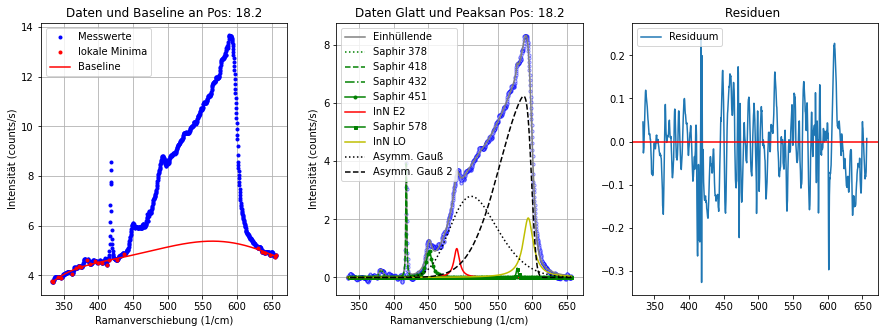

----------------------------------------------------------------------------------------------------
Position: 18.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.07401 5.08299 5.09397 ... 4.04969 4.05317 4.05269]
Hintergrund Parameter:  [ 7.83956177e-12 -1.95708339e-08  1.91188274e-05 -9.16650979e-03
  2.17127042e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.3506569746848246, 7.60837665272631, 380.1127011742559]
Fitparameter Saphir 418: [3.552170024157311, 1.6582682857126088, 418.0739786497504]
Fitparameter Saphir 432: [0.00014137555877110294, 1.8576060266210045e-05, 429.6323845898466]
Fitparameter Saphir 451: [0.863761345612106, 9.9999999999328, 451.1543505052155]
Fitparameter InN E2: [0.945805915196984, 8.8630511852483, 491.756772636395]
Fitparameter Saphir 578: [0.10463572069289236, 2.1022877834639107, 577.7865841751434]
Fitparameter InN LO: [2.2539808410654416, 17.044256321539258, 593.2991586465657]
Fitparameter Saphir 

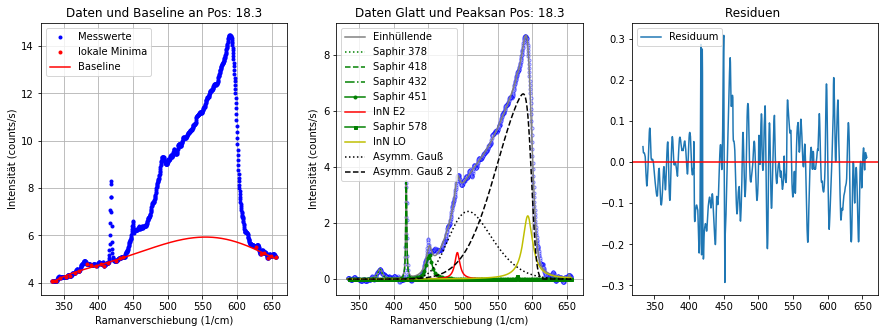

----------------------------------------------------------------------------------------------------
Position: 18.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.43696 5.51584 5.56092 ... 4.41705 4.48019 4.52526]
Hintergrund Parameter:  [ 5.71641335e-13 -1.24815009e-09  9.52093768e-07 -3.14251806e-04
  5.11253819e-02 -4.74714070e-08]
Fitparameter Saphir 378: [0.4784787186238661, 7.218308647347173, 380.2477554650341]
Fitparameter Saphir 418: [3.668852534470361, 1.5809363815695154, 418.05077645281034]
Fitparameter Saphir 432: [0.0006575129050540231, 0.0005415087366306728, 422.3089031277923]
Fitparameter Saphir 451: [0.9914991406328538, 9.999999999999998, 451.34633467632665]
Fitparameter InN E2: [1.3248793961200696, 9.663848664473043, 491.3474206757428]
Fitparameter Saphir 578: [0.3709196818979552, 3.7006959166943854, 577.536981237573]
Fitparameter InN LO: [2.6291863952899406, 16.491681764320372, 593.2860715843327]
Fitparameter S

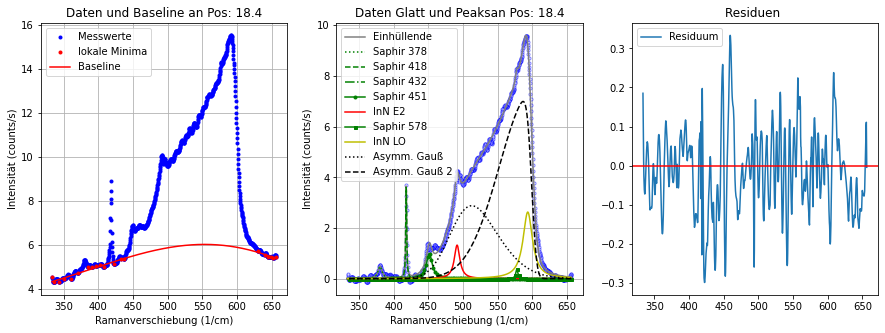

----------------------------------------------------------------------------------------------------
Position: 18.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.4776  5.75094 5.85379 ... 4.47375 4.42917 4.35578]
Hintergrund Parameter:  [-1.23160047e-12  1.12044706e-09  7.55532951e-07 -1.26364485e-03
  5.27381285e-01 -6.77915473e+01]
Fitparameter Saphir 378: [0.3882934713390062, 6.701472152249003, 380.4709151310548]
Fitparameter Saphir 418: [3.6439830304089584, 1.6794096370419782, 418.07439332626177]
Fitparameter Saphir 432: [0.21541680027475882, 0.5808183996466647, 420.0000000006297]
Fitparameter Saphir 451: [1.0324184657631188, 9.999999999999998, 450.71538430130676]
Fitparameter InN E2: [1.288061734546041, 8.868958517077909, 491.0626686108142]
Fitparameter Saphir 578: [0.37449396963130277, 1.8746358985134441, 577.3515939311138]
Fitparameter InN LO: [2.6418824482517866, 14.88264125335793, 593.4955746647908]
Fitparameter Saphi

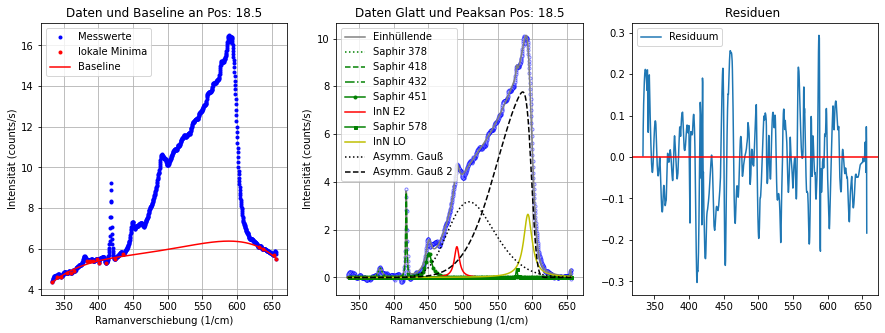

----------------------------------------------------------------------------------------------------
Position: 18.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.14812 6.1455  6.14838 ... 4.95404 4.94744 4.92562]
Hintergrund Parameter:  [-1.04378646e-12  1.96511932e-09 -1.33998453e-06  3.49574318e-04
  3.53951675e-03 -5.55192270e+00]
Fitparameter Saphir 378: [0.4042017294953478, 6.726401269206193, 379.64377509331416]
Fitparameter Saphir 418: [3.551770044879344, 1.6245903315968797, 418.1401156049711]
Fitparameter Saphir 432: [0.16918659442513784, 0.2594815109033061, 431.8812680512738]
Fitparameter Saphir 451: [1.0742213425268385, 9.998066873287716, 451.2631899204304]
Fitparameter InN E2: [1.3694401023259122, 8.928490013890334, 490.68886987052673]
Fitparameter Saphir 578: [0.3398865110966966, 1.9104765903313177, 577.5138516728028]
Fitparameter InN LO: [2.571134242957278, 19.944522424064782, 593.9999999999999]
Fitparameter Saphir

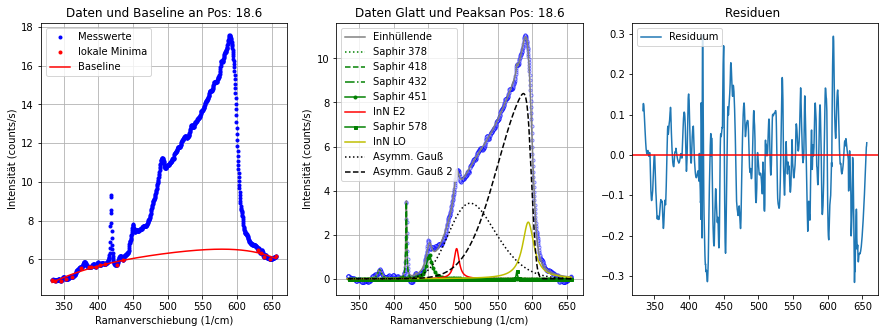

----------------------------------------------------------------------------------------------------
Position: 18.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.41231 6.43701 6.41666 ... 5.11475 5.04112 4.8416 ]
Hintergrund Parameter:  [ 6.91538407e-12 -1.74609855e-08  1.73659379e-05 -8.54245709e-03
  2.09384392e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.3366310379237902, 10.076009396514669, 380.00264739526386]
Fitparameter Saphir 418: [3.4592172421211957, 1.5658760183647464, 418.0405252450134]
Fitparameter Saphir 432: [0.028836306044179135, 0.010707298594483047, 420.1877709048951]
Fitparameter Saphir 451: [1.2559814530656002, 9.999999999999998, 450.6806374378226]
Fitparameter InN E2: [1.4992065029787645, 8.135469403403368, 491.25001057016533]
Fitparameter Saphir 578: [0.17724666548366838, 2.279295860613139, 577.6441007312683]
Fitparameter InN LO: [2.858751427449148, 19.999999905985845, 593.9999999999999]
Fitparameter S

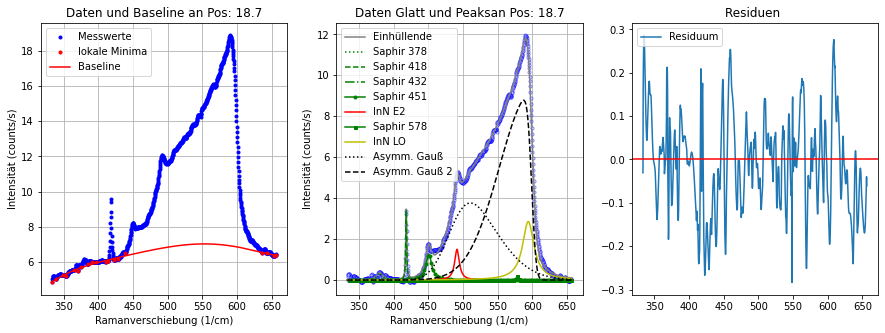

----------------------------------------------------------------------------------------------------
Position: 18.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [7.10538 7.01923 6.96501 ... 5.41898 5.43539 5.46161]
Hintergrund Parameter:  [ 5.98979344e-12 -1.56483184e-08  1.60838886e-05 -8.15815119e-03
  2.05400530e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.31664225379073546, 4.856546597289886, 379.87554585987755]
Fitparameter Saphir 418: [3.6489025041733094, 1.5411630053158738, 418.03759873193843]
Fitparameter Saphir 432: [0.015508422884587812, 0.00038113155783875543, 429.01903544662963]
Fitparameter Saphir 451: [1.2600222129217238, 9.999999999999998, 451.1774381379032]
Fitparameter InN E2: [1.5639337019437187, 9.992289982903806, 491.1785327766812]
Fitparameter Saphir 578: [0.23460462170528038, 3.348969403241161, 578.2883171455677]
Fitparameter InN LO: [3.2536542210117045, 15.504751009392852, 593.4663192476211]
Fitparamet

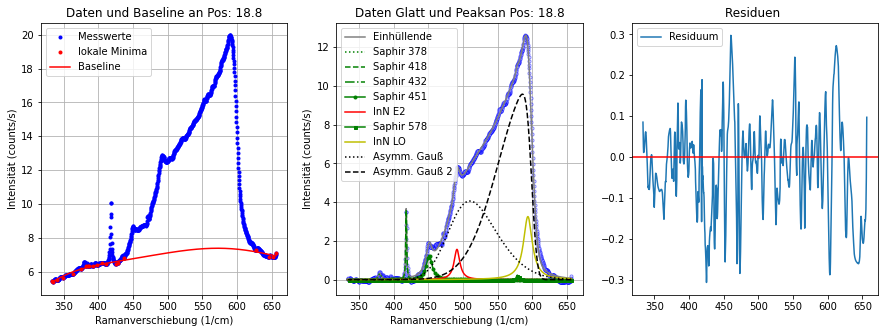

----------------------------------------------------------------------------------------------------
Position: 18.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [7.29509 7.26502 7.23839 ... 5.96148 5.97432 5.98603]
Hintergrund Parameter:  [ 6.80583901e-12 -1.76142309e-08  1.77489997e-05 -8.75091849e-03
  2.13043046e+00 -1.99940034e+02]
Fitparameter Saphir 378: [0.3045749030249162, 10.516014383302185, 382.1628588457174]
Fitparameter Saphir 418: [3.664339933404885, 1.514308613183362, 418.04118729188536]
Fitparameter Saphir 432: [0.0205401252089862, 0.003385694976683835, 431.7258035502474]
Fitparameter Saphir 451: [1.474932923201562, 9.999999999999998, 451.84483338388645]
Fitparameter InN E2: [1.647036070662553, 8.93568807792714, 491.19036304254325]
Fitparameter Saphir 578: [0.48630449681208976, 1.4459024517209986, 577.7432955129345]
Fitparameter InN LO: [3.3173663766700057, 17.284761374652625, 592.9966032939562]
Fitparameter Saphi

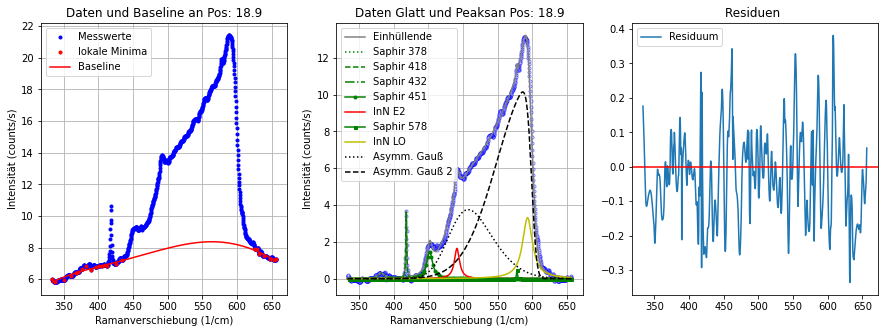

----------------------------------------------------------------------------------------------------
Position: 19.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.37894 8.37093 8.34558 ... 6.51776 6.49847 6.47248]
Hintergrund Parameter:  [-1.87725116e-12  3.64643846e-09 -2.54248995e-06  6.74718843e-04
  1.86131005e-04 -1.17365342e+01]
Fitparameter Saphir 378: [0.4327105388934386, 10.972719894591826, 380.16903199518066]
Fitparameter Saphir 418: [3.379795171745823, 1.553093967170255, 418.0695329942154]
Fitparameter Saphir 432: [1.405752861541515, 0.08159024713724743, 420.00000000000006]
Fitparameter Saphir 451: [1.4573675174251515, 9.999999999999998, 451.5579817361218]
Fitparameter InN E2: [2.073301338854786, 8.094097121727051, 491.0812947483412]
Fitparameter Saphir 578: [0.19114829797146948, 1.9001426508992894, 576.6464692040432]
Fitparameter InN LO: [3.603603803571305, 19.999999999999996, 593.7647922727139]
Fitparameter Saphir 

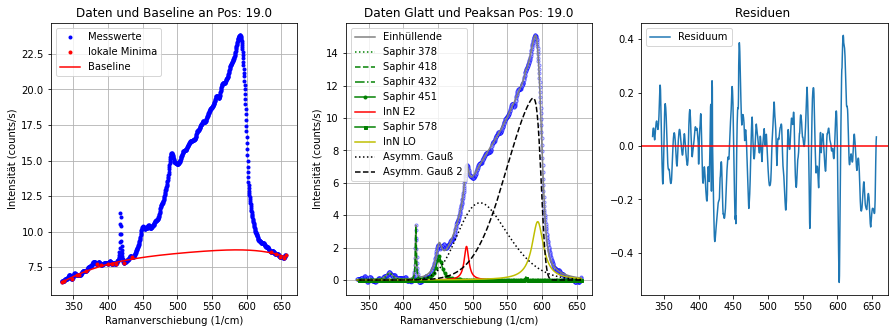

----------------------------------------------------------------------------------------------------
Position: 19.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.69872 8.81936 8.88176 ... 7.16071 7.18962 7.14788]
Hintergrund Parameter:  [ 5.79018820e-12 -1.46223648e-08  1.44363044e-05 -7.01612267e-03
  1.70028581e+00 -1.58150572e+02]
Fitparameter Saphir 378: [0.5850296475175336, 10.545180980495543, 380.9594940722975]
Fitparameter Saphir 418: [3.6266163571451675, 1.4729099884836274, 418.02982374691175]
Fitparameter Saphir 432: [1.7764315485272684e-06, 6.211335434916747e-07, 420.00988910168803]
Fitparameter Saphir 451: [1.5734781838567415, 9.999999999999998, 451.48610228069475]
Fitparameter InN E2: [2.0613342371715153, 9.12469504580169, 490.9002545585811]
Fitparameter Saphir 578: [0.37360292761509034, 2.4987702856284337, 577.2773083736353]
Fitparameter InN LO: [3.895261436882447, 19.31844283180213, 593.7845096298028]
Fitparamete

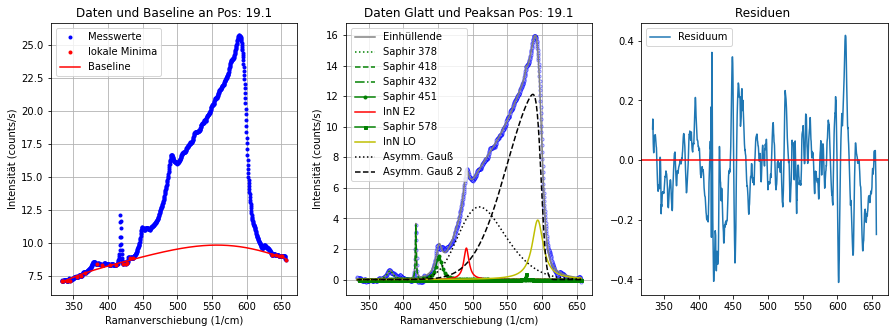

----------------------------------------------------------------------------------------------------
Position: 19.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.6939  8.82046 8.93419 ... 7.30733 7.28608 7.29019]
Hintergrund Parameter:  [-4.23148645e-12  7.73252693e-09 -5.02339667e-06  1.23337773e-03
  3.12722622e-10 -2.18275422e+01]
Fitparameter Saphir 378: [0.43715344051431465, 10.380868037750922, 381.2119656062803]
Fitparameter Saphir 418: [3.4423292169474706, 1.5140059355835334, 418.1043800913695]
Fitparameter Saphir 432: [0.1060652084105611, 2.080450132344603, 444.9999999999868]
Fitparameter Saphir 451: [1.6188559712760424, 9.999999999999998, 450.7514217993608]
Fitparameter InN E2: [2.267771353626024, 7.718647153723471, 491.2193338676827]
Fitparameter Saphir 578: [0.48534488401386194, 1.4430153248431719, 577.6864868814819]
Fitparameter InN LO: [4.329759682803935, 15.428903908284742, 592.991801541787]
Fitparameter Saphir 6

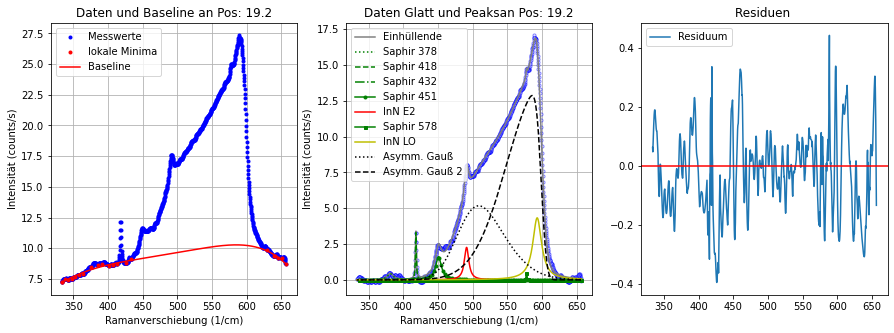

----------------------------------------------------------------------------------------------------
Position: 19.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [10.0506  10.0881  10.1603  ...  7.70936  7.75828  7.74534]
Hintergrund Parameter:  [ 3.91592262e-12 -1.16249635e-08  1.31830076e-05 -7.24281484e-03
  1.95457862e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.33755287627300123, 10.363594123405528, 381.7062457173506]
Fitparameter Saphir 418: [3.4062046206964633, 1.5858103430244344, 418.09735380156854]
Fitparameter Saphir 432: [0.19161882172846104, 0.42103191310559773, 420.00000000000006]
Fitparameter Saphir 451: [1.9037676963828056, 9.999999999999998, 451.3509236991045]
Fitparameter InN E2: [2.2932448417625544, 6.983660544627187, 491.01181262249594]
Fitparameter Saphir 578: [0.29721702445249454, 9.955989774221626, 580.9999999999999]
Fitparameter InN LO: [4.501023753195603, 14.893779205318518, 593.7459726020561]
Fitparam

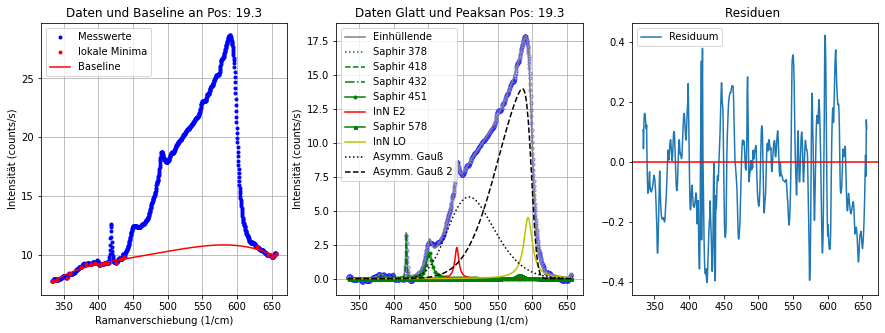

----------------------------------------------------------------------------------------------------
Position: 19.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [10.6335  10.5919  10.5675  ...  8.52186  8.55947  8.67945]
Hintergrund Parameter:  [ 8.53694406e-12 -2.11292302e-08  2.03251782e-05 -9.56466150e-03
  2.23254145e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.5360646193490567, 11.768907587928473, 380.6433051019064]
Fitparameter Saphir 418: [3.000019868336209, 1.3734677767885999, 418.11391224563977]
Fitparameter Saphir 432: [1.1885037726553688e-05, 5.2109081721595725e-06, 444.9654942139527]
Fitparameter Saphir 451: [1.97959722869727, 9.99999999999998, 451.82112439249545]
Fitparameter InN E2: [2.679074854065057, 8.57908584868951, 490.89432111549115]
Fitparameter Saphir 578: [0.24302274001652463, 4.16093557000455, 579.7941392797094]
Fitparameter InN LO: [4.773128591367766, 17.042674477417048, 593.2947860336683]
Fitparamet

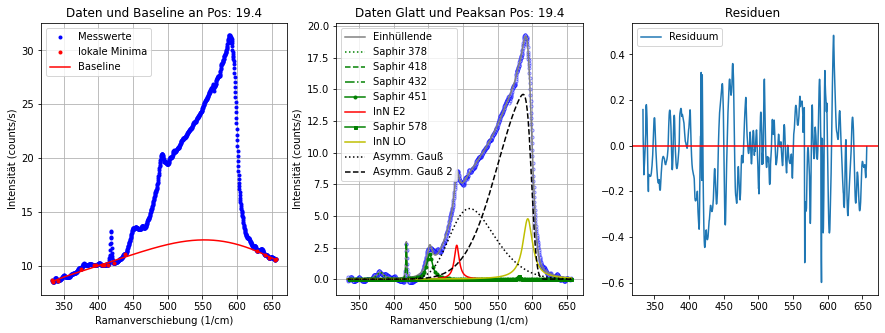

----------------------------------------------------------------------------------------------------
Position: 19.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [11.6414  11.7223  11.7727  ...  9.52461  9.43297  9.37623]
Hintergrund Parameter:  [-4.84115741e-12  8.92878527e-09 -5.85004434e-06  1.44715999e-03
  1.41985483e-08 -2.51191754e+01]
Fitparameter Saphir 378: [0.5317590482509489, 7.424866124431182, 381.1167376368464]
Fitparameter Saphir 418: [3.0488347751664477, 1.6175883756902583, 418.06819813377007]
Fitparameter Saphir 432: [4.253555814984095e-12, 0.005681670866781315, 427.72024460775646]
Fitparameter Saphir 451: [2.1778849287485187, 9.999999999999998, 451.4415186717308]
Fitparameter InN E2: [3.0956500060224212, 7.478079188706845, 491.13646375019096]
Fitparameter Saphir 578: [0.2939643615212429, 1.9790986173914502, 565.0000000000001]
Fitparameter InN LO: [5.222971759121508, 14.635171633068186, 593.5231554166251]
Fitpara

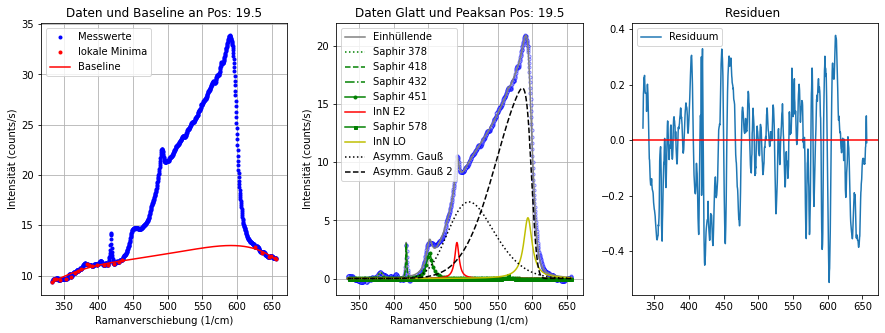

----------------------------------------------------------------------------------------------------
Position: 19.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [12.9992 12.9878 12.9647 ... 10.2698 10.2497 10.2307]
Hintergrund Parameter:  [-2.21136017e-12  4.04002974e-09 -2.70016632e-06  7.08741473e-04
  1.51701709e-09 -9.49416333e+00]
Fitparameter Saphir 378: [0.6510558884199085, 11.569408848292548, 380.01874580810556]
Fitparameter Saphir 418: [3.2919127634775402, 1.2091015540485648, 418.1109895250974]
Fitparameter Saphir 432: [0.0011098436130717816, 0.0005154303693090433, 421.87122719149403]
Fitparameter Saphir 451: [2.305488468775116, 9.94628603575274, 451.28436050991985]
Fitparameter InN E2: [2.943842060068043, 9.083486110596542, 491.15020438817334]
Fitparameter Saphir 578: [0.1940450005313535, 0.04564716680859186, 568.9132904789338]
Fitparameter InN LO: [5.831611767974713, 16.105606786239196, 592.7472047278309]
Fitparameter

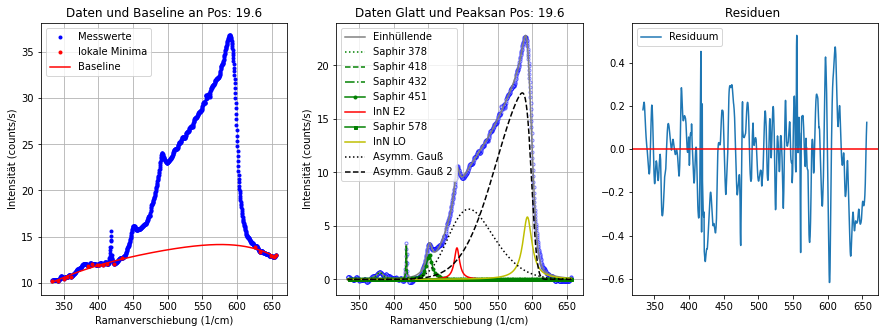

----------------------------------------------------------------------------------------------------
Position: 19.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [13.4309 13.4706 13.5101 ... 11.1278 11.1418 11.1034]
Hintergrund Parameter:  [ 3.71467859e-12 -1.05970782e-08  1.15161174e-05 -6.08741147e-03
  1.60257251e+00 -1.58045688e+02]
Fitparameter Saphir 378: [0.5612799293707215, 9.795721440760174, 381.4140157014378]
Fitparameter Saphir 418: [2.5506822526581576, 1.4097123505334244, 418.1142031952075]
Fitparameter Saphir 432: [7.3383713549721465e-06, 4.8559449310879e-06, 421.00113641966914]
Fitparameter Saphir 451: [2.2437656140313127, 9.999999999999998, 451.96536272041084]
Fitparameter InN E2: [3.3391646285445744, 9.11071240654161, 491.0361036366452]
Fitparameter Saphir 578: [0.2259487024712753, 3.5946320719680065, 580.9999999999995]
Fitparameter InN LO: [5.838291135118961, 18.6440326177025, 593.1154603648782]
Fitparameter Saph

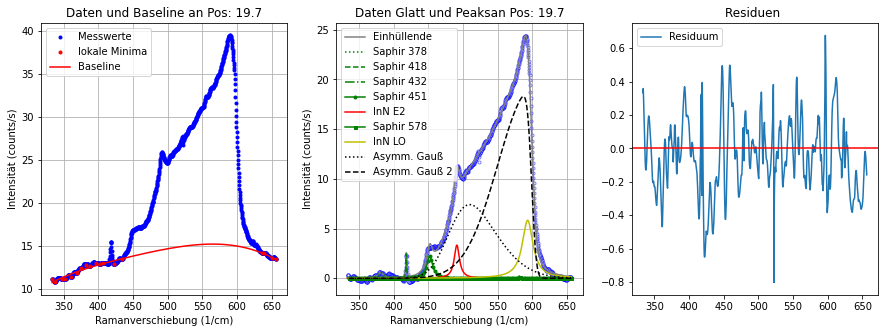

----------------------------------------------------------------------------------------------------
Position: 19.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [14.4792 14.5273 14.5592 ... 11.5465 11.5272 11.4999]
Hintergrund Parameter:  [ 1.50768362e-12 -7.12025434e-09  1.00546345e-05 -6.29523503e-03
  1.86024957e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.5880488908838024, 11.691573263299793, 382.19708448079064]
Fitparameter Saphir 418: [3.0485881454714607, 1.51122461304151, 418.08635035644085]
Fitparameter Saphir 432: [34.04188537462402, 2.3034298149618914e-13, 436.8565200404136]
Fitparameter Saphir 451: [2.7791072932268093, 9.999999999999998, 451.27716792181434]
Fitparameter InN E2: [3.394593750003605, 7.786294855562131, 491.1204399596957]
Fitparameter Saphir 578: [0.23952277392382645, 1.8836996398473018, 580.9999999999999]
Fitparameter InN LO: [6.013903025411181, 16.030213186730315, 593.4159294820724]
Fitparameter Sap

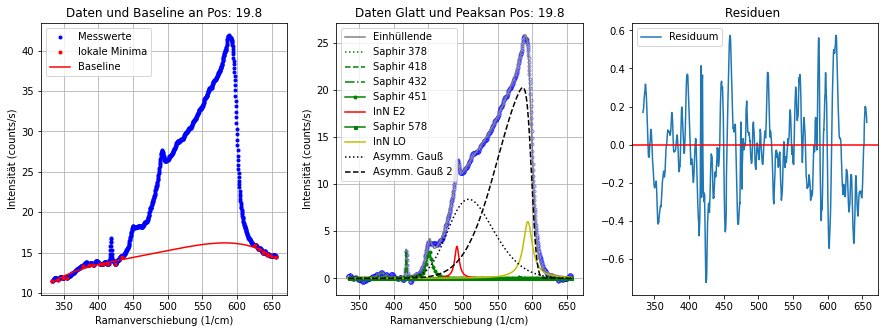

----------------------------------------------------------------------------------------------------
Position: 19.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [15.7478 15.6966 15.6642 ... 12.3999 12.4228 12.5661]
Hintergrund Parameter:  [-2.99807339e-12  5.88738989e-09 -4.15668182e-06  1.11858891e-03
  1.61742568e-05 -1.84013023e+01]
Fitparameter Saphir 378: [0.5919877862927451, 12.725315372403943, 383.6608216077682]
Fitparameter Saphir 418: [2.8749423511187118, 1.3944912023712572, 418.0529012233837]
Fitparameter Saphir 432: [0.2286208621808622, 3.3495639270344464, 444.99999999999994]
Fitparameter Saphir 451: [2.7133727629507316, 9.999999999999998, 451.66901134301634]
Fitparameter InN E2: [3.7656425730116183, 8.075108584602017, 491.12484092252674]
Fitparameter Saphir 578: [8.753764495637438e-05, 2.571730403283928e-06, 570.0465244723786]
Fitparameter InN LO: [6.5231403159414825, 18.404124168244813, 593.292475090673]
Fitparamete

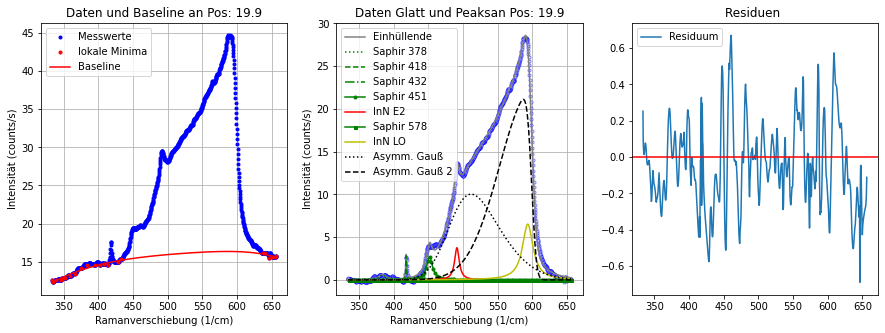

----------------------------------------------------------------------------------------------------
Position: 20.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [17.0323 17.0359 17.0402 ... 13.3268 13.346  13.3948]
Hintergrund Parameter:  [-9.38048543e-12  1.77124866e-08 -1.17983380e-05  2.93462874e-03
  1.29754402e-05 -5.60963023e+01]
Fitparameter Saphir 378: [0.40925372811998056, 9.04593667284788, 384.99999999999994]
Fitparameter Saphir 418: [2.7266042491367304, 1.2280308917901679, 418.0454169850376]
Fitparameter Saphir 432: [0.6591884466122789, 4.518600064735403, 444.99999999999994]
Fitparameter Saphir 451: [2.8919072716311214, 9.999999999999998, 451.64171841660954]
Fitparameter InN E2: [4.013065364632286, 8.285323947019537, 490.91385208274835]
Fitparameter Saphir 578: [0.19898205145980058, 7.644386410587792, 565.0000001114786]
Fitparameter InN LO: [7.419173555002564, 16.14025069837415, 592.9444388917166]
Fitparameter Saphir 

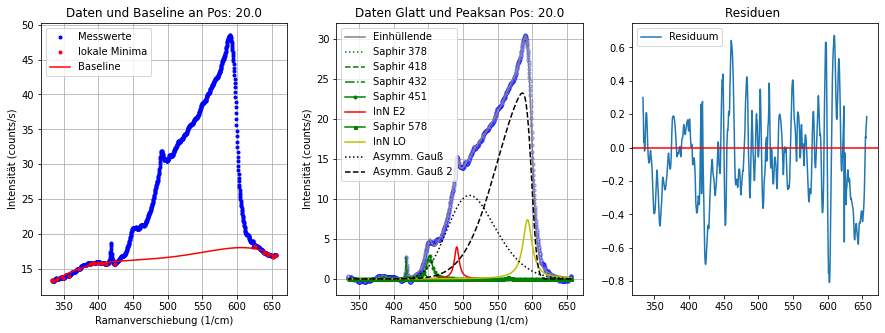

----------------------------------------------------------------------------------------------------
Position: 20.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [18.7419 18.6837 18.6724 ... 14.5552 14.5025 14.1405]
Hintergrund Parameter:  [ 3.29367121e-15 -1.96583308e-09  4.08270512e-06 -3.21578558e-03
  1.14358880e+00 -1.36741265e+02]
Fitparameter Saphir 378: [0.6061613060612229, 10.21872429286065, 380.95146235320885]
Fitparameter Saphir 418: [2.2474612987368787, 1.1867300887928183, 417.9862473915118]
Fitparameter Saphir 432: [1.3553281917905264e-06, 1.1013602277889023e-06, 432.83759210500085]
Fitparameter Saphir 451: [3.1975700164730734, 9.999999930811649, 451.50867278707886]
Fitparameter InN E2: [4.260624334495183, 8.600227278281196, 491.179526496148]
Fitparameter Saphir 578: [4.603253836318196e-05, 4.440500723407849e-06, 580.8118309772067]
Fitparameter InN LO: [8.268175772910544, 19.638547856248362, 592.8440599316964]
Fitpar

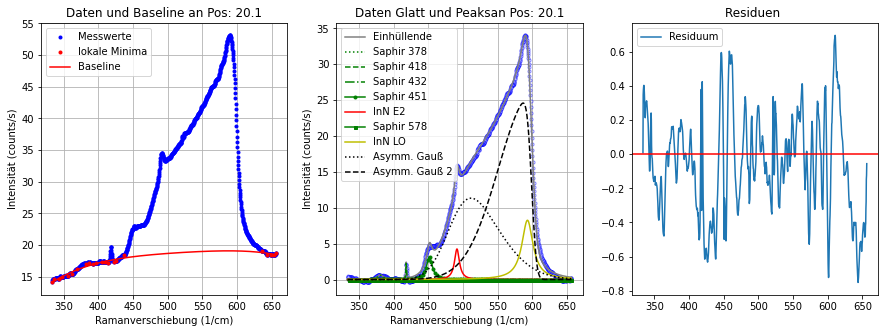

----------------------------------------------------------------------------------------------------
Position: 20.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [19.5079 19.5579 19.5913 ... 15.5799 15.5955 15.7146]
Hintergrund Parameter:  [-9.04021854e-12  1.72873947e-08 -1.16472069e-05  2.92500385e-03
  9.87101063e-08 -5.44605093e+01]
Fitparameter Saphir 378: [0.5594553849308467, 5.459931810713847, 382.53897528688555]
Fitparameter Saphir 418: [2.547760344225997, 1.3916057346320387, 418.20619135777457]
Fitparameter Saphir 432: [1.1084977122549522, 5.771918952707511, 444.99999999999994]
Fitparameter Saphir 451: [3.48044153272648, 9.999999999999998, 452.74505201582315]
Fitparameter InN E2: [4.489818578827362, 8.016649611041661, 490.9124846946792]
Fitparameter Saphir 578: [0.22676577378780424, 1.2406741926600617, 577.8107100308141]
Fitparameter InN LO: [7.877947710442192, 17.238693508013014, 592.8443825238734]
Fitparameter Saphir 6

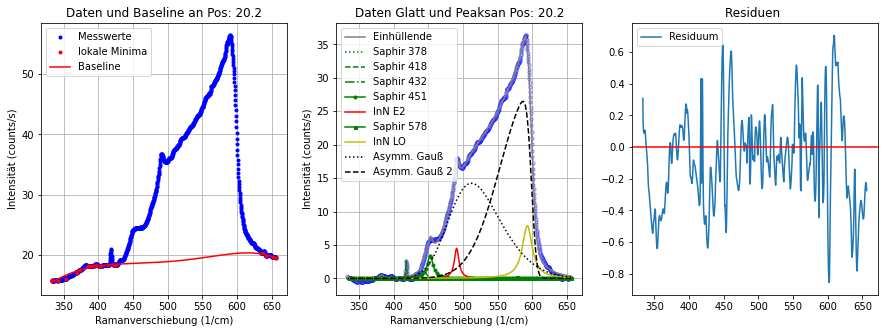

----------------------------------------------------------------------------------------------------
Position: 20.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [20.4468 20.4866 20.4662 ... 15.9338 15.8697 15.8045]
Hintergrund Parameter:  [-5.41549489e-12  1.13122238e-08 -8.29844028e-06  2.25741302e-03
  8.94945717e-06 -4.53627722e+01]
Fitparameter Saphir 378: [0.5930230296029619, 7.130146586740701, 380.8855659422668]
Fitparameter Saphir 418: [2.007972088335546, 1.1809149408752426, 417.98292092866956]
Fitparameter Saphir 432: [2.1731372066382238e-20, 0.9058829436288999, 423.1731195787234]
Fitparameter Saphir 451: [3.503457480671455, 9.999999999999998, 451.23607718772865]
Fitparameter InN E2: [5.180645526772627, 9.14811877435819, 490.9562508985939]
Fitparameter Saphir 578: [0.12419116891804712, 0.6089156293881363, 580.7886768961343]
Fitparameter InN LO: [8.90570239731325, 19.99999999999849, 592.7632947206916]
Fitparameter Saphir 

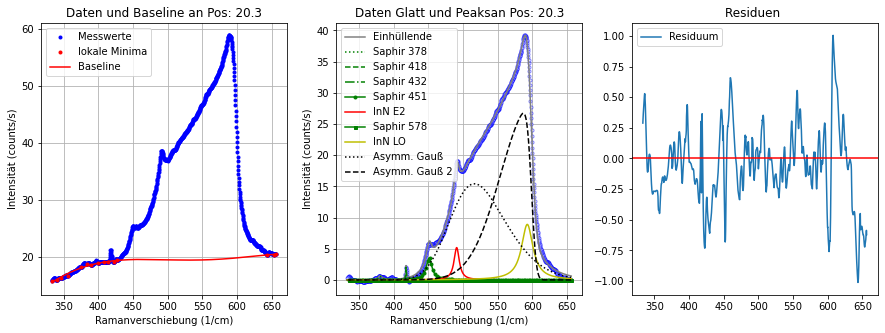

----------------------------------------------------------------------------------------------------
Position: 20.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [21.9545 21.9347 21.8732 ... 17.2884 17.3509 17.5682]
Hintergrund Parameter:  [-5.47819823e-12  1.06069484e-08 -7.32440767e-06  1.91391701e-03
  7.73315260e-06 -3.28313276e+01]
Fitparameter Saphir 378: [0.5896217477761039, 14.41358800252766, 382.0600645441528]
Fitparameter Saphir 418: [1.7729397703203402, 1.6055471208748469, 418.1215320065609]
Fitparameter Saphir 432: [0.8638234314026034, 4.374575311963877, 444.99999999999994]
Fitparameter Saphir 451: [3.7182883397897206, 9.999999999999998, 452.18756715444897]
Fitparameter InN E2: [5.163594673585861, 9.43612188141528, 491.0299412182895]
Fitparameter Saphir 578: [0.09034334457535315, 0.98594828540957, 580.9999999999999]
Fitparameter InN LO: [9.060669731123129, 18.77237244384096, 592.5578589944299]
Fitparameter Saphir 645:

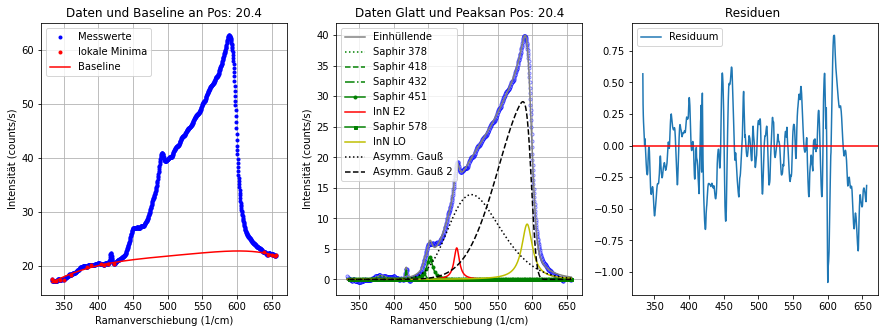

----------------------------------------------------------------------------------------------------
Position: 20.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.1742 23.1666 23.1447 ... 17.8327 17.8023 17.7928]
Hintergrund Parameter:  [-1.20373192e-11  2.33840832e-08 -1.59692943e-05  4.05121457e-03
  2.90959047e-06 -8.03476882e+01]
Fitparameter Saphir 378: [0.530297512664278, 5.386316066810007, 384.80875369120935]
Fitparameter Saphir 418: [1.1597861600374773, 1.5534189158896063, 418.0428180875212]
Fitparameter Saphir 432: [0.9528754297616885, 4.555817956650805, 444.99999999999994]
Fitparameter Saphir 451: [3.9964946593571846, 9.999999999999998, 451.9340622989353]
Fitparameter InN E2: [5.452381276296419, 8.680333730585483, 490.94855512110195]
Fitparameter Saphir 578: [2.622288741915644e-33, 8.601892303699813, 580.2540546899962]
Fitparameter InN LO: [8.92530784995028, 19.999999999999996, 592.7712140952119]
Fitparameter Saphir 

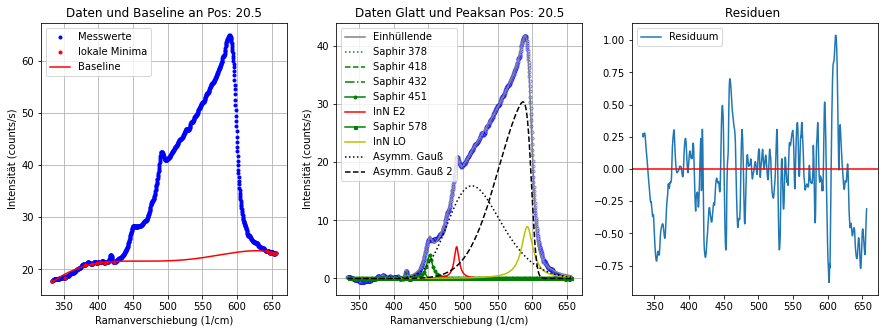

----------------------------------------------------------------------------------------------------
Position: 20.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.8765 23.9493 23.9633 ... 18.0362 17.9636 17.8225]
Hintergrund Parameter:  [-4.59374003e-12  5.25378066e-09  7.69830401e-07 -3.26193427e-03
  1.51692890e+00 -1.99999999e+02]
Fitparameter Saphir 378: [0.6894009537240406, 8.513048960306625, 382.0631244110954]
Fitparameter Saphir 418: [1.9602616257243317, 1.1526083532665523, 417.95633653278526]
Fitparameter Saphir 432: [9.804092885226967e-05, 0.0018879140132913653, 423.5558896518795]
Fitparameter Saphir 451: [4.067060408715965, 9.999999999999998, 451.1499211493994]
Fitparameter InN E2: [5.514261046260388, 8.21248253934645, 490.74958224436807]
Fitparameter Saphir 578: [0.5485865473538087, 7.451856908582027, 580.9999999999999]
Fitparameter InN LO: [9.559659787817072, 15.017142682936116, 592.3166857483488]
Fitparameter Saph

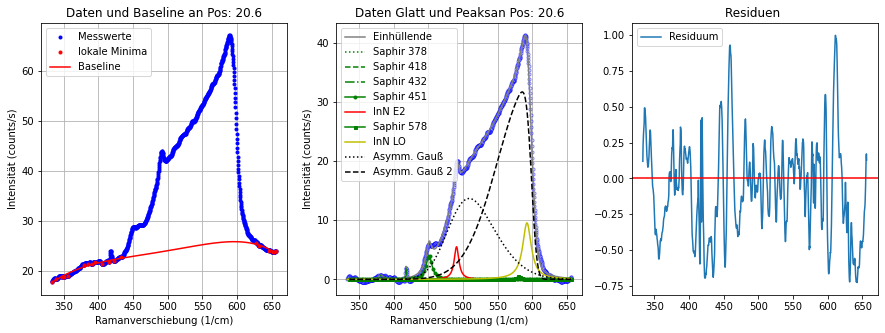

----------------------------------------------------------------------------------------------------
Position: 20.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [24.9743 24.9072 24.8179 ... 18.7602 18.7536 18.7602]
Hintergrund Parameter:  [-9.91375842e-12  1.89681922e-08 -1.28344082e-05  3.25548917e-03
  3.51023209e-13 -6.14139488e+01]
Fitparameter Saphir 378: [0.7990922376348026, 9.823880388530572, 383.5987645103294]
Fitparameter Saphir 418: [2.093286133779672, 1.0024520942567874, 418.2688779520981]
Fitparameter Saphir 432: [0.9103217119306931, 4.387334057890061, 444.9999999999354]
Fitparameter Saphir 451: [4.047535749215731, 9.999999999999998, 451.71757149978157]
Fitparameter InN E2: [5.821270650092001, 8.638175141024574, 490.8057789325646]
Fitparameter Saphir 578: [0.2967566653835662, 1.1393638079474353, 565.0000000111862]
Fitparameter InN LO: [10.092035072142211, 16.203271201976207, 592.1059637839352]
Fitparameter Saphir 645

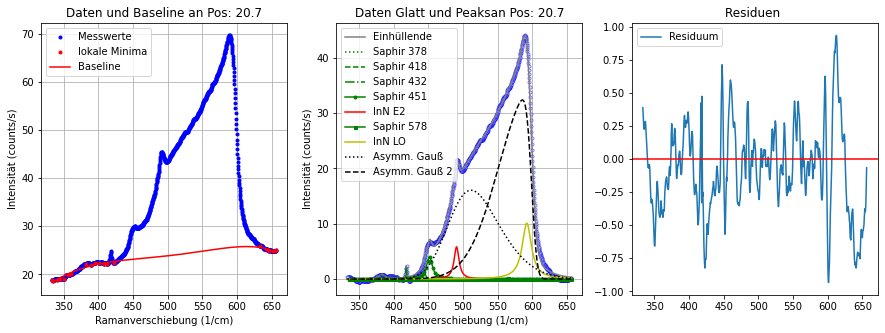

----------------------------------------------------------------------------------------------------
Position: 20.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [25.4187 25.3813 25.3527 ... 18.5993 18.5144 19.1761]
Hintergrund Parameter:  [-1.36595930e-11  2.56876440e-08 -1.70258976e-05  4.21505653e-03
  1.50739926e-08 -8.00770153e+01]
Fitparameter Saphir 378: [0.5711994093993074, 8.422445325086308, 384.8196799647901]
Fitparameter Saphir 418: [1.6093238712484959, 1.2230783539139238, 418.1212681981592]
Fitparameter Saphir 432: [2.2090463385443486e-35, 1.6292698301428772, 433.8728466510026]
Fitparameter Saphir 451: [4.0715169218106375, 9.999999999999998, 451.08107261768]
Fitparameter InN E2: [5.904640929381433, 8.549522926367581, 491.0351716994234]
Fitparameter Saphir 578: [0.455557470556271, 1.1766489601198364, 576.7567693887015]
Fitparameter InN LO: [9.561351902461459, 15.931611725629383, 591.9272336386797]
Fitparameter Saphir 6

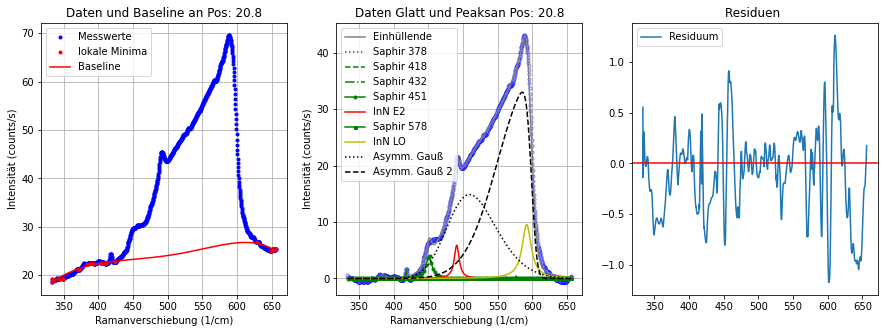

----------------------------------------------------------------------------------------------------
Position: 20.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [24.9786 24.971  24.9581 ... 18.8315 18.807  18.7113]
Hintergrund Parameter:  [-2.70479871e-12  1.90876825e-09  2.54914805e-06 -3.31619397e-03
  1.32486225e+00 -1.61893804e+02]
Fitparameter Saphir 378: [0.7395768271377254, 12.208818529495137, 384.5645041307815]
Fitparameter Saphir 418: [1.6566295855177995, 0.988721710173575, 418.11049980606197]
Fitparameter Saphir 432: [1.0016363421015988, 3.5261220048679935, 444.99999999999994]
Fitparameter Saphir 451: [3.7330216774997766, 9.999999999999993, 451.6892517908075]
Fitparameter InN E2: [5.678032600002424, 8.338014849088948, 490.79006993546056]
Fitparameter Saphir 578: [0.5163919212294715, 8.422264382035085, 580.9999999999999]
Fitparameter InN LO: [9.607137067406402, 14.994962533353343, 591.9798359894462]
Fitparameter Saphir 

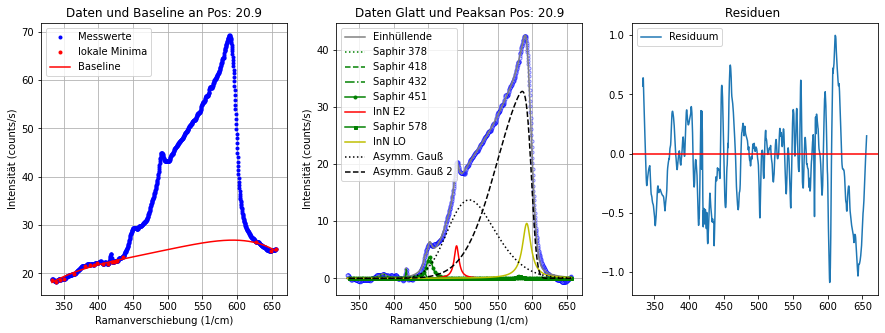

----------------------------------------------------------------------------------------------------
Position: 21.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [26.0442 25.9385 25.8239 ... 19.1882 19.1892 19.2286]
Hintergrund Parameter:  [-9.93845407e-12  1.89949660e-08 -1.28339427e-05  3.25188629e-03
  3.70927572e-10 -6.10106559e+01]
Fitparameter Saphir 378: [0.6680195281903456, 13.161905876029143, 384.99999999536055]
Fitparameter Saphir 418: [0.9709994537243563, 1.1440109653391457, 418.1215108845415]
Fitparameter Saphir 432: [1.4292837285382223, 5.668608398881845, 444.99999999999994]
Fitparameter Saphir 451: [3.8718665529921648, 9.999999999999998, 452.64202614260057]
Fitparameter InN E2: [5.41182826897725, 8.865340252681483, 490.67670058348017]
Fitparameter Saphir 578: [0.4611417729749925, 4.554070947668145, 580.9999999999999]
Fitparameter InN LO: [9.54694585335459, 16.124319716699215, 591.6857165679781]
Fitparameter Saphir 6

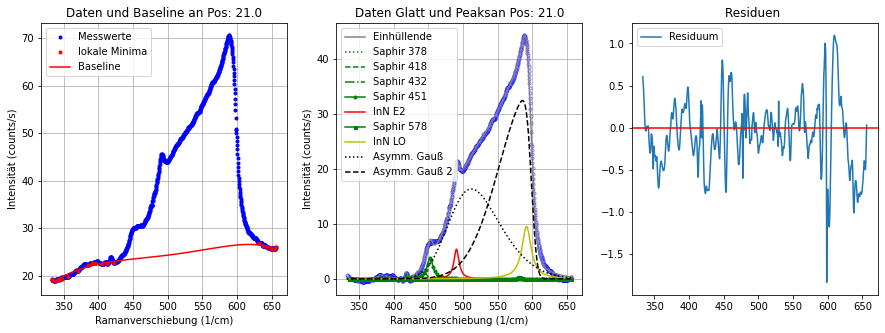

----------------------------------------------------------------------------------------------------
Position: 21.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [25.8267 25.806  25.7966 ... 18.8926 18.9424 19.0051]
Hintergrund Parameter:  [-8.84489021e-12  1.65974609e-08 -1.10532368e-05  2.77897059e-03
  2.97718342e-10 -4.91969598e+01]
Fitparameter Saphir 378: [0.5798521870047363, 10.835789282284225, 384.99999999999994]
Fitparameter Saphir 418: [1.2532882959935288, 0.8579161005932576, 418.0731675058169]
Fitparameter Saphir 432: [3.911174122390896, 0.04084938832003333, 442.4693419677578]
Fitparameter Saphir 451: [4.012453759881159, 9.999999999999998, 450.5618912166818]
Fitparameter InN E2: [5.235623380926015, 8.563496046997955, 490.5789570309738]
Fitparameter Saphir 578: [0.7065162457824219, 8.472226569215923, 580.9999999999999]
Fitparameter InN LO: [9.254245741097149, 14.325075460570153, 591.813600309888]
Fitparameter Saphir 645

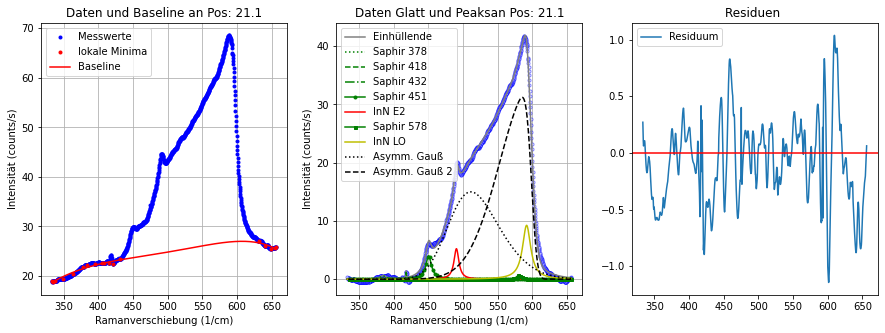

----------------------------------------------------------------------------------------------------
Position: 21.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.7952 23.9282 23.9559 ... 17.0069 16.9266 16.845 ]
Hintergrund Parameter:  [-1.17637721e-11  2.27393288e-08 -1.54770672e-05  3.92680256e-03
  1.09428745e-13 -7.88724309e+01]
Fitparameter Saphir 378: [0.5312812077967536, 9.800661736918189, 383.7418477903302]
Fitparameter Saphir 418: [0.825879856675309, 1.2170315161102487, 417.9491022710137]
Fitparameter Saphir 432: [1.195433934870358, 4.2763292501877, 444.99999999999994]
Fitparameter Saphir 451: [3.591650697382956, 9.999999999999998, 451.79259211164816]
Fitparameter InN E2: [5.279614015185479, 9.154796527207541, 490.58294052952897]
Fitparameter Saphir 578: [6.456950256165379e-33, 8.973577110471496, 579.4396442741219]
Fitparameter InN LO: [8.861250429960306, 19.999999999999996, 591.0392288534053]
Fitparameter Saphir 645

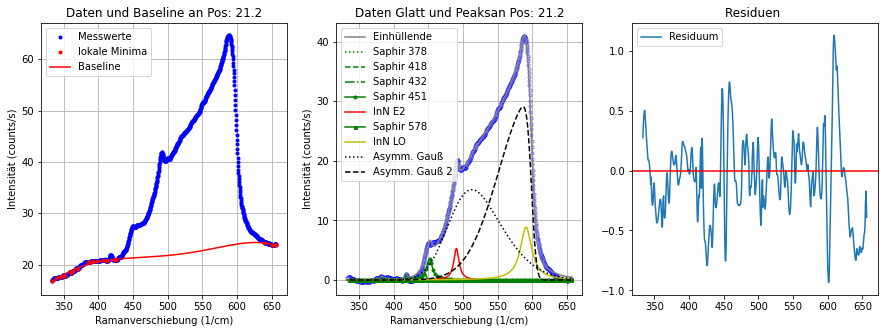

----------------------------------------------------------------------------------------------------
Position: 21.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.3375 23.2551 23.2539 ... 16.2274 16.1941 16.1603]
Hintergrund Parameter:  [-7.36063576e-12  1.42430987e-08 -9.75405004e-06  2.51108512e-03
  1.17135301e-05 -4.73668800e+01]
Fitparameter Saphir 378: [0.6345975786232106, 17.847985300750537, 384.99999999999994]
Fitparameter Saphir 418: [1.054249519823401, 1.374411246340747, 418.1516920525899]
Fitparameter Saphir 432: [0.8298629604237887, 4.859380253627367, 444.99999999999994]
Fitparameter Saphir 451: [3.7814485804068108, 9.999999999999998, 451.7744788219364]
Fitparameter InN E2: [4.926499587128692, 8.478218455791225, 490.5448867085221]
Fitparameter Saphir 578: [0.4908878400293903, 8.16235292549647, 580.9999999999999]
Fitparameter InN LO: [8.352480467825012, 14.325378287896687, 591.8731057295078]
Fitparameter Saphir 645:

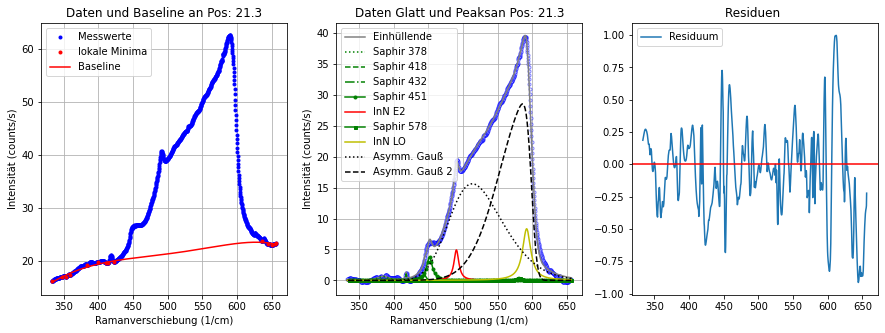

----------------------------------------------------------------------------------------------------
Position: 21.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.4614 23.6281 23.6546 ... 16.9491 17.0422 17.12  ]
Hintergrund Parameter:  [-2.97737337e-12  2.57591824e-09  1.92734590e-06 -3.02149144e-03
  1.24769035e+00 -1.54518842e+02]
Fitparameter Saphir 378: [0.6922428393467555, 8.871429976132774, 382.60043210808607]
Fitparameter Saphir 418: [0.5218950664306202, 0.6032469847919067, 418.42220137142294]
Fitparameter Saphir 432: [5.225095726964433e-07, 5.773641359255256e-07, 420.13668050893256]
Fitparameter Saphir 451: [3.3767631181858304, 9.999999983873689, 451.26862081267063]
Fitparameter InN E2: [4.8304407295937395, 9.325495999582108, 490.5259578629215]
Fitparameter Saphir 578: [0.23278489198256866, 7.989332909133629, 580.9999319474338]
Fitparameter InN LO: [7.88010785565304, 17.15522999235815, 590.9477486271114]
Fitparameter 

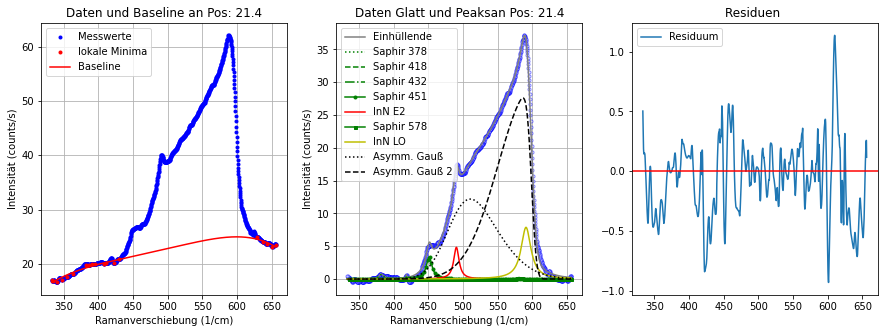

----------------------------------------------------------------------------------------------------
Position: 21.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [20.8022 20.7042 20.6671 ... 14.6936 14.6253 14.4995]
Hintergrund Parameter:  [-8.95474852e-12  1.65353890e-08 -1.08178130e-05  2.66994878e-03
  3.91442387e-08 -4.89185923e+01]
Fitparameter Saphir 378: [0.48196439407820585, 13.8755483422708, 384.1889713629505]
Fitparameter Saphir 418: [0.7207870123070195, 0.9190760366178217, 417.9917141736947]
Fitparameter Saphir 432: [1.284874111033015, 4.9734515507062, 444.99999999999994]
Fitparameter Saphir 451: [3.1132323499142274, 9.999999999999998, 452.5146722616446]
Fitparameter InN E2: [4.415141671762401, 9.027140194682502, 490.5209678992755]
Fitparameter Saphir 578: [0.6522959851166502, 9.984543018182135, 580.9999999999999]
Fitparameter InN LO: [7.3186195954643605, 15.867865194805706, 591.2562654773989]
Fitparameter Saphir 645: 

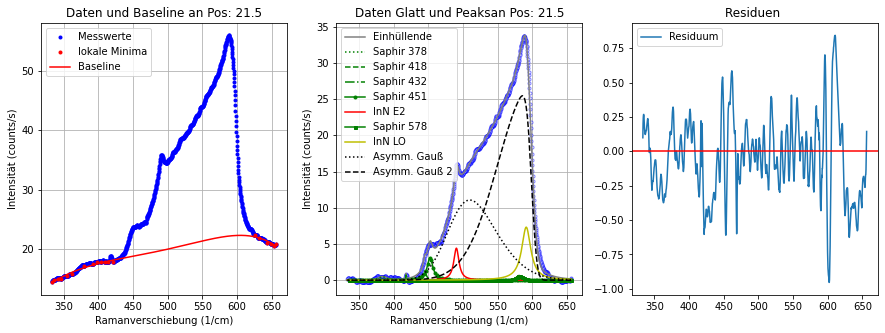

----------------------------------------------------------------------------------------------------
Position: 21.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [20.1528 20.2494 20.3009 ... 14.1352 14.0692 14.0107]
Hintergrund Parameter:  [ 1.46567551e-12 -6.38053310e-09  8.64627685e-06 -5.27151737e-03
  1.54690754e+00 -1.63689039e+02]
Fitparameter Saphir 378: [0.5742127764249715, 15.069424455700386, 384.55567062682945]
Fitparameter Saphir 418: [1.1188951171528416, 0.9075626897922343, 418.3325774047452]
Fitparameter Saphir 432: [4.429173083995347, 6.877246283722037e-17, 420.0019396434709]
Fitparameter Saphir 451: [3.179687284444519, 9.999999999999998, 451.3416041424573]
Fitparameter InN E2: [4.090107729905134, 8.61673846436421, 490.5645092914002]
Fitparameter Saphir 578: [0.4915924351904332, 3.1302324998723603, 580.9999999999999]
Fitparameter InN LO: [6.868308162422477, 18.272356092679008, 590.6289997620078]
Fitparameter Saphir 

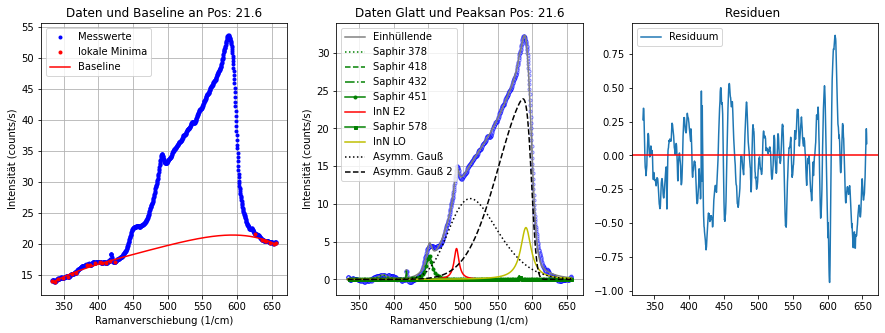

----------------------------------------------------------------------------------------------------
Position: 21.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [18.9283 19.0534 19.2135 ... 13.2802 13.259  13.2317]
Hintergrund Parameter:  [-9.08462745e-12  1.73545958e-08 -1.16796047e-05  2.93555302e-03
  9.44736083e-06 -5.75452287e+01]
Fitparameter Saphir 378: [0.31331235953333386, 9.148742715594057, 384.9999999991447]
Fitparameter Saphir 418: [0.456585760993461, 0.7950620762012808, 417.9949829048945]
Fitparameter Saphir 432: [1.1357284793527478, 5.399114855642581, 444.99999999999994]
Fitparameter Saphir 451: [2.586431696420296, 9.999999999999998, 452.2663736418926]
Fitparameter InN E2: [3.8963018959611544, 8.322298435680214, 490.5513167275259]
Fitparameter Saphir 578: [1.4386325734346559e-27, 1.4271424757707545, 580.9360689049331]
Fitparameter InN LO: [6.438698060620983, 18.110411455045565, 591.2340465415573]
Fitparameter Saphi

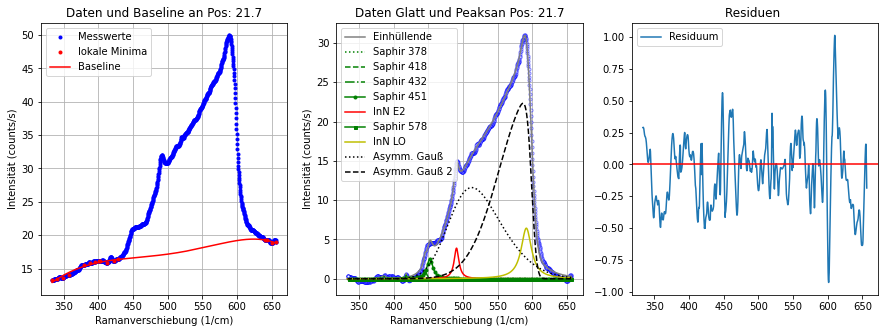

----------------------------------------------------------------------------------------------------
Position: 21.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [17.1444 17.1459 17.1557 ... 11.6422 11.6196 11.5945]
Hintergrund Parameter:  [ 6.10746277e-12 -1.64026562e-08  1.69050282e-05 -8.46915056e-03
  2.11072284e+00 -1.99750004e+02]
Fitparameter Saphir 378: [0.5776556598784065, 18.158612437779976, 382.6457432284839]
Fitparameter Saphir 418: [0.26435604606575736, 0.4501467317237925, 417.45747523040984]
Fitparameter Saphir 432: [0.9274585240601085, 4.753039186829996, 444.99999999999994]
Fitparameter Saphir 451: [2.386916776044777, 9.999999999999998, 453.2675366671721]
Fitparameter InN E2: [3.671916923071093, 8.287731258265687, 490.42248362193027]
Fitparameter Saphir 578: [0.7360014111769462, 8.54408541783291, 580.9999999999999]
Fitparameter InN LO: [6.290220955508642, 15.67942505987178, 591.5319954385121]
Fitparameter Saphir 64

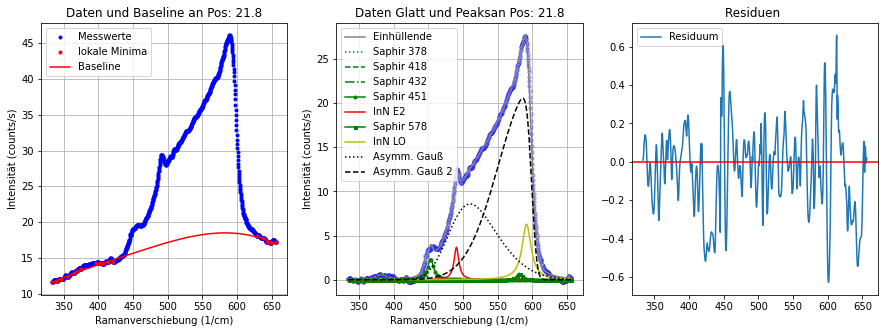

----------------------------------------------------------------------------------------------------
Position: 21.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [15.866  15.9461 16.0226 ... 11.1021 11.1015 11.1016]
Hintergrund Parameter:  [ 3.84698140e-12 -1.15578234e-08  1.29558057e-05 -6.95709414e-03
  1.84227325e+00 -1.83138594e+02]
Fitparameter Saphir 378: [0.45794813115265404, 11.178560828621928, 383.3589728472589]
Fitparameter Saphir 418: [2.535940964877891, 0.20124565209536271, 418.1150353677647]
Fitparameter Saphir 432: [1.3964847470693133e-05, 5.121639053185941e-06, 420.00420441095434]
Fitparameter Saphir 451: [2.3259386439323984, 9.99999998575424, 450.88880992290296]
Fitparameter InN E2: [3.3044050990410527, 8.696004605209982, 490.64144483883484]
Fitparameter Saphir 578: [0.6722218389421335, 7.511300697149861, 580.9999970419576]
Fitparameter InN LO: [5.963503196150466, 15.688034967078359, 591.5290195366632]
Fitparamete

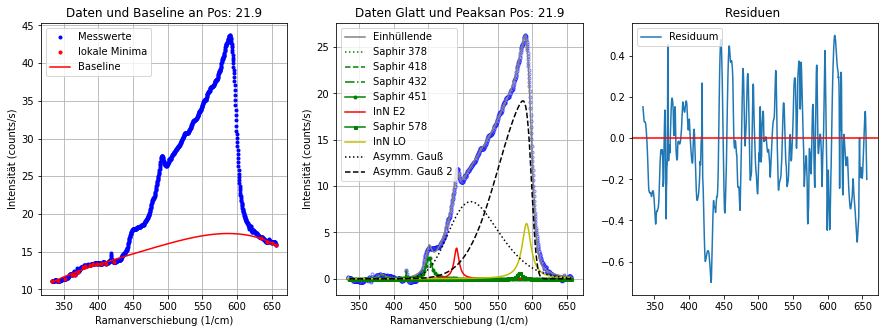

----------------------------------------------------------------------------------------------------
Position: 22.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [15.5627 15.5235 15.4932 ... 10.6145 10.599  10.5712]
Hintergrund Parameter:  [ 7.72333052e-12 -1.95974814e-08  1.92746083e-05 -9.24946748e-03
  2.20336296e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.6577211463966112, 11.395784106271039, 382.130980938508]
Fitparameter Saphir 418: [0.7352681461647445, 0.797905064199043, 418.06121959971443]
Fitparameter Saphir 432: [4.377250575321602e-06, 2.059427638226493e-06, 444.3172241080996]
Fitparameter Saphir 451: [2.2451737849892024, 9.999999999999998, 451.8770175615221]
Fitparameter InN E2: [3.099221076468398, 7.475760626302572, 490.502527718733]
Fitparameter Saphir 578: [0.057048841424340656, 6.659042400276442, 580.9999999999999]
Fitparameter InN LO: [5.069229432003824, 19.97184042085778, 591.4671343181171]
Fitparameter Saph

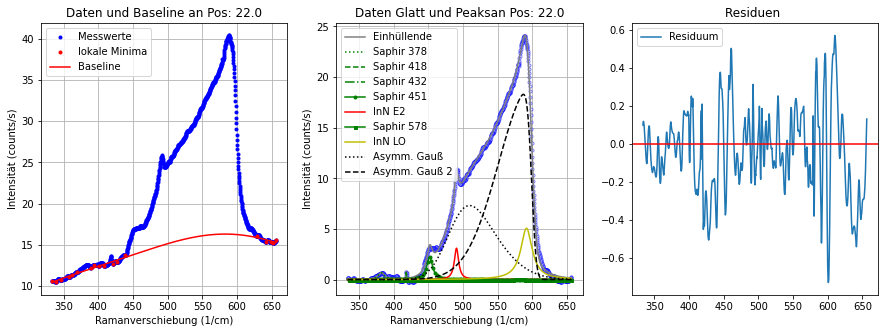

----------------------------------------------------------------------------------------------------
Position: 22.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [12.9733  13.1345  13.1709  ...  8.69432  8.6725   8.6495 ]
Hintergrund Parameter:  [-6.89874550e-12  1.28882040e-08 -8.48601128e-06  2.09159609e-03
  4.69669053e-10 -4.03294517e+01]
Fitparameter Saphir 378: [0.3631879634866853, 10.594002894888428, 383.6212635704048]
Fitparameter Saphir 418: [0.5142812738908981, 1.2569733141571682, 417.9391548180695]
Fitparameter Saphir 432: [0.0011021158589124816, 6.419239559123842e-06, 438.90634611124955]
Fitparameter Saphir 451: [1.9213916341492232, 9.999999999999998, 450.4511376205049]
Fitparameter InN E2: [2.763962717189084, 8.131190761628336, 490.9448368205423]
Fitparameter Saphir 578: [2.982330257840921e-34, 6.441819253671052, 580.7507763390375]
Fitparameter InN LO: [4.897844181231997, 18.275602969732073, 591.7751441534799]
Fitpar

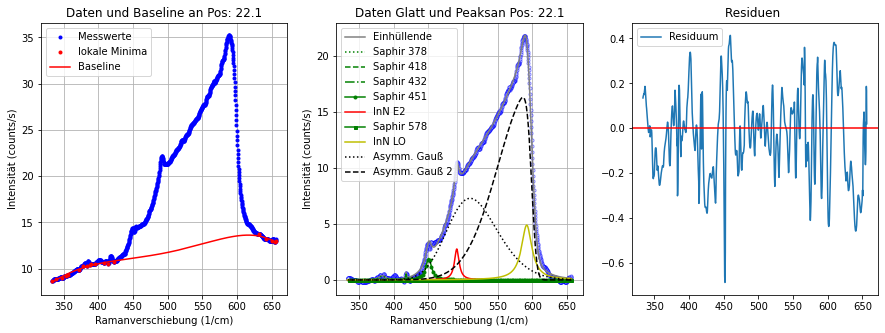

----------------------------------------------------------------------------------------------------
Position: 22.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [12.5614  12.5723  12.6117  ...  8.73837  8.65089  8.34252]
Hintergrund Parameter:  [-4.22384190e-12  7.82534004e-09 -5.15196100e-06  1.28721728e-03
  2.34396005e-10 -2.31285236e+01]
Fitparameter Saphir 378: [0.32760929844186176, 18.07021296378662, 384.74048851670557]
Fitparameter Saphir 418: [0.7729728729671457, 0.7546819179313562, 418.09607855865613]
Fitparameter Saphir 432: [0.7937784552791664, 5.9655777868865405, 444.99999999999994]
Fitparameter Saphir 451: [1.6875208592207613, 9.999999999999998, 453.87961493290175]
Fitparameter InN E2: [2.8320920949540342, 8.105615143570006, 490.4949228315174]
Fitparameter Saphir 578: [0.2709559388443574, 5.5705786335071155, 580.9999999999999]
Fitparameter InN LO: [4.752890022145945, 17.433321076512442, 592.056684226418]
Fitparamete

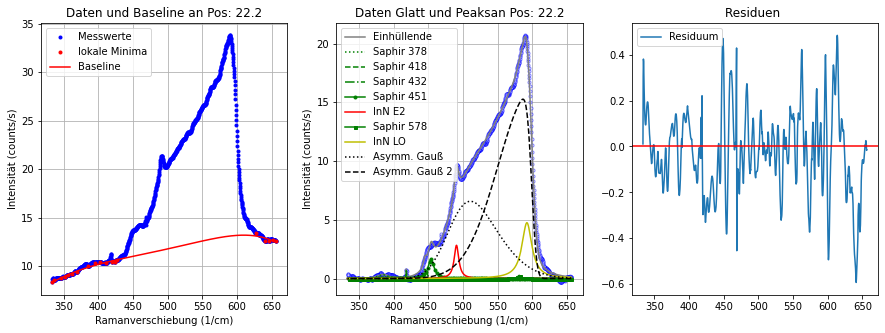

----------------------------------------------------------------------------------------------------
Position: 22.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [11.1568  11.2061  11.2391  ...  7.38451  7.37361  7.36453]
Hintergrund Parameter:  [ 2.36087705e-12 -8.78723533e-09  1.12757649e-05 -6.67055898e-03
  1.88850801e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.26980944169391186, 12.010053415144352, 383.35556022989954]
Fitparameter Saphir 418: [0.3986334165430143, 1.1906829432636485, 418.2119712292902]
Fitparameter Saphir 432: [0.5757721950573522, 4.4261613311461545, 444.99999999999994]
Fitparameter Saphir 451: [1.6246559508257232, 9.999999999999998, 452.8950706717465]
Fitparameter InN E2: [2.10604095465363, 10.198861042959955, 490.7079398141093]
Fitparameter Saphir 578: [0.2264174104765245, 4.343714042910255, 580.9999999999999]
Fitparameter InN LO: [4.312468477270613, 16.34425305137536, 592.7748893179028]
Fitparameter S

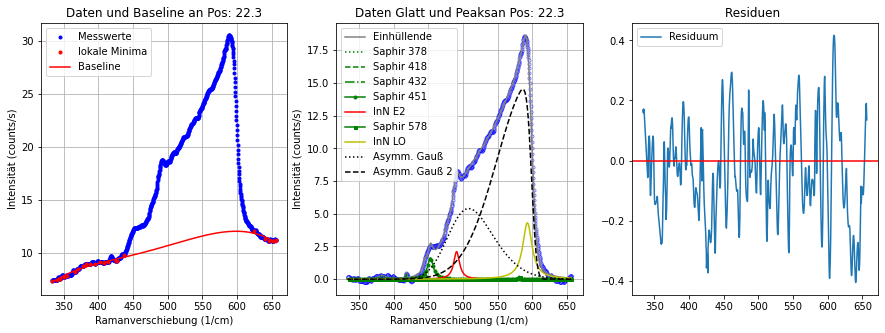

----------------------------------------------------------------------------------------------------
Position: 22.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [9.28336 9.23218 9.40292 ... 6.39958 6.4371  6.48229]
Hintergrund Parameter:  [-4.81957806e-12  8.78146886e-09 -5.64750907e-06  1.36578625e-03
  9.80413318e-06 -2.49490952e+01]
Fitparameter Saphir 378: [0.286069150177288, 13.15866292873068, 382.5206832048958]
Fitparameter Saphir 418: [0.7595937730454568, 1.5711001476165618, 417.91450102464114]
Fitparameter Saphir 432: [0.07764373266592185, 5.901765888389713e-10, 434.08336036311863]
Fitparameter Saphir 451: [1.535701111838831, 9.999999999999998, 450.4660172492075]
Fitparameter InN E2: [2.0237843574258534, 8.448076872306288, 491.2080954459474]
Fitparameter Saphir 578: [0.23371889148255376, 8.97503347252781, 580.9999999999999]
Fitparameter InN LO: [4.008054624583387, 13.18151487943856, 592.7278494013176]
Fitparameter Saphir

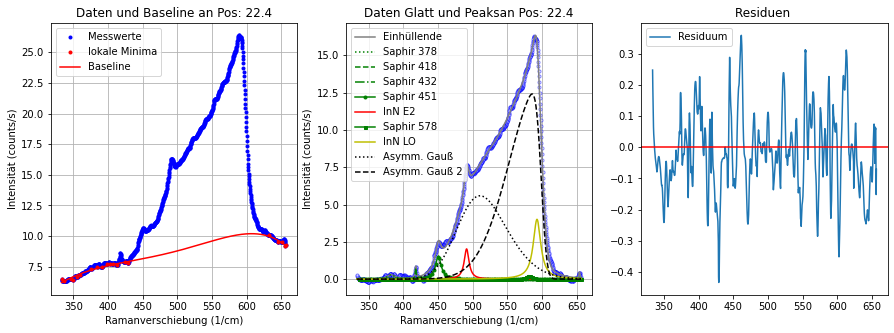

----------------------------------------------------------------------------------------------------
Position: 22.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.85491 8.856   8.81292 ... 5.91555 5.8606  5.76675]
Hintergrund Parameter:  [-3.48174773e-12  6.66038183e-09 -4.49943022e-06  1.14027836e-03
  6.32548846e-06 -2.22672340e+01]
Fitparameter Saphir 378: [0.2567938072250644, 11.114458317090207, 384.99999999988916]
Fitparameter Saphir 418: [0.35512035952650683, 1.0920165736108294, 418.0313896591128]
Fitparameter Saphir 432: [0.22215854319167255, 5.0917049833398975, 444.99999999999994]
Fitparameter Saphir 451: [1.2697993566559975, 9.999999999999998, 452.015555445326]
Fitparameter InN E2: [1.7393144079526872, 8.871601978673201, 490.7744503400501]
Fitparameter Saphir 578: [0.4193174030087792, 0.8723670736486786, 575.6390283490371]
Fitparameter InN LO: [3.448582721535872, 19.999999999999403, 593.0626911774042]
Fitparameter Saph

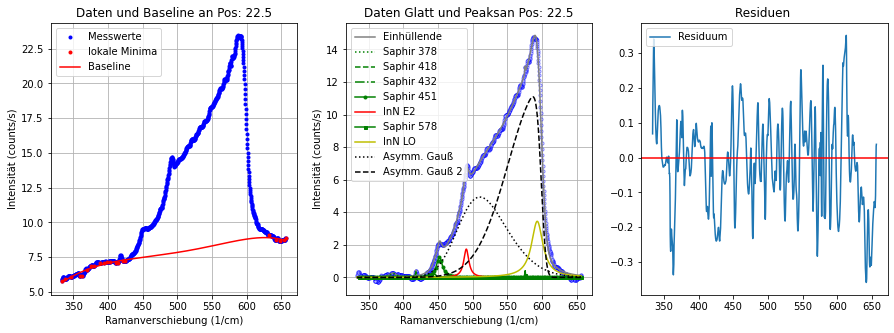

----------------------------------------------------------------------------------------------------
Position: 22.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.01593 7.9703  7.93069 ... 5.38801 5.37931 5.39079]
Hintergrund Parameter:  [ 1.33545820e-12 -4.24750846e-09  4.97785075e-06 -2.77727594e-03
  7.61470026e-01 -7.73941960e+01]
Fitparameter Saphir 378: [0.3233339574190331, 12.679713266360043, 380.04402759251565]
Fitparameter Saphir 418: [0.8721465803782759, 0.9526798228842263, 418.16701221266015]
Fitparameter Saphir 432: [8.80791591643958, 7.914940386390211e-14, 423.9759463545606]
Fitparameter Saphir 451: [1.2257611602143588, 9.999999999999998, 451.79277560854496]
Fitparameter InN E2: [1.7250925664415142, 8.86747670786321, 490.92828333576625]
Fitparameter Saphir 578: [0.12550863985917493, 1.0593026129137366, 574.6887933061507]
Fitparameter InN LO: [3.4546824618037713, 16.82069439193066, 592.9946417155505]
Fitparameter Sa

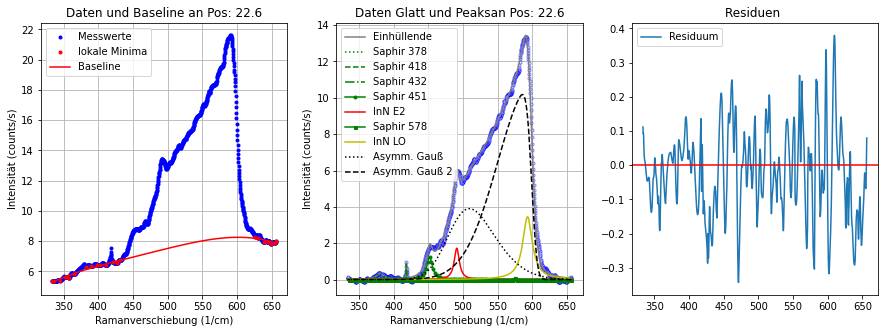

----------------------------------------------------------------------------------------------------
Position: 22.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [7.1974  7.23073 7.2865  ... 5.11576 5.09626 5.11384]
Hintergrund Parameter:  [-4.53330014e-12  8.37181972e-09 -5.44050018e-06  1.32062862e-03
  3.23545484e-11 -2.49166287e+01]
Fitparameter Saphir 378: [0.14087504683685612, 13.088192159549136, 384.99999805008116]
Fitparameter Saphir 418: [0.4338409256823511, 1.6993030804856815, 418.3114562086808]
Fitparameter Saphir 432: [5.117326523955433, 0.0344107411263078, 420.3271164896883]
Fitparameter Saphir 451: [1.2828966404007407, 9.999999999999998, 451.4919386879815]
Fitparameter InN E2: [1.553005201344343, 7.256559293139159, 490.66331505083997]
Fitparameter Saphir 578: [0.19457400343844602, 8.866745190159492, 580.9999999999999]
Fitparameter InN LO: [3.21944457056222, 16.28315506009293, 592.9730371852824]
Fitparameter Saphir 6

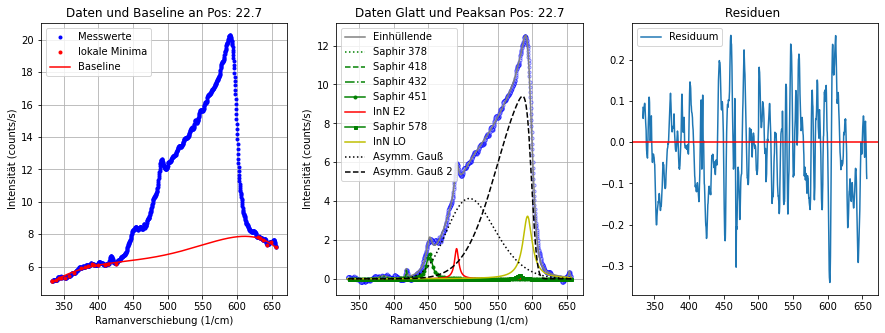

----------------------------------------------------------------------------------------------------
Position: 22.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.54103 6.59977 6.64904 ... 4.76136 4.7581  4.75655]
Hintergrund Parameter:  [-2.17115785e-12  3.85491993e-09 -2.43159990e-06  5.85141885e-04
  1.17032527e-10 -8.95507986e+00]
Fitparameter Saphir 378: [0.25652765298059044, 10.705917416017796, 382.9622664453579]
Fitparameter Saphir 418: [0.3687556059470665, 1.603845504430964, 418.35256865400004]
Fitparameter Saphir 432: [3.0094386505192238e-05, 1.0872624358504171e-05, 436.3981347791737]
Fitparameter Saphir 451: [1.1100772588067593, 9.999999999999998, 451.14905454710475]
Fitparameter InN E2: [1.2545283583494309, 8.77522741726677, 491.09022613447195]
Fitparameter Saphir 578: [0.05332012425765364, 0.5019093277039796, 574.3253297705085]
Fitparameter InN LO: [2.702230980774918, 18.261057447017407, 593.6795284758726]
Fitparame

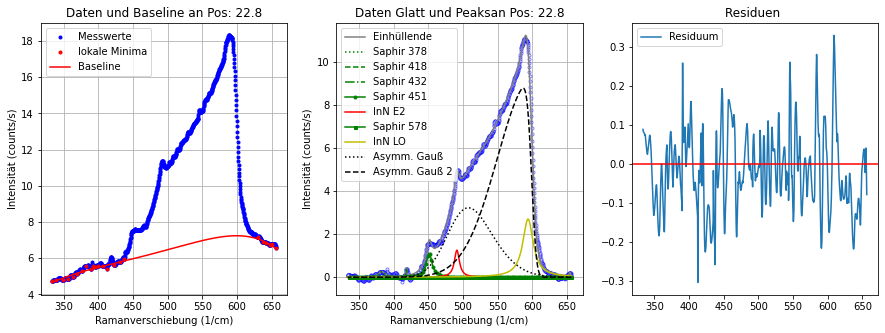

----------------------------------------------------------------------------------------------------
Position: 22.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.44361 6.53963 6.57249 ... 4.21522 4.17771 4.12994]
Hintergrund Parameter:  [ 6.62989894e-12 -1.70363443e-08  1.71737228e-05 -8.51612129e-03
  2.09212582e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.15049002672906464, 14.351980203792426, 382.93790284108024]
Fitparameter Saphir 418: [0.27779357019832074, 1.0813668170670727, 417.8720613423287]
Fitparameter Saphir 432: [0.07673305139211235, 1.8523359054506932, 444.99999999999994]
Fitparameter Saphir 451: [0.9050174755823591, 9.999999999999998, 451.6628445880136]
Fitparameter InN E2: [1.3037755249147343, 9.11736521808186, 491.3170863740347]
Fitparameter Saphir 578: [0.19321031138568334, 1.342181433885528, 577.2839361005066]
Fitparameter InN LO: [2.866301593065999, 17.312393573622277, 593.3238928095983]
Fitparameter Sap

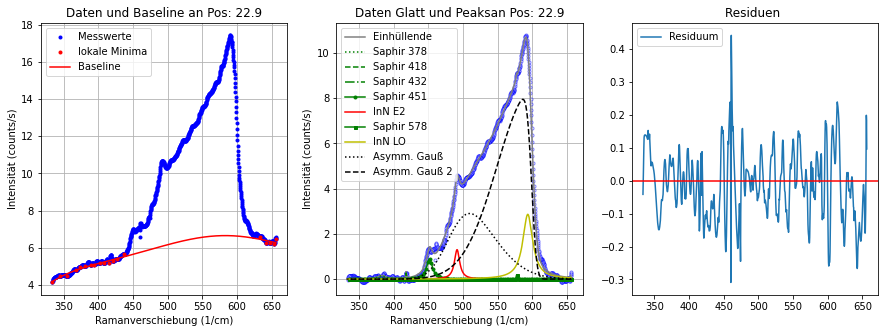

----------------------------------------------------------------------------------------------------
Position: 23.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.06158 5.98638 5.91301 ... 4.01294 4.01158 4.01275]
Hintergrund Parameter:  [-2.49350603e-12  4.68497590e-09 -3.10919359e-06  7.74721636e-04
  3.74132413e-10 -1.45647610e+01]
Fitparameter Saphir 378: [0.17077600429194947, 13.549056935943845, 384.99999999999994]
Fitparameter Saphir 418: [0.45451398384102093, 1.2896774671130211, 418.30895701321344]
Fitparameter Saphir 432: [3.303224294107984e-07, 2.1950940638905435e-10, 443.410854258756]
Fitparameter Saphir 451: [0.9292742764940174, 9.999999999999998, 451.4340501884382]
Fitparameter InN E2: [1.3712308939574913, 7.621351752705652, 491.31805632588595]
Fitparameter Saphir 578: [0.17028380952059166, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [2.450382388207712, 19.999999999999996, 593.9694356361609]
Fitparame

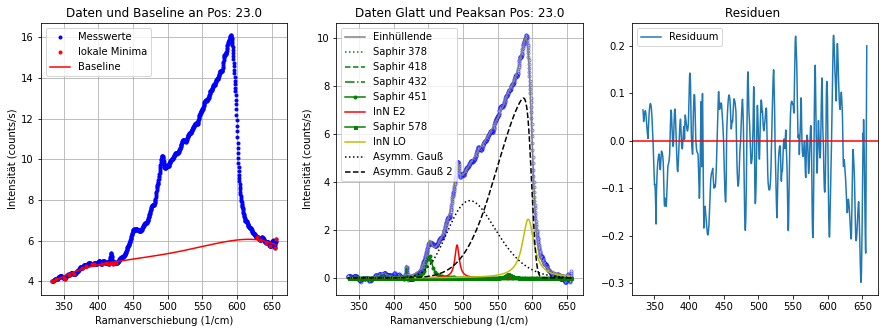

----------------------------------------------------------------------------------------------------
Position: 23.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.68716 5.71563 5.7327  ... 3.9728  3.96719 3.96126]
Hintergrund Parameter:  [ 1.93012736e-12 -5.14971855e-09  5.31391928e-06 -2.67626650e-03
  6.70203991e-01 -6.33011253e+01]
Fitparameter Saphir 378: [0.24148735493738072, 14.415706052667982, 380.990090248214]
Fitparameter Saphir 418: [0.4914562052573054, 1.5127482675576767, 418.09042050934374]
Fitparameter Saphir 432: [3.988219901407416e-06, 0.004985576822836903, 442.44114267367166]
Fitparameter Saphir 451: [0.7590242938499698, 9.999999999999998, 451.31757980527493]
Fitparameter InN E2: [1.1189434286120488, 7.9738144809335, 491.32126960994367]
Fitparameter Saphir 578: [0.11139683333246483, 4.1703140881376815, 580.9999999999999]
Fitparameter InN LO: [2.352299551454771, 19.66204741128971, 593.9961432522624]
Fitparameter 

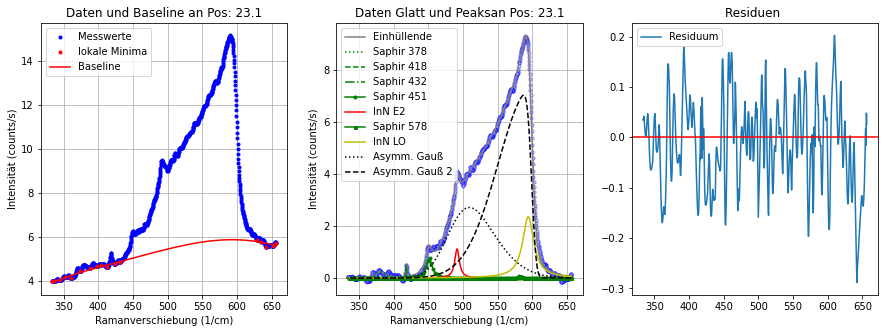

----------------------------------------------------------------------------------------------------
Position: 23.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.06758 5.0984  5.149   ... 3.77467 3.79513 3.79448]
Hintergrund Parameter:  [-1.28760376e-12  2.22872648e-09 -1.38411774e-06  3.34282902e-04
  3.44684423e-10 -4.40790140e+00]
Fitparameter Saphir 378: [0.17356351197101788, 15.485736993165851, 380.9881323225406]
Fitparameter Saphir 418: [0.17281378328909613, 0.9650406393213091, 417.5113028861643]
Fitparameter Saphir 432: [0.0006344770655381913, 0.00025526104814010926, 435.2799692066503]
Fitparameter Saphir 451: [0.7879393620156198, 9.999999999999998, 451.6415653491816]
Fitparameter InN E2: [1.0778080614848904, 6.376666370455221, 491.1260320639378]
Fitparameter Saphir 578: [2.719921719434222, 5.985987991220665e-05, 580.4154675737152]
Fitparameter InN LO: [2.143312964857582, 16.110508087683737, 593.6332819328499]
Fitparame

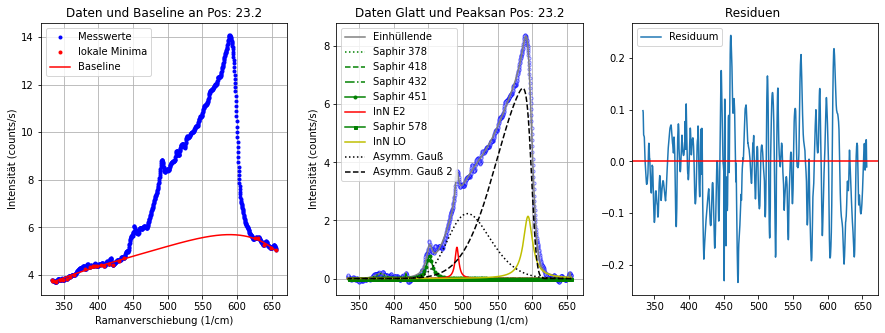

----------------------------------------------------------------------------------------------------
Position: 23.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.53007 4.60972 4.65526 ... 3.33434 3.32905 3.35489]
Hintergrund Parameter:  [-1.12232990e-12  2.04632664e-09 -1.34178587e-06  3.39647200e-04
  2.53635516e-10 -5.39864561e+00]
Fitparameter Saphir 378: [0.24880623451105927, 10.791057212399252, 380.1249062201925]
Fitparameter Saphir 418: [0.3416898824973573, 1.5021878372481519, 418.1668945431974]
Fitparameter Saphir 432: [0.03119451467326988, 0.00011048426684077029, 435.6361985243304]
Fitparameter Saphir 451: [0.5797315357787421, 9.99999999999992, 451.4363392495051]
Fitparameter InN E2: [1.0780170833269846, 6.762662782128893, 491.53791378014887]
Fitparameter Saphir 578: [0.11041233261114422, 1.0630634812949942, 575.8083985892621]
Fitparameter InN LO: [2.220465393731349, 19.99999994216468, 593.4051150431438]
Fitparameter S

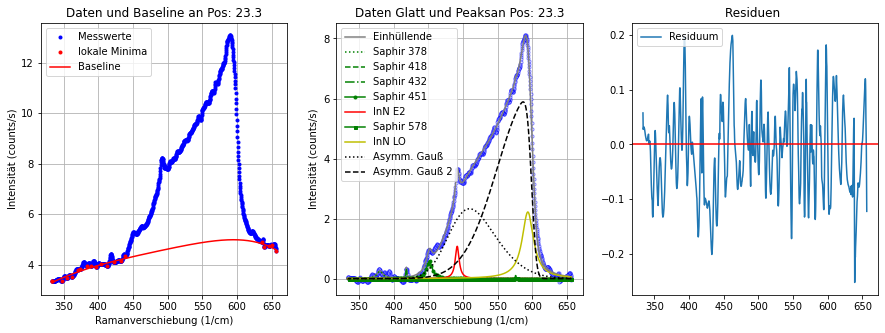

----------------------------------------------------------------------------------------------------
Position: 23.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.33419 4.38827 4.41931 ... 3.14118 3.15589 3.17866]
Hintergrund Parameter:  [-1.87843670e-12  3.45707068e-09 -2.24942944e-06  5.50843286e-04
  2.39051467e-10 -9.72164441e+00]
Fitparameter Saphir 378: [0.25061962064677834, 8.461786688990921, 379.03671618521076]
Fitparameter Saphir 418: [0.39390982243053757, 1.8194758587502637, 418.29206715354275]
Fitparameter Saphir 432: [0.19161441493699233, 3.2023353884590717, 444.99999999999994]
Fitparameter Saphir 451: [0.6733385900083572, 9.999999999999998, 451.7815480042959]
Fitparameter InN E2: [1.0135897069075457, 8.517136716319888, 491.4737219777192]
Fitparameter Saphir 578: [0.2583373664499118, 1.837910735306686, 579.3631909228063]
Fitparameter InN LO: [2.043131660531936, 19.082274849385055, 593.9999999999999]
Fitparameter Sap

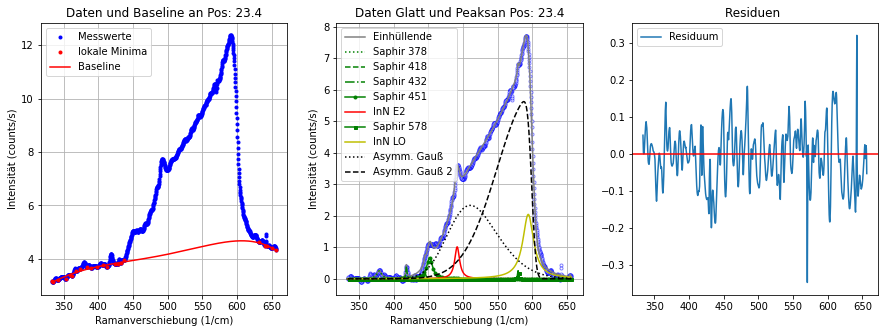

----------------------------------------------------------------------------------------------------
Position: 23.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.74744 4.65689 4.59937 ... 3.0527  3.03552 3.02227]
Hintergrund Parameter:  [ 6.08598476e-12 -1.58007649e-08  1.61789687e-05 -8.17747991e-03
  2.04725352e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.18357273192440413, 6.1455218957691935, 375.9171911001232]
Fitparameter Saphir 418: [0.39574163302820753, 1.2724738676559824, 418.22177430830055]
Fitparameter Saphir 432: [5.544291893476521e-05, 1.0783658930263799e-08, 424.8522914954501]
Fitparameter Saphir 451: [0.6342970875101761, 9.99999999960459, 451.37074163854624]
Fitparameter InN E2: [0.9730164836455472, 7.664644028433672, 491.3783799267391]
Fitparameter Saphir 578: [3.011026731427727e-21, 8.426637785549067, 577.9626695596319]
Fitparameter InN LO: [1.8001925047938456, 19.91500448211452, 593.9999999999958]
Fitparam

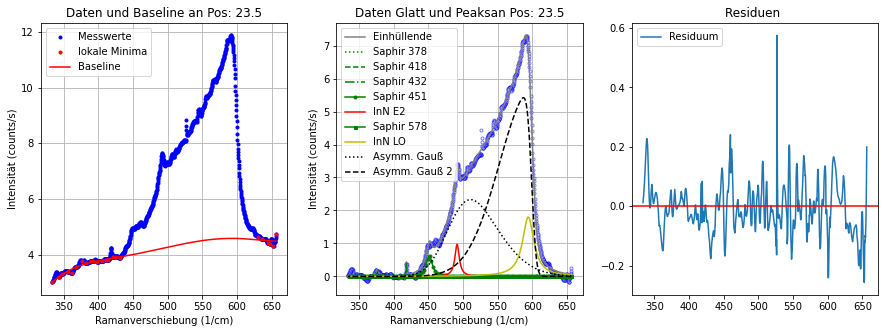

----------------------------------------------------------------------------------------------------
Position: 23.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.12304 4.1623  4.19492 ... 2.9183  2.92087 2.98916]
Hintergrund Parameter:  [ 1.23387574e-11 -2.77609102e-08  2.40712032e-05 -1.00180840e-02
  2.00000005e+00 -1.50000000e+02]
Fitparameter Saphir 378: [0.3341772571735492, 17.33618332965174, 378.71452629869617]
Fitparameter Saphir 418: [0.2287587994993942, 0.90668475330304, 417.9859667853483]
Fitparameter Saphir 432: [0.05675346054931905, 2.1021446714922836e-13, 428.7370459210903]
Fitparameter Saphir 451: [0.3235295424835188, 7.554776952929531, 453.77033215462507]
Fitparameter InN E2: [0.6935984388048999, 8.972005470896947, 490.8885638677106]
Fitparameter Saphir 578: [0.303541306485881, 6.084458951998991, 580.9999999999999]
Fitparameter InN LO: [1.852435763707495, 13.874106738097053, 593.7142340558364]
Fitparameter Saphi

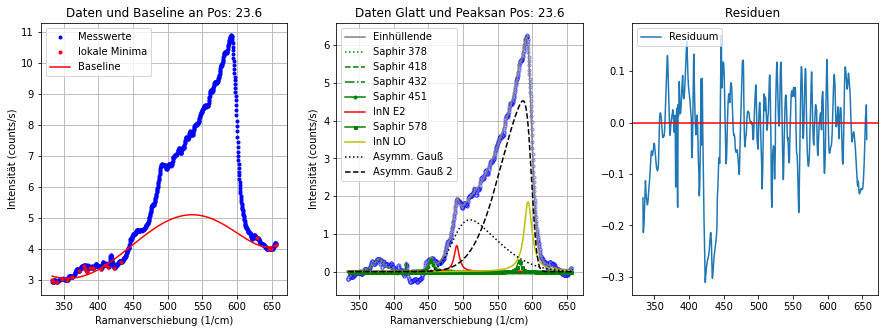

----------------------------------------------------------------------------------------------------
Position: 23.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.91146 3.77425 3.78777 ... 2.99652 3.0081  3.02074]
Hintergrund Parameter:  [-2.09536597e-12  3.81371280e-09 -2.44526569e-06  5.87113768e-04
  2.93069551e-10 -1.02118055e+01]
Fitparameter Saphir 378: [0.13891369715609014, 10.361729900765521, 382.6976968961765]
Fitparameter Saphir 418: [0.28769265497263946, 1.847148408597647, 418.00252857587634]
Fitparameter Saphir 432: [0.019075795043261682, 0.007323851586549834, 432.03939843553394]
Fitparameter Saphir 451: [0.6047154434547107, 9.999999999999998, 450.88157357340503]
Fitparameter InN E2: [0.8893308183980811, 7.025525750461335, 491.1919339144284]
Fitparameter Saphir 578: [0.1458527360209523, 2.4930296670005516, 579.2485408383435]
Fitparameter InN LO: [1.8904910598478954, 14.942792460566109, 593.4168376058807]
Fitparamete

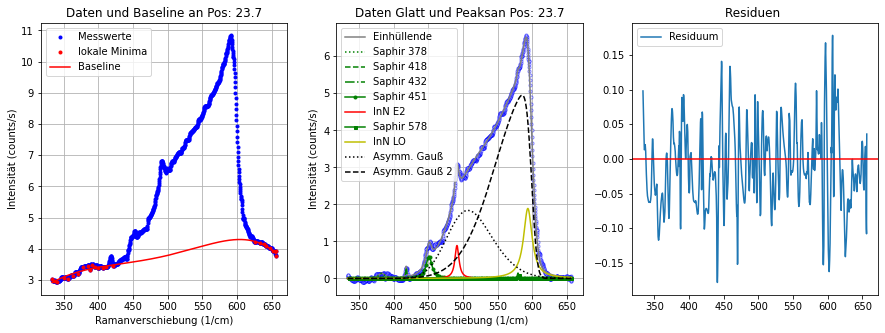

----------------------------------------------------------------------------------------------------
Position: 23.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.55034 3.56128 3.58596 ... 2.71424 2.73209 2.79037]
Hintergrund Parameter:  [ 1.34793442e-12 -3.94559397e-09  4.33308750e-06 -2.27256163e-03
  5.80623545e-01 -5.56768790e+01]
Fitparameter Saphir 378: [0.12324730399825085, 21.921391366484684, 384.99999999999994]
Fitparameter Saphir 418: [0.2800436015389177, 2.1664900746728204, 418.16556594109335]
Fitparameter Saphir 432: [0.6500379213631694, 0.054713414813358424, 429.9888165331855]
Fitparameter Saphir 451: [0.5707456399283807, 9.999999999999998, 451.71118853140484]
Fitparameter InN E2: [0.7887388317035084, 8.863264962856212, 491.1231595135323]
Fitparameter Saphir 578: [0.02599929149669327, 5.7969617149424035, 580.9999999999999]
Fitparameter InN LO: [1.6042535211829472, 14.978544968841751, 593.9999999999999]
Fitparameter

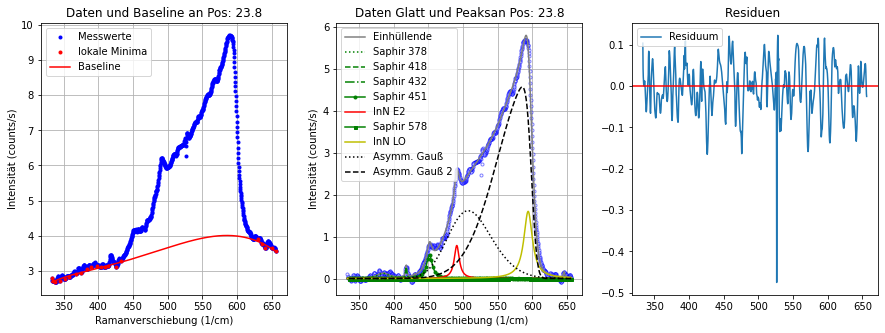

----------------------------------------------------------------------------------------------------
Position: 23.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.4878  3.50701 3.5222  ... 2.67071 2.67122 2.67318]
Hintergrund Parameter:  [ 1.91154668e-12 -4.93997891e-09  4.94056436e-06 -2.40524071e-03
  5.77739181e-01 -5.25835313e+01]
Fitparameter Saphir 378: [0.12823095373561919, 11.735545903513408, 382.2054241635826]
Fitparameter Saphir 418: [0.46502449839835563, 1.9380829431461257, 418.02749747509597]
Fitparameter Saphir 432: [2.2645646736658457e-05, 6.325204105414284e-06, 436.8921703262299]
Fitparameter Saphir 451: [0.5162597072223305, 9.999999999999998, 451.42576730119526]
Fitparameter InN E2: [0.7414481494162775, 10.032942770523736, 491.14380875616763]
Fitparameter Saphir 578: [0.24256558943040119, 1.8904656739593337, 580.9999999999999]
Fitparameter InN LO: [1.2797709562936446, 18.280908598770875, 593.9999999999999]
Fitpa

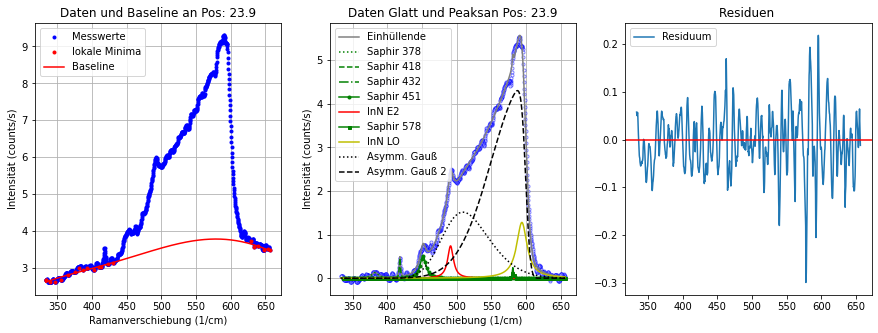

----------------------------------------------------------------------------------------------------
Position: 24.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.47895 3.44803 3.42045 ... 2.564   2.55543 2.54928]
Hintergrund Parameter:  [ 1.82450403e-12 -4.59074708e-09  4.51018545e-06 -2.17531336e-03
  5.22054642e-01 -4.77086220e+01]
Fitparameter Saphir 378: [0.11740584552713114, 17.285643785496642, 384.0688644850653]
Fitparameter Saphir 418: [0.26829050116375885, 1.5978656022565465, 417.7833749224898]
Fitparameter Saphir 432: [0.14458320793119364, 4.842717087799779, 444.99999999999994]
Fitparameter Saphir 451: [0.46634105507354895, 9.999999999999998, 452.816583488785]
Fitparameter InN E2: [0.5719372828989748, 9.882385834741923, 490.105583560129]
Fitparameter Saphir 578: [0.033677936121347826, 4.44423851658411, 580.9999999999999]
Fitparameter InN LO: [1.4492430841005022, 19.999999999972097, 593.9999999999999]
Fitparameter Saph

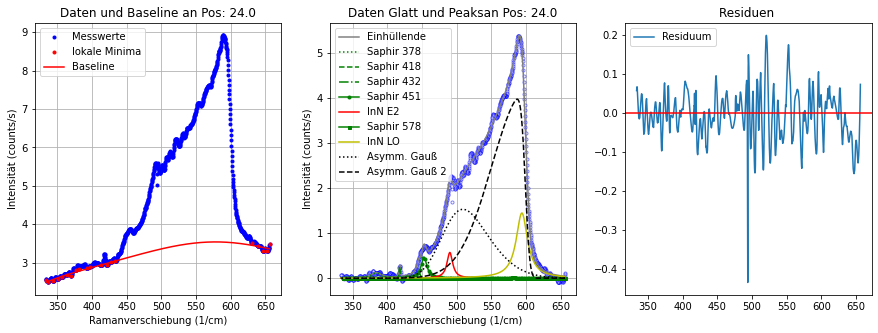

----------------------------------------------------------------------------------------------------
Position: 24.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.92432 3.00268 3.06932 ... 2.32406 2.32856 2.34161]
Hintergrund Parameter:  [-2.78647448e-13  4.02796051e-10 -2.05053975e-07  3.89186481e-05
  5.13889100e-03 -6.08519409e-07]
Fitparameter Saphir 378: [0.16991498223237272, 13.926158839946646, 377.9223570090013]
Fitparameter Saphir 418: [0.2680502780028008, 1.829242420676805, 417.8490036483536]
Fitparameter Saphir 432: [0.10327130303351835, 0.7352623071960296, 432.24717806138915]
Fitparameter Saphir 451: [0.4285869780865718, 9.999999999999998, 451.4088627687801]
Fitparameter InN E2: [0.6266668510995808, 7.527165863483708, 491.7220461106661]
Fitparameter Saphir 578: [0.13775391283859656, 2.1284563020569665, 567.2984014656756]
Fitparameter InN LO: [1.4526718897996935, 17.202249705317737, 593.1631129441303]
Fitparameter Sap

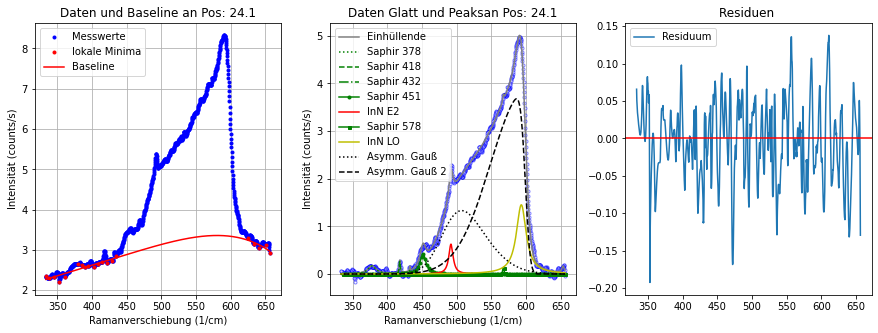

----------------------------------------------------------------------------------------------------
Position: 24.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.07804 3.04919 3.03167 ... 2.21597 2.18033 2.14181]
Hintergrund Parameter:  [ 6.36970134e-12 -1.64312595e-08  1.66968061e-05 -8.36120007e-03
  2.06815291e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.1342151811571355, 7.760051975926891, 380.88128493630984]
Fitparameter Saphir 418: [0.3030429257925915, 1.8741757474136356, 418.48523764669164]
Fitparameter Saphir 432: [2.3646927533981597e-05, 1.2447016123826269e-06, 428.3240033951497]
Fitparameter Saphir 451: [0.4538048793153701, 9.406539928999052, 451.82017393033817]
Fitparameter InN E2: [0.6960065549279619, 9.624588132742314, 491.5696885361902]
Fitparameter Saphir 578: [0.030357387849548417, 1.5745946699186892, 577.8249362894438]
Fitparameter InN LO: [1.297983145940199, 19.999999993645385, 593.9999999999992]
Fitparam

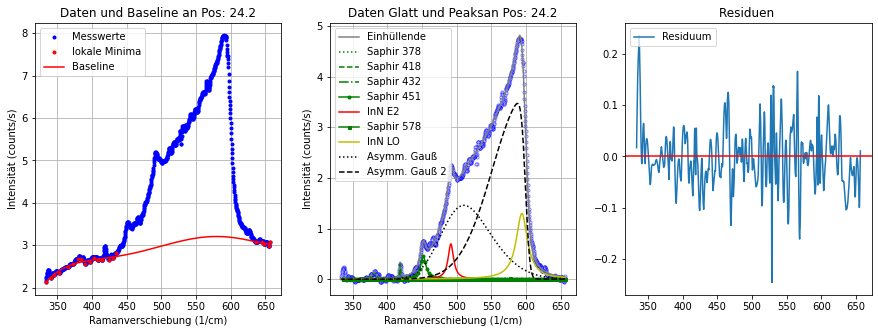

----------------------------------------------------------------------------------------------------
Position: 24.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.89364 2.76962 2.74305 ... 2.08831 2.1165  2.14029]
Hintergrund Parameter:  [ 3.04941327e-12 -7.75845431e-09  7.71066580e-06 -3.75426669e-03
  9.02234276e-01 -8.38811454e+01]
Fitparameter Saphir 378: [0.09534118744348341, 19.76148999105816, 379.7152166917819]
Fitparameter Saphir 418: [0.210939152212797, 3.063986180693761, 417.74987125008795]
Fitparameter Saphir 432: [0.013489667405393153, 0.0020527833276716536, 432.047251964705]
Fitparameter Saphir 451: [0.38562368554818827, 9.999999999999998, 450.3622600790516]
Fitparameter InN E2: [0.5851700104897074, 7.190587451960571, 491.9931890434425]
Fitparameter Saphir 578: [0.1285860317233229, 1.3317613799078623, 566.0546388911517]
Fitparameter InN LO: [1.0487371054462309, 19.999999999999265, 593.9999999999999]
Fitparameter Sa

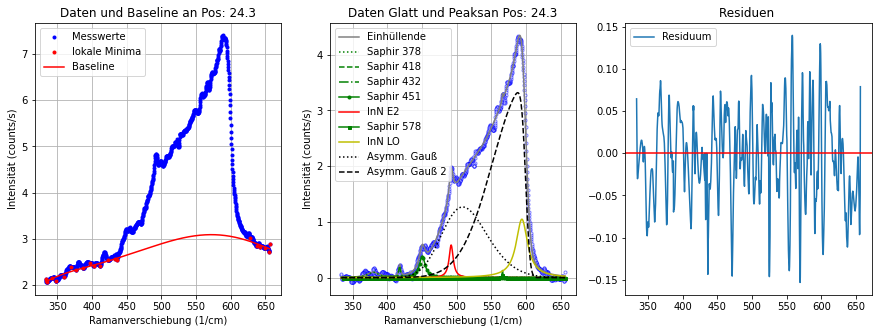

----------------------------------------------------------------------------------------------------
Position: 24.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.89223 2.90755 2.92067 ... 2.20038 2.20159 2.17379]
Hintergrund Parameter:  [ 6.36281287e-12 -1.55772724e-08  1.49430319e-05 -7.03114975e-03
  1.62981268e+00 -1.47229544e+02]
Fitparameter Saphir 378: [0.10947089213322389, 15.509529537693915, 380.72422183523685]
Fitparameter Saphir 418: [0.18701228801150094, 1.6928104189905309, 418.3188255271557]
Fitparameter Saphir 432: [1.4113173300537185, 0.03887678911798435, 424.50438147025227]
Fitparameter Saphir 451: [0.32253548517633024, 9.999999999999998, 450.67623797800053]
Fitparameter InN E2: [0.5548410249764294, 7.0608904899032785, 491.34113990270373]
Fitparameter Saphir 578: [0.17438558270554952, 1.9133319468416368, 568.3850738743868]
Fitparameter InN LO: [1.2279784010430355, 17.705592084484906, 593.9999999999999]
Fitparame

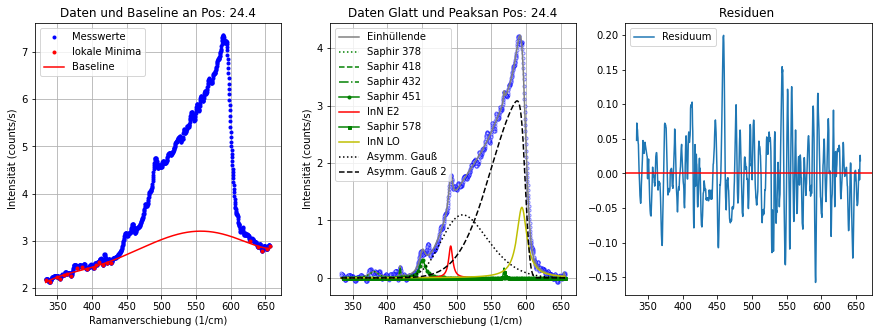

----------------------------------------------------------------------------------------------------
Position: 24.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.82827 2.80051 2.77293 ... 2.16705 2.20248 2.24274]
Hintergrund Parameter:  [ 1.42456309e-12 -2.86992990e-09  2.11541583e-06 -6.81080827e-04
  8.69391982e-02 -3.20773470e-08]
Fitparameter Saphir 378: [0.12942533054735308, 13.926999280542438, 382.1463091679908]
Fitparameter Saphir 418: [0.3739335254586012, 2.1693604482791438, 417.90243739918606]
Fitparameter Saphir 432: [1.7164906183097473e-11, 0.00041122754972248987, 420.0000006774193]
Fitparameter Saphir 451: [0.2838885034282811, 9.999999999999902, 451.1398856563852]
Fitparameter InN E2: [0.5335157507751715, 10.74534482209161, 490.7997029826609]
Fitparameter Saphir 578: [0.09391729197687361, 1.9462862655569437, 580.9999999997767]
Fitparameter InN LO: [1.151709415233366, 19.99999999999968, 593.9999999999998]
Fitparamet

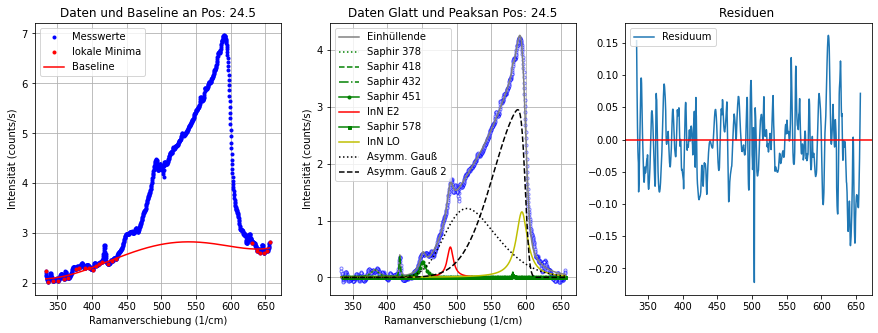

----------------------------------------------------------------------------------------------------
Position: 24.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.64176 2.67066 2.69403 ... 2.03726 2.0502  2.02227]
Hintergrund Parameter:  [ 8.58395703e-12 -2.10623092e-08  2.02470243e-05 -9.54029708e-03
  2.21049506e+00 -2.00000000e+02]
Fitparameter Saphir 378: [0.12582537414716197, 18.05712923342021, 383.38892210318085]
Fitparameter Saphir 418: [0.25588992044462083, 2.754615468157937, 417.92202796400665]
Fitparameter Saphir 432: [0.0031946348234199325, 9.927077591682984e-05, 431.7275372228477]
Fitparameter Saphir 451: [0.32470683482878016, 9.999999999999998, 451.17785964922103]
Fitparameter InN E2: [0.5802031218682452, 8.096799781553804, 491.55245876798955]
Fitparameter Saphir 578: [0.13210654338326513, 1.201904523763856, 576.252251386501]
Fitparameter InN LO: [1.0579766056056066, 16.14045354282987, 593.9999999999999]
Fitparamet

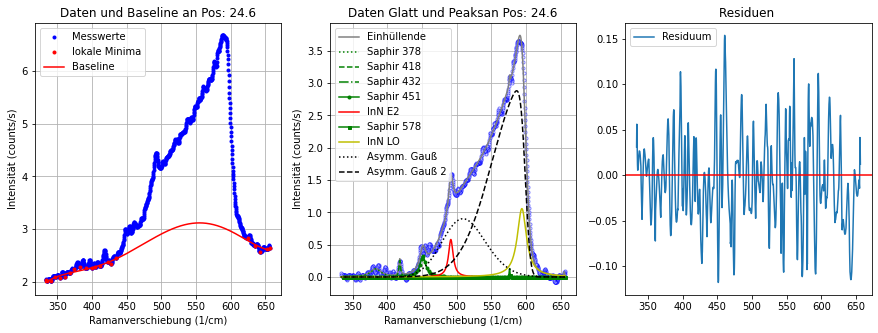

----------------------------------------------------------------------------------------------------
Position: 24.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.53729 2.5415  2.54871 ... 2.04887 2.02794 1.99621]
Hintergrund Parameter:  [ 6.72331052e-12 -1.63603470e-08  1.55673942e-05 -7.24931279e-03
  1.65895745e+00 -1.47825330e+02]
Fitparameter Saphir 378: [0.0923363644968871, 24.623576432626002, 380.08385032649875]
Fitparameter Saphir 418: [0.33182303094819027, 2.201082396491942, 417.8206610784796]
Fitparameter Saphir 432: [0.041674721232270714, 0.8029530690245451, 443.37397018402044]
Fitparameter Saphir 451: [0.3642940961100807, 9.999999999999998, 452.4692079846687]
Fitparameter InN E2: [0.5657101232329276, 10.161612102525275, 490.67988514328215]
Fitparameter Saphir 578: [0.09320193258503766, 2.523961562018214, 576.402490023106]
Fitparameter InN LO: [0.878368746236617, 14.984862654510934, 593.2852901790861]
Fitparameter Sa

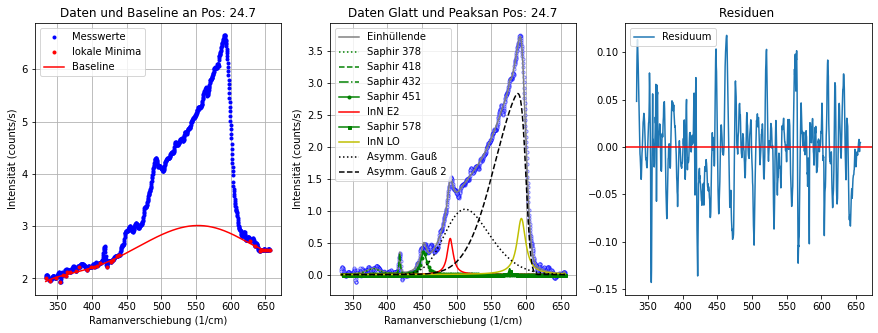

----------------------------------------------------------------------------------------------------
Position: 24.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.43827 2.47195 2.47686 ... 1.89107 1.87885 1.84319]
Hintergrund Parameter:  [ 6.38329858e-12 -1.57152579e-08  1.51873147e-05 -7.21078725e-03
  1.68793992e+00 -1.54352562e+02]
Fitparameter Saphir 378: [0.09987010702655097, 20.72900484803565, 383.89657639077]
Fitparameter Saphir 418: [0.20634445576122495, 2.304585428020797, 417.6005920212966]
Fitparameter Saphir 432: [0.055720191985771016, 1.4954057544387842, 444.99999999999824]
Fitparameter Saphir 451: [0.3900588858750633, 9.999999999999998, 450.8455561221551]
Fitparameter InN E2: [0.41445342656404927, 12.823276076149668, 491.9672838801029]
Fitparameter Saphir 578: [0.042307257741269144, 1.2188792315327284, 577.2000145025031]
Fitparameter InN LO: [1.0124080460987093, 19.925054474832134, 593.9999012047864]
Fitparameter S

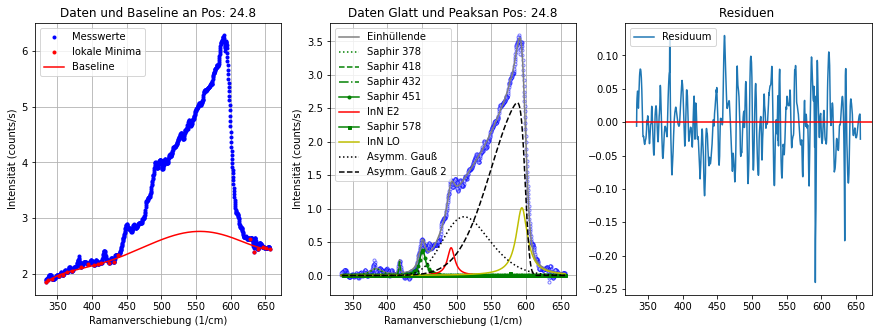

----------------------------------------------------------------------------------------------------
Position: 24.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.31535 2.34903 2.36962 ... 1.84663 1.86093 1.8862 ]
Hintergrund Parameter:  [ 4.05889537e-12 -1.02989804e-08  1.02168739e-05 -4.96588322e-03
  1.18883650e+00 -1.10625313e+02]
Fitparameter Saphir 378: [0.11551096794714584, 11.573610496900432, 381.9986515902586]
Fitparameter Saphir 418: [0.27525124521276256, 2.215603092659789, 417.96311580951004]
Fitparameter Saphir 432: [0.052149934772618624, 1.0415554155684512, 433.76061000505564]
Fitparameter Saphir 451: [0.2506271349176164, 9.999999999999998, 451.2180361430373]
Fitparameter InN E2: [0.363503194146204, 7.420004145316801, 490.9827393434631]
Fitparameter Saphir 578: [0.09011336999113194, 2.2800627461371854, 580.460535867606]
Fitparameter InN LO: [1.0767097471195421, 16.780597044512422, 593.6390036745407]
Fitparameter Sa

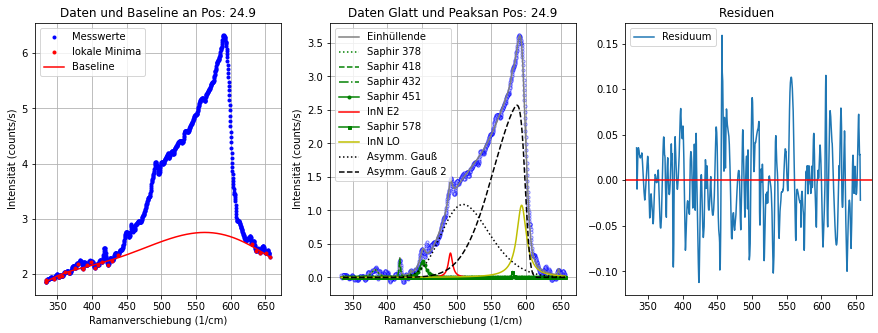

----------------------------------------------------------------------------------------------------
Position: 25.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [2.35247 2.35548 2.35697 ... 1.89189 1.90353 1.91347]
Hintergrund Parameter:  [ 8.34790512e-14 -2.38990821e-10  2.19214265e-07 -8.59258633e-05
  1.75648147e-02 -1.81096675e-07]
Fitparameter Saphir 378: [0.07368056975240109, 17.91415741271768, 378.8821624592948]
Fitparameter Saphir 418: [0.2245829341826762, 2.440904201577779, 417.76612590722044]
Fitparameter Saphir 432: [0.08136364373987927, 0.21340616428209044, 430.59657929453704]
Fitparameter Saphir 451: [0.33402715743639055, 9.999999999999998, 452.067906888612]
Fitparameter InN E2: [0.45157734549350403, 13.14472838868259, 490.49019969580576]
Fitparameter Saphir 578: [0.1471894886348136, 7.5710641445958595, 580.9999999999999]
Fitparameter InN LO: [0.9644925938771561, 17.04127431939212, 593.9999999999999]
Fitparameter Sa

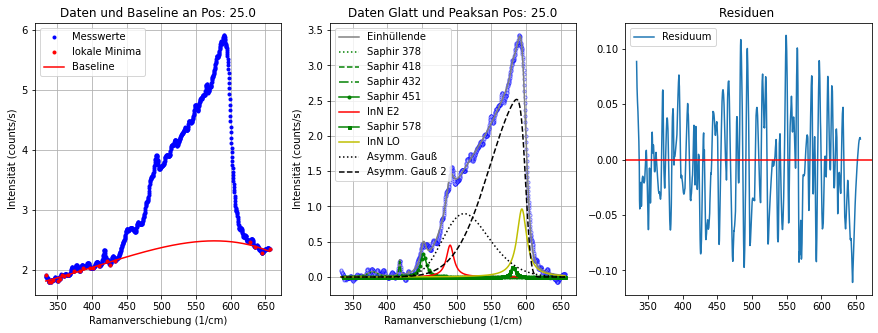

----------------------------------------------------------------------------------------------------


In [126]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Asymm_Gauß_1_Liste=[]
Asymm_Gauß_2_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_MEPA_D0_632nm_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_MEPA_D0_632nm_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_MEPA_D0_632nm_array_float[0],[0])
        y=np.delete(data_MEPA_D0_632nm_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=4)[0]]
        xzw=x[argrelextrema(y, np.less,order=4)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for j in range(len(xzw)):
            if xzw[j]<=440 or xzw[j]>=625:
                xmin.append(xzw[j])
                ymin.append(yzw[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1])   
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [0.1, 0.1, 0.1, 0.1, 2, -150]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf,0,-200],[np.inf,np.inf,np.inf,np.inf,3,0])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
  #      #fitten 4 lorentz in saphir_419, InN E2 492, InN LO 593 + 2Asymmetrischer Gauß
 #       #L_x3_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2)
#        init_vals_L_x3_AG_x2 = [1,1,419, 5,1,492, 1,1,593, 3,37,529,0.02, 5,17,580,0.01]
       # param_bounds_L_x3_AG_x2= ([0,0,410, 0,0,485, 0,0,585, 0,0,490,0, 0,0,535,0],[np.inf,5,430, np.inf,10,505, np.inf,30,605, np.inf,np.inf,540,np.inf, np.inf,np.inf,593,np.inf])
      #  fitParams_L_x3_AG_x2, cov_L_x3_AG_x2 = curve_fit(f=L_x3_AG_x2, xdata=x, ydata=y_glatt, p0=init_vals_L_x3_AG_x2, bounds=param_bounds_L_x3_AG_x2)
     #   fitParams_L_Saphir_418=[fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2]]
    #    fitParams_L_InN_E2=[fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5]]
   #     fitParams_L_InN_LO=[fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8]]
  #      fitParams_AG_1=[fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12]]
 #       fitParams_AG_2=[fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]]
#        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
       # print("Fitparameter InN E2:",fitParams_L_InN_E2)
      #  print("Fitparameter InN LO:",fitParams_L_InN_LO)
     #   print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
    #    print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)
   #     
  #      #plot 
 #       fig = plt.figure(figsize=(15,5))
#            # Plot 1 für Daten roh und baseline
     #   plt.subplot(1, 3, 1) 
    #    plt.title('Daten und Baseline an Pos: '+str(position))
   #     plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
  #      plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
 #       plt.plot(x, ybase,'r', label='Baseline Polynom 5ter Ordnung in lokalen minima') 
#        plt.xlabel('Ramanverschiebung (1/cm)')
#        plt.ylabel('Intensität (counts/s)')
       # plt.grid(True)
      #  plt.legend(loc='upper left')
     #   
    #        # Plot für Daten glatt und peaks
   #     plt.subplot(1, 3, 2)
  #      plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
 #       plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
#        plt.plot(x,L_x3_AG_x2(x, fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2], fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5],fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8],fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12],fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]), color='gray'  ,markersize=2, label='Einhüllende')
      #  plt.plot(x,Lorentz(x, fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2]), color='g'  ,markersize=3, label='Saphir 418')
     #   plt.plot(x,Lorentz(x, fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5]), color='r'  ,markersize=3, label='InN E2')
    #    plt.plot(x,Lorentz(x, fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8]), color='y'  ,markersize=3, label='InN LO')
   #     plt.plot(x,asymmgauss(x, fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
  #      plt.plot(x,asymmgauss(x, fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
 #       plt.xlabel('Ramanverschiebung (1/cm)')
#        plt.ylabel('Intensität (counts/s)')
#        plt.grid(True)
#        plt.legend(loc='upper left')
#        
#            # Plot Residuen Fitt
#        plt.subplot(1, 3, 3)
#        plt.title('Residuen ')
#        plt.plot(x,y_glatt-L_x3_AG_x2(x, fitParams_L_x3_AG_x2[0],fitParams_L_x3_AG_x2[1],fitParams_L_x3_AG_x2[2], fitParams_L_x3_AG_x2[3],fitParams_L_x3_AG_x2[4],fitParams_L_x3_AG_x2[5],fitParams_L_x3_AG_x2[6],fitParams_L_x3_AG_x2[7],fitParams_L_x3_AG_x2[8],fitParams_L_x3_AG_x2[9],fitParams_L_x3_AG_x2[10],fitParams_L_x3_AG_x2[11],fitParams_L_x3_AG_x2[12],fitParams_L_x3_AG_x2[13],fitParams_L_x3_AG_x2[14],fitParams_L_x3_AG_x2[15],fitParams_L_x3_AG_x2[16]), label=("a-plane Residuum"))
#        plt.axhline(y = 0, color = 'r', linestyle = '-')
#        #plt.grid(True)
#        plt.legend(loc='upper left')
        
        
        
        #fitten 4 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 488, saphir_578, InN LO 595, saphir_645, saphir_751,
        #+ 2Asymmetrischer Gauß
        #L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
        # 9 Lorentzpeaks + 2 Asymmetrischer gauß
        init_vals_L_x9_AG_x2 = [1,1,378, 1,1,418, 1,1,432, 1,1,451, 1,1,488, 1,1,578, 1,18,591, 1,1,645, 1,1,751, 1,45,484,1.7, 1,47,610,-9]
        param_bounds_L_x9_AG_x2= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,485, 0,0,565, 0,0,587, 0,0,635, 0,0,735, 0,40,482,0, 0,40,599,-30],
                                  [np.inf,np.inf,385, np.inf,np.inf,425, np.inf,np.inf,445, np.inf,10,460, np.inf,np.inf,510, np.inf,10,581, np.inf,20,594, np.inf,np.inf,655, np.inf,np.inf,760, np.inf,np.inf,525,5, np.inf,np.inf,615,0])
        fitParams_L_x9_AG_x2, cov_L_x9_AG_x2 = curve_fit(f=L_x9_AG_x2, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x2, bounds=param_bounds_L_x9_AG_x2)
        fitParams_L_Saphir_378=[fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2]]
        fitParams_L_Saphir_418=[fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5]]
        fitParams_L_Saphir_432=[fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8]]
        fitParams_L_Saphir_451=[fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11]]
        fitParams_L_InN_E2=[fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14]]
        fitParams_L_Saphir_578=[fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17]]
        fitParams_L_InN_LO=[fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20]]
        fitParams_L_Saphir_645=[fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23]]
        fitParams_L_Saphir_751=[fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26]]
        fitParams_AG_1=[fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30]]
        fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
        print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
        print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter Saphir 645:",fitParams_L_Saphir_645)
        print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
        print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
        print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)



        # plotten
        fig = plt.figure(figsize=(15,5))
        # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x9_AG_x2(x, fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2],fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5],fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8],fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11],fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14],fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17],fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20],fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23],fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26],fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30],fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]), color='gray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
        plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
        plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_645[0],fitParams_L_Saphir_645[1],fitParams_L_Saphir_645[2]),'-d', markevery=8, color='g'  ,markersize=3, label='Saphir 645')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
        plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
        plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        plt.plot(x,y_glatt-L_x9_AG_x2(x, fitParams_L_x9_AG_x2[0],fitParams_L_x9_AG_x2[1],fitParams_L_x9_AG_x2[2],fitParams_L_x9_AG_x2[3],fitParams_L_x9_AG_x2[4],fitParams_L_x9_AG_x2[5],fitParams_L_x9_AG_x2[6],fitParams_L_x9_AG_x2[7],fitParams_L_x9_AG_x2[8],fitParams_L_x9_AG_x2[9],fitParams_L_x9_AG_x2[10],fitParams_L_x9_AG_x2[11],fitParams_L_x9_AG_x2[12],fitParams_L_x9_AG_x2[13],fitParams_L_x9_AG_x2[14],fitParams_L_x9_AG_x2[15],fitParams_L_x9_AG_x2[16],fitParams_L_x9_AG_x2[17],fitParams_L_x9_AG_x2[18],fitParams_L_x9_AG_x2[19],fitParams_L_x9_AG_x2[20],fitParams_L_x9_AG_x2[21],fitParams_L_x9_AG_x2[22],fitParams_L_x9_AG_x2[23],fitParams_L_x9_AG_x2[24],fitParams_L_x9_AG_x2[25],fitParams_L_x9_AG_x2[26],fitParams_L_x9_AG_x2[27],fitParams_L_x9_AG_x2[28],fitParams_L_x9_AG_x2[29],fitParams_L_x9_AG_x2[30],fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
        
        
        
        
        if i == data_MEPA_D0_632nm_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/MEPA Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/MEPA Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == data_MEPA_D0_632nm_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/MEPA Auswertung D0 632nm Position '+ str(position) + '.png')
            
        plt.show()
        
        
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Saphir_418_Peaks_Liste.append([position, fitParams_L_Saphir_418])
        Asymm_Gauß_1_Liste.append([position,fitParams_AG_1])
        Asymm_Gauß_2_Liste.append([position,fitParams_AG_2])
        Baseline_Liste.append([position,fitParams_base])
        
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

asymm gauß 1
asymm gauß 2


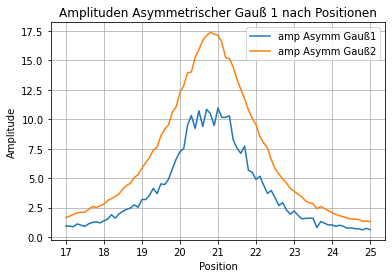

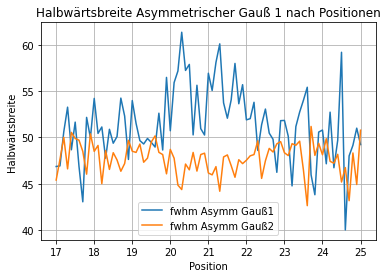

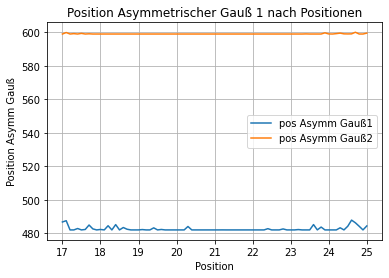

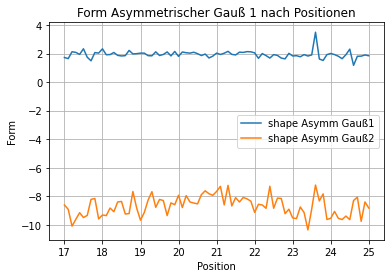

---------------------------------------------------------------------------------


In [127]:
# Verhalten Asymmetrischer Gauß und Baseline
# mittlung der Asymm Gauß parameter und abweichungen

print("asymm gauß 1")
Positionen=[]
Asymm_Gauß_1_Liste_Amp=[]
Asymm_Gauß_1_Liste_fwhm=[]
Asymm_Gauß_1_Liste_pos=[]
Asymm_Gauß_1_Liste_shape=[]
for i in range(len(Asymm_Gauß_1_Liste)):
    Positionen.append(Asymm_Gauß_1_Liste[i][0])
    Asymm_Gauß_1_Liste_Amp.append(Asymm_Gauß_1_Liste[i][1][0])
    Asymm_Gauß_1_Liste_fwhm.append(Asymm_Gauß_1_Liste[i][1][1])
    Asymm_Gauß_1_Liste_pos.append(Asymm_Gauß_1_Liste[i][1][2])
    Asymm_Gauß_1_Liste_shape.append(Asymm_Gauß_1_Liste[i][1][3])
    
#print("Asymmetrischer Gauß 1 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_Amp), "\nMin: ", min(Asymm_Gauß_1_Liste_Amp))

#print("Asymmetrischer Gauß 1 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_1_Liste_fwhm))

#print("Asymmetrischer Gauß 1 Position:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_pos), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_pos), "\nMin: ", min(Asymm_Gauß_1_Liste_pos))

#print("Asymmetrischer Gauß 1 Form:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_shape), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_shape), "\nMin: ", min(Asymm_Gauß_1_Liste_shape))

print("asymm gauß 2")
Positionen=[]
Asymm_Gauß_2_Liste_Amp=[]
Asymm_Gauß_2_Liste_fwhm=[]
Asymm_Gauß_2_Liste_pos=[]
Asymm_Gauß_2_Liste_shape=[]
for j in range(len(Asymm_Gauß_2_Liste)):
    Positionen.append(Asymm_Gauß_2_Liste[j][0])
    Asymm_Gauß_2_Liste_Amp.append(Asymm_Gauß_2_Liste[j][1][0])
    Asymm_Gauß_2_Liste_fwhm.append(Asymm_Gauß_2_Liste[j][1][1])
    Asymm_Gauß_2_Liste_pos.append(Asymm_Gauß_2_Liste[j][1][2])
    Asymm_Gauß_2_Liste_shape.append(Asymm_Gauß_2_Liste[j][1][3])
    
#print("Asymmetrischer Gauß 2 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_2_Liste_Amp), "\nMin: ", min(Asymm_Gauß_2_Liste_Amp))

#print("Asymmetrischer Gauß 2 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_2_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_2_Liste_fwhm))

#print("Asymmetrischer Gauß 2 Position:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_pos), 
 #     "\nMax: ", max(Asymm_Gauß_2_Liste_pos), "\nMin: ", min(Asymm_Gauß_2_Liste_pos))

#print("Asymmetrischer Gauß 2 Form:", "\nMittel: ", np.mean(Asymm_Gauß_2_Liste_shape), 
 #     "\nMax: ", max(Asymm_Gauß_2_Liste_shape), "\nMin: ", min(Asymm_Gauß_2_Liste_shape))

#Plotten
plt.title('Amplituden Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_Amp ,markersize=2, label='amp Asymm Gauß1') 
plt.plot(Positionen, Asymm_Gauß_2_Liste_Amp ,markersize=2, label='amp Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Halbwärtsbreite Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß1') 
plt.plot(Positionen, Asymm_Gauß_2_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Halbwärtsbreite')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Position Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_pos ,markersize=2, label='pos Asymm Gauß1') 
plt.plot(Positionen, Asymm_Gauß_2_Liste_pos ,markersize=2, label='pos Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Position Asymm Gauß')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Form Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_shape ,markersize=2, label='shape Asymm Gauß1')
plt.plot(Positionen, Asymm_Gauß_2_Liste_shape ,markersize=2, label='shape Asymm Gauß2') 
plt.xlabel('Position')
plt.ylabel('Form')
plt.grid(True)
plt.legend()
plt.show()

print("---------------------------------------------------------------------------------")
#---------------------------------------------------------------------------------


#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
 #   Base_Para_3.append(Baseline_Liste[k][1][2])
#    Base_Para_4.append(Baseline_Liste[k][1][3])
#    Base_Para_5.append(Baseline_Liste[k][1][4])
#    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')#
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [ 3.88721285  1.29751135 21.50822501 -1.09665393  0.66602717]
Asym Gauß LO Parameter Amp-R: [ 6.99134404  1.24789325 21.34259736 -0.75333214  1.33686074]
Gauß E2 Parameter Amp-R: [ 5.83345942  2.54077711 20.79241073 -0.09070083]
Gauß LO Parameter Amp-R: [ 9.70734979e+00 -2.69759805e+00  2.07651352e+01 -5.02159273e-04]


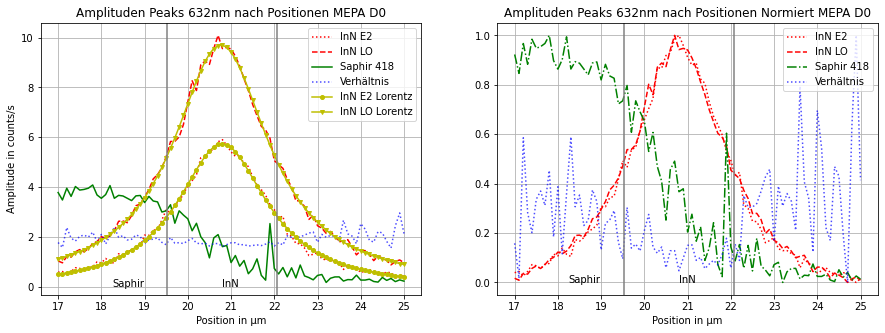

In [128]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_Saphir_418_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])
 
    
Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    
#Fitten Asym Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss_und_Konstante(x,amp,fwhm, pos, shape, h):
#    #scew normal distribution
#    normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#    normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#    return 2*normpdf*normcdf + h

init_vals_AG_E2 = [1,1,21,0,2]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,21,0,1]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO)     
    

#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,21,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,21,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 

    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden Peaks 632nm nach Positionen MEPA D0')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_Amp, color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp,':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='InN E2 Fitt')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='InN LO Fitt')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')
      
plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden Peaks 632nm nach Positionen Normiert MEPA D0')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2,label='Verhältnis') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_632nm/MEPA Amplituden Peaks nach Positionen D0 632nm')
plt.show()

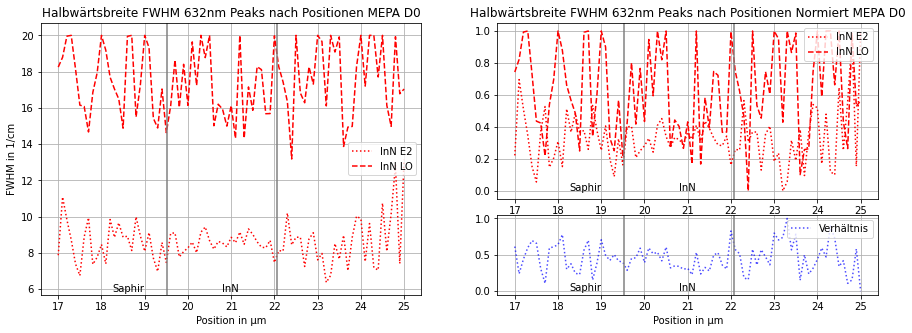

In [129]:
# Halbwärtsbreiten fwhm nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_Saphir_418_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
    
#Plotten
#fig = plt.figure(figsize=(15,5))
#plt.subplot(1, 2, 1) 
#plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen MEPA D0')
#plt.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_fwhm, ':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.xlabel('Position')
#plt.ylabel('Halbwärtsbreite fwhm')
#plt.grid(True)
#plt.legend(loc='upper right')
#plt.subplot(1, 2, 2) 
#plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen Normiert MEPA D0')
#plt.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.xlabel('Position')
#plt.ylabel('Amplitude')
#plt.grid(True)
#plt.legend(loc='upper right')


fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='center right')
ax1.set_title("Halbwärtsbreite FWHM 632nm Peaks nach Positionen MEPA D0")
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm)-0.5,s='InN')
ax1.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_InN_E2_fwhm)-0.5,s='Saphir')


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
ax2.set_title("Halbwärtsbreite FWHM 632nm Peaks nach Positionen Normiert MEPA D0")
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.text(x=fitParams_G_E2[2],y=0,s='InN')
ax2.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position in \u03bcm')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=0,s='InN')
ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')


plt.savefig('Bilder_Graphen_632nm/MEPA Halbwärtsbreite fwhm Peaks nach Positionen D0 632nm')
plt.show()

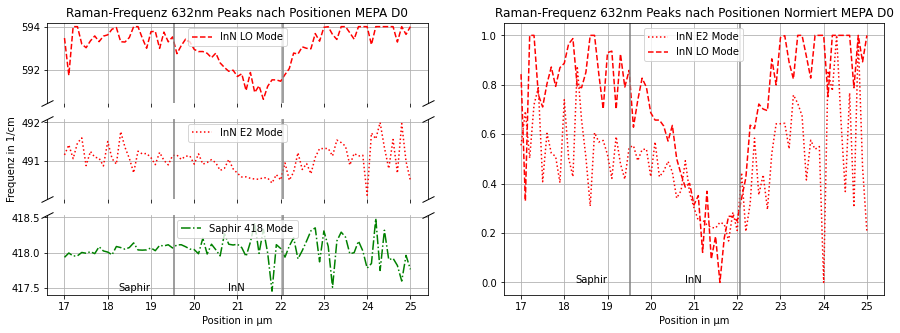

In [130]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_Saphir_418_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
 
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_Saphir_418_w,'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_w),s='InN')
ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Peak_Saphir_418_w),s='Saphir')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz in 1/cm')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 632nm Peaks nach Positionen MEPA D0")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_w),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz 632nm Peaks nach Positionen Normiert MEPA D0")
ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2],y=0,s='InN')
ax4.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=0,s='Saphir')

plt.savefig('Bilder_Graphen_632nm/MEPA Raman-Frequenz Peaks nach Positionen D0 632nm')
plt.show()

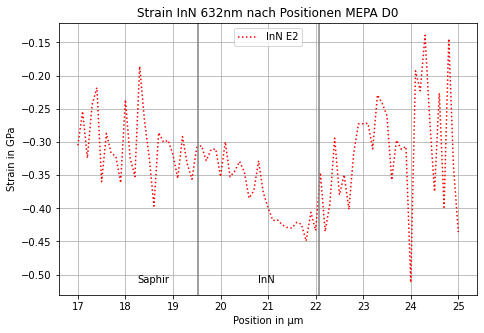

In [131]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain InN 632nm nach Positionen MEPA D0')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1],y=min(Strain_InN_E2_Liste),s='Saphir')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_632nm/MEPA Strain nach Positionen D0 632nm')
plt.show()

## A-plane

Probenoberfläche vor Messung
<img src="Daten_632nm/a-plane_Mapping_632nm_Bild1a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten_632nm/a-plane_Mapping_632nm_Bild1b.jpg" style="width:300px;"/>

### Datenladen

In [132]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "Aplane_Mapping_632nm_Bild1_D0_2x60s.txt") as f1:
        data_aPlane_632nm_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_aPlane_632nm_array_str = np.array(data_aPlane_632nm_txt)               #in np array umwandeln um listen von listen zu entkommen
data_aPlane_632nm_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_aPlane_632nm_array_float = data_aPlane_632nm_array_str.astype(float)   #str zu float in Arrayform
print(data_aPlane_632nm_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_aPlane_632nm_array_float[0])):
    data_aPlane_632nm_array_float[0][k]=data_aPlane_632nm_array_float[0][k]-Verschiebung_A_plane
print(data_aPlane_632nm_array_float)

[[  0.       657.95062  657.64545  ... 335.83398  335.50693  335.17987 ]
 [  5.         1.81865    1.77631  ...   1.86689    1.86772    1.86995 ]
 [  5.1        1.95712    1.93513  ...   1.88961    1.92196    1.94331 ]
 ...
 [  9.8        1.11544    1.11662  ...   0.984776   0.983955   0.982876]
 [  9.9        1.04426    0.981504 ...   0.991127   0.99449    1.00013 ]
 [ 10.         0.928635   0.935192 ...   1.00008    0.992045   0.969083]]
[[ -1.35381074 656.59680926 656.29163926 ... 334.48016926 334.15311926
  333.82605926]
 [  5.           1.81865      1.77631    ...   1.86689      1.86772
    1.86995   ]
 [  5.1          1.95712      1.93513    ...   1.88961      1.92196
    1.94331   ]
 ...
 [  9.8          1.11544      1.11662    ...   0.984776     0.983955
    0.982876  ]
 [  9.9          1.04426      0.981504   ...   0.991127     0.99449
    1.00013   ]
 [ 10.           0.928635     0.935192   ...   1.00008      0.992045
    0.969083  ]]


### Fitten und Plotten

Position: 5.0
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.81865 1.77631 1.78719 ... 1.86689 1.86772 1.86995]
Hintergrund Parameter:  [ 4.38738955e-13 -5.90431703e-10  1.00000000e-08  2.88941907e-04
 -1.36886040e-01  2.04743820e+01]
Fitparameter Saphir 378: [1.0976502588681882, 2.376366349822278, 379.55449092815314]
Fitparameter Saphir 418: [4.523601113831826, 1.69680258117853, 417.99959401288925]
Fitparameter Saphir 432: [0.04283481213084489, 0.4760905981651718, 430.0853377561236]
Fitparameter Saphir 451: [0.2826163854210901, 7.524096085185587, 448.75887441262086]
Fitparameter InN E2: [1.0030578115809123, 6.895844595695573, 491.9285648001362]
Fitparameter Saphir 578: [0.21648014784645303, 3.5940717563035994e-16, 569.6837044377818]
Fitparameter InN LO: [2.874701777568559, 13.520224755277068, 597.8067255964802]
Fitparameter Saphir 645: [2.6258222604255255, 1.4021191446370935e-18, 652.1443026871476]
Fitparameter Saphir 751: [1.

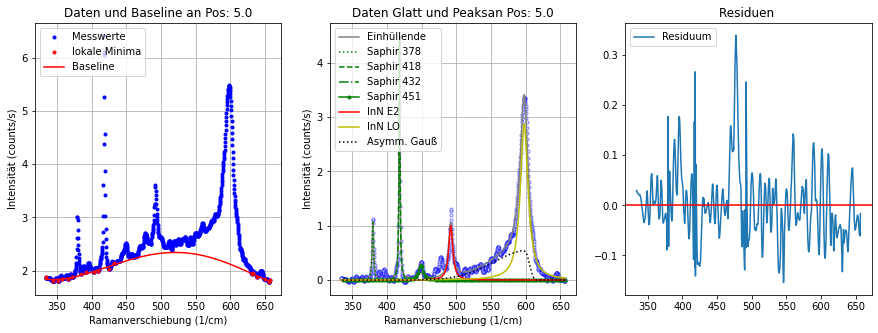

----------------------------------------------------------------------------------------------------
Position: 5.1
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.95712 1.93513 1.91837 ... 1.88961 1.92196 1.94331]
Hintergrund Parameter:  [ 1.58266985e-13 -2.22637126e-10  1.00000000e-08  9.88158037e-05
 -4.35155052e-02  7.12688306e+00]
Fitparameter Saphir 378: [0.9723279810619228, 2.859644714081492, 379.52459270661825]
Fitparameter Saphir 418: [4.64655466522402, 1.4956627954171093, 418.0006645458924]
Fitparameter Saphir 432: [0.005067827104772336, 0.007730866879714209, 431.22735611796674]
Fitparameter Saphir 451: [0.26824415681752656, 7.112613151576116, 449.88040041169177]
Fitparameter InN E2: [0.9975754040198941, 9.100676715269863, 491.5533859313465]
Fitparameter Saphir 578: [0.0003964727277999366, 4.6590608889387206e-05, 580.6091566202479]
Fitparameter InN LO: [2.883250449985848, 13.937522917295825, 597.4837017854718]
Fitparame

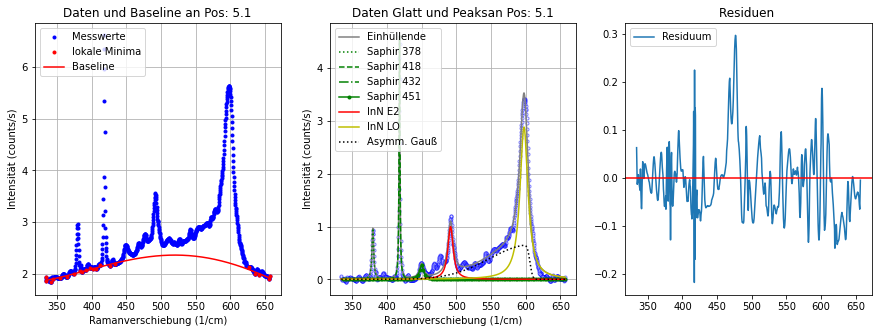

----------------------------------------------------------------------------------------------------
Position: 5.2
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [2.1049  2.1032  2.09693 ... 2.104   2.10298 2.12063]
Hintergrund Parameter:  [ 1.36317602e-13 -2.24283510e-10  1.00000000e-08  1.23482692e-04
 -5.92939574e-02  9.99039668e+00]
Fitparameter Saphir 378: [1.1116387245385435, 2.183907285106032, 379.5119245707941]
Fitparameter Saphir 418: [4.3572956362258894, 1.6772407017541122, 418.05086733827943]
Fitparameter Saphir 432: [0.09600135819682803, 1.0918147206891575, 431.0774343140549]
Fitparameter Saphir 451: [0.29140949472928346, 6.661365729371085, 450.2732029621087]
Fitparameter InN E2: [1.0576073495040035, 8.862330514552413, 491.4127349680395]
Fitparameter Saphir 578: [0.15167916109035162, 2.65999793867522, 578.7164418726103]
Fitparameter InN LO: [3.218335680437679, 13.086522411787051, 597.6066691702313]
Fitparameter Saphir 

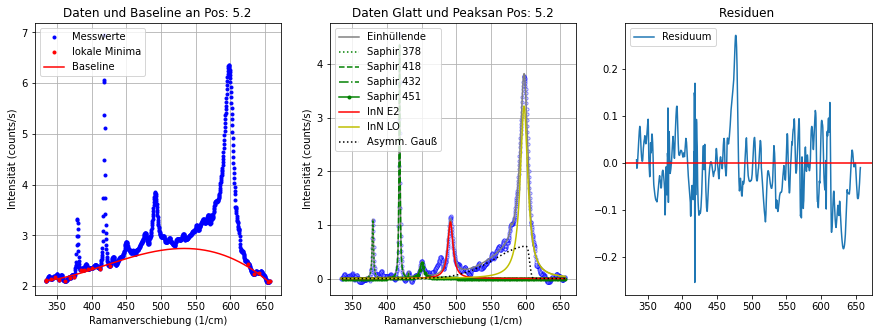

----------------------------------------------------------------------------------------------------
Position: 5.3
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [2.2283  2.2659  2.29733 ... 2.30939 2.2944  2.26703]
Hintergrund Parameter:  [ 3.64989085e-13 -4.85247321e-10  1.00000000e-08  2.21895804e-04
 -9.98692630e-02  1.49952877e+01]
Fitparameter Saphir 378: [1.1512752632223, 2.0387866101945713, 379.591957119544]
Fitparameter Saphir 418: [4.471038253075159, 1.5661127632298832, 418.0591514789989]
Fitparameter Saphir 432: [3.5986756764750255e-07, 2.9669632938442556e-07, 420.00484268016356]
Fitparameter Saphir 451: [0.2725286632343763, 9.999999999999998, 450.23934635542196]
Fitparameter InN E2: [1.0660610732483458, 11.763933649140064, 491.44699583555314]
Fitparameter Saphir 578: [4.037781727539368, 0.015914846631007114, 581.5906427368809]
Fitparameter InN LO: [3.5778292476971503, 12.967425621759718, 597.5255609109704]
Fitparameter

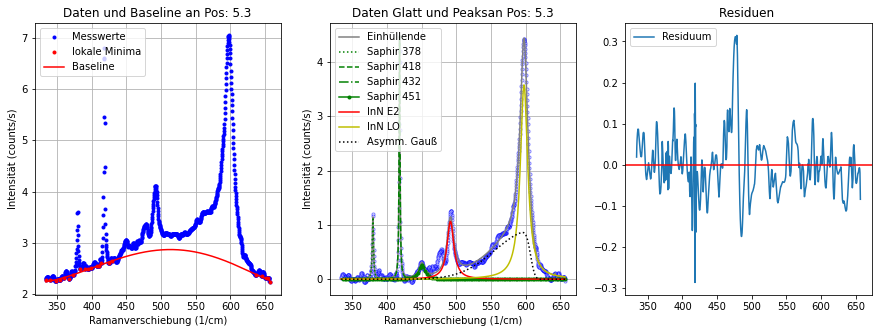

----------------------------------------------------------------------------------------------------
Position: 5.4
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [2.51052 2.52966 2.54815 ... 2.5711  2.56608 2.54227]
Hintergrund Parameter:  [ 2.95100876e-13 -4.06176623e-10  1.00000000e-08  1.92942218e-04
 -8.82431319e-02  1.39058881e+01]
Fitparameter Saphir 378: [1.1037450472991042, 2.362585943063255, 379.851070608777]
Fitparameter Saphir 418: [4.088953439945496, 1.6575209968954945, 418.07142827527065]
Fitparameter Saphir 432: [0.5469391343102293, 0.057229709920381, 431.36614771360956]
Fitparameter Saphir 451: [0.3672915976867666, 6.1294242229039995, 449.75480153810827]
Fitparameter InN E2: [1.2791898302694982, 8.452617411087521, 491.6221887112022]
Fitparameter Saphir 578: [0.11514234641713904, 1.7037719818511898, 577.7738460486711]
Fitparameter InN LO: [3.870969302781934, 13.481730387683355, 597.4903485186204]
Fitparameter Saphir 

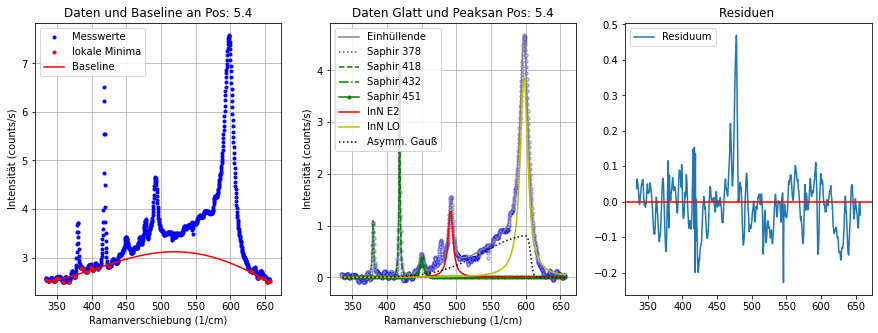

----------------------------------------------------------------------------------------------------
Position: 5.5
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [2.73008 2.70957 2.69604 ... 2.87927 2.9055  2.91045]
Hintergrund Parameter:  [ 4.79094652e-13 -6.69842156e-10  1.00000000e-08  3.46454222e-04
 -1.66156146e-01  2.56382504e+01]
Fitparameter Saphir 378: [1.071533821329104, 2.343313857370919, 379.5745712325477]
Fitparameter Saphir 418: [4.088190705539335, 1.7900356563381383, 418.0749121581473]
Fitparameter Saphir 432: [248.83265357396522, 0.0025398661257972407, 431.34733081812226]
Fitparameter Saphir 451: [0.43331513761828916, 8.5738631288091, 449.8036236850823]
Fitparameter InN E2: [1.3807639278420991, 9.423165665301838, 491.5790643437386]
Fitparameter Saphir 578: [0.5512792931640957, 9.999999979176815, 589.9999915767442]
Fitparameter InN LO: [4.040173598239125, 11.155748450304381, 598.1868050911124]
Fitparameter Saphir 64

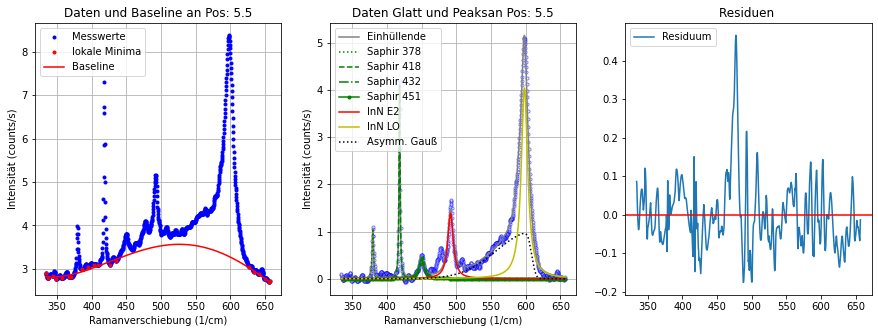

----------------------------------------------------------------------------------------------------
Position: 5.6
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [3.11459 3.0974  3.08967 ... 3.19955 3.20334 3.20182]
Hintergrund Parameter:  [ 3.20048901e-13 -4.52674030e-10  1.00000000e-08  2.26807840e-04
 -1.06106923e-01  1.71994107e+01]
Fitparameter Saphir 378: [0.9036118541742097, 3.0174885163702942, 379.4184558427358]
Fitparameter Saphir 418: [4.04265038001192, 1.6952078495511804, 418.0581325297415]
Fitparameter Saphir 432: [0.05341303366532844, 0.5962172540367087, 429.75204165167213]
Fitparameter Saphir 451: [0.3446039684445517, 9.999999999999998, 450.2992412574696]
Fitparameter InN E2: [1.539772504805943, 9.299146785342238, 491.64521968423566]
Fitparameter Saphir 578: [0.05657377968066446, 1.7926385438576866, 571.416265877335]
Fitparameter InN LO: [4.585760475549607, 13.631981724556946, 597.5089034959873]
Fitparameter Saphir 6

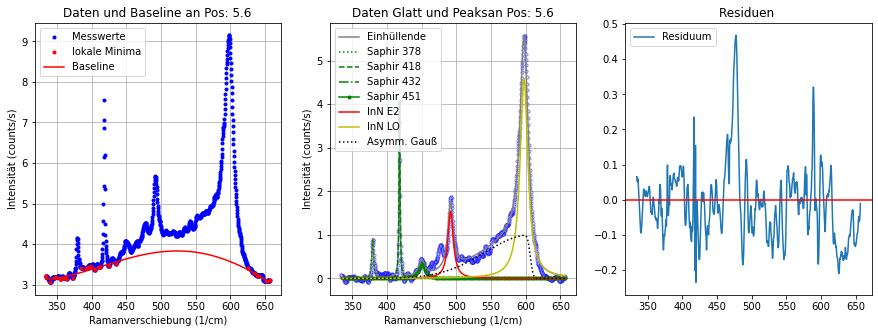

----------------------------------------------------------------------------------------------------
Position: 5.7
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [3.2701  3.28965 3.30372 ... 3.23439 3.23073 3.22621]
Hintergrund Parameter:  [ 1.00000000e-13 -2.26906924e-10  1.14613894e-07  1.00000000e-05
 -1.16780851e-02  4.15789780e+00]
Fitparameter Saphir 378: [1.0407996437896099, 2.0491392694863206, 379.7254836363583]
Fitparameter Saphir 418: [4.063284217947019, 1.6349341328470939, 418.00837300342]
Fitparameter Saphir 432: [0.0902835088290902, 5.736800614034046e-14, 429.30592426749456]
Fitparameter Saphir 451: [0.30846211354548697, 9.999999999999998, 450.37910691335276]
Fitparameter InN E2: [1.5968742697408307, 8.852715049106171, 491.69079038056253]
Fitparameter Saphir 578: [0.23688107773220618, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [5.021654059986061, 13.922145973224744, 597.3858349025274]
Fitparameter Saph

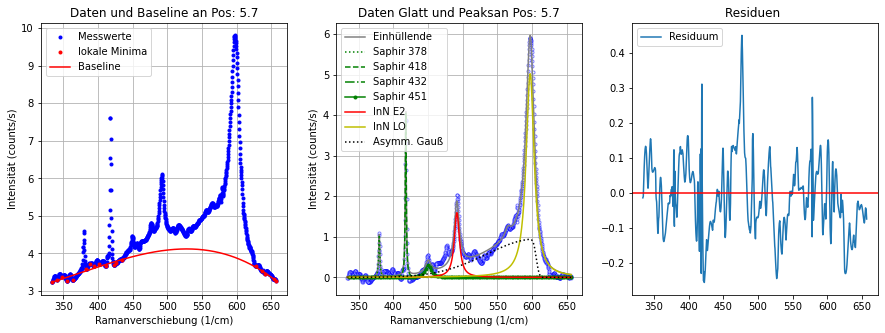

----------------------------------------------------------------------------------------------------
Position: 5.8
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [4.01173 3.93057 3.85608 ... 3.80701 3.80322 3.83641]
Hintergrund Parameter:  [ 4.21839915e-13 -5.70598849e-10  1.00000000e-08  2.66814572e-04
 -1.19029428e-01  1.87259631e+01]
Fitparameter Saphir 378: [1.0290048396151907, 2.1456910874165653, 379.741649480175]
Fitparameter Saphir 418: [3.779607980269158, 1.580745399171817, 418.14361887305813]
Fitparameter Saphir 432: [4.0870136339394886e-05, 8.636028578743472e-07, 435.83219580121664]
Fitparameter Saphir 451: [0.4293394439320107, 9.999999999999998, 449.85196574445376]
Fitparameter InN E2: [1.7373053720921525, 10.210246740037023, 491.6210172634143]
Fitparameter Saphir 578: [0.13582899364196632, 9.149783566328079, 565.0000000000252]
Fitparameter InN LO: [5.572747888388273, 14.688896131607265, 597.4158206252275]
Fitparameter 

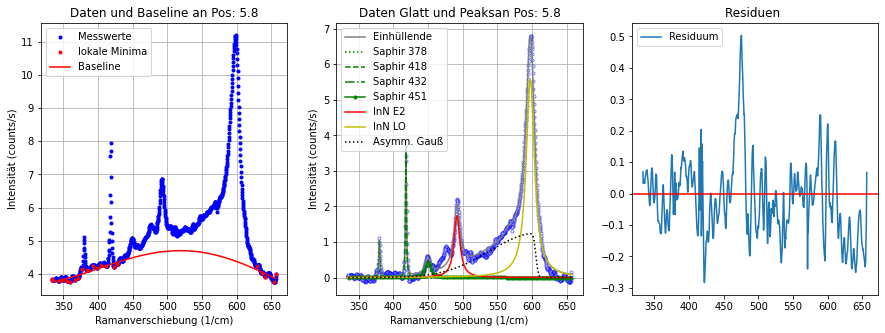

----------------------------------------------------------------------------------------------------
Position: 5.9
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [3.92063 3.91898 3.91246 ... 3.85067 3.84196 3.84074]
Hintergrund Parameter:  [ 3.33051822e-13 -4.86422747e-10  1.00000000e-08  2.46817313e-04
 -1.12288384e-01  1.80684317e+01]
Fitparameter Saphir 378: [0.792072698301348, 3.219379154645665, 380.1414408946044]
Fitparameter Saphir 418: [3.7302842919543915, 1.6089186814366792, 418.16829357989076]
Fitparameter Saphir 432: [0.0895688239354065, 0.6926693300127792, 431.70103634038986]
Fitparameter Saphir 451: [0.46740619045736354, 9.99999999999985, 450.23373606983006]
Fitparameter InN E2: [1.9782813441674372, 9.651575578144934, 491.508867985787]
Fitparameter Saphir 578: [0.6320230401417208, 7.676654316464473, 589.9999999999999]
Fitparameter InN LO: [5.520475544896344, 11.891717142168483, 597.6107607291574]
Fitparameter Saphir 64

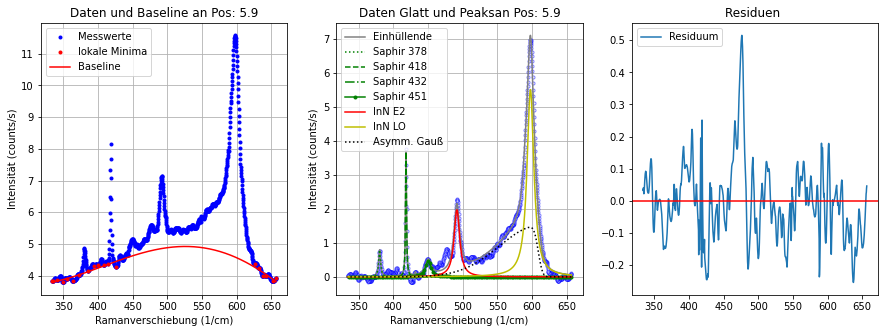

----------------------------------------------------------------------------------------------------
Position: 6.0
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [4.1991  4.20083 4.20265 ... 4.1473  4.16232 4.17643]
Hintergrund Parameter:  [ 1.00000000e-13 -2.31610082e-10  1.14066460e-07  1.00000003e-05
 -8.67035823e-03  4.11694301e+00]
Fitparameter Saphir 378: [0.802067977779043, 2.122283897886751, 379.8466175092117]
Fitparameter Saphir 418: [3.6223311502356825, 1.6835605397043987, 418.10701326304996]
Fitparameter Saphir 432: [0.3639026240230048, 33.98397704455124, 459.99999999999994]
Fitparameter Saphir 451: [0.4013697405359692, 2.829427193146393, 449.4382648780111]
Fitparameter InN E2: [2.237230028968359, 8.670047100611695, 491.7344448459972]
Fitparameter Saphir 578: [0.7235716946734762, 9.547703768739245, 589.9999999999999]
Fitparameter InN LO: [5.878689986044828, 12.356829763360146, 597.6520934012403]
Fitparameter Saphir 645:

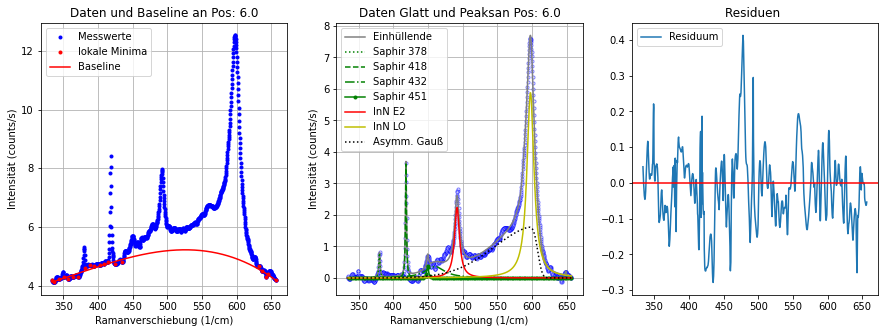

----------------------------------------------------------------------------------------------------
Position: 6.1
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [4.45183 4.4476  4.44086 ... 4.52275 4.52281 4.5291 ]
Hintergrund Parameter:  [ 3.40805805e-13 -4.97124291e-10  1.00000000e-08  2.50854871e-04
 -1.13246351e-01  1.86280441e+01]
Fitparameter Saphir 378: [0.9282303313010177, 2.146122891738226, 379.5686605107946]
Fitparameter Saphir 418: [3.5680959734901196, 1.7066452252695183, 418.1146010969717]
Fitparameter Saphir 432: [1.1307186739729547e-06, 1.9366008652357444e-06, 459.20749932247287]
Fitparameter Saphir 451: [0.5974995792148773, 9.999999999999998, 449.72043203835415]
Fitparameter InN E2: [2.385724776342109, 9.247412391548163, 491.5186288866587]
Fitparameter Saphir 578: [8.381125038331975, 0.014698985179355264, 571.3348908755672]
Fitparameter InN LO: [6.616954573322462, 13.401341141943707, 597.3610740685078]
Fitparameter

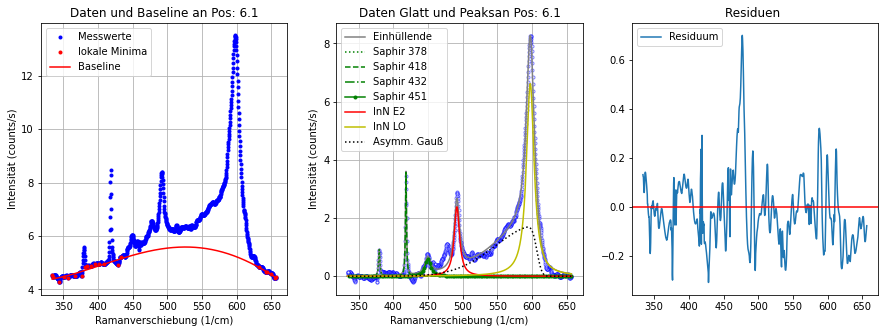

----------------------------------------------------------------------------------------------------
Position: 6.2
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [5.22148 5.51303 5.48512 ... 5.1152  5.11995 5.0993 ]
Hintergrund Parameter:  [ 1.82865836e-13 -3.06286685e-10  1.00000000e-08  1.61116292e-04
 -6.90936849e-02  1.27930575e+01]
Fitparameter Saphir 378: [0.7809419367434333, 2.4853931458663463, 379.9187145279172]
Fitparameter Saphir 418: [3.490328310738249, 1.568822361795172, 418.13848664834916]
Fitparameter Saphir 432: [0.37646482938079334, 35.67549736222855, 459.99999999999994]
Fitparameter Saphir 451: [0.45905008744442793, 3.4868694087484764, 450.25089968260795]
Fitparameter InN E2: [2.4528564097947263, 8.973440046139679, 491.541530506508]
Fitparameter Saphir 578: [1.0005636148056993, 7.796039667884271, 589.9999999999999]
Fitparameter InN LO: [6.862066209700153, 12.044541968203314, 597.8498901298641]
Fitparameter Saphir 

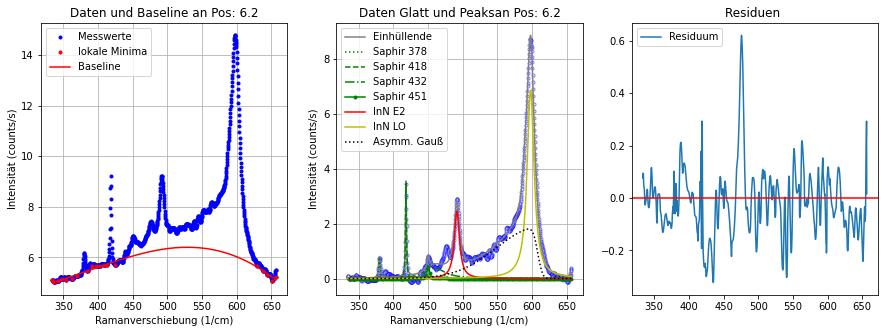

----------------------------------------------------------------------------------------------------
Position: 6.3
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [5.69777 5.74674 5.76772 ... 5.66682 5.72078 5.78766]
Hintergrund Parameter:  [ 5.30844252e-13 -7.41685713e-10  1.00000000e-08  3.71265655e-04
 -1.70262604e-01  2.76774049e+01]
Fitparameter Saphir 378: [0.4849923074316507, 4.3217366570356015, 380.1264415955685]
Fitparameter Saphir 418: [3.5622486739395574, 1.576593827987103, 418.1240290060425]
Fitparameter Saphir 432: [0.6838122996088832, 8.604695731299566, 449.4692437467232]
Fitparameter Saphir 451: [0.7175982423725503, 9.999999999999998, 469.99999999999994]
Fitparameter InN E2: [2.785862137875506, 8.450141028520589, 491.7225587100563]
Fitparameter Saphir 578: [0.19712215421759227, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [7.7967682076556075, 14.03546247547684, 597.3089281057878]
Fitparameter Saphir 645

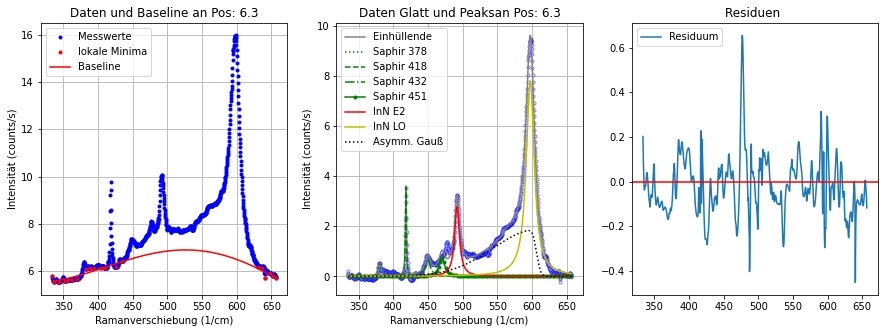

----------------------------------------------------------------------------------------------------
Position: 6.4
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [6.25017 6.20314 6.16353 ... 5.86236 5.89461 5.90021]
Hintergrund Parameter:  [ 5.07357773e-13 -6.85989824e-10  1.00000000e-08  3.16715645e-04
 -1.36878819e-01  2.22447187e+01]
Fitparameter Saphir 378: [0.807969366917199, 2.7920751826494095, 379.89513187799554]
Fitparameter Saphir 418: [3.7257334316088904, 1.4002709253172652, 418.1764638929785]
Fitparameter Saphir 432: [0.66489783273636, 9.73320127632283, 449.94675474683015]
Fitparameter Saphir 451: [0.6800532757385961, 9.999999999999998, 469.99999999999994]
Fitparameter InN E2: [2.952834966558255, 8.793163493254886, 491.59139228124667]
Fitparameter Saphir 578: [0.9688719952651467, 0.03287467891788805, 577.212027182887]
Fitparameter InN LO: [8.119816239164473, 14.15225260248148, 597.5308549172473]
Fitparameter Saphir 645:

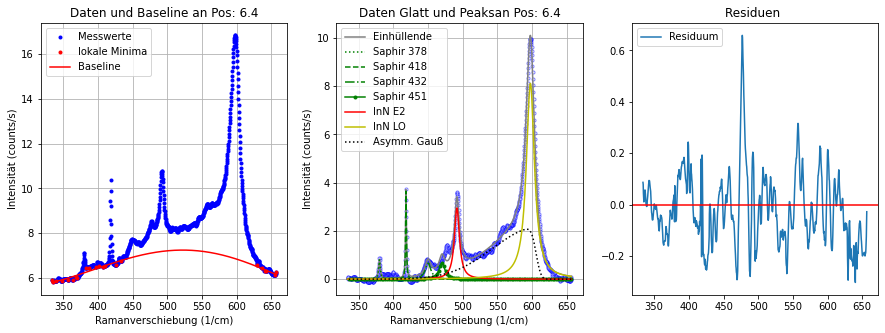

----------------------------------------------------------------------------------------------------
Position: 6.5
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [6.50268 6.57717 6.58632 ... 6.22969 6.24624 6.23606]
Hintergrund Parameter:  [ 1.09750774e-12 -1.42627358e-09  1.00000000e-08  6.65972023e-04
 -3.00225417e-01  4.48469432e+01]
Fitparameter Saphir 378: [0.6537173975694425, 5.418432422313685, 380.1703521278598]
Fitparameter Saphir 418: [3.1327777093737876, 1.6485272702335199, 418.1933190712889]
Fitparameter Saphir 432: [4.517876543144755e-06, 1.5887487655636372e-06, 422.0148423750262]
Fitparameter Saphir 451: [0.6868086586585626, 9.999999999999998, 449.9350341699953]
Fitparameter InN E2: [2.854319296061974, 9.233826173772256, 491.5123323479606]
Fitparameter Saphir 578: [5.715452383967015e-08, 1.094404287112498e-05, 579.6742748189048]
Fitparameter InN LO: [8.783990841814237, 14.451739140361727, 597.3170068943847]
Fitparamet

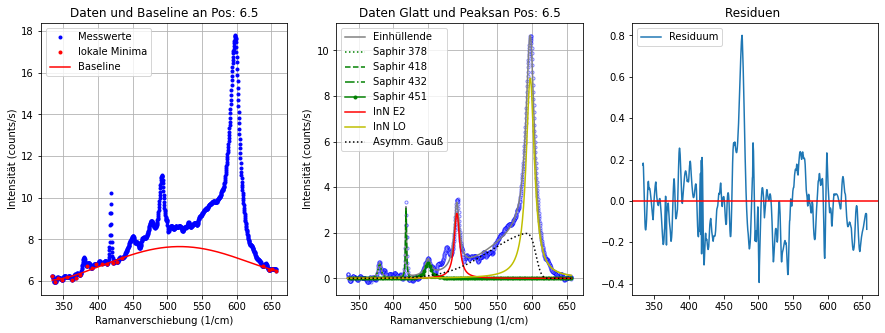

----------------------------------------------------------------------------------------------------
Position: 6.6
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [7.21838 7.13509 7.08956 ... 6.39128 6.39035 6.40716]
Hintergrund Parameter:  [ 5.71760304e-13 -7.47735987e-10  1.00000000e-08  3.30690574e-04
 -1.40041958e-01  2.27989720e+01]
Fitparameter Saphir 378: [0.6990729422445322, 3.5324929060203396, 380.15333334661733]
Fitparameter Saphir 418: [2.9936644389695184, 1.4171453004116892, 418.1851736831657]
Fitparameter Saphir 432: [0.5153424515541857, 37.315242220967434, 459.99999999999994]
Fitparameter Saphir 451: [0.6093638821794485, 2.852260258660322, 449.4339167232276]
Fitparameter InN E2: [3.08792046391464, 8.887151420168667, 491.46219989278126]
Fitparameter Saphir 578: [0.2838286698166818, 8.075255095296637, 565.0000000000007]
Fitparameter InN LO: [9.000643974825637, 13.821622240268084, 597.2723701699414]
Fitparameter Saphir 6

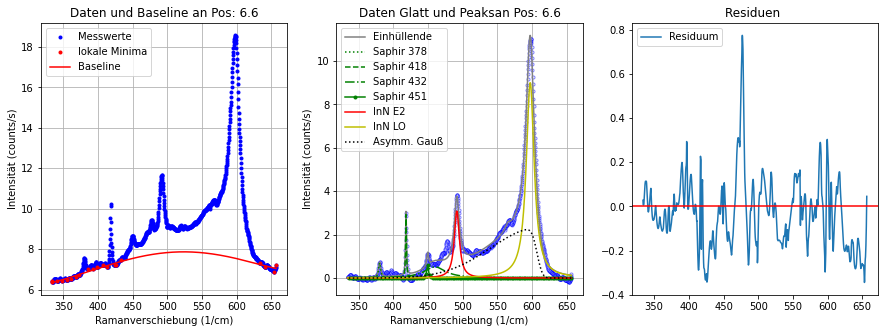

----------------------------------------------------------------------------------------------------
Position: 6.7
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [7.70638 7.6871  7.68302 ... 6.83499 6.78549 6.74565]
Hintergrund Parameter:  [ 1.00000000e-13 -2.57220800e-10  1.30626787e-07  1.00000000e-05
 -5.36086300e-03  5.40102650e+00]
Fitparameter Saphir 378: [0.6748533704166714, 3.8030742549267225, 379.9421803352145]
Fitparameter Saphir 418: [3.1824676441151545, 1.4013853139845918, 418.2481641176359]
Fitparameter Saphir 432: [0.007116319124895438, 0.0024837549953712983, 420.0002075955283]
Fitparameter Saphir 451: [0.7739170117600181, 8.330869232250054, 450.6490939902121]
Fitparameter InN E2: [3.212559147091128, 8.430835405354289, 491.4535291291638]
Fitparameter Saphir 578: [1.339453035820361, 9.999999999999998, 589.9999999999999]
Fitparameter InN LO: [9.038987568608214, 11.914316641623861, 597.5258422498354]
Fitparameter Saphir

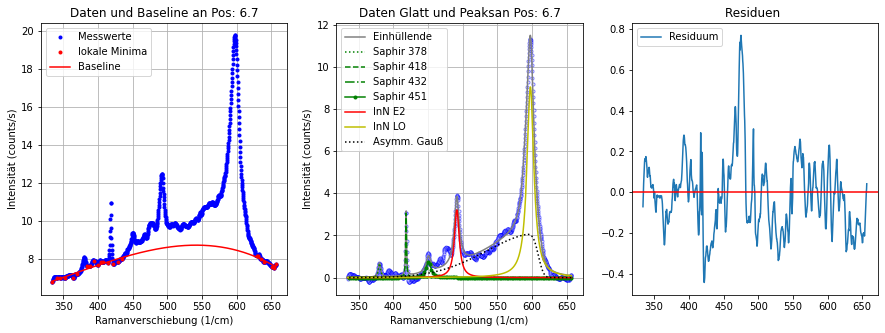

----------------------------------------------------------------------------------------------------
Position: 6.8
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [8.05231 8.06712 8.08244 ... 7.3015  7.32621 7.30523]
Hintergrund Parameter:  [ 1.00000000e-13 -3.47854222e-10  2.18243421e-07  1.00000001e-05
 -2.33307574e-02  9.66463516e+00]
Fitparameter Saphir 378: [0.6574915613725197, 4.115911474521885, 380.51716885996785]
Fitparameter Saphir 418: [2.7117280286936696, 1.5540431186995398, 418.18299988229853]
Fitparameter Saphir 432: [0.11308161400158107, 0.8876898684018191, 443.8991401256751]
Fitparameter Saphir 451: [0.6386060980824503, 8.347117326104533, 450.20265950369566]
Fitparameter InN E2: [3.229974075058355, 7.775780382237989, 491.4898365311484]
Fitparameter Saphir 578: [0.34918886774173524, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [9.816164540250945, 14.033633464457848, 596.9570841866607]
Fitparameter Saphir

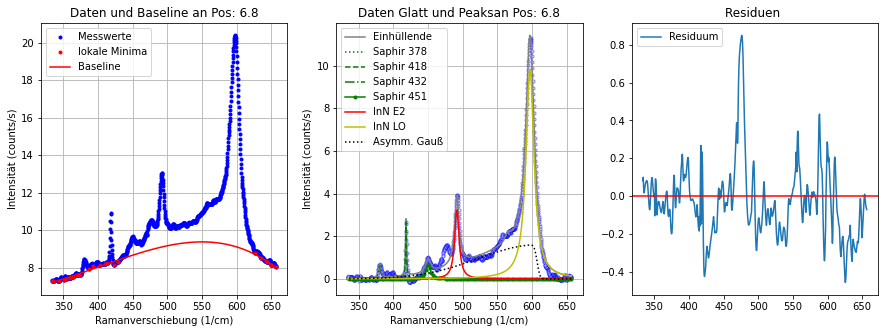

----------------------------------------------------------------------------------------------------
Position: 6.9
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [8.57792 8.54326 8.51299 ... 7.47322 7.46921 7.49817]
Hintergrund Parameter:  [ 1.00000000e-13 -3.27450987e-10  1.99953616e-07  1.00000000e-05
 -1.96260034e-02  9.08392333e+00]
Fitparameter Saphir 378: [0.5556856989779295, 5.415151718412263, 380.1705878991141]
Fitparameter Saphir 418: [2.429165893013754, 1.7939626137630975, 418.17913577706753]
Fitparameter Saphir 432: [0.9053840176333526, 6.875842091629794, 449.3096987523697]
Fitparameter Saphir 451: [0.8479281272899096, 9.999999999999998, 469.9999999925]
Fitparameter InN E2: [3.4940143555596253, 8.239464225419274, 491.46524385172137]
Fitparameter Saphir 578: [0.12477614499158496, 0.25253997988711263, 576.3065877927869]
Fitparameter InN LO: [9.456460182801454, 13.87626055390883, 596.9036706030464]
Fitparameter Saphir 645:

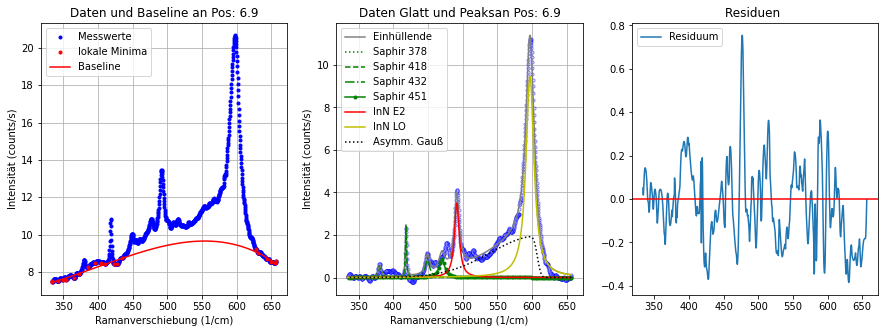

----------------------------------------------------------------------------------------------------
Position: 7.0
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [8.99234 9.03071 9.0316  ... 7.78945 7.70932 7.45055]
Hintergrund Parameter:  [ 1.00000001e-13 -2.01549184e-10  7.50398524e-08  1.00000003e-05
  8.76700400e-03  2.84778037e+00]
Fitparameter Saphir 378: [0.47656595525856094, 4.449275599021504, 379.88101656116356]
Fitparameter Saphir 418: [2.1902725306432655, 1.5168290188054576, 418.1756049854838]
Fitparameter Saphir 432: [0.4762434242792562, 37.755972555155026, 459.99999999999994]
Fitparameter Saphir 451: [0.7113052401322856, 3.1708816373882045, 449.06262108400125]
Fitparameter InN E2: [3.4520546948825177, 8.702491529043142, 491.3235614343189]
Fitparameter Saphir 578: [0.9347375017748764, 9.198747353125242, 589.9999999999999]
Fitparameter InN LO: [9.172222505690607, 12.868628170850673, 597.4528745455325]
Fitparameter Saphi

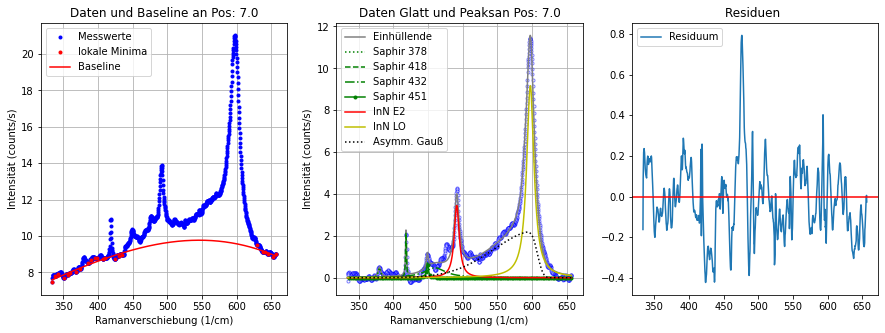

----------------------------------------------------------------------------------------------------
Position: 7.1
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [8.88848 8.89323 8.88518 ... 7.70088 7.72876 7.72562]
Hintergrund Parameter:  [ 2.91768055e-13 -4.55120676e-10  1.00000000e-08  2.37446875e-04
 -1.00669477e-01  1.87233806e+01]
Fitparameter Saphir 378: [0.4385911315988197, 6.250360245963268, 380.8723666180897]
Fitparameter Saphir 418: [1.8748162377961157, 1.4750034127025582, 418.36455506641903]
Fitparameter Saphir 432: [0.3757131994598643, 34.01113782352079, 459.99999999999994]
Fitparameter Saphir 451: [0.5859119868860697, 3.499529072703475, 448.97413641768316]
Fitparameter InN E2: [3.1469544900734485, 8.770201615857237, 491.31475992751496]
Fitparameter Saphir 578: [0.24955804822330419, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [9.302659052155562, 14.338615106103953, 596.7579733868769]
Fitparameter Saphir

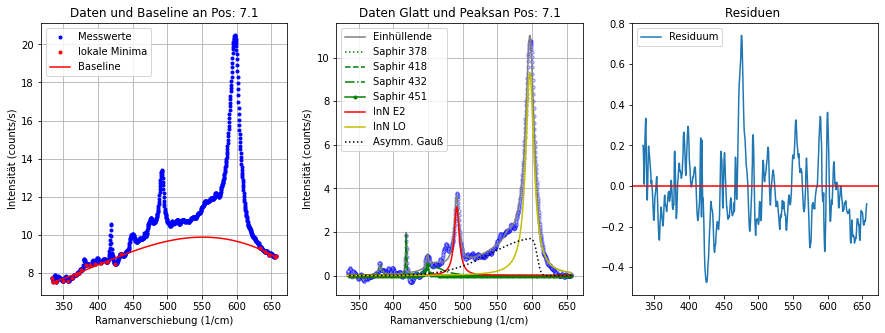

----------------------------------------------------------------------------------------------------
Position: 7.2
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [9.61409 9.53292 9.47675 ... 7.90028 7.9161  7.95171]
Hintergrund Parameter:  [ 1.00000000e-13 -1.66670389e-10  4.95224027e-08  1.00000018e-05
  1.04869097e-02  2.96682275e+00]
Fitparameter Saphir 378: [0.5949933371752771, 4.735742441097112, 380.68264554322315]
Fitparameter Saphir 418: [2.1847669897156172, 1.2650410474747957, 418.41770777133047]
Fitparameter Saphir 432: [0.6009748616481854, 37.7669172245066, 459.99999999999994]
Fitparameter Saphir 451: [0.55447656786438, 3.8075419914797966, 449.1477911817512]
Fitparameter InN E2: [3.1985533475647903, 8.899525316511125, 491.4399024176619]
Fitparameter Saphir 578: [2.9844804251903235e-05, 3.232310271645085e-05, 573.5583683735412]
Fitparameter InN LO: [8.918669084861403, 14.387627295381794, 597.0825429105273]
Fitparameter Sa

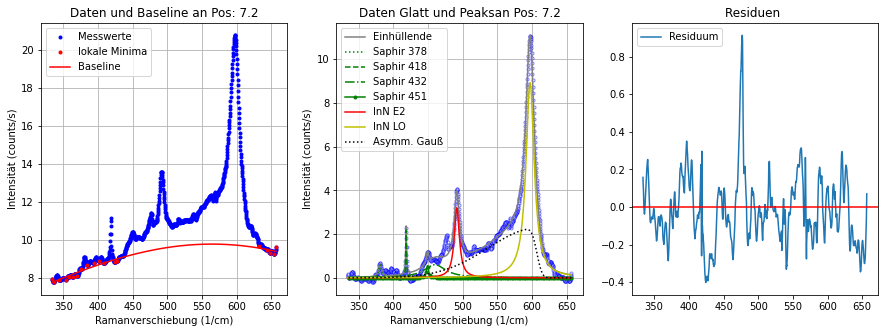

----------------------------------------------------------------------------------------------------
Position: 7.3
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [9.1141  9.0976  9.07137 ... 7.42258 7.40246 7.37359]
Hintergrund Parameter:  [ 1.00000000e-13 -2.61218256e-10  1.36590629e-07  1.00000000e-05
 -5.21315747e-03  5.69577821e+00]
Fitparameter Saphir 378: [0.551644569599803, 3.455347993299468, 380.1140072602137]
Fitparameter Saphir 418: [1.847613135827477, 1.4531510559218328, 418.22250097082184]
Fitparameter Saphir 432: [0.3766652738857181, 32.49651919885844, 459.9999999896798]
Fitparameter Saphir 451: [0.5884858763450621, 3.44575350818402, 448.74493235490894]
Fitparameter InN E2: [2.8981850867979344, 9.202556387600044, 491.15049744084]
Fitparameter Saphir 578: [1.4483313223897254e-05, 7.150302817342738e-06, 565.0497306603677]
Fitparameter InN LO: [8.441493944948858, 14.106101424501759, 596.662461123171]
Fitparameter Saphir 

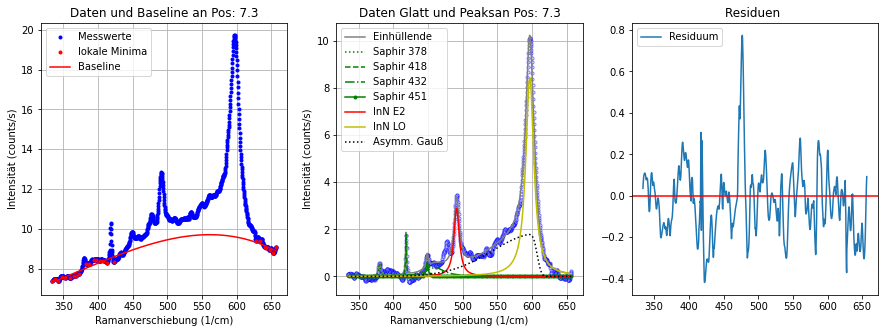

----------------------------------------------------------------------------------------------------
Position: 7.4
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [8.898   8.84474 8.82232 ... 7.30849 7.31245 7.33216]
Hintergrund Parameter:  [ 1.00000000e-13 -2.93761580e-10  1.73157384e-07  1.00000000e-05
 -1.57108278e-02  8.16620821e+00]
Fitparameter Saphir 378: [0.2991112169781092, 16.49647147628063, 389.6684229792688]
Fitparameter Saphir 418: [1.5153823684354668, 1.6407012057995083, 418.2702017005027]
Fitparameter Saphir 432: [0.7272355833411671, 7.537727230789216, 449.4231027679527]
Fitparameter Saphir 451: [0.8535660176083018, 9.999999999999998, 469.99999997728327]
Fitparameter InN E2: [2.8218471879578373, 9.302280684563497, 491.2731969005078]
Fitparameter Saphir 578: [0.12622952164247425, 0.35748953724299315, 578.15695140155]
Fitparameter InN LO: [8.09260658183451, 13.893921169464415, 596.8952943285238]
Fitparameter Saphir 645

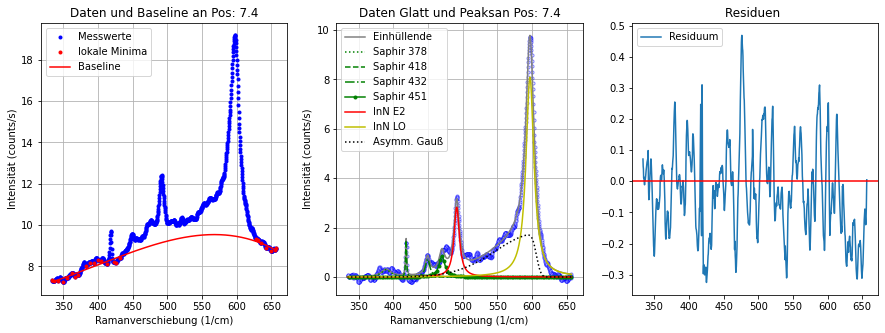

----------------------------------------------------------------------------------------------------
Position: 7.5
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [8.49679 8.6302  8.65177 ... 7.06689 7.09809 7.16765]
Hintergrund Parameter:  [ 1.00000000e-13 -4.08713574e-10  2.82638418e-07  1.00000000e-05
 -3.75885059e-02  1.26505210e+01]
Fitparameter Saphir 378: [0.3286621480918299, 13.695220804608732, 390.9555131029018]
Fitparameter Saphir 418: [1.3732269415108211, 1.4689178334140656, 418.2285411102543]
Fitparameter Saphir 432: [0.3387238154947145, 26.693918255463387, 459.99998556754707]
Fitparameter Saphir 451: [0.4711068800574566, 4.124077021788958, 448.7298186588616]
Fitparameter InN E2: [2.6400433672137433, 9.507888268251731, 491.09954154681697]
Fitparameter Saphir 578: [11.996254720137653, 4.066963814346283e-06, 571.4885225638965]
Fitparameter InN LO: [7.651112615466531, 13.897524702619478, 596.7075849293553]
Fitparameter Sap

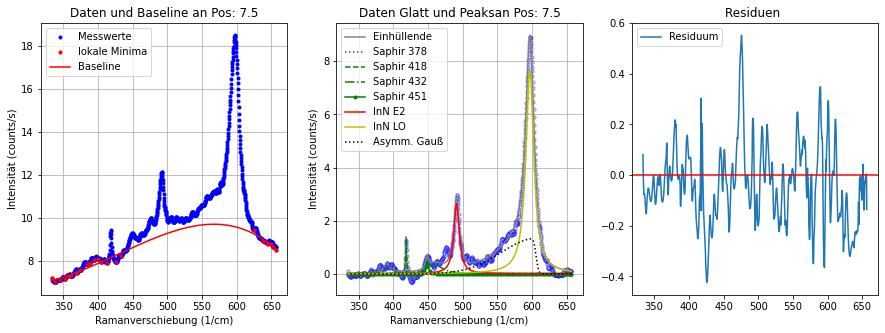

----------------------------------------------------------------------------------------------------
Position: 7.6
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [7.80368 7.72245 7.69744 ... 6.181   6.20344 6.253  ]
Hintergrund Parameter:  [ 1.00000000e-13 -2.61519327e-10  1.45901897e-07  1.00000000e-05
 -1.21358013e-02  6.48096500e+00]
Fitparameter Saphir 378: [0.45667624697577697, 3.279633612125687, 380.0927547141331]
Fitparameter Saphir 418: [1.5506392605886783, 1.3426563665766547, 418.1474215616165]
Fitparameter Saphir 432: [0.40287031961055086, 3.197535045038257, 446.68262193837717]
Fitparameter Saphir 451: [0.476550985784234, 5.936331240121893, 450.26893084573385]
Fitparameter InN E2: [2.4196102275472855, 8.463463027842078, 490.98015749990265]
Fitparameter Saphir 578: [0.31632701159890964, 9.999999999962277, 565.0002261329594]
Fitparameter InN LO: [7.479021207678956, 14.486873409567874, 596.5053040860283]
Fitparameter Saphir

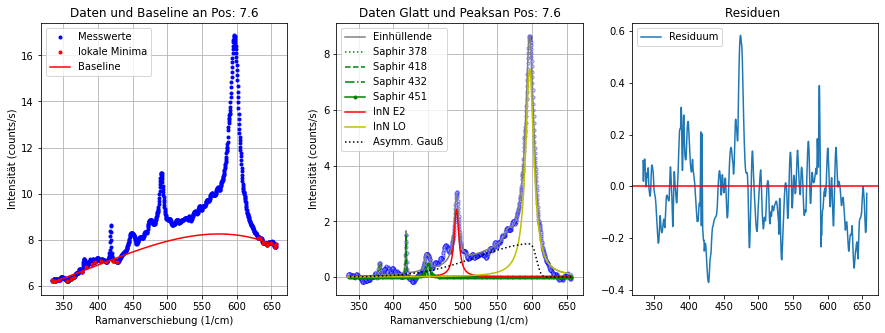

----------------------------------------------------------------------------------------------------
Position: 7.7
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [7.6827  7.632   7.62009 ... 6.18325 6.21299 6.17155]
Hintergrund Parameter:  [ 1.00000000e-13 -1.81977314e-10  6.83197161e-08  1.00000000e-05
  4.23608947e-03  2.81645813e+00]
Fitparameter Saphir 378: [0.2023621934826088, 18.593030144668024, 389.7524793962714]
Fitparameter Saphir 418: [0.9899674003382454, 1.887463983812887, 418.1852553938824]
Fitparameter Saphir 432: [2.204149722383357e-34, 1.3306682220291635, 433.3461859010042]
Fitparameter Saphir 451: [0.6158246342154768, 8.355718182480487, 449.97650785346076]
Fitparameter InN E2: [2.406949995887562, 8.371169483553262, 491.0553760715829]
Fitparameter Saphir 578: [1.0813122171125806, 8.209725797597667, 589.9999999999999]
Fitparameter InN LO: [6.2549629698304665, 13.716856141930329, 597.3557752782775]
Fitparameter Saphir

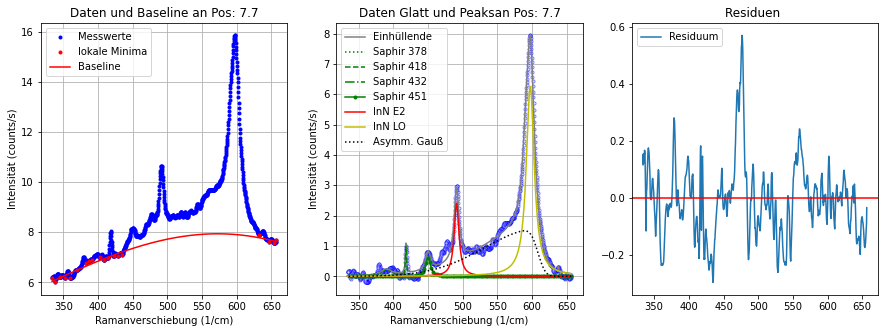

----------------------------------------------------------------------------------------------------
Position: 7.8
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [6.49861 6.52288 6.53965 ... 5.258   5.21938 5.10056]
Hintergrund Parameter:  [ 1.00000000e-13 -3.19492309e-10  1.99227547e-07  1.00000000e-05
 -2.22591433e-02  7.57698282e+00]
Fitparameter Saphir 378: [0.21731866141313352, 17.57221062591836, 385.17064161929596]
Fitparameter Saphir 418: [1.0267982353814504, 1.4794413635739436, 418.22406560509904]
Fitparameter Saphir 432: [0.007442949845960396, 0.006275197681391151, 420.00218941857054]
Fitparameter Saphir 451: [0.5117257359763301, 8.171253044702166, 449.6498700285714]
Fitparameter InN E2: [2.027443840191914, 10.324719159828176, 491.10548669007215]
Fitparameter Saphir 578: [0.12243593229990392, 9.153152601548816, 565.0000000000001]
Fitparameter InN LO: [6.131244000953658, 14.480898360092565, 596.7360064494117]
Fitparameter 

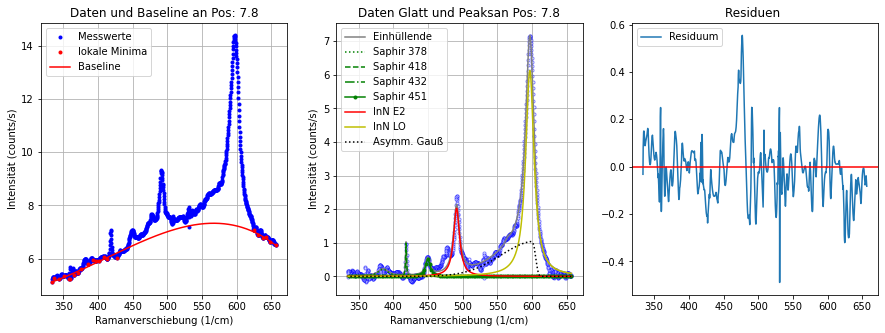

----------------------------------------------------------------------------------------------------
Position: 7.9
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [5.94051 5.94304 5.98365 ... 4.85514 4.84647 4.83271]
Hintergrund Parameter:  [ 2.74419407e-13 -4.22054528e-10  1.00000000e-08  2.30308107e-04
 -1.05410095e-01  1.79792708e+01]
Fitparameter Saphir 378: [0.2736045910925417, 14.49725776328886, 385.5334981621781]
Fitparameter Saphir 418: [1.0025821361173644, 1.5889060944170117, 418.24052030754433]
Fitparameter Saphir 432: [0.31431716519101943, 29.496934838745968, 459.99999999999994]
Fitparameter Saphir 451: [0.3868714490338307, 3.65854280220404, 448.6454121456101]
Fitparameter InN E2: [1.9911389008463867, 8.936714519314421, 491.55223552422694]
Fitparameter Saphir 578: [16.557986605160355, 0.009579804066620169, 582.5391411963992]
Fitparameter InN LO: [5.4919634322175215, 14.510741198308768, 596.7788904093404]
Fitparameter Sap

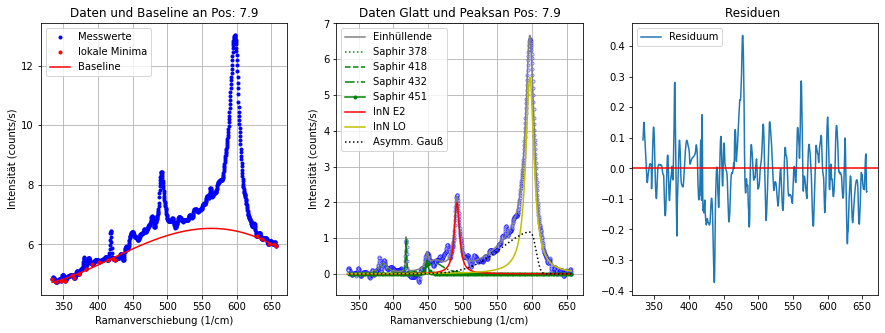

----------------------------------------------------------------------------------------------------
Position: 8.0
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [5.5398  5.56948 5.59477 ... 4.33097 4.3431  4.32456]
Hintergrund Parameter:  [ 1.00000000e-13 -2.82351111e-10  1.68646325e-07  1.00000002e-05
 -1.95529300e-02  6.55328277e+00]
Fitparameter Saphir 378: [0.1888331502689271, 15.988366537800104, 392.11063830221207]
Fitparameter Saphir 418: [0.8819410921442487, 1.5058135024865251, 418.1871637725839]
Fitparameter Saphir 432: [0.1633143319676516, 1.1025152180714268, 420.00000000000006]
Fitparameter Saphir 451: [0.480264522008248, 5.105336915569049, 449.06116609843326]
Fitparameter InN E2: [1.814857884240473, 9.283817202959536, 491.11036924994426]
Fitparameter Saphir 578: [0.8024045146927333, 9.497706098826281, 588.9388178469155]
Fitparameter InN LO: [5.056775783949276, 12.426516376151667, 597.2418337002392]
Fitparameter Saphir 

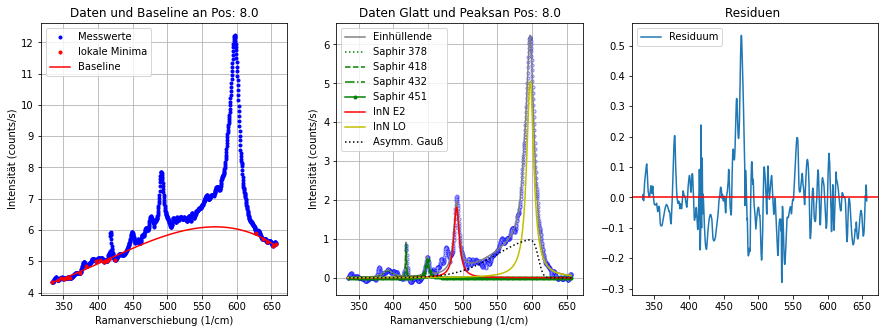

----------------------------------------------------------------------------------------------------
Position: 8.1
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [4.86915 4.95499 4.99613 ... 4.06229 4.07031 4.07862]
Hintergrund Parameter:  [ 1.00000000e-13 -3.38306921e-10  2.26901066e-07  1.00000000e-05
 -3.47766993e-02  9.85277907e+00]
Fitparameter Saphir 378: [0.1604419375111783, 15.22304537506053, 385.75512298770184]
Fitparameter Saphir 418: [1.1384604459340206, 1.6479279518148493, 418.36809812660834]
Fitparameter Saphir 432: [0.21175654178024653, 31.94728882280403, 459.99999999999994]
Fitparameter Saphir 451: [0.32803326567051677, 2.2985460243916953, 448.9820196867316]
Fitparameter InN E2: [1.7166449924483762, 8.773169547107505, 491.4874127148044]
Fitparameter Saphir 578: [0.6679919246409501, 9.999999999999995, 589.9999999999999]
Fitparameter InN LO: [4.589642338232335, 11.892845651975115, 597.4354022468759]
Fitparameter Saphi

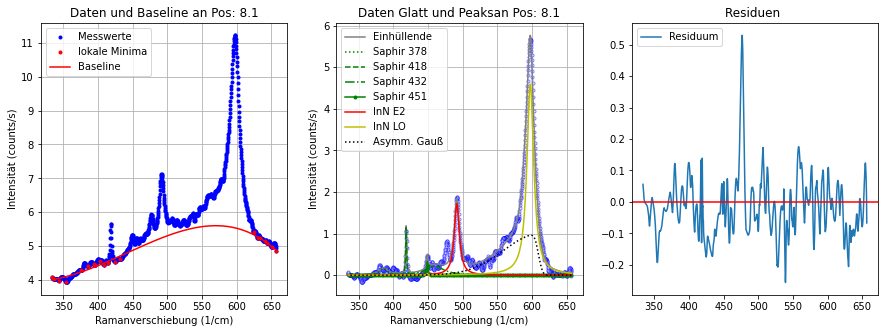

----------------------------------------------------------------------------------------------------
Position: 8.2
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [4.28992 4.3055  4.31769 ... 3.40179 3.41278 3.42176]
Hintergrund Parameter:  [ 1.00000000e-13 -2.44969350e-10  1.35714593e-07  1.00000000e-05
 -1.53463082e-02  4.95608800e+00]
Fitparameter Saphir 378: [0.18570482807615987, 14.161035129052673, 386.94012488780464]
Fitparameter Saphir 418: [0.8686081665455634, 1.6985161846579637, 418.46086597560935]
Fitparameter Saphir 432: [1.8834656034434163e-07, 6.468261041173235e-08, 448.200908236524]
Fitparameter Saphir 451: [0.3762663644190934, 9.999999990258448, 450.93642658860523]
Fitparameter InN E2: [1.3568886205283197, 10.542954735822157, 491.48397167652837]
Fitparameter Saphir 578: [0.037688569536910486, 0.7783151045283593, 565.9594494372099]
Fitparameter InN LO: [4.429390996897891, 14.338702430959923, 597.0183741263485]
Fitpara

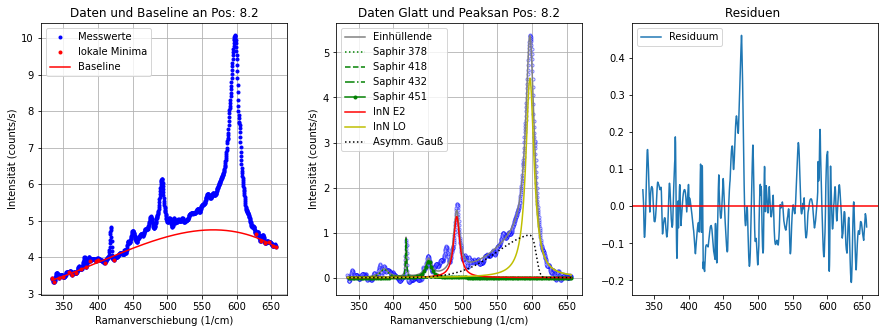

----------------------------------------------------------------------------------------------------
Position: 8.3
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [3.87064 3.77657 3.76512 ... 3.06016 3.06287 3.08871]
Hintergrund Parameter:  [ 1.00000000e-13 -2.47475783e-10  1.44703389e-07  1.00000000e-05
 -2.13939177e-02  6.39016481e+00]
Fitparameter Saphir 378: [0.29513926841240634, 2.5862533551570244, 379.62250047984895]
Fitparameter Saphir 418: [0.7516109601456135, 1.9780848748576743, 418.4007751730596]
Fitparameter Saphir 432: [1.701753788855403, 1.165912466658167e-06, 432.17835313592815]
Fitparameter Saphir 451: [0.27505631199187874, 9.566184342199126, 450.65484067592234]
Fitparameter InN E2: [1.2844566085878153, 7.927075152232804, 491.11883775867665]
Fitparameter Saphir 578: [0.4132071565867186, 9.999999999999998, 588.8031086664411]
Fitparameter InN LO: [4.093998324763459, 13.317221496346898, 597.3700580718419]
Fitparameter S

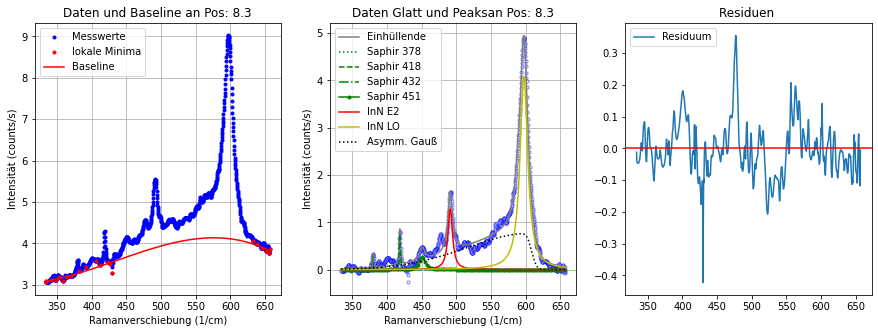

----------------------------------------------------------------------------------------------------
Position: 8.4
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [3.31203 3.31632 3.32457 ... 2.63506 2.60661 2.56197]
Hintergrund Parameter:  [ 1.00000000e-13 -2.37228848e-10  1.34748956e-07  1.00000000e-05
 -1.94696559e-02  5.50202364e+00]
Fitparameter Saphir 378: [0.28773141583119455, 6.066066441863057, 379.98001165394425]
Fitparameter Saphir 418: [0.8401508860578631, 1.6097486332570887, 418.4346560757629]
Fitparameter Saphir 432: [0.07071025760879382, 0.5919708360537872, 438.3936752143178]
Fitparameter Saphir 451: [0.3256852628593283, 5.93537538289841, 449.167839856913]
Fitparameter InN E2: [1.1814799459600027, 8.201411784344648, 491.3788215440646]
Fitparameter Saphir 578: [0.18389926734133588, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [3.8234400631495653, 15.076750819016166, 597.1879378791295]
Fitparameter Saphir 

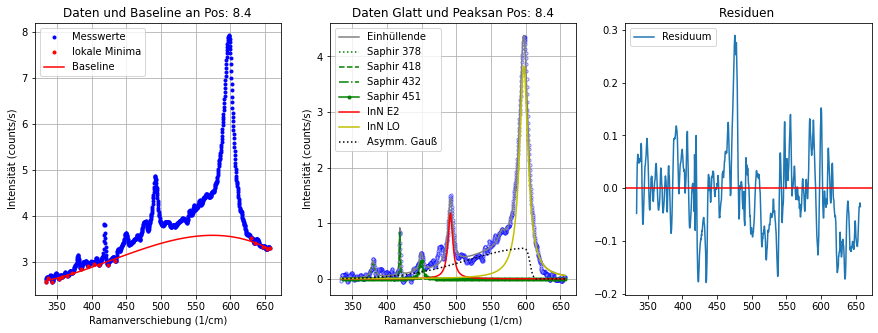

----------------------------------------------------------------------------------------------------
Position: 8.5
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [3.11233 3.07158 3.03873 ... 2.57999 2.58636 2.58012]
Hintergrund Parameter:  [ 2.92324711e-13 -4.21479818e-10  1.00000000e-08  2.24657094e-04
 -1.08721752e-01  1.73959712e+01]
Fitparameter Saphir 378: [0.1540913349489073, 13.53316791603711, 383.11014345084]
Fitparameter Saphir 418: [0.7624535497107356, 1.9670809975073298, 418.19866705511566]
Fitparameter Saphir 432: [0.15092113606685673, 5.782068652885597, 447.46735326536134]
Fitparameter Saphir 451: [0.12160401797915701, 9.999999999999998, 450.87385229169513]
Fitparameter InN E2: [1.018500860340541, 11.470128881419988, 491.24493586854084]
Fitparameter Saphir 578: [2.41314956545913, 2.6744078398609446e-20, 582.7653462572828]
Fitparameter InN LO: [3.460794465652817, 12.613305102584338, 597.5552611819505]
Fitparameter Saph

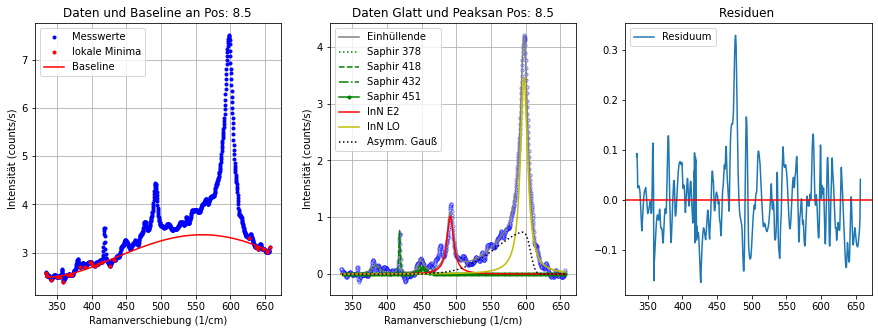

----------------------------------------------------------------------------------------------------
Position: 8.6
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [2.61931 2.63025 2.64823 ... 2.1799  2.2048  2.27183]
Hintergrund Parameter:  [ 1.00000000e-13 -2.26659733e-10  1.05900290e-07  4.04281910e-05
 -3.41521208e-02  7.51651422e+00]
Fitparameter Saphir 378: [0.24800608174634836, 3.66725826656699, 379.84831287122705]
Fitparameter Saphir 418: [0.8935451320321967, 1.4740152986029027, 418.3665287585506]
Fitparameter Saphir 432: [0.10926285969817363, 0.8933060534047013, 435.3753489258438]
Fitparameter Saphir 451: [0.29533043921024205, 5.888557643195045, 449.09940526779957]
Fitparameter InN E2: [0.9308429334958233, 7.689015469115532, 491.66979672725995]
Fitparameter Saphir 578: [0.12322287496309496, 9.998218583424407, 573.5880507303223]
Fitparameter InN LO: [3.22615613373844, 15.018478375876747, 597.5496017570789]
Fitparameter Saphi

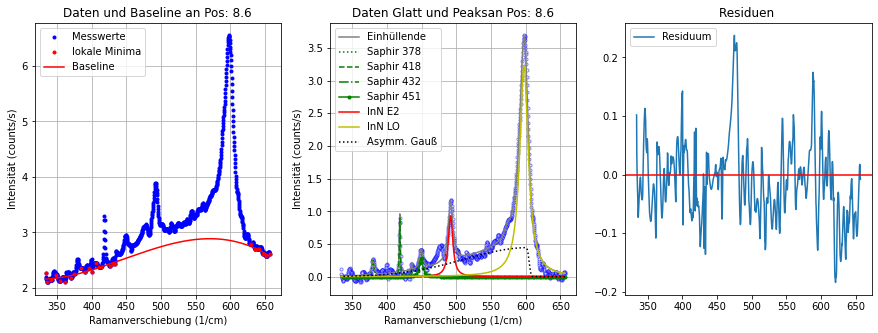

----------------------------------------------------------------------------------------------------
Position: 8.7
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [2.44776 2.38499 2.33096 ... 1.91852 1.93441 1.95111]
Hintergrund Parameter:  [ 4.51060941e-13 -7.61300092e-10  3.65286952e-07  1.00000000e-05
 -4.24818287e-02  8.92963111e+00]
Fitparameter Saphir 378: [0.10944668480772259, 20.048585486707097, 384.41498251382075]
Fitparameter Saphir 418: [0.7491889175157294, 1.6581022549536308, 418.3977984657741]
Fitparameter Saphir 432: [0.22189606940475504, 5.951291561035842, 450.52238716690044]
Fitparameter Saphir 451: [0.2310241326637275, 9.999999999999998, 469.9999999999999]
Fitparameter InN E2: [1.013524770306449, 7.230446549731149, 491.72548886257954]
Fitparameter Saphir 578: [0.3852081984024977, 6.20987574071419, 589.9999999999999]
Fitparameter InN LO: [2.9096012958399737, 11.851199498750773, 598.1750254250097]
Fitparameter Saphir

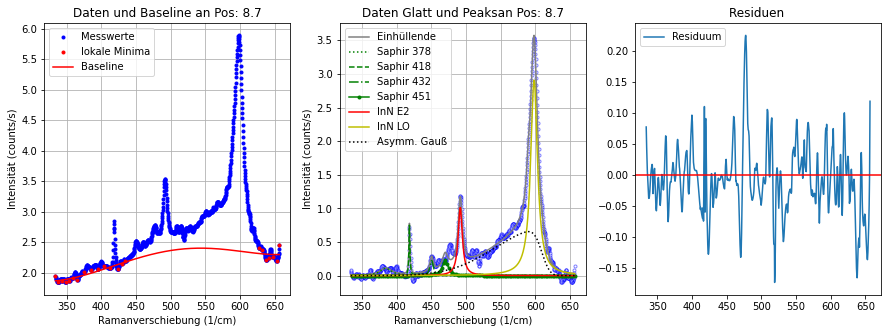

----------------------------------------------------------------------------------------------------
Position: 8.8
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.90357 1.94169 1.97786 ... 1.66756 1.70953 1.65064]
Hintergrund Parameter:  [ 1.00000000e-13 -2.40997495e-10  1.39268603e-07  1.00000000e-05
 -2.22517719e-02  5.40397183e+00]
Fitparameter Saphir 378: [0.1961115039894059, 4.188497273198086, 380.0602371792292]
Fitparameter Saphir 418: [0.7368361734714483, 1.8329739870717658, 418.39601084182254]
Fitparameter Saphir 432: [1.0522114945200116e-07, 4.697769131873083e-08, 422.35602332135255]
Fitparameter Saphir 451: [0.18031380704069735, 9.999999999420968, 450.44710304470027]
Fitparameter InN E2: [0.7955971015732398, 9.276657698485497, 491.30394852229665]
Fitparameter Saphir 578: [0.13007762686802565, 3.0007035478526314, 565.0000090617855]
Fitparameter InN LO: [2.5774772130610417, 13.728451862381323, 597.712513713613]
Fitparame

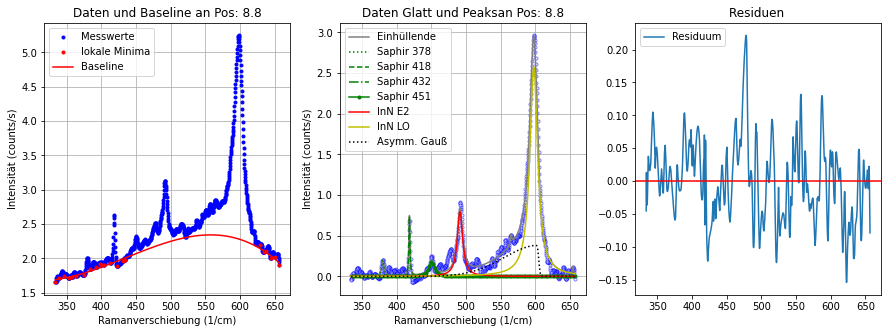

----------------------------------------------------------------------------------------------------
Position: 8.9
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.89323 1.87053 1.85856 ... 1.69287 1.68969 1.67971]
Hintergrund Parameter:  [ 1.00000000e-13 -1.91420660e-10  9.32882616e-08  1.00000001e-05
 -1.38541598e-02  3.61577581e+00]
Fitparameter Saphir 378: [0.18164317083487505, 4.069332162630151, 380.85413998753575]
Fitparameter Saphir 418: [0.698613145402633, 1.5805840931836197, 418.47377458323484]
Fitparameter Saphir 432: [0.010886070030509504, 0.01648296029002466, 440.18462111036257]
Fitparameter Saphir 451: [0.16627456915462985, 6.561183745527858, 449.3558410179766]
Fitparameter InN E2: [0.79568375947936, 7.695798899066644, 492.11098276953504]
Fitparameter Saphir 578: [0.0952777778943037, 9.999999999999998, 565.0000000000001]
Fitparameter InN LO: [2.414801551857246, 15.699255682134794, 598.0086145144124]
Fitparameter Saph

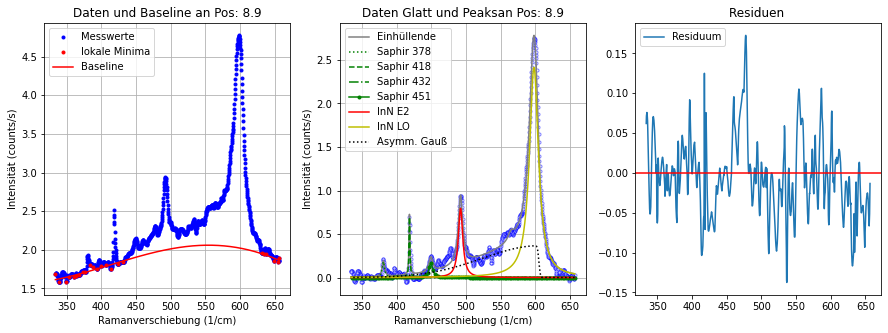

----------------------------------------------------------------------------------------------------
Position: 9.0
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.71046 1.73528 1.75069 ... 1.54571 1.57268 1.59884]
Hintergrund Parameter:  [ 1.09669291e-13 -1.75693091e-10  1.00000000e-08  9.61266943e-05
 -4.79736138e-02  8.19438085e+00]
Fitparameter Saphir 378: [0.19118985812775724, 4.804463896051491, 379.7032727375303]
Fitparameter Saphir 418: [0.5779987295354537, 1.841272846483455, 418.2411722608375]
Fitparameter Saphir 432: [1.0549867028819814e-06, 1.7229588660588482e-06, 420.02764804900335]
Fitparameter Saphir 451: [0.15378386963696383, 4.7381266828209325, 449.45012903296004]
Fitparameter InN E2: [0.6672822821442822, 7.775105421878117, 491.50033533540744]
Fitparameter Saphir 578: [0.12856871759748978, 9.999999999922293, 565.0002896148726]
Fitparameter InN LO: [2.480701914311541, 14.670858714526481, 597.9707471170087]
Fitparame

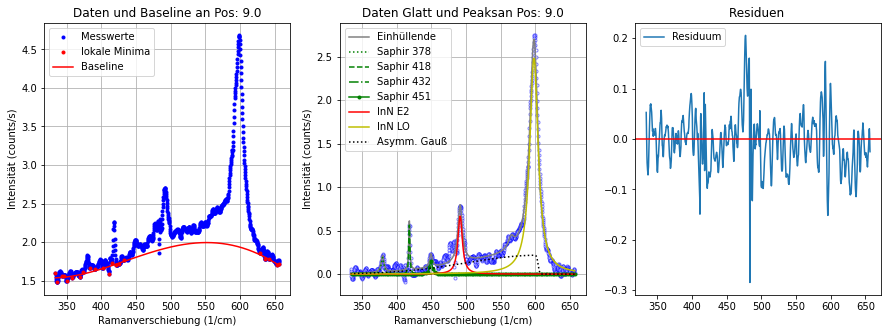

----------------------------------------------------------------------------------------------------
Position: 9.1
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.62655 1.62473 1.62247 ... 1.51457 1.49569 1.39148]
Hintergrund Parameter:  [ 1.00000000e-13 -1.86148150e-10  8.82393953e-08  1.00000000e-05
 -1.29240588e-02  3.20325620e+00]
Fitparameter Saphir 378: [0.047283252196133406, 69.67078839661663, 370.0000000000005]
Fitparameter Saphir 418: [0.6766582931534915, 1.4722432864609387, 418.52091673136175]
Fitparameter Saphir 432: [0.03089186059680909, 5.403012963078217, 441.47123734357103]
Fitparameter Saphir 451: [0.1263138896157372, 9.999999999999998, 453.8876945332879]
Fitparameter InN E2: [0.626568694045745, 9.363456596544573, 492.022095402549]
Fitparameter Saphir 578: [1.3488028642624459, 0.034542429701553405, 579.0803576261196]
Fitparameter InN LO: [2.131685176421689, 14.318174640376347, 598.0503030687959]
Fitparameter Saphi

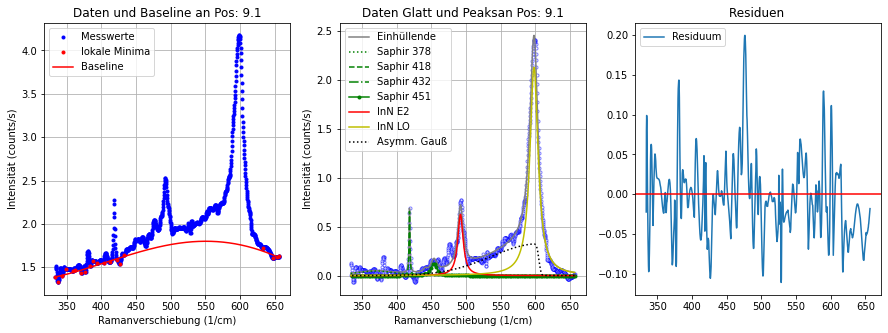

----------------------------------------------------------------------------------------------------
Position: 9.2
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.47977 1.48934 1.49886 ... 1.34051 1.33761 1.3404 ]
Hintergrund Parameter:  [ 1.00008372e-13 -2.16581104e-10  1.18370027e-07  1.00000002e-05
 -1.97818754e-02  4.69298980e+00]
Fitparameter Saphir 378: [0.17218526919426033, 7.478983278005348, 380.7182742792445]
Fitparameter Saphir 418: [0.5626085737287462, 1.933387299748295, 418.73883449305356]
Fitparameter Saphir 432: [0.045248152208670435, 0.803865923379775, 433.22968614471796]
Fitparameter Saphir 451: [0.15535344737846882, 9.999999999999998, 449.3755439226996]
Fitparameter InN E2: [0.5997474894707865, 10.52618972991715, 491.8515859416024]
Fitparameter Saphir 578: [1.7039170912974206, 0.013709896110180229, 579.9472342618974]
Fitparameter InN LO: [1.955934411715191, 13.383492439915562, 598.2072132441863]
Fitparameter Sap

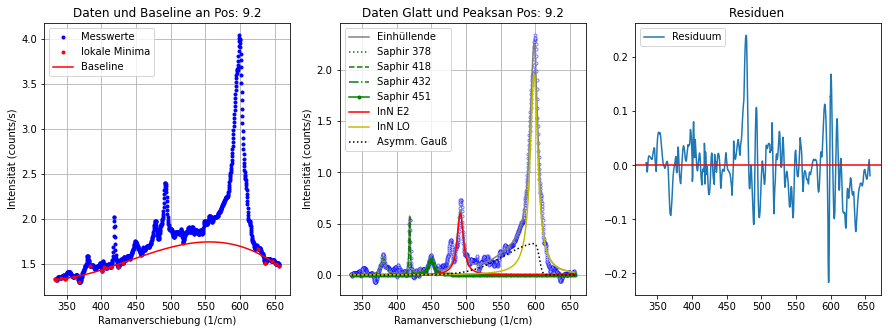

----------------------------------------------------------------------------------------------------
Position: 9.3
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.37367 1.38666 1.39829 ... 1.29739 1.3038  1.30129]
Hintergrund Parameter:  [ 1.00000000e-13 -1.80202774e-10  6.34871652e-08  3.97097844e-05
 -2.71677762e-02  5.37456229e+00]
Fitparameter Saphir 378: [0.157103850558956, 5.155340487494026, 380.8317295562409]
Fitparameter Saphir 418: [0.4136406394830629, 2.2792137321580337, 418.52428558424475]
Fitparameter Saphir 432: [0.04513234314263784, 0.6277252814947955, 432.0556682939803]
Fitparameter Saphir 451: [0.16973042482366626, 5.259447963522478, 449.3303593654592]
Fitparameter InN E2: [0.5657572410341167, 8.564298009675484, 492.08438281175074]
Fitparameter Saphir 578: [0.3032157022889184, 9.999999999999998, 589.89874887181]
Fitparameter InN LO: [1.829820873531912, 11.83791880699043, 598.9135475990361]
Fitparameter Saphir 645

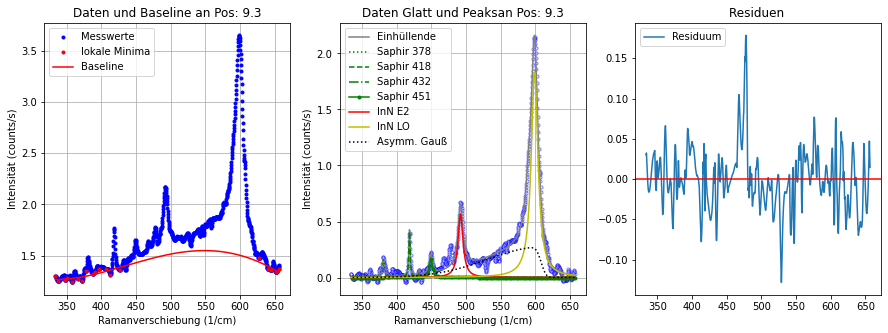

----------------------------------------------------------------------------------------------------
Position: 9.4
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.20379 1.24306 1.26692 ... 1.18738 1.20536 1.23351]
Hintergrund Parameter:  [ 1.00003446e-13 -2.18485905e-10  1.22019592e-07  1.00000002e-05
 -2.19365543e-02  5.15972281e+00]
Fitparameter Saphir 378: [0.14459128401221888, 4.652936538755963, 382.2285038278707]
Fitparameter Saphir 418: [0.3978419873424146, 2.556693645279476, 418.49099593975745]
Fitparameter Saphir 432: [0.02992953448737087, 1.3041460475160491, 450.7363542123427]
Fitparameter Saphir 451: [0.09029733431038652, 9.999999999999998, 451.24212439920154]
Fitparameter InN E2: [0.5546849638075413, 7.49902812855689, 492.07678470648955]
Fitparameter Saphir 578: [0.050812056543379565, 0.3108060261577377, 576.5847632389648]
Fitparameter InN LO: [1.7919781721559012, 14.006983709931184, 598.2055924424634]
Fitparameter Sa

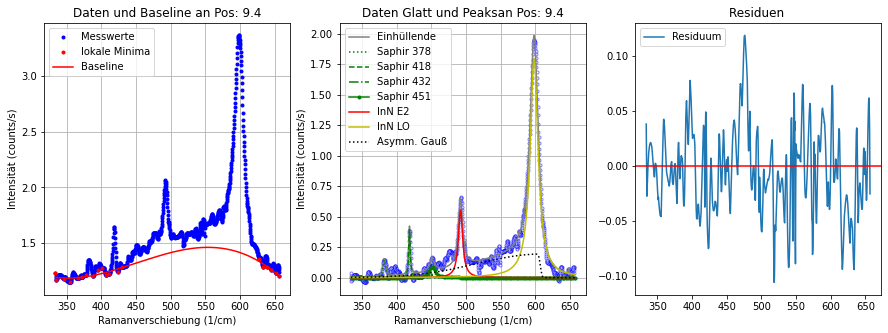

----------------------------------------------------------------------------------------------------
Position: 9.5
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.24529 1.22919 1.21417 ... 1.16847 1.16885 1.18967]
Hintergrund Parameter:  [ 3.75808701e-13 -4.98044685e-10  1.00000000e-08  2.42805868e-04
 -1.17557670e-01  1.76001883e+01]
Fitparameter Saphir 378: [0.10222739502198974, 12.868228094316336, 384.7686939350634]
Fitparameter Saphir 418: [0.5855316502414482, 1.7661701962798038, 418.3548156587421]
Fitparameter Saphir 432: [4.7648703754146975e-17, 0.0428804480740667, 425.8099667571851]
Fitparameter Saphir 451: [0.1076087893751906, 9.276608823368358, 449.1834971167202]
Fitparameter InN E2: [0.46364706336107125, 8.986879712898084, 491.83893831927867]
Fitparameter Saphir 578: [0.14762865956463558, 3.0250306092059516, 587.9081576780766]
Fitparameter InN LO: [1.673322994715979, 12.499309714977825, 598.3978175791648]
Fitparameter 

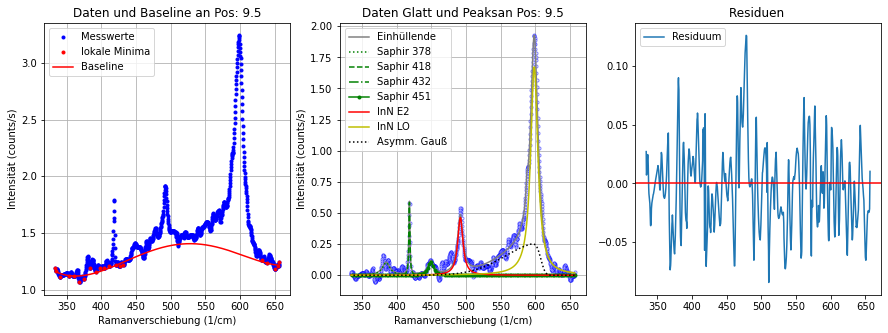

----------------------------------------------------------------------------------------------------
Position: 9.6
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.20613 1.18074 1.17364 ... 1.03533 1.03215 1.00452]
Hintergrund Parameter:  [ 1.00004685e-13 -1.74695134e-10  7.81340573e-08  1.00000000e-05
 -1.16912179e-02  2.64651320e+00]
Fitparameter Saphir 378: [0.10832961702326133, 5.5547126835993055, 380.9296897337516]
Fitparameter Saphir 418: [0.5778962571980334, 1.6984030742968423, 418.3448086600071]
Fitparameter Saphir 432: [0.05416878377503477, 2.0960273315706224, 441.4898157498761]
Fitparameter Saphir 451: [0.06056280297920262, 7.685118120798819, 451.9263893605456]
Fitparameter InN E2: [0.4765638422363348, 6.943133866178364, 492.1749075562952]
Fitparameter Saphir 578: [0.10602732609778069, 2.2647744383328257, 575.8373732797058]
Fitparameter InN LO: [1.6154409246485555, 13.882673076348567, 598.1940746367493]
Fitparameter Sap

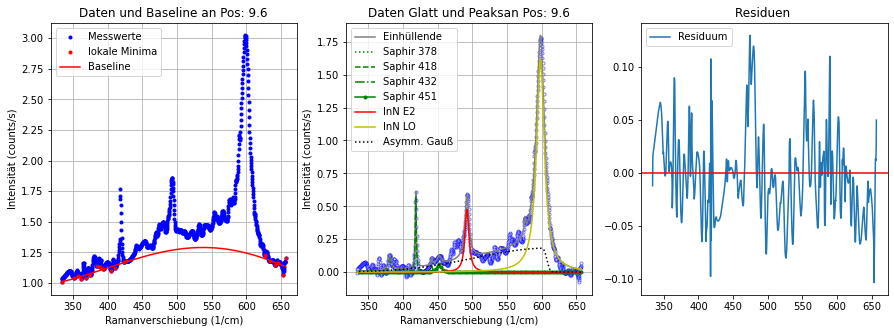

----------------------------------------------------------------------------------------------------
Position: 9.7
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.17776 1.10695 1.04267 ... 1.05266 1.04761 1.01347]
Hintergrund Parameter:  [ 4.60833984e-13 -7.71566299e-10  3.68991275e-07  1.00000000e-05
 -4.44929696e-02  8.68820113e+00]
Fitparameter Saphir 378: [0.11392618008322372, 14.691792584144439, 379.29920162805337]
Fitparameter Saphir 418: [0.5202590269634503, 1.744548140866879, 418.4984059054668]
Fitparameter Saphir 432: [0.057725070901993324, 1.1843235109665555, 430.56651859956776]
Fitparameter Saphir 451: [0.06720895989265244, 9.999999999999998, 450.55649471644165]
Fitparameter InN E2: [0.4318527763055569, 10.436511187089492, 492.21071857922107]
Fitparameter Saphir 578: [0.10949672816334476, 5.908723063859472, 589.9999999999999]
Fitparameter InN LO: [1.440706168996866, 12.815553153631763, 598.8917803415346]
Fitparameter 

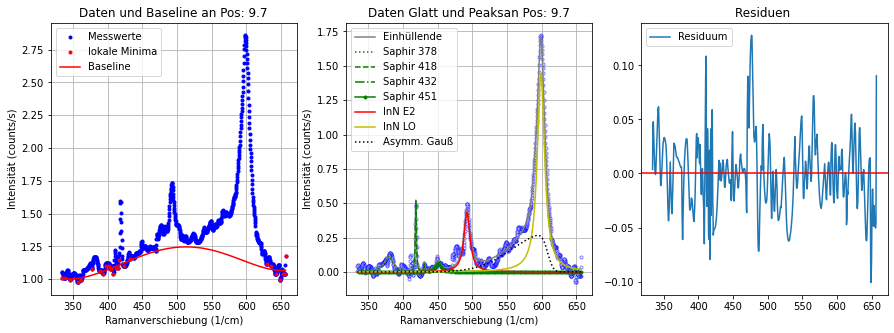

----------------------------------------------------------------------------------------------------
Position: 9.8
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.11544  1.11662  1.1258   ... 0.984776 0.983955 0.982876]
Hintergrund Parameter:  [ 3.23505525e-13 -5.36898689e-10  2.52090445e-07  1.00000000e-05
 -3.13361449e-02  6.28120428e+00]
Fitparameter Saphir 378: [0.14504530135910035, 2.988731142712121, 379.66703915007326]
Fitparameter Saphir 418: [0.40515225560565277, 2.3892659752331062, 418.3429229956419]
Fitparameter Saphir 432: [5.128378433773526e-40, 21.41948153719489, 459.4199234277042]
Fitparameter Saphir 451: [0.07556262881678431, 2.2415528788979877, 449.6993256200236]
Fitparameter InN E2: [0.44200164117638063, 5.627383599226059, 492.0248497191784]
Fitparameter Saphir 578: [0.07018115288450445, 9.999999999999998, 580.4995950770292]
Fitparameter InN LO: [1.365681070675459, 14.357146745168448, 598.6967436362615]
Fitparam

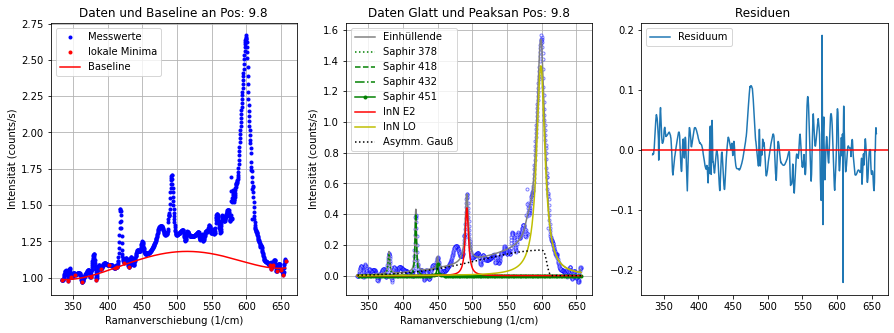

----------------------------------------------------------------------------------------------------
Position: 9.9
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [1.04426  0.981504 0.967431 ... 0.991127 0.99449  1.00013 ]
Hintergrund Parameter:  [ 1.00000002e-13 -1.41839023e-10  1.80434974e-08  5.40262304e-05
 -2.74867130e-02  4.80900100e+00]
Fitparameter Saphir 378: [0.13428351327982524, 3.049533919746736, 379.91337582955384]
Fitparameter Saphir 418: [0.3861675368181091, 2.4071078390431158, 418.42735345553774]
Fitparameter Saphir 432: [0.048743890693388435, 1.4837719214433602, 442.2265782239894]
Fitparameter Saphir 451: [0.0754438220633018, 9.999999999999998, 451.7985818560013]
Fitparameter InN E2: [0.39373229845656327, 7.762770867135355, 492.7718312057036]
Fitparameter Saphir 578: [0.02377824426023407, 1.1329552798031914, 580.8469248583137]
Fitparameter InN LO: [1.2070270428800698, 15.184497540156432, 598.5957353504779]
Fitparam

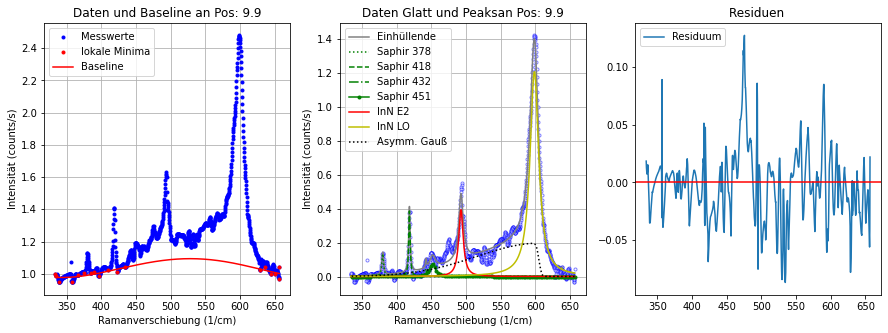

----------------------------------------------------------------------------------------------------
Position: 10.0
x-Daten: [656.59680926 656.29163926 655.98785926 ... 334.48016926 334.15311926
 333.82605926]
y-Daten: [0.928635 0.935192 0.941649 ... 1.00008  0.992045 0.969083]
Hintergrund Parameter:  [ 1.20386827e-13 -1.82790888e-10  1.00000000e-08  9.67131442e-05
 -4.91637603e-02  7.97613768e+00]
Fitparameter Saphir 378: [0.053538586934417945, 31.067396861288895, 381.8952625448323]
Fitparameter Saphir 418: [0.3674058818281211, 2.5846935771254995, 418.64699841047934]
Fitparameter Saphir 432: [0.002619868789941598, 0.003246171487356028, 432.17338189516715]
Fitparameter Saphir 451: [0.11404535046715669, 3.692364327205495, 450.3808765422779]
Fitparameter InN E2: [0.3862179652387748, 8.170977032879726, 492.0578427565957]
Fitparameter Saphir 578: [0.012339392059237966, 0.005227432065984372, 579.5413490722569]
Fitparameter InN LO: [1.253695633868806, 12.947738233248593, 598.7414348299953]
F

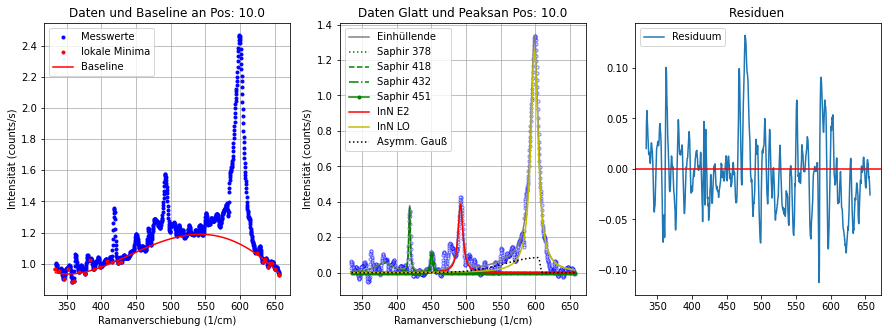

----------------------------------------------------------------------------------------------------


In [133]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Saphir_575_Peaks_Liste=[]
Asymm_Gauß_1_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_aPlane_632nm_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_aPlane_632nm_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_aPlane_632nm_array_float[0],[0])
        y=np.delete(data_aPlane_632nm_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=4)[0]]
        xzw=x[argrelextrema(y, np.less,order=4)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        for j in range(len(xzw)):
            if xzw[j]<=435 or xzw[j]>=625:
                xmin.append(xzw[j])
                ymin.append(yzw[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1]) 
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [1e-12, -2e-9, 9e-7, 1e-4, 0.5, 100]
        param_bounds_base = ([1e-13,-1e-8,1e-8,1e-5,-1,-100],[1e-11,-1e-10,1e-6,1e-3,5,100])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        
    #    #fitten 4 lorentz in saphir_418, InN E2 498, Saphir_575, InN LO 595 + AG 
   #     #def L_x4_AG(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4,amp,fwhm, pos, shape):
  #      init_vals_L_x4_AG = [1,1,419, 5,1,493, 1,1,578, 1,1,599, 1,70,590,-10]
 #       param_bounds_L_x4_AG= ([0,0,410, 0,0,485, 0,0,565, 0,0,585,  0,30,500,-20],
#                               [np.inf,np.inf,430, np.inf,10,505, np.inf,10,585, np.inf,30,605, 20,80,597,np.inf])
       # fitParams_L_x4_AG, cov_L_x4_AG = curve_fit(f=L_x4_AG, xdata=x, ydata=y_glatt, p0=init_vals_L_x4_AG, bounds=param_bounds_L_x4_AG)
      #  fitParams_L_Saphir_418=[fitParams_L_x4_AG[0],fitParams_L_x4_AG[1],fitParams_L_x4_AG[2]]
     #   fitParams_L_InN_E2=[fitParams_L_x4_AG[3],fitParams_L_x4_AG[4],fitParams_L_x4_AG[5]]
    #    fitParams_L_Saphir_575=[fitParams_L_x4_AG[6],fitParams_L_x4_AG[7],fitParams_L_x4_AG[8]]
   #     fitParams_L_InN_LO=[fitParams_L_x4_AG[9],fitParams_L_x4_AG[10],fitParams_L_x4_AG[11]]
  #      fitParams_AG=[fitParams_L_x4_AG[12],fitParams_L_x4_AG[13],fitParams_L_x4_AG[14],fitParams_L_x4_AG[15]]
 #       print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
#        print("Fitparameter InN E2:",fitParams_L_InN_E2)
       # print("Fitparameter InN LO:",fitParams_L_InN_LO)
      #  print("Fitparameter Saphir 575: ", fitParams_L_Saphir_575)
     #   print("Fitparameter Asymmetrischer Gauß: ", fitParams_AG)
    #    
   #     #plot 
  #      fig = plt.figure(figsize=(15,5))
 #           # Plot 1 für Daten roh und baseline
#        plt.subplot(1, 3, 1) 
       # plt.title('Daten und Baseline an Pos: '+str(position))
      #  plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
     #   plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
    #    plt.plot(x, ybase,'r', label='Baseline') 
   #     plt.xlabel('Ramanverschiebung (1/cm)')
  #      plt.ylabel('Intensität (counts/s)')
 #       plt.grid(True)
#        plt.legend(loc='upper left')
        
     ##       # Plot für Daten glatt und peaks
    #    plt.subplot(1, 3, 2)
   #     plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
  #      plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
 #       plt.plot(x,L_x4_AG(x, fitParams_L_x4_AG[0],fitParams_L_x4_AG[1],fitParams_L_x4_AG[2], fitParams_L_x4_AG[3],fitParams_L_x4_AG[4],fitParams_L_x4_AG[5],fitParams_L_x4_AG[6],fitParams_L_x4_AG[7],fitParams_L_x4_AG[8],fitParams_L_x4_AG[9],fitParams_L_x4_AG[10],fitParams_L_x4_AG[11],fitParams_L_x4_AG[12],fitParams_L_x4_AG[13],fitParams_L_x4_AG[14],fitParams_L_x4_AG[15]), color='dimgray'  ,markersize=1, label='Einhüllende')
#        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0], fitParams_L_Saphir_418[1], fitParams_L_Saphir_418[2]), color='g'  ,markersize=3, label='Saphir 418')
       # plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0], fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
      #  plt.plot(x,Lorentz(x, fitParams_L_Saphir_575[0], fitParams_L_Saphir_575[1], fitParams_L_Saphir_575[2]),':', color='g'  ,markersize=3, label='Saphir 575')
     #   plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0], fitParams_L_InN_LO[1], fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
    #    plt.plot(x,asymmgauss(x, fitParams_AG[0], fitParams_AG[1], fitParams_AG[2], fitParams_AG[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
   #     plt.xlabel('Ramanverschiebung (1/cm)')
  #      plt.ylabel('Intensität (counts/s)')
 #       plt.grid(True)
#        plt.legend(loc='upper left')
        
            # Plot Residuen Fitt
     #   plt.subplot(1, 3, 3)
    #    plt.title('Residuen ')
   #     plt.plot(x,y_glatt-L_x4_AG(x, fitParams_L_x4_AG[0],fitParams_L_x4_AG[1],fitParams_L_x4_AG[2], fitParams_L_x4_AG[3],fitParams_L_x4_AG[4],fitParams_L_x4_AG[5],fitParams_L_x4_AG[6],fitParams_L_x4_AG[7],fitParams_L_x4_AG[8],fitParams_L_x4_AG[9],fitParams_L_x4_AG[10],fitParams_L_x4_AG[11],fitParams_L_x4_AG[12],fitParams_L_x4_AG[13],fitParams_L_x4_AG[14],fitParams_L_x4_AG[15]), label=("a-plane Residuum"))
  #      plt.axhline(y = 0, color = 'r', linestyle = '-')
 #       #plt.grid(True)
#        plt.legend(loc='upper left')
        
        
        
        
        
        #fitten 4 lorentz in saphir_378, saphir_418, saphir_432, saphir_451, InN E2 498, saphir_578, InN LO 595, saphir_645, saphir_751,
        #+ 2Asymmetrischer Gauß
        #L_x9_AG_x2(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6, A7,D7,W7, A8,D8,W8, A9,D9,W9, amp,fwhm,pos,shape, amp2,fwhm2,pos2,shape2):
        # 9 Lorentzpeaks + 2 Asymmetrischer gauß
        init_vals_L_x9_AG_x1 = [1,1,378, 1,1,418, 1,1,432, 1,1,451, 1,1,498, 1,1,580, 1,1,595, 1,1,650, 1,1,751, 1,70,609,-10]
        param_bounds_L_x9_AG_x1= ([0,0,370, 0,0,405, 0,0,420, 0,0,430, 0,0,490, 0,0,565, 0,0,585, 0,0,635, 0,0,735, 0,50,600,-np.inf],
                                  [np.inf,np.inf,395, np.inf,np.inf,430, np.inf,np.inf,460, np.inf,10,470, np.inf,np.inf,510, np.inf,10,590, np.inf,np.inf,610, np.inf,np.inf,655, np.inf,np.inf,760, 2,np.inf,610,np.inf])
        fitParams_L_x9_AG_x1, cov_L_x9_AG_x1 = curve_fit(f=L_x9_AG_x1, xdata=x, ydata=y_glatt, p0=init_vals_L_x9_AG_x1, bounds=param_bounds_L_x9_AG_x1)
        fitParams_L_Saphir_378=[fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2]]
        fitParams_L_Saphir_418=[fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5]]
        fitParams_L_Saphir_432=[fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8]]
        fitParams_L_Saphir_451=[fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11]]
        fitParams_L_InN_E2=[fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14]]
        fitParams_L_Saphir_578=[fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17]]
        fitParams_L_InN_LO=[fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20]]
        fitParams_L_Saphir_645=[fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23]]
        fitParams_L_Saphir_751=[fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26]]
        fitParams_AG_1=[fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]]
        #fitParams_AG_2=[fitParams_L_x9_AG_x2[31],fitParams_L_x9_AG_x2[32],fitParams_L_x9_AG_x2[33],fitParams_L_x9_AG_x2[34]]
        print("Fitparameter Saphir 378:",fitParams_L_Saphir_378)
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter Saphir 432:",fitParams_L_Saphir_432)
        print("Fitparameter Saphir 451:",fitParams_L_Saphir_451)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter Saphir 578:",fitParams_L_Saphir_578)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter Saphir 645:",fitParams_L_Saphir_645)
        print("Fitparameter Saphir 751:",fitParams_L_Saphir_751)
        print("Fitparameter Asymmetrischer Gauß 1: ", fitParams_AG_1)
        #print("Fitparameter Asymmetrischer Gauß 2: ", fitParams_AG_2)



        # plotten
        fig = plt.figure(figsize=(15,5))
        # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), color='gray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_378[0],fitParams_L_Saphir_378[1],fitParams_L_Saphir_378[2]),':', color='g'  ,markersize=3, label='Saphir 378')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_418[0],fitParams_L_Saphir_418[1],fitParams_L_Saphir_418[2]),'--', color='g'  ,markersize=3, label='Saphir 418')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_432[0],fitParams_L_Saphir_432[1],fitParams_L_Saphir_432[2]),'-.', color='g'  ,markersize=3, label='Saphir 432')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_451[0],fitParams_L_Saphir_451[1],fitParams_L_Saphir_451[2]),'-o', markevery=8, color='g'  ,markersize=3, label='Saphir 451')
        plt.plot(x,Lorentz(x, fitParams_L_InN_E2[0],fitParams_L_InN_E2[1],fitParams_L_InN_E2[2]), color='r'  ,markersize=3, label='InN E2')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_578[0],fitParams_L_Saphir_578[1],fitParams_L_Saphir_578[2]),'-s', markevery=8, color='g'  ,markersize=3, label='Saphir 578')
        plt.plot(x,Lorentz(x, fitParams_L_InN_LO[0],fitParams_L_InN_LO[1],fitParams_L_InN_LO[2]), color='y'  ,markersize=3, label='InN LO')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_645[0],fitParams_L_Saphir_645[1],fitParams_L_Saphir_645[2]),'-d', markevery=8, color='g'  ,markersize=3, label='Saphir 645')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_751[0],fitParams_L_Saphir_751[1],fitParams_L_Saphir_751[2]),'-v', markevery=8, color='g'  ,markersize=3, label='Saphir 751')
        plt.plot(x,asymmgauss(x, fitParams_AG_1[0],fitParams_AG_1[1],fitParams_AG_1[2],fitParams_AG_1[3]),':', color='black'  ,markersize=3, label='Asymm. Gauß')
        #plt.plot(x,asymmgauss(x, fitParams_AG_2[0],fitParams_AG_2[1],fitParams_AG_2[2],fitParams_AG_2[3]),'--', color='black'  ,markersize=3, label='Asymm. Gauß 2')
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
        # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
        plt.plot(x,y_glatt-L_x9_AG_x1(x, fitParams_L_x9_AG_x1[0],fitParams_L_x9_AG_x1[1],fitParams_L_x9_AG_x1[2],fitParams_L_x9_AG_x1[3],fitParams_L_x9_AG_x1[4],fitParams_L_x9_AG_x1[5],fitParams_L_x9_AG_x1[6],fitParams_L_x9_AG_x1[7],fitParams_L_x9_AG_x1[8],fitParams_L_x9_AG_x1[9],fitParams_L_x9_AG_x1[10],fitParams_L_x9_AG_x1[11],fitParams_L_x9_AG_x1[12],fitParams_L_x9_AG_x1[13],fitParams_L_x9_AG_x1[14],fitParams_L_x9_AG_x1[15],fitParams_L_x9_AG_x1[16],fitParams_L_x9_AG_x1[17],fitParams_L_x9_AG_x1[18],fitParams_L_x9_AG_x1[19],fitParams_L_x9_AG_x1[20],fitParams_L_x9_AG_x1[21],fitParams_L_x9_AG_x1[22],fitParams_L_x9_AG_x1[23],fitParams_L_x9_AG_x1[24],fitParams_L_x9_AG_x1[25],fitParams_L_x9_AG_x1[26],fitParams_L_x9_AG_x1[27],fitParams_L_x9_AG_x1[28],fitParams_L_x9_AG_x1[29],fitParams_L_x9_AG_x1[30]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
        
        
        
        
        if i == data_aPlane_632nm_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/A-Plane Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/A-Plane Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == data_aPlane_632nm_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/A-Plane Auswertung D0 632nm Position '+ str(position) + '.png')
            
        plt.show()
     
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Saphir_418_Peaks_Liste.append([position, fitParams_L_Saphir_418])
        #Saphir_575_Peaks_Liste.append([position, fitParams_L_Saphir_575])
        Asymm_Gauß_1_Liste.append([position,fitParams_AG_1])
        Baseline_Liste.append([position,fitParams_base])
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

asymm gauß 1


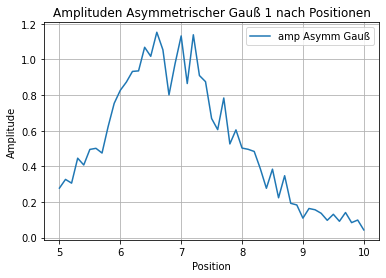

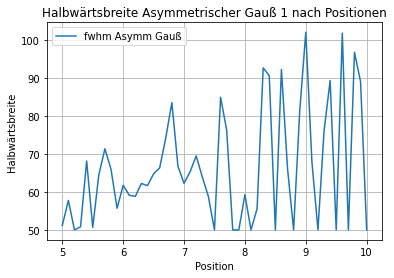

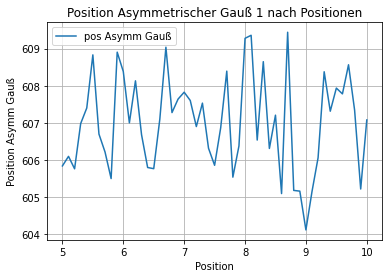

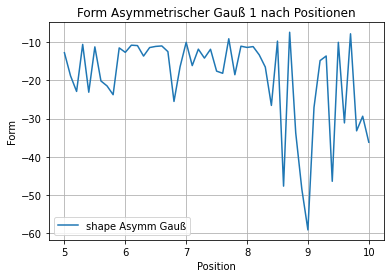

---------------------------------------------------------------------------------


In [134]:
# Verhalten Asymmetrischer Gauß und Baseline
# mittlung der Asymm Gauß parameter und abweichungen

print("asymm gauß 1")
Positionen=[]
Asymm_Gauß_1_Liste_Amp=[]
Asymm_Gauß_1_Liste_fwhm=[]
Asymm_Gauß_1_Liste_pos=[]
Asymm_Gauß_1_Liste_shape=[]
for i in range(len(Asymm_Gauß_1_Liste)):
    Positionen.append(Asymm_Gauß_1_Liste[i][0])
    Asymm_Gauß_1_Liste_Amp.append(Asymm_Gauß_1_Liste[i][1][0])
    Asymm_Gauß_1_Liste_fwhm.append(Asymm_Gauß_1_Liste[i][1][1])
    Asymm_Gauß_1_Liste_pos.append(Asymm_Gauß_1_Liste[i][1][2])
    Asymm_Gauß_1_Liste_shape.append(Asymm_Gauß_1_Liste[i][1][3])
    
#print("Asymmetrischer Gauß 1 Amplitude:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_Amp), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_Amp), "\nMin: ", min(Asymm_Gauß_1_Liste_Amp))

#print("Asymmetrischer Gauß 1 Halbwärtsbreite:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_fwhm), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_fwhm), "\nMin: ", min(Asymm_Gauß_1_Liste_fwhm))

#print("Asymmetrischer Gauß 1 Position:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_pos), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_pos), "\nMin: ", min(Asymm_Gauß_1_Liste_pos))

#print("Asymmetrischer Gauß 1 Form:", "\nMittel: ", np.mean(Asymm_Gauß_1_Liste_shape), 
#      "\nMax: ", max(Asymm_Gauß_1_Liste_shape), "\nMin: ", min(Asymm_Gauß_1_Liste_shape))


#Plotten
plt.title('Amplituden Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_Amp ,markersize=2, label='amp Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Amplitude')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Halbwärtsbreite Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_fwhm ,markersize=2, label='fwhm Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Halbwärtsbreite')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Position Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_pos ,markersize=2, label='pos Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Position Asymm Gauß')
plt.grid(True)
plt.legend()
plt.show()

plt.title('Form Asymmetrischer Gauß 1 nach Positionen')
plt.plot(Positionen, Asymm_Gauß_1_Liste_shape ,markersize=2, label='shape Asymm Gauß') 
plt.xlabel('Position')
plt.ylabel('Form')
plt.grid(True)
plt.legend()
plt.show()

print("---------------------------------------------------------------------------------")

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
#    Base_Para_3.append(Baseline_Liste[k][1][2])
#    Base_Para_4.append(Baseline_Liste[k][1][3])
#    Base_Para_5.append(Baseline_Liste[k][1][4])
#    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [ 2.4083246   1.05326921  7.38667924 -0.79219245  0.48161138]
Asym Gauß LO Parameter Amp-R: [ 6.94724383  1.01680015  7.29922629 -0.60380229  1.59315198]
Gauß E2 Parameter Amp-R: [ 3.47135922  2.41510444  6.88453113 -0.12112331]
Gauß LO Parameter Amp-R: [ 9.53417055  2.43559548  6.88920423 -0.04247153]


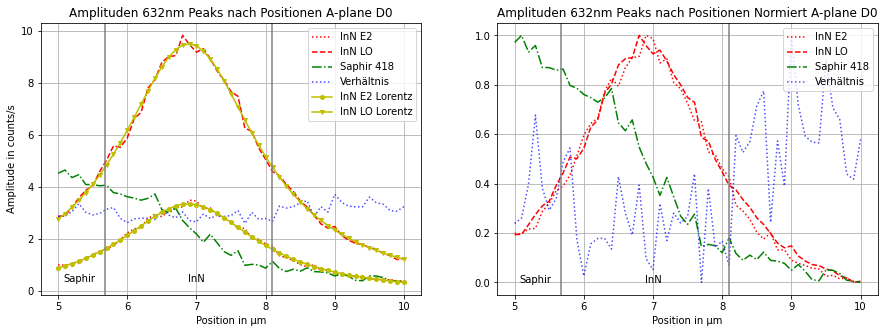

In [135]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_Saphir_418_Amp=[]
Peak_Saphir_575_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])
    #Peak_Saphir_575_Amp.append(Saphir_575_Peaks_Liste[i][1][0])
 
    
Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    
    
#Fitten Asym Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,7,0,1]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,7,0,1]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 


#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,7,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,7,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 


    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden 632nm Peaks nach Positionen A-plane D0')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_418_Amp, '-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp,':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='InN E2 Fitt')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='InN LO Fitt')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_Amp),s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Peak_Saphir_418_Amp),s='Saphir')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden 632nm Peaks nach Positionen Normiert A-plane D0')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp), '-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_632nm/A-Plane Amplituden Peaks nach Positionen D0 632nm')
plt.show()

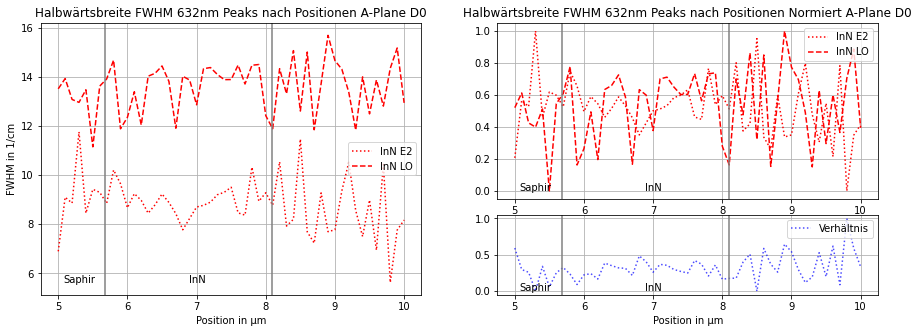

In [136]:
# Halbwärtsbreiten fwhm nach Positionen
 
#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_Saphir_418_fwhm=[]
Peak_Saphir_575_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
    #Peak_Saphir_575_fwhm.append(Saphir_575_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
    
   
#Plotten
fig = plt.figure(figsize=(15,5))

#plt.subplot(1, 2, 1) 
#plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen a-plane D0')
#plt.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_fwhm, ':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
        
#plt.xlabel('Position')
#plt.ylabel('Halbwärtsbreite fwhm')
#plt.grid(True)
#plt.legend(loc='upper right')

#plt.subplot(1, 2, 2) 
#plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen Normiert a-plane D0')
#plt.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
##plt.plot(Positionen, NormalizeData(Peak_Saphir_418_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

#plt.xlabel('Position')
##plt.ylabel('Amplitude')
#plt.grid(True)
#plt.legend(loc='upper right')


gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='center right')
ax1.set_title("Halbwärtsbreite FWHM 632nm Peaks nach Positionen A-Plane D0")
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm),s='InN')
ax1.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Peak_InN_E2_fwhm),s='Saphir')


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
ax2.set_title("Halbwärtsbreite FWHM 632nm Peaks nach Positionen Normiert A-Plane D0")
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.text(x=fitParams_G_E2[2],y=0,s='InN')
ax2.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')

ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position in \u03bcm')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=0,s='InN')
ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')


plt.savefig('Bilder_Graphen_632nm/A-Plane Halbwärtsbreite fwhm Peaks nach Positionen D0 632nm')
plt.show()

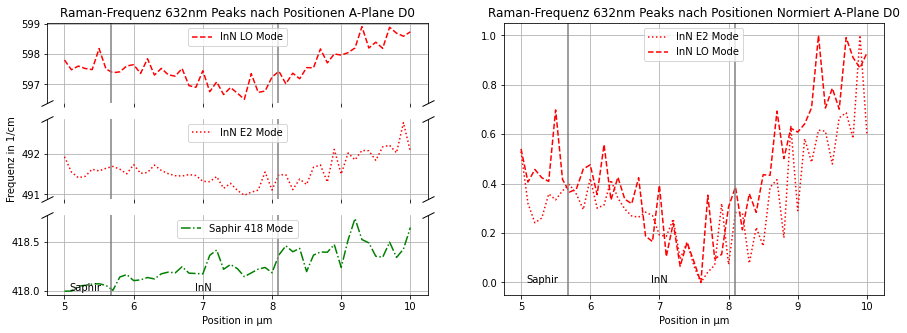

In [137]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_Saphir_418_w=[]
Peak_Saphir_575_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
    #Peak_Saphir_575_w.append(Saphir_575_Peaks_Liste[i][1][1])
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
   
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_Saphir_418_w,'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=min(Peak_Saphir_418_w),s='InN')
ax3.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Peak_Saphir_418_w),s='Saphir')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz in 1/cm')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 632nm Peaks nach Positionen A-Plane D0")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_w),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz 632nm Peaks nach Positionen Normiert A-Plane D0")
ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2],y=0,s='InN')
ax4.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=0,s='Saphir')

plt.savefig('Bilder_Graphen_632nm/A-Plane Raman-Frequenz Peaks nach Positionen D0 632nm')
plt.show()

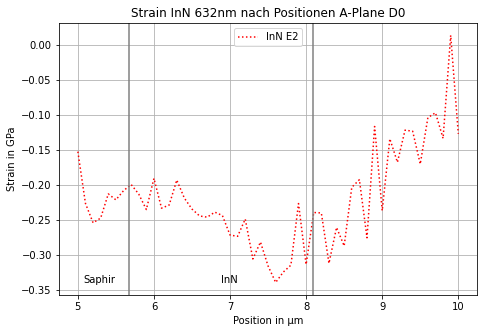

In [138]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain InN 632nm nach Positionen A-Plane D0')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')
plt.text(x=fitParams_G_E2[2]-fitParams_G_E2[1]/2-fitParams_G_E2[1]/4,y=min(Strain_InN_E2_Liste),s='Saphir')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_632nm/A-Plane Strain nach Positionen D0 632nm')
plt.show()

## MBE

Probenoberfläche vor Messung
<img src="Daten_632nm/MBE_Mapping_632nm_Bild1a.jpg" style="width:300px;"/>

### Datenladen

In [139]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "MBE_Mapping_632nm_Bild1_D0_2x60s.txt") as f1:
        data_MBE_632nm_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_MBE_632nm_array_str = np.array(data_MBE_632nm_txt)               #in np array umwandeln um listen von listen zu entkommen
data_MBE_632nm_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_MBE_632nm_array_float = data_MBE_632nm_array_str.astype(float)   #str zu float in Arrayform
print(data_MBE_632nm_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_MBE_632nm_array_float[0])):
    data_MBE_632nm_array_float[0][k]=data_MBE_632nm_array_float[0][k]-Verschiebung_MEPA
print(data_MBE_632nm_array_float)

[[  0.      657.95062 657.64545 ... 335.83398 335.50693 335.17987]
 [  5.        5.19738   5.24016 ...   4.66764   4.66234   4.65859]
 [  5.1       5.54595   5.64667 ...   5.02041   5.03069   5.05706]
 ...
 [ 10.8       4.27175   4.28011 ...   3.78403   3.79659   3.66794]
 [ 10.9       4.4562    4.40459 ...   3.41957   3.36829   3.2997 ]
 [ 11.        3.80071   3.78247 ...   3.08533   3.0421    3.10667]]
[[ -1.80472486 656.14589514 655.84072514 ... 334.02925514 333.70220514
  333.37514514]
 [  5.           5.19738      5.24016    ...   4.66764      4.66234
    4.65859   ]
 [  5.1          5.54595      5.64667    ...   5.02041      5.03069
    5.05706   ]
 ...
 [ 10.8          4.27175      4.28011    ...   3.78403      3.79659
    3.66794   ]
 [ 10.9          4.4562       4.40459    ...   3.41957      3.36829
    3.2997    ]
 [ 11.           3.80071      3.78247    ...   3.08533      3.0421
    3.10667   ]]


### Fitten und Plotten

Position: 5.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.19738 5.24016 5.2775  ... 4.66764 4.66234 4.65859]
Hintergrund Parameter:  [-3.41842593e-12  8.46987118e-09 -8.37819233e-06  4.12037925e-03
 -1.00000059e+00  9.99988288e+01]
Fitparameter 480: [0.0591070372901644, 114452.09278562176, 470.00000000000006]
Fitparameter InN E2: [5.1734354157449856, 3.402969418879727, 492.8477916889116]
Fitparameter InN LO: [2.088831668002958, 11.261346026270376, 597.9566963911195]
Fitparameter GaN E2:  [2.397856481977835, 2.5074477213415007, 570.3235719418723]


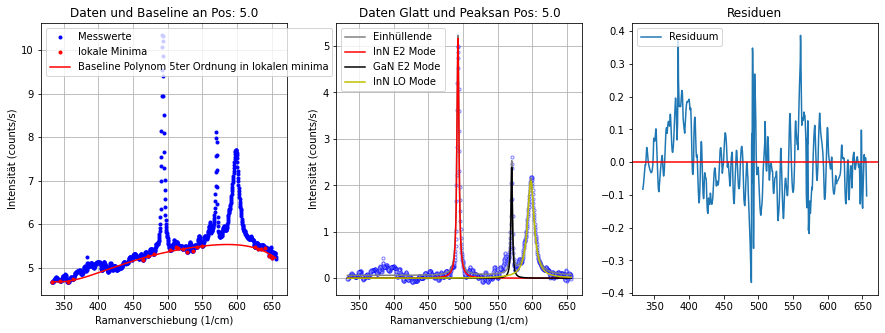

----------------------------------------------------------------------------------------------------
Position: 5.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.54595 5.64667 5.67171 ... 5.02041 5.03069 5.05706]
Hintergrund Parameter:  [-5.43286658e-12  1.34898864e-08 -1.32837578e-05  6.46486696e-03
 -1.54657049e+00  1.49999994e+02]
Fitparameter 480: [6.144949893258297e-09, 5.0006215682197805e-05, 470.09115781215667]
Fitparameter InN E2: [5.579901566226475, 3.4729520155611793, 492.94318650231423]
Fitparameter InN LO: [2.2190953683529893, 12.897941754380932, 598.0324312191306]
Fitparameter GaN E2:  [2.413690029621171, 3.3444186808151666, 570.1776909153685]
BILD an Pos:  5.1


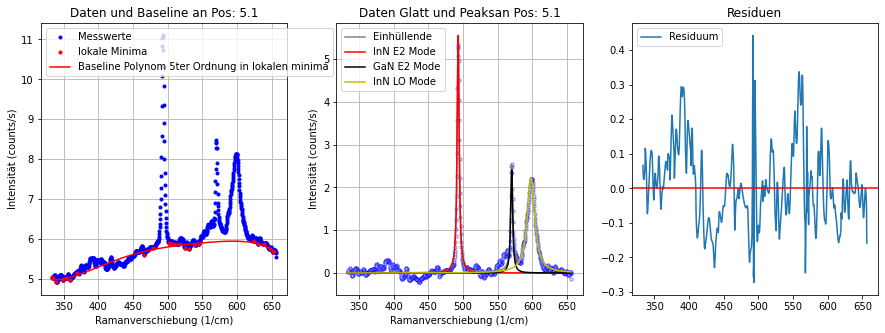

----------------------------------------------------------------------------------------------------
Position: 5.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.28411 6.28075 6.27869 ... 5.58108 5.58513 5.55294]
Hintergrund Parameter:  [-3.55377392e-12  8.70210497e-09 -8.52186415e-06  4.15501544e-03
 -1.00000237e+00  9.99992893e+01]
Fitparameter 480: [0.060736536251950496, 487.1236153831858, 470.00000000000006]
Fitparameter InN E2: [6.116744287891299, 3.457003496575459, 492.85063898387983]
Fitparameter InN LO: [2.4744919860597925, 12.019186684475436, 598.113670921504]
Fitparameter GaN E2:  [2.8082355616267027, 2.8060335225472612, 570.2881058624168]


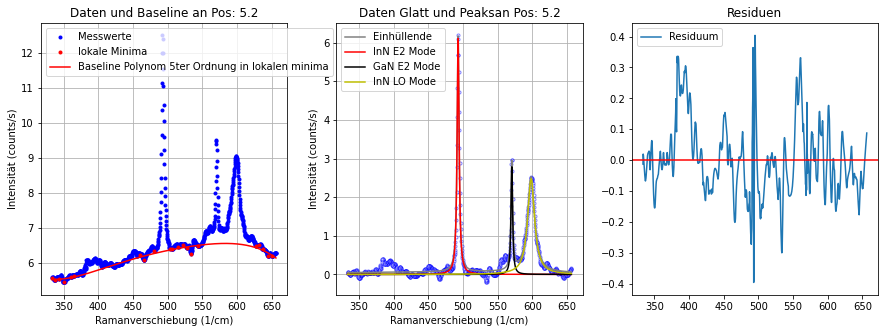

----------------------------------------------------------------------------------------------------
Position: 5.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.86741 6.84588 6.78796 ... 6.05378 6.07486 5.89387]
Hintergrund Parameter:  [-3.50720108e-12  8.64751212e-09 -8.50898868e-06  4.15803556e-03
 -1.00000048e+00  9.99996517e+01]
Fitparameter 480: [0.05517772026396834, 722.4436536000936, 470.00000000000006]
Fitparameter InN E2: [6.546198704825179, 3.3630311982253493, 492.87505578117054]
Fitparameter InN LO: [2.705220355537801, 11.468554197587283, 598.3515783372385]
Fitparameter GaN E2:  [2.8343717676925166, 2.87090097059137, 570.2892589428294]


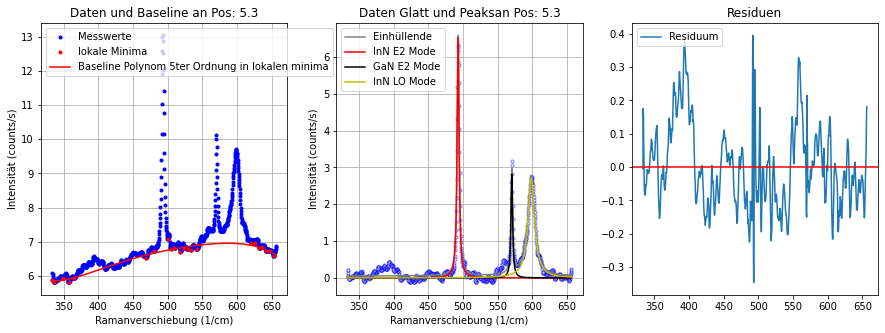

----------------------------------------------------------------------------------------------------
Position: 5.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [7.30898 7.33871 7.37734 ... 6.57774 6.53778 6.32484]
Hintergrund Parameter:  [-3.48385758e-12  8.64415958e-09 -8.53658714e-06  4.17273110e-03
 -1.00001107e+00  9.99979497e+01]
Fitparameter 480: [0.08004562741454913, 1054.4238344101148, 470.00000000000006]
Fitparameter InN E2: [6.459308097086827, 3.665444343425877, 492.8197453094405]
Fitparameter InN LO: [2.835891315560117, 11.757691285594309, 598.0074439655585]
Fitparameter GaN E2:  [3.1625789647035583, 2.6596607641984877, 570.2367605703339]


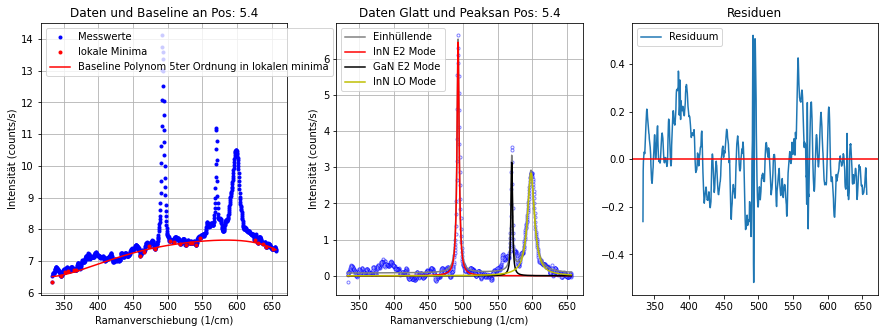

----------------------------------------------------------------------------------------------------
Position: 5.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.04605 7.99449 7.95198 ... 7.53862 7.56834 7.59589]
Hintergrund Parameter:  [-3.92867926e-12  9.36148935e-09 -8.92703680e-06  4.24678727e-03
 -9.99997702e-01  1.00002078e+02]
Fitparameter 480: [0.45152445844092337, 0.026724443198198534, 470.97843412474253]
Fitparameter InN E2: [7.075363663084885, 3.5649801378512405, 492.85488904148195]
Fitparameter InN LO: [2.93433221780604, 12.34920581557511, 598.0281519838248]
Fitparameter GaN E2:  [2.9485972524886668, 3.0344782498679876, 570.3202861739563]


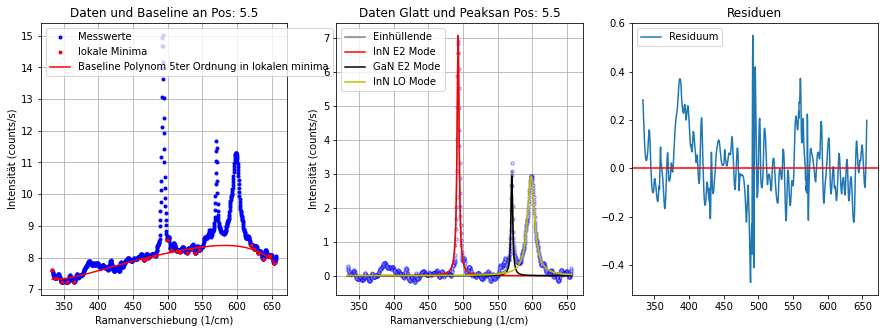

----------------------------------------------------------------------------------------------------
Position: 5.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [8.84403 8.81804 8.80985 ... 7.74578 7.71865 7.69536]
Hintergrund Parameter:  [-3.75815750e-12  9.09011184e-09 -8.79410139e-06  4.23003524e-03
 -1.00000544e+00  9.99963870e+01]
Fitparameter 480: [0.17104401067479705, 1.8511230298234214, 474.64426545711916]
Fitparameter InN E2: [7.6804660092665875, 3.522734729356357, 492.7944848834295]
Fitparameter InN LO: [3.2037577206117356, 12.777350986516574, 597.9686026711246]
Fitparameter GaN E2:  [3.1663166756218852, 3.008527801480616, 570.2861716526913]


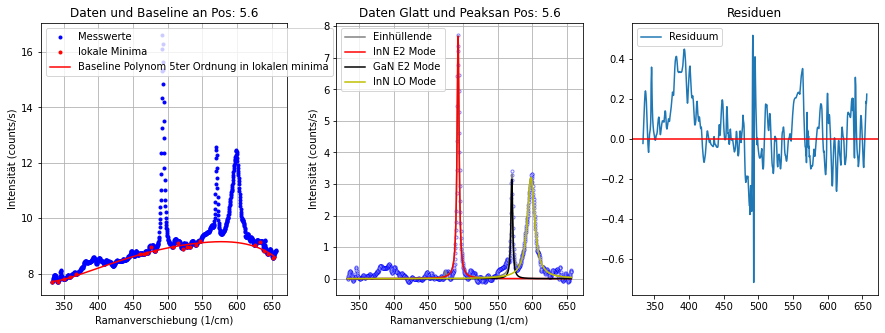

----------------------------------------------------------------------------------------------------
Position: 5.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [9.16335 9.21078 9.21436 ... 8.29496 8.25933 8.24971]
Hintergrund Parameter:  [-3.68149547e-12  9.00176487e-09 -8.77628325e-06  4.23557583e-03
 -9.99999023e-01  1.00042746e+02]
Fitparameter 480: [4.265148885626627e-09, 0.04690229275678382, 479.9766506141666]
Fitparameter InN E2: [8.073894629778929, 3.7712490985126643, 492.90450722444695]
Fitparameter InN LO: [3.5541968200589897, 12.907933568147758, 598.1617231606982]
Fitparameter GaN E2:  [3.2120237670528073, 3.1826175301523087, 570.41670756807]


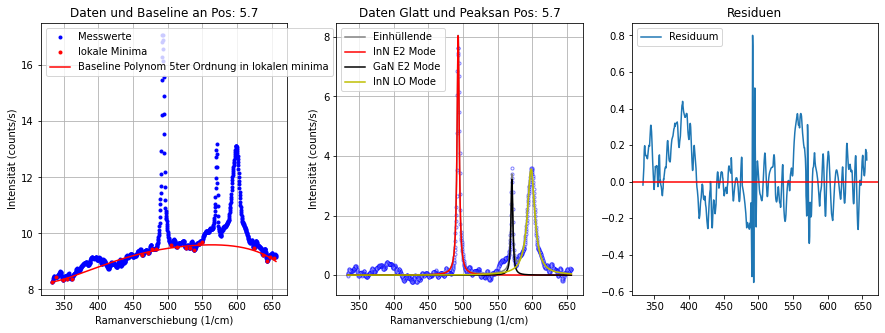

----------------------------------------------------------------------------------------------------
Position: 5.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [10.3096  10.2977  10.2756  ...  9.00089  9.01197  9.01431]
Hintergrund Parameter:  [-3.84203756e-12  9.23906758e-09 -8.90225581e-06  4.26366732e-03
 -9.99998849e-01  1.00000859e+02]
Fitparameter 480: [0.0027162312272169965, 0.03928373524357937, 475.0693471265214]
Fitparameter InN E2: [8.89937551291816, 3.4240296525831546, 492.78636718493357]
Fitparameter InN LO: [3.5752462813913284, 12.113043567768567, 597.9250767385703]
Fitparameter GaN E2:  [3.6880895487061762, 2.671154307503076, 570.2235138392499]


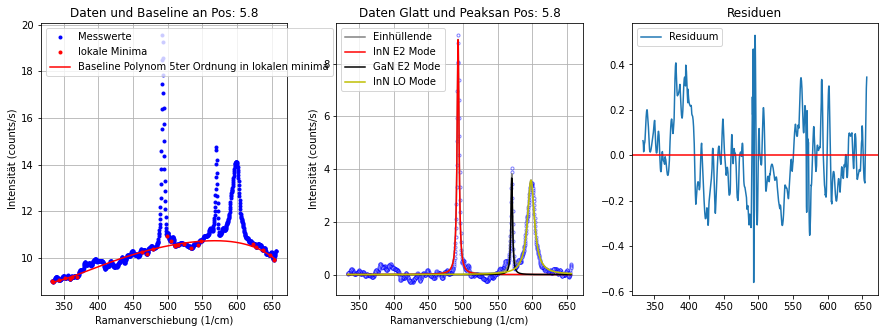

----------------------------------------------------------------------------------------------------
Position: 5.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [11.0614 11.1274 11.1787 ... 10.0408 10.0839 10.1329]
Hintergrund Parameter:  [-4.00484424e-12  9.51960514e-09 -9.07170454e-06  4.30239233e-03
 -9.99993841e-01  1.00007380e+02]
Fitparameter 480: [0.05194998680609249, 213037.18063231313, 470.00000000000006]
Fitparameter InN E2: [9.25135698055262, 3.5235951374815806, 492.78228594270144]
Fitparameter InN LO: [3.7319630931893366, 11.720842448035048, 598.1123802507999]
Fitparameter GaN E2:  [4.0235921558783705, 2.5288502423489194, 570.3845398499936]


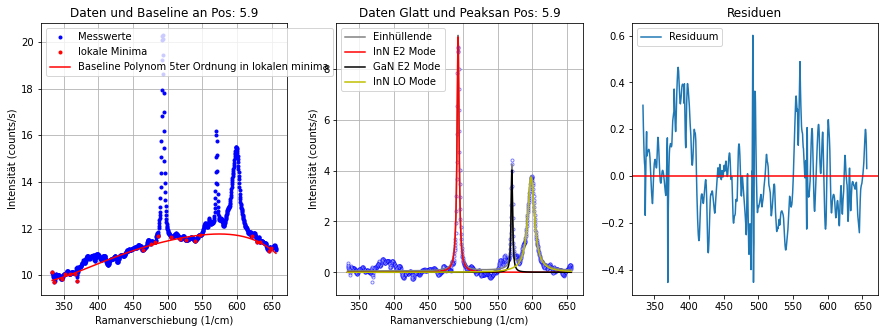

----------------------------------------------------------------------------------------------------
Position: 6.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [13.9898 14.0802 14.1938 ... 13.003  13.0678 13.1469]
Hintergrund Parameter:  [-4.72127037e-12  1.07883672e-08 -9.84745159e-06  4.47493983e-03
 -9.99999361e-01  1.00003097e+02]
Fitparameter 480: [0.16158218085127826, 397.9384705187241, 470.00000000000006]
Fitparameter InN E2: [9.98994524379974, 3.5393466537174043, 492.76772193151106]
Fitparameter InN LO: [4.1675061255936345, 11.56737432115496, 597.8958719089401]
Fitparameter GaN E2:  [4.110272352698603, 2.5830243031913356, 570.2573949709334]


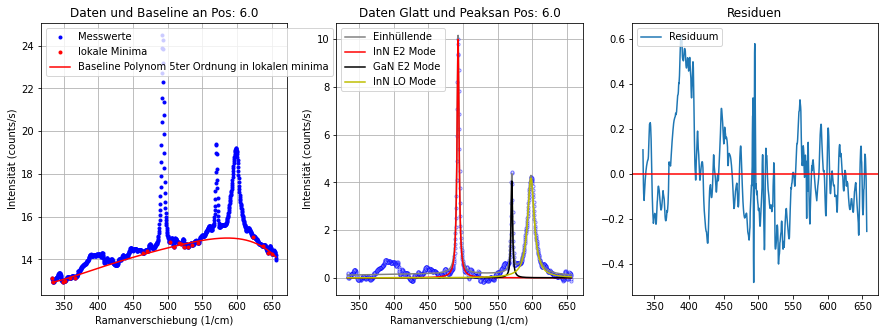

----------------------------------------------------------------------------------------------------
Position: 6.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [16.2931 16.2464 16.2074 ... 14.7156 14.7099 14.6995]
Hintergrund Parameter:  [-4.53959422e-12  1.05803030e-08 -9.80679388e-06  4.49111219e-03
 -9.99996929e-01  1.00003064e+02]
Fitparameter 480: [0.05616105056384637, 654.1801250474538, 470.0000000000007]
Fitparameter InN E2: [10.610817478920072, 3.669646388010637, 492.70273982272886]
Fitparameter InN LO: [4.501072695168859, 12.707589614128588, 597.9329461297001]
Fitparameter GaN E2:  [3.815966095755104, 3.409715864350068, 570.2239199246923]


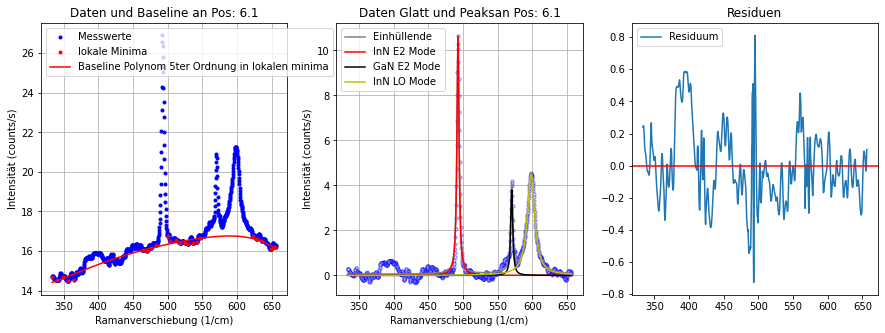

----------------------------------------------------------------------------------------------------
Position: 6.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [17.7615 17.6471 17.5725 ... 16.0639 16.0573 16.0622]
Hintergrund Parameter:  [-5.05638432e-12  1.14138513e-08 -1.02693086e-05  4.58427128e-03
 -9.99996764e-01  1.00003228e+02]
Fitparameter 480: [0.15401140490466933, 155255.1165021203, 470.00000000000006]
Fitparameter InN E2: [11.53055760964056, 3.5135910816183586, 492.8099871611533]
Fitparameter InN LO: [4.727785295718204, 12.990877851951712, 597.6324704043784]
Fitparameter GaN E2:  [4.684795559143391, 2.5647614346139394, 570.3611038115317]


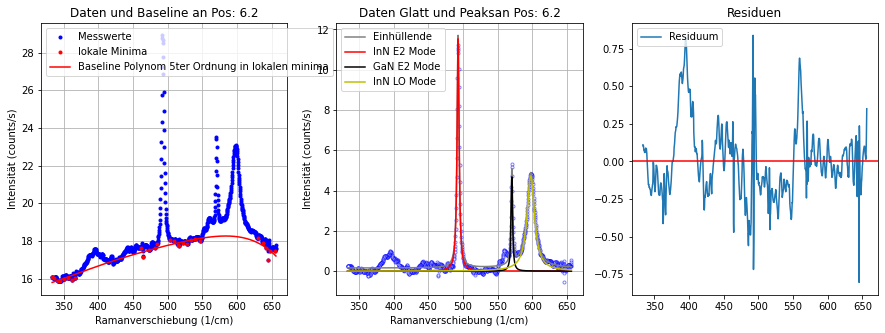

----------------------------------------------------------------------------------------------------
Position: 6.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [18.872  18.9097 18.9468 ... 17.0701 17.1598 17.3863]
Hintergrund Parameter:  [-4.92859818e-12  1.12653624e-08 -1.02403629e-05  4.59698378e-03
 -9.99998412e-01  1.00005553e+02]
Fitparameter 480: [0.06833930060073434, 544.6618543599535, 470.00000000000006]
Fitparameter InN E2: [12.867209532309603, 3.5164193473941783, 492.6825641176022]
Fitparameter InN LO: [5.176212512273094, 12.744016774853986, 597.8989051947796]
Fitparameter GaN E2:  [4.726903536704495, 2.8129780952064714, 570.2563613592732]


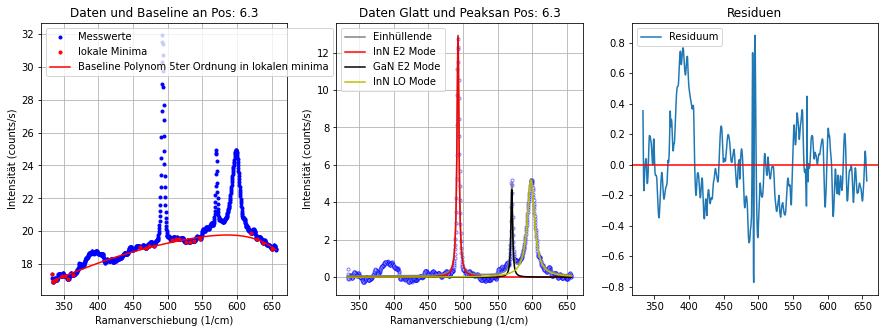

----------------------------------------------------------------------------------------------------
Position: 6.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [21.0197 20.9495 20.9158 ... 18.6321 18.6285 18.604 ]
Hintergrund Parameter:  [-7.52318493e-12  1.72578009e-08 -1.57244763e-05  7.07815474e-03
 -1.55259111e+00  1.50000000e+02]
Fitparameter 480: [0.14479078174612986, 456.81583209415504, 470.00000000000006]
Fitparameter InN E2: [13.784044264893666, 3.42465519047996, 492.69802251729925]
Fitparameter InN LO: [5.438353885333111, 12.823147035753383, 597.874960668355]
Fitparameter GaN E2:  [4.985629917908627, 2.8160301836469115, 570.1886367344472]


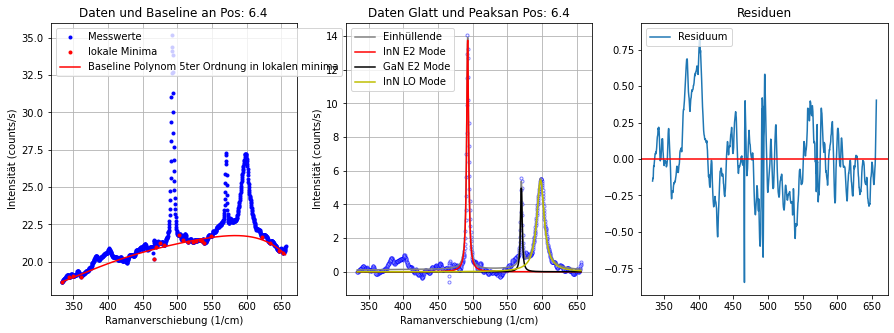

----------------------------------------------------------------------------------------------------
Position: 6.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [22.9507 22.9992 23.0278 ... 20.8316 20.8304 20.7774]
Hintergrund Parameter:  [-5.11102879e-12  1.16724720e-08 -1.05743226e-05  4.70181189e-03
 -9.99998731e-01  1.00001191e+02]
Fitparameter 480: [0.09999777315889194, 342.8676342252126, 470.00000000000006]
Fitparameter InN E2: [14.85962839289106, 3.605622291791938, 492.6412447357178]
Fitparameter InN LO: [6.158931890765162, 12.522316975998935, 597.869436902079]
Fitparameter GaN E2:  [5.386126882263414, 3.2403875001057783, 570.2876430108141]


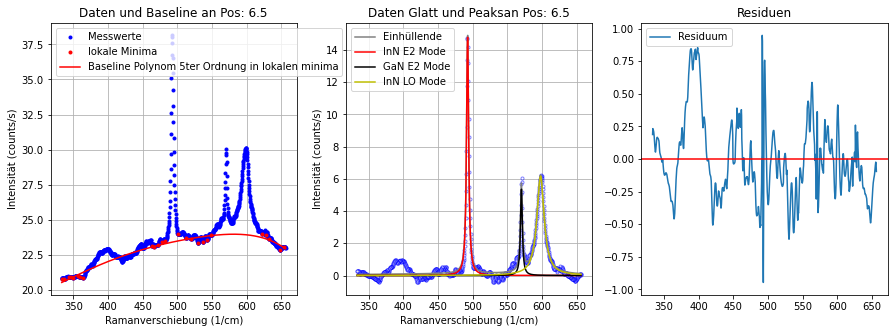

----------------------------------------------------------------------------------------------------
Position: 6.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [25.364  25.2153 25.1667 ... 22.7218 22.6653 22.5292]
Hintergrund Parameter:  [-5.90031482e-12  1.29412167e-08 -1.12695292e-05  4.83943558e-03
 -9.99999657e-01  1.00000195e+02]
Fitparameter 480: [0.26960890067551924, 293.80242482797524, 470.00000000000006]
Fitparameter InN E2: [15.806924755736375, 3.6859687781897588, 492.6502367154889]
Fitparameter InN LO: [6.375004428436237, 12.101025995731561, 597.7659108043556]
Fitparameter GaN E2:  [5.523791833093357, 3.037730414900116, 570.1373135619355]


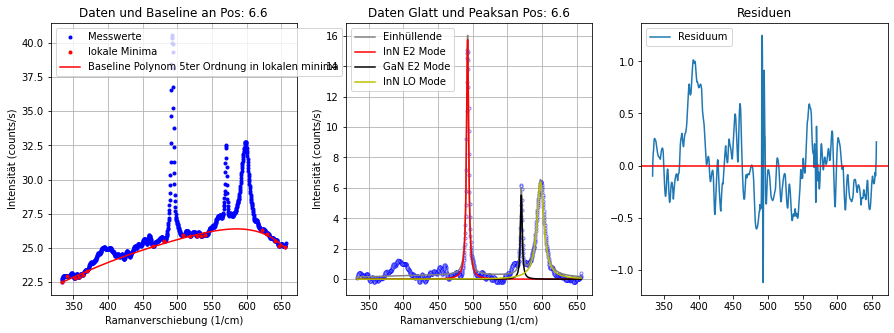

----------------------------------------------------------------------------------------------------
Position: 6.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [27.8174 27.7524 27.6725 ... 25.5969 25.7234 25.9253]
Hintergrund Parameter:  [-6.51444316e-12  1.40062312e-08 -1.19174056e-05  4.98508713e-03
 -9.99997491e-01  1.00001185e+02]
Fitparameter 480: [0.21925403969418847, 229.0241909943604, 470.0000004657023]
Fitparameter InN E2: [16.901853941460374, 3.6843388599020033, 492.5790904936363]
Fitparameter InN LO: [6.9065547262029545, 12.085832965628008, 597.430658291977]
Fitparameter GaN E2:  [6.156341401890571, 2.5923648510275266, 570.4271785947045]


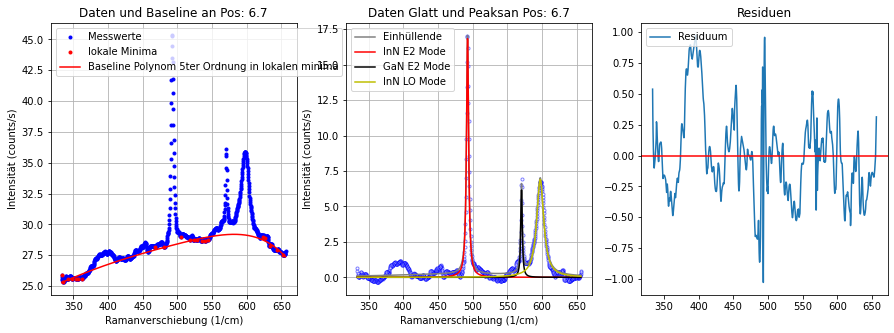

----------------------------------------------------------------------------------------------------
Position: 6.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [28.6365 28.5999 28.5531 ... 26.4387 26.3347 26.2317]
Hintergrund Parameter:  [-6.24894251e-12  1.35912580e-08 -1.17234536e-05  4.96321821e-03
 -9.99998914e-01  1.00000497e+02]
Fitparameter 480: [0.15649900604352993, 478.7827745407586, 470.00000000000006]
Fitparameter InN E2: [17.76362145459899, 3.7516089746583994, 492.6433926080432]
Fitparameter InN LO: [7.169005219480184, 12.841145608950987, 597.5371686042542]
Fitparameter GaN E2:  [6.492556356383076, 2.707135536563506, 570.3171655292934]


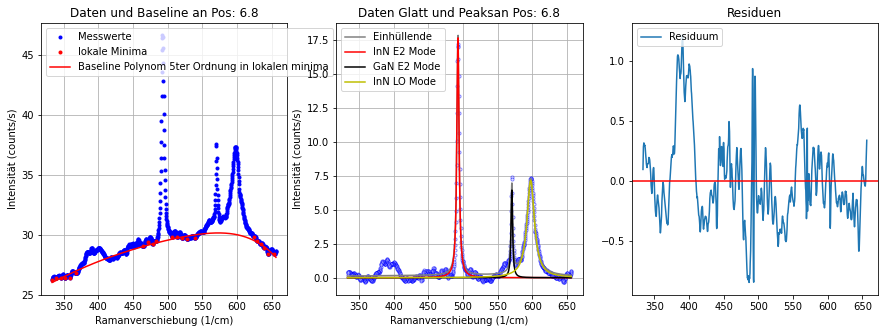

----------------------------------------------------------------------------------------------------
Position: 6.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [31.5425 31.5148 31.533  ... 29.1374 29.0509 29.006 ]
Hintergrund Parameter:  [-6.39129764e-12  1.38716808e-08 -1.19435128e-05  5.03401001e-03
 -9.99997339e-01  1.00001078e+02]
Fitparameter 480: [0.007666530469353013, 58487.6586513246, 470.00000000000006]
Fitparameter InN E2: [19.460085385759747, 3.677064577998558, 492.55723837497175]
Fitparameter InN LO: [7.721130703597937, 13.146927177042345, 597.2958920910379]
Fitparameter GaN E2:  [6.1588897711394495, 3.07887813108306, 570.2877420524861]


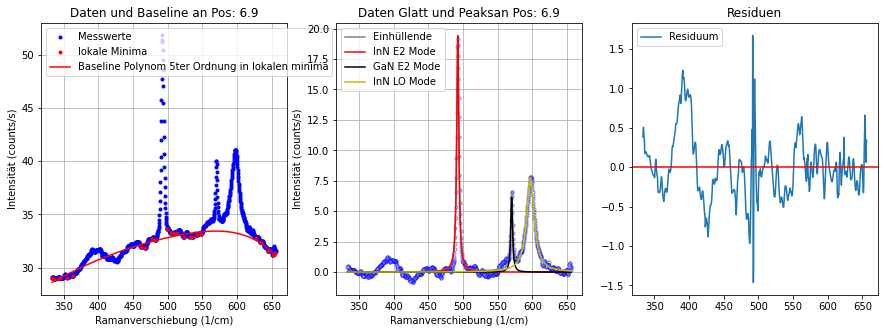

----------------------------------------------------------------------------------------------------
Position: 7.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [34.8787 34.7175 34.6004 ... 31.9048 31.9175 31.8835]
Hintergrund Parameter:  [-6.76230491e-12  1.45431414e-08 -1.23758475e-05  5.14122742e-03
 -9.99998185e-01  1.00000763e+02]
Fitparameter 480: [0.08464200912321727, 724.0057839008163, 470.00000000000006]
Fitparameter InN E2: [20.67130400530522, 3.7121122884005997, 492.55588126375653]
Fitparameter InN LO: [8.507958831016003, 12.111242984174895, 597.4229804075375]
Fitparameter GaN E2:  [6.712495369349285, 3.058239868648576, 570.2961983886605]


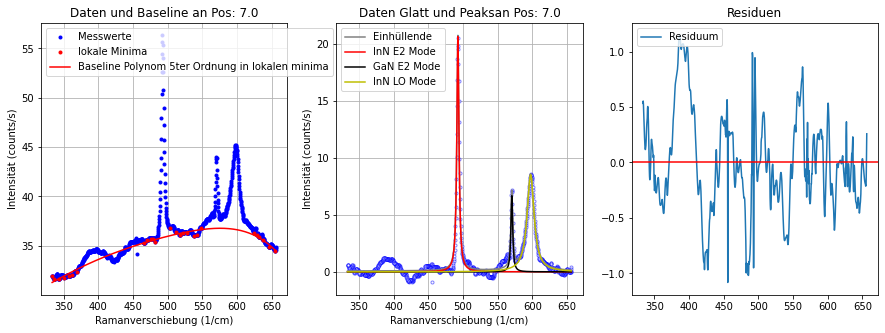

----------------------------------------------------------------------------------------------------
Position: 7.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [38.2342 38.1676 38.1251 ... 34.3915 34.3876 34.3752]
Hintergrund Parameter:  [-7.90129167e-12  1.63281831e-08 -1.33240865e-05  5.32278205e-03
 -9.99997578e-01  1.00000945e+02]
Fitparameter 480: [0.2162044906664558, 540.9489992760757, 470.00000000000006]
Fitparameter InN E2: [22.253613878400706, 3.7303679191260732, 492.5174421800265]
Fitparameter InN LO: [8.742292386763559, 11.872171285844384, 597.0974892112906]
Fitparameter GaN E2:  [6.948926500821825, 2.7781396409190293, 570.2559299597183]


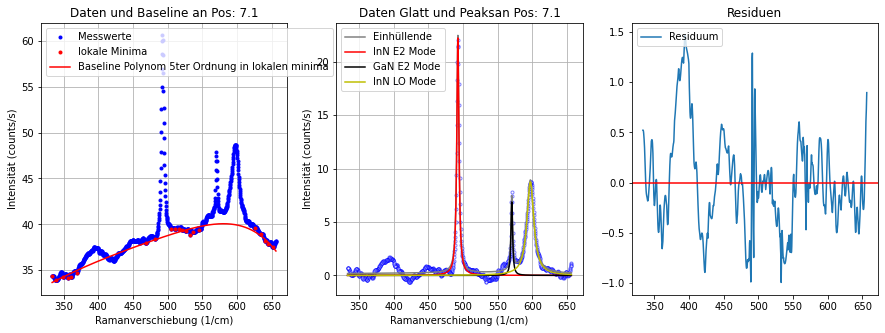

----------------------------------------------------------------------------------------------------
Position: 7.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [43.3688 43.3613 43.3651 ... 38.528  38.3899 38.277 ]
Hintergrund Parameter:  [-7.09421818e-12  1.52863587e-08 -1.29875894e-05  5.33627322e-03
 -9.99999140e-01  1.00000309e+02]
Fitparameter 480: [0.08727048534643941, 1894.1200726360903, 470.00000000000006]
Fitparameter InN E2: [23.252950607582864, 3.7996986607980956, 492.47686753717653]
Fitparameter InN LO: [9.289981084207607, 13.522508039965242, 597.0223499655541]
Fitparameter GaN E2:  [7.583557925097784, 3.014776540598363, 570.3847393507637]


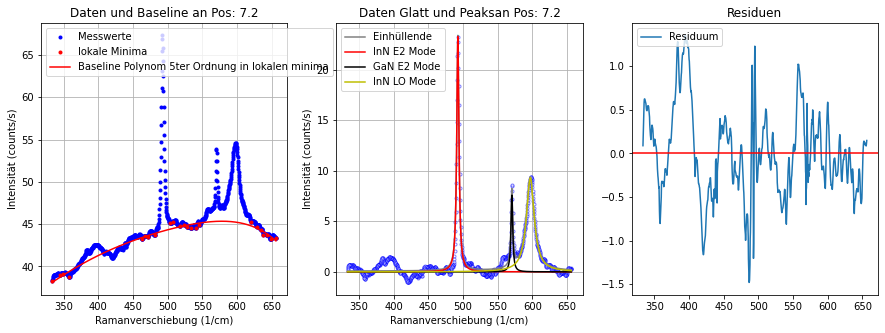

----------------------------------------------------------------------------------------------------
Position: 7.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [46.0387 45.9755 45.9084 ... 40.7631 40.7951 40.8552]
Hintergrund Parameter:  [-2.26167807e-12  6.54142553e-09 -7.66017084e-06  4.34082491e-03
 -1.13768383e+00  1.49750006e+02]
Fitparameter 480: [16.353968212383098, 0.024639022341323206, 491.9999999867554]
Fitparameter InN E2: [24.197666022100876, 3.8543547656890613, 492.43206120542266]
Fitparameter InN LO: [9.674532030114902, 16.248349313825063, 596.9807186955542]
Fitparameter GaN E2:  [7.175262847664919, 3.90477163095026, 570.196483950885]


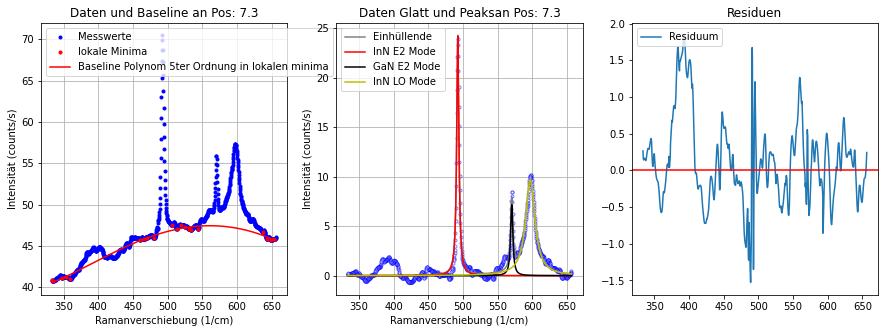

----------------------------------------------------------------------------------------------------
Position: 7.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [51.6615 51.7512 51.7769 ... 45.5383 45.5674 45.6314]
Hintergrund Parameter:  [-8.48689519e-12  1.76751151e-08 -1.44315566e-05  5.66800965e-03
 -9.99999052e-01  1.00000382e+02]
Fitparameter 480: [0.1016065367338283, 545.3417700559888, 470.00000000000006]
Fitparameter InN E2: [24.471504634818046, 3.9556891799476723, 492.39826927187727]
Fitparameter InN LO: [9.574272627332794, 13.195417174218854, 596.8680295209139]
Fitparameter GaN E2:  [7.366710052730143, 3.4380275065593766, 570.2604760316907]


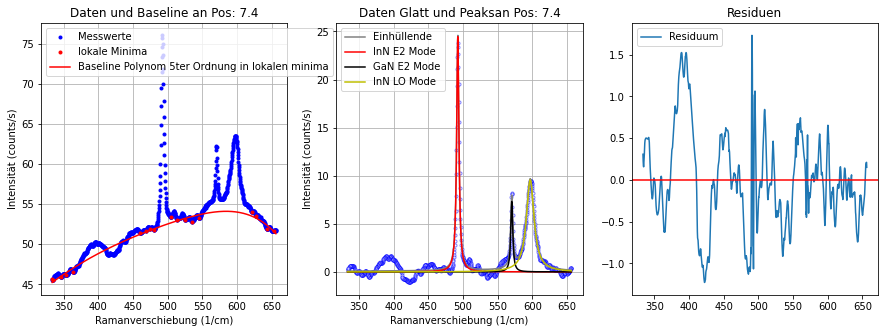

----------------------------------------------------------------------------------------------------
Position: 7.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [54.6609 54.3219 54.2837 ... 48.215  48.209  48.1871]
Hintergrund Parameter:  [-8.89873076e-12  1.83785230e-08 -1.48631476e-05  5.77117417e-03
 -9.99996698e-01  1.00001128e+02]
Fitparameter 480: [0.19856802467019824, 2108.2344699259843, 470.00000000000006]
Fitparameter InN E2: [25.72514436812833, 3.9006196661136987, 492.34525984720824]
Fitparameter InN LO: [9.710572510190406, 14.120596932713745, 596.900014977188]
Fitparameter GaN E2:  [7.590097967674038, 3.261155052943957, 570.3618558684838]


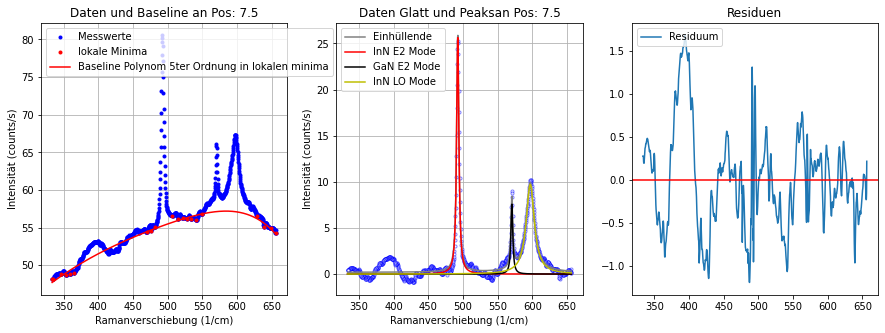

----------------------------------------------------------------------------------------------------
Position: 7.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [61.2749 61.2797 61.3206 ... 53.3891 53.4752 53.5754]
Hintergrund Parameter:  [-1.05234103e-11  2.10167490e-08 -1.63344315e-05  6.07294554e-03
 -9.99997322e-01  1.00000920e+02]
Fitparameter 480: [0.11594933827025182, 738.9511200157358, 470.00000000102074]
Fitparameter InN E2: [26.707078234199216, 3.905792635413491, 492.2638760561978]
Fitparameter InN LO: [9.422098234767322, 13.209705739800533, 596.412315863222]
Fitparameter GaN E2:  [8.286229087715416, 2.548779265971822, 570.3176605362445]


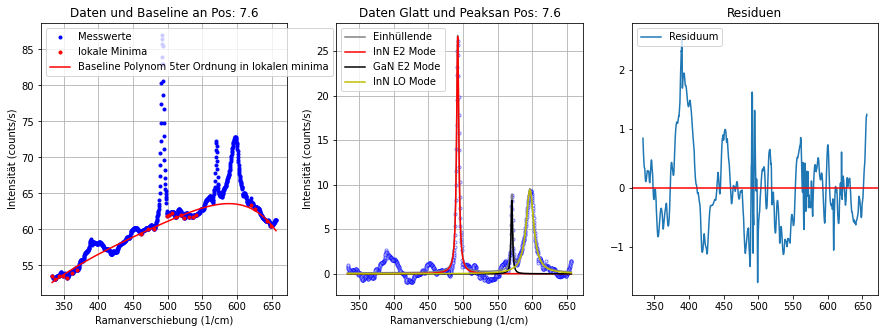

----------------------------------------------------------------------------------------------------
Position: 7.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [62.7392 62.7983 62.7815 ... 54.1627 54.1549 53.7374]
Hintergrund Parameter:  [-9.86184069e-12  1.99920906e-08 -1.58313244e-05  6.00150688e-03
 -9.99998383e-01  1.00000559e+02]
Fitparameter 480: [0.1472258302232188, 145115.02776585316, 470.00000000000006]
Fitparameter InN E2: [26.086769636169567, 3.976633168378926, 492.2071114859269]
Fitparameter InN LO: [9.460598107368236, 14.741562306609197, 596.3187625413696]
Fitparameter GaN E2:  [7.449217875374892, 3.259917033591214, 570.2913714226046]


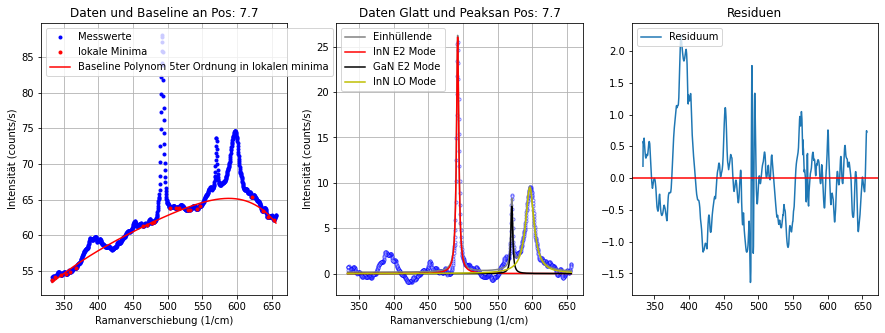

----------------------------------------------------------------------------------------------------
Position: 7.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [69.7627 69.7864 69.5791 ... 59.1087 59.076  58.9764]
Hintergrund Parameter:  [-1.04672239e-11  2.10918235e-08 -1.65515295e-05  6.18695570e-03
 -9.99999778e-01  1.00000116e+02]
Fitparameter 480: [3.7698204581327735e-10, 0.032623133475786006, 476.430159221935]
Fitparameter InN E2: [26.292367684554865, 4.050862436608249, 492.11473092003223]
Fitparameter InN LO: [9.531963407127495, 14.581080552408542, 596.218452194667]
Fitparameter GaN E2:  [7.678318110314581, 2.965161488770617, 570.3166329194501]


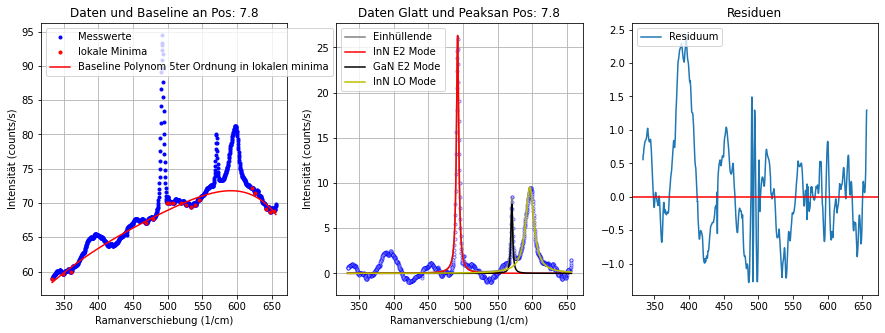

----------------------------------------------------------------------------------------------------
Position: 7.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [71.8095 72.0317 72.0926 ... 61.2141 61.1847 61.2714]
Hintergrund Parameter:  [-5.11026524e-12  1.12198686e-08 -1.03129652e-05  4.87093796e-03
 -1.09759217e+00  1.49750004e+02]
Fitparameter 480: [0.3491673058173853, 850.8964842508518, 470.00000000003183]
Fitparameter InN E2: [25.77589289766485, 3.9409549926958807, 492.0356034618682]
Fitparameter InN LO: [9.934211912114243, 15.463170684524517, 596.0566370528093]
Fitparameter GaN E2:  [7.7989262433108335, 3.008909888934058, 570.3833957723725]
BILD an Pos:  7.9


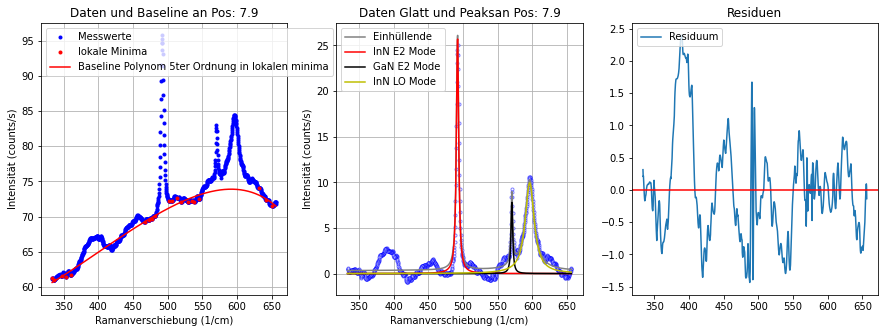

----------------------------------------------------------------------------------------------------
Position: 8.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [77.5247 77.6852 77.7876 ... 65.23   65.038  64.8854]
Hintergrund Parameter:  [-1.14043047e-11  2.27841390e-08 -1.76259378e-05  6.44768988e-03
 -9.99998509e-01  1.00000502e+02]
Fitparameter 480: [0.24082700191365422, 250126.73586825933, 470.00000000000006]
Fitparameter InN E2: [25.184122486600423, 4.294826303798323, 491.9881573298196]
Fitparameter InN LO: [8.932815597352707, 15.18660332466675, 595.9645685436707]
Fitparameter GaN E2:  [6.992857766800198, 3.6201924731308432, 570.2297714965955]


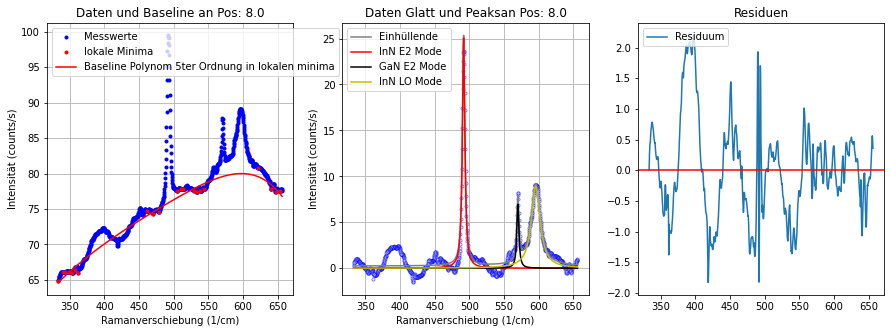

----------------------------------------------------------------------------------------------------
Position: 8.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [75.8452 76.3858 76.4195 ... 63.4645 63.4245 63.3781]
Hintergrund Parameter:  [-1.11261762e-11  2.23035303e-08 -1.73131217e-05  6.36813240e-03
 -9.99999606e-01  1.00000180e+02]
Fitparameter 480: [0.14635750332615166, 1260.187724821659, 470.00000000000006]
Fitparameter InN E2: [24.69998557182096, 4.127572641013066, 491.9322960744946]
Fitparameter InN LO: [8.615711461665803, 15.119390945488128, 595.7185083327478]
Fitparameter GaN E2:  [7.579375535322091, 3.32190326187019, 570.2380497379186]


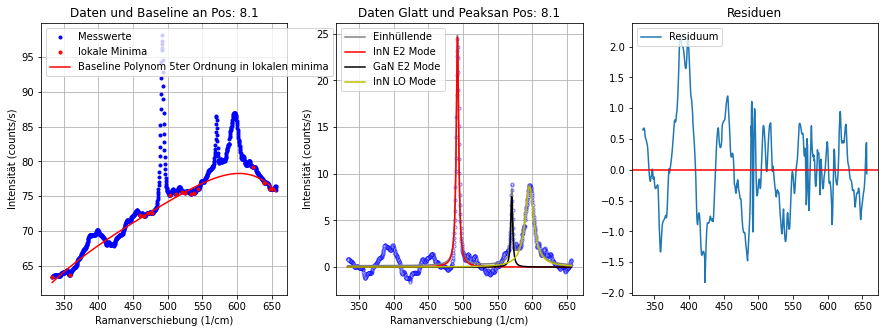

----------------------------------------------------------------------------------------------------
Position: 8.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [80.4539 80.2744 80.1138 ... 64.7749 64.7365 64.7718]
Hintergrund Parameter:  [-1.20515200e-11  2.37456807e-08 -1.80645791e-05  6.50869961e-03
 -9.99999143e-01  1.00000308e+02]
Fitparameter 480: [0.3086559102329223, 464.965780210322, 470.00000000000006]
Fitparameter InN E2: [23.069371087066177, 4.312889006563565, 491.8405895508389]
Fitparameter InN LO: [8.109149388312899, 14.140862758564147, 595.3523595271452]
Fitparameter GaN E2:  [6.9095162013223, 3.1833057507293634, 570.2402407795024]


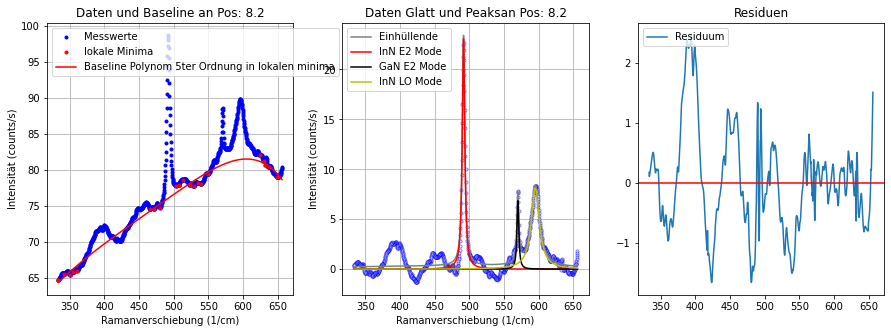

----------------------------------------------------------------------------------------------------
Position: 8.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [76.4118 76.4759 76.5464 ... 62.4453 62.3949 62.369 ]
Hintergrund Parameter:  [-1.15417839e-11  2.28754588e-08 -1.75439837e-05  6.39056053e-03
 -9.99998782e-01  1.00000436e+02]
Fitparameter 480: [0.18720995469291282, 243190.10517275965, 470.00000000000006]
Fitparameter InN E2: [21.93793924572336, 4.230537349519633, 491.8149648069856]
Fitparameter InN LO: [7.751998394209844, 14.990085341871133, 595.9703496232707]
Fitparameter GaN E2:  [6.990630092975995, 2.951194223199671, 570.3655197336575]


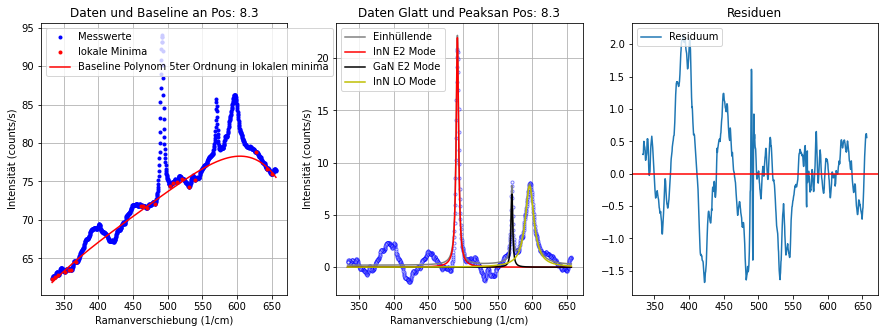

----------------------------------------------------------------------------------------------------
Position: 8.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [74.0778 74.0896 74.1125 ... 58.9524 58.913  58.8799]
Hintergrund Parameter:  [-1.51717921e-11  3.16785590e-08 -2.56635346e-05  9.92664828e-03
 -1.71743894e+00  1.49999542e+02]
Fitparameter 480: [9.028317324673976, 2.610850697695929, 490.5525536823046]
Fitparameter InN E2: [15.934583681766508, 4.13647053927908, 492.4510059697526]
Fitparameter InN LO: [7.5368430665297375, 15.603884884277571, 595.9718115097893]
Fitparameter GaN E2:  [6.248650327825113, 3.586936829628652, 570.3130236709661]


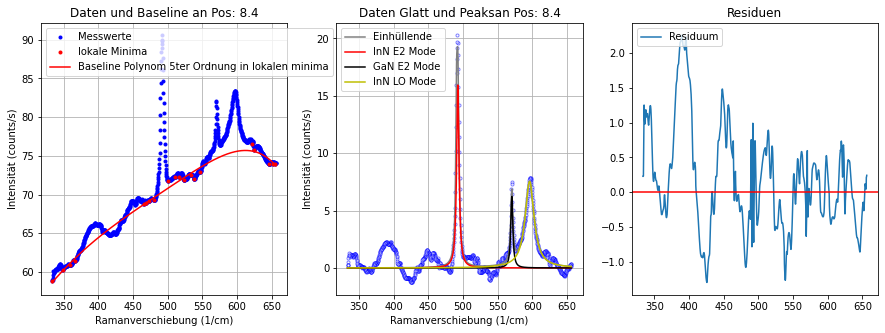

----------------------------------------------------------------------------------------------------
Position: 8.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [71.1231 71.06   70.9649 ... 57.5815 57.599  57.6373]
Hintergrund Parameter:  [-1.00442431e-11  2.05046614e-08 -1.62349619e-05  6.11792305e-03
 -9.99998185e-01  1.00000608e+02]
Fitparameter 480: [1.0773668033012872e-13, 12.079539777212425, 491.88957803772786]
Fitparameter InN E2: [19.577255295407625, 4.3833590599784324, 491.85197964548047]
Fitparameter InN LO: [7.135628825537215, 16.623050284625695, 595.6179210076556]
Fitparameter GaN E2:  [5.9326836439685735, 3.946992433647021, 570.2526735842592]


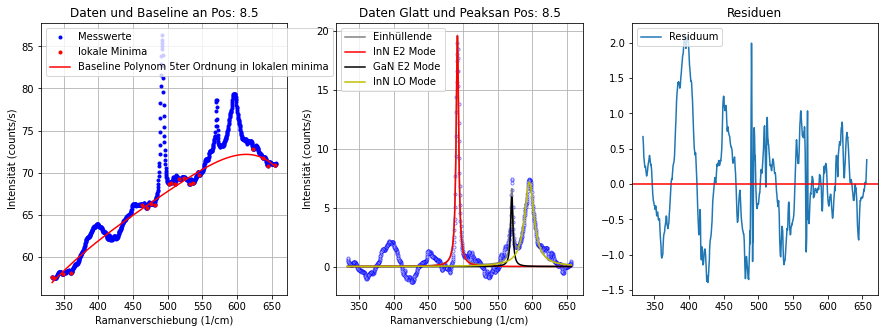

----------------------------------------------------------------------------------------------------
Position: 8.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [63.64   63.8308 63.7841 ... 50.2286 50.3785 50.4664]
Hintergrund Parameter:  [-9.90480825e-12  1.99487006e-08 -1.56527073e-05  5.91708443e-03
 -9.99999410e-01  1.00000255e+02]
Fitparameter 480: [10.331038139214343, 3.132936251370437, 490.9383244909497]
Fitparameter InN E2: [11.205150909855673, 3.892740841885417, 492.70570248966084]
Fitparameter InN LO: [6.511156721412705, 15.039213653543849, 595.8220025059859]
Fitparameter GaN E2:  [5.833553465921486, 3.237649125071901, 570.3119041865286]


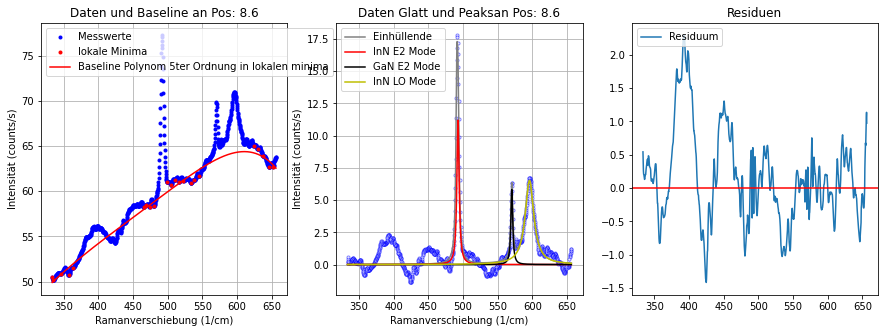

----------------------------------------------------------------------------------------------------
Position: 8.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [60.4885 60.4612 60.4397 ... 48.4452 48.4252 48.3919]
Hintergrund Parameter:  [-1.03969594e-11  2.05759400e-08 -1.58669755e-05  5.91697818e-03
 -9.99997875e-01  1.00000742e+02]
Fitparameter 480: [0.3441614723817786, 833486.4649162765, 470.0000000000002]
Fitparameter InN E2: [17.16713064865355, 3.99009145578634, 491.81220181865876]
Fitparameter InN LO: [5.819974684757677, 14.477214660216605, 596.2461534902492]
Fitparameter GaN E2:  [5.888742692382898, 2.165249618275342, 570.215003007751]


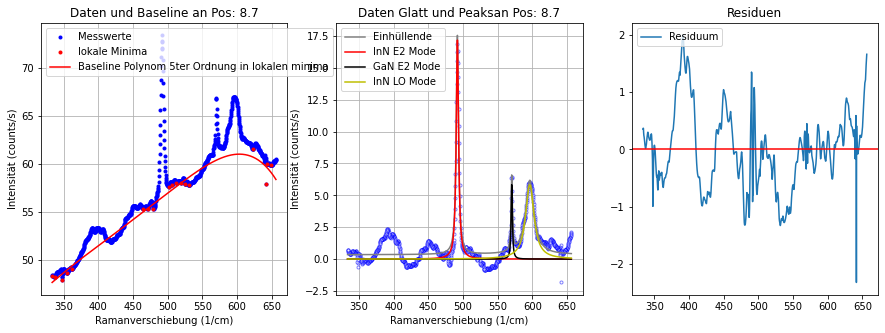

----------------------------------------------------------------------------------------------------
Position: 8.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [53.5369 53.2313 52.9607 ... 41.5296 41.4126 41.3564]
Hintergrund Parameter:  [-8.46307968e-12  1.74541334e-08 -1.41115980e-05  5.54883795e-03
 -1.00000143e+00  9.99995771e+01]
Fitparameter 480: [0.2516611076845906, 533.0258084155, 470.00000000000006]
Fitparameter InN E2: [15.880702877002832, 4.111342850737982, 491.91284688551167]
Fitparameter InN LO: [5.843353726089677, 13.962962072693756, 596.0384580460924]
Fitparameter GaN E2:  [5.016326242494932, 3.0617080429975196, 570.301944410356]


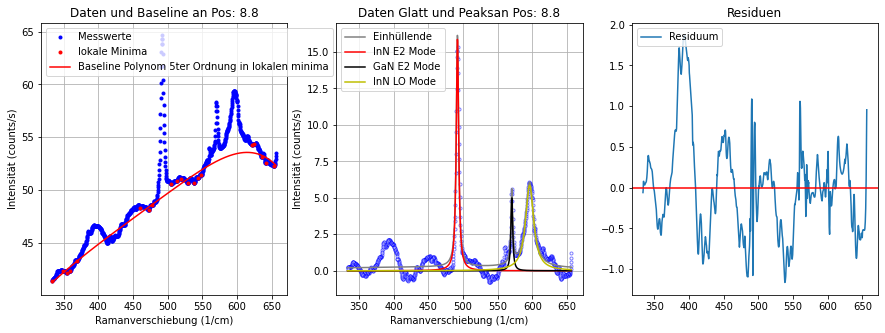

----------------------------------------------------------------------------------------------------
Position: 8.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [47.5889 47.3017 46.8063 ... 37.2503 37.4115 37.5948]
Hintergrund Parameter:  [-7.15229618e-12  1.53162797e-08 -1.29054907e-05  5.29368229e-03
 -9.99997855e-01  1.00000854e+02]
Fitparameter 480: [0.06763512508779838, 148707.1611937191, 470.00000000000006]
Fitparameter InN E2: [14.400403571054154, 4.309315788169224, 492.0107526608545]
Fitparameter InN LO: [5.535863597295253, 18.44426037035713, 596.0201978136121]
Fitparameter GaN E2:  [5.048717745582421, 2.9892837311966107, 570.2639392298488]


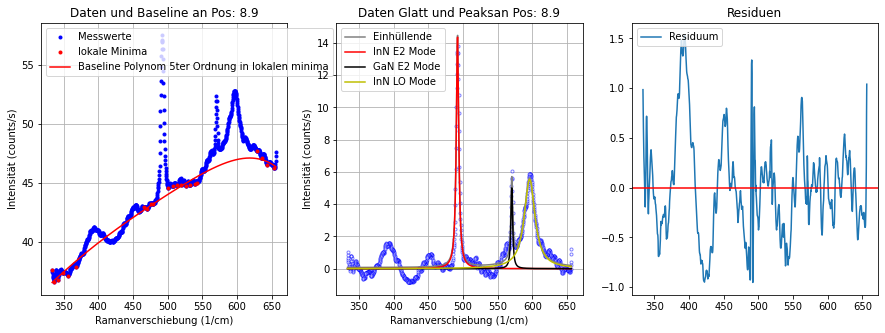

----------------------------------------------------------------------------------------------------
Position: 9.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [41.5308 41.4855 41.4887 ... 33.1919 32.7597 32.5485]
Hintergrund Parameter:  [-6.91948695e-12  1.48061112e-08 -1.24995405e-05  5.16913778e-03
 -9.99999467e-01  1.00000267e+02]
Fitparameter 480: [1.3890011227736098e-08, 1.7853097818946052e-08, 491.99814506045254]
Fitparameter InN E2: [13.667110999031827, 3.9743696342139505, 492.03349893136607]
Fitparameter InN LO: [5.329088463747825, 15.32927093465873, 596.427526179086]
Fitparameter GaN E2:  [4.777754343995518, 3.71180897929967, 570.3720103848087]


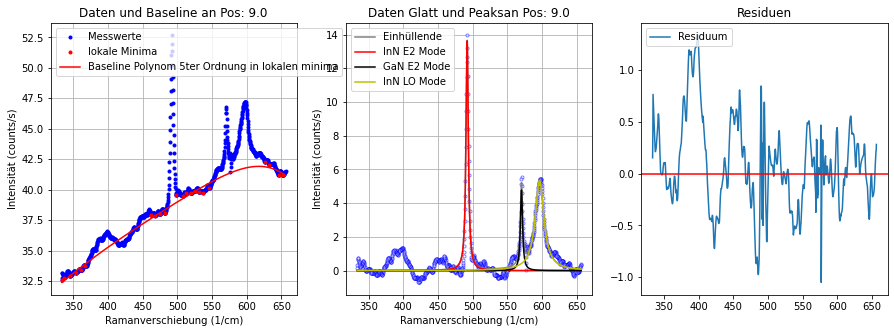

----------------------------------------------------------------------------------------------------
Position: 9.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [33.4253 33.5996 33.7106 ... 26.954  26.991  27.0568]
Hintergrund Parameter:  [-6.08156432e-12  1.33785821e-08 -1.16239048e-05  4.95458578e-03
 -9.99996557e-01  1.00001625e+02]
Fitparameter 480: [0.02761510317782551, 0.019316150008844596, 476.63875942675384]
Fitparameter InN E2: [12.477502288815012, 3.868645031466639, 492.14431367395747]
Fitparameter InN LO: [5.106211314877756, 16.216759340109213, 596.828983170054]
Fitparameter GaN E2:  [4.587416367462246, 3.0852711254184797, 570.2578903158775]


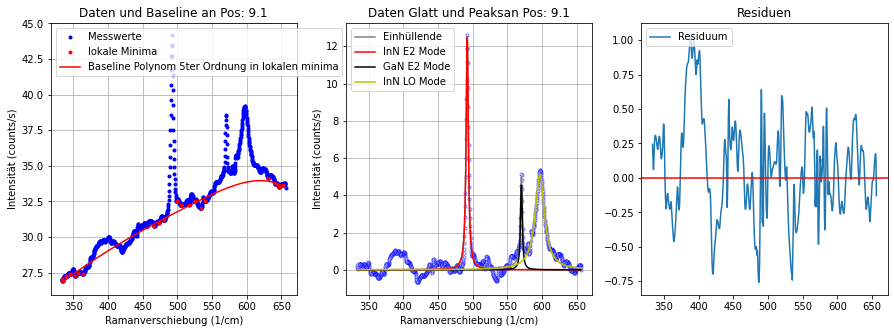

----------------------------------------------------------------------------------------------------
Position: 9.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [30.0784 30.0411 30.1245 ... 24.6714 24.6476 24.4259]
Hintergrund Parameter:  [-6.94059099e-12  1.45988154e-08 -1.21314624e-05  4.99657531e-03
 -9.99999403e-01  1.00000280e+02]
Fitparameter 480: [0.2754901088362482, 266.6146945682174, 470.00000000000006]
Fitparameter InN E2: [11.071777721866008, 3.9015380239099255, 492.2736789557018]
Fitparameter InN LO: [4.323566532003609, 12.477959915672395, 597.0533720707759]
Fitparameter GaN E2:  [3.9745091653984246, 2.701459346614744, 570.2212470886382]


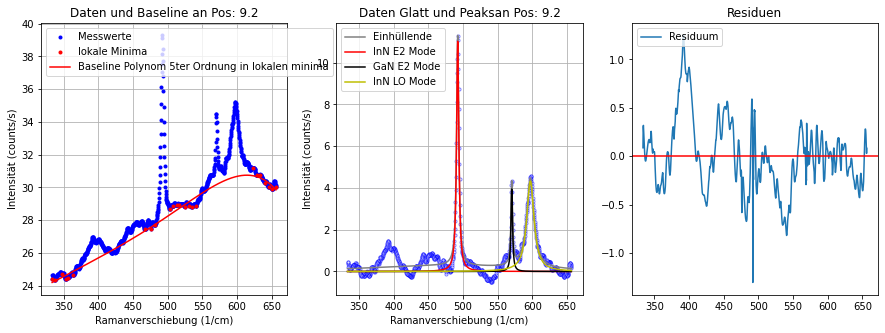

----------------------------------------------------------------------------------------------------
Position: 9.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [26.3501 26.2957 26.308  ... 21.7235 21.7232 21.6846]
Hintergrund Parameter:  [-5.48240467e-12  1.23104955e-08 -1.09246392e-05  4.76962619e-03
 -9.99997969e-01  1.00001540e+02]
Fitparameter 480: [0.23147016475225063, 1.2386563430032471, 475.86446926599507]
Fitparameter InN E2: [10.426953684867156, 3.797934396833764, 492.327805323733]
Fitparameter InN LO: [4.535039191570457, 15.865116703904983, 596.8834304620387]
Fitparameter GaN E2:  [4.4222056420036875, 2.894863299308341, 570.212128341007]


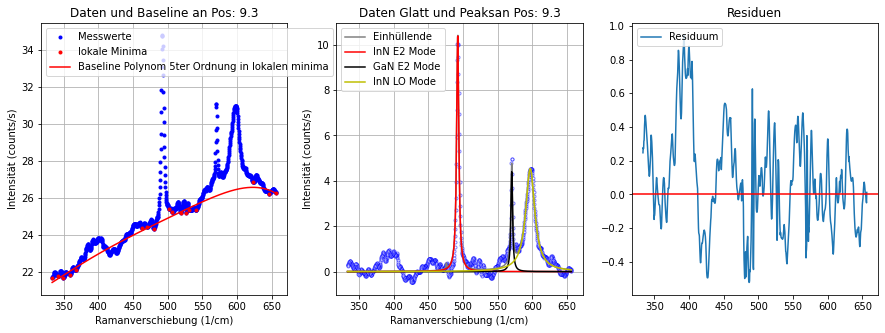

----------------------------------------------------------------------------------------------------
Position: 9.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.0981 23.2256 23.3403 ... 20.2708 20.3291 20.5384]
Hintergrund Parameter:  [-6.31527571e-12  1.35610816e-08 -1.15152962e-05  4.84644922e-03
 -9.99995873e-01  1.00002199e+02]
Fitparameter 480: [0.18989939834431313, 500.3813326588187, 470.00000000000006]
Fitparameter InN E2: [9.072274987516552, 3.7968942959779386, 492.339190200902]
Fitparameter InN LO: [4.012889441023727, 12.828504507160414, 596.9703498261906]
Fitparameter GaN E2:  [3.4621300641028467, 3.01197143159786, 570.1954266467686]


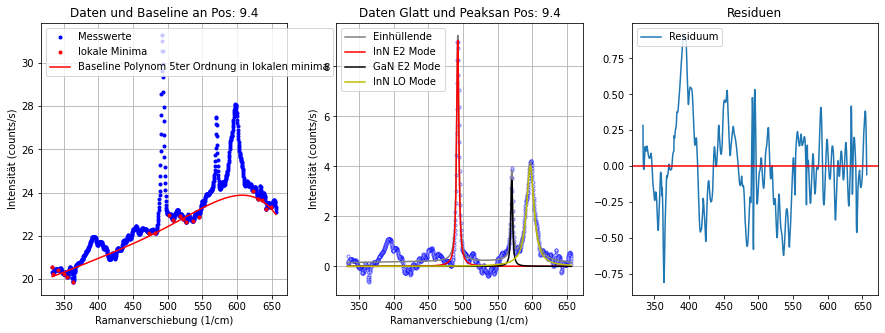

----------------------------------------------------------------------------------------------------
Position: 9.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [22.5665 22.5471 22.5341 ... 20.3668 20.3921 20.3492]
Hintergrund Parameter:  [-5.74616180e-12  1.27678731e-08 -1.11610282e-05  4.79310777e-03
 -9.99997824e-01  1.00001197e+02]
Fitparameter 480: [0.13810225896944106, 337.934867830993, 470.00000000000006]
Fitparameter InN E2: [8.34914371279287, 3.825874826782432, 492.45872649354766]
Fitparameter InN LO: [4.092640462183016, 13.169520191576773, 597.5204857766504]
Fitparameter GaN E2:  [3.5139244539302186, 3.158830800535524, 570.1432309360495]


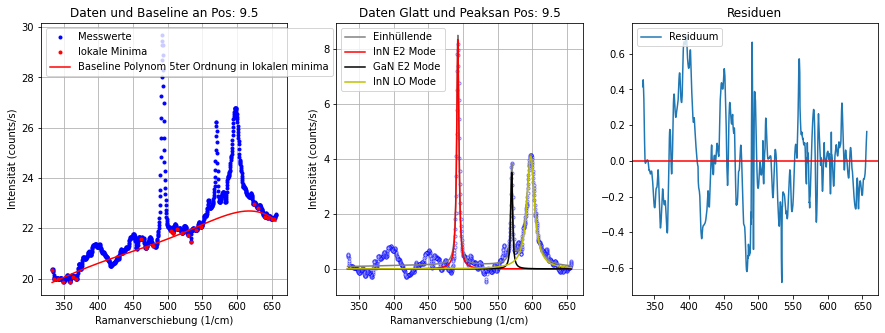

----------------------------------------------------------------------------------------------------
Position: 9.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [22.9778 23.0019 23.0039 ... 21.9957 22.0548 22.1238]
Hintergrund Parameter:  [-5.98140157e-12  1.33063633e-08 -1.15595179e-05  4.89119851e-03
 -9.99993818e-01  1.00009487e+02]
Fitparameter 480: [0.17511647366850425, 335.70912344887347, 470.00000015842517]
Fitparameter InN E2: [7.522512076764856, 3.6341147131749327, 492.46832651639096]
Fitparameter InN LO: [3.6102195119202873, 13.67977097470543, 597.4037379176002]
Fitparameter GaN E2:  [3.595650071447186, 2.4946545128933737, 570.3468464043888]


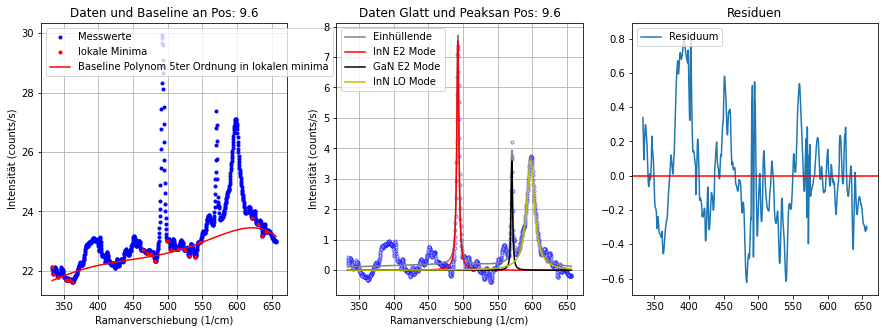

----------------------------------------------------------------------------------------------------
Position: 9.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [24.4393 23.9571 23.8885 ... 22.3434 22.3589 22.3944]
Hintergrund Parameter:  [-8.64393792e-12  1.94260026e-08 -1.70866763e-05  7.36203895e-03
 -1.55206434e+00  1.49999999e+02]
Fitparameter 480: [0.3513274548997563, 294.8284920317014, 470.00000000000006]
Fitparameter InN E2: [7.080945620805207, 3.3077111400297072, 492.5549692754094]
Fitparameter InN LO: [3.387106888997878, 12.826992223220211, 597.5115785128359]
Fitparameter GaN E2:  [3.3718478016924704, 3.208235332874783, 570.0934066286801]


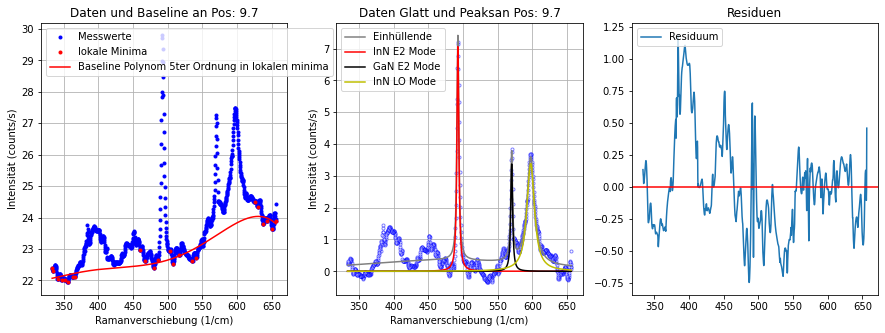

----------------------------------------------------------------------------------------------------
Position: 9.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [25.6595 25.6267 25.5975 ... 25.2257 25.1918 25.1477]
Hintergrund Parameter:  [-1.00293748e-11  2.22218055e-08 -1.91019176e-05  7.95523360e-03
 -1.60411531e+00  1.49999978e+02]
Fitparameter 480: [0.41358532348216953, 237.48948930947842, 470.00000000000006]
Fitparameter InN E2: [6.633812807949535, 3.1288871429129137, 492.5592970151484]
Fitparameter InN LO: [3.021513613458215, 12.79937367769717, 597.3992854811028]
Fitparameter GaN E2:  [2.8392783157815837, 3.5755112535110243, 570.2688096846579]


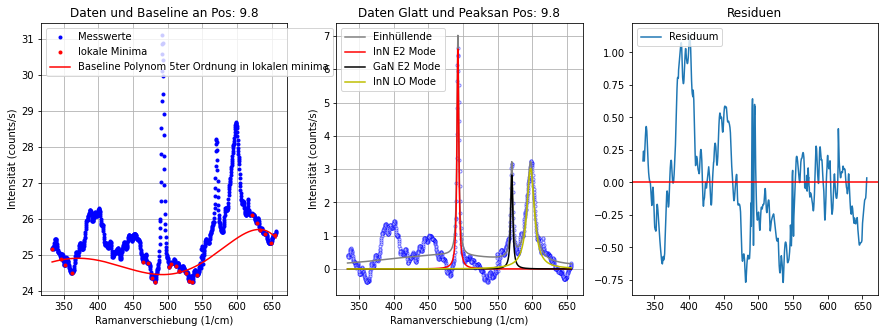

----------------------------------------------------------------------------------------------------
Position: 9.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [26.2668 26.2874 26.3112 ... 27.2539 27.3271 27.3244]
Hintergrund Parameter:  [-7.59958698e-12  1.62913836e-08 -1.34025555e-05  5.27981161e-03
 -9.99999068e-01  1.00000597e+02]
Fitparameter 480: [0.3912451966453705, 274.05293214006116, 470.00000000000006]
Fitparameter InN E2: [6.165651153458782, 3.1173262958174663, 492.66481419613274]
Fitparameter InN LO: [2.8839922498152157, 13.015766163668891, 598.0394085803592]
Fitparameter GaN E2:  [2.967908087649397, 2.902601655527357, 570.1591273414521]


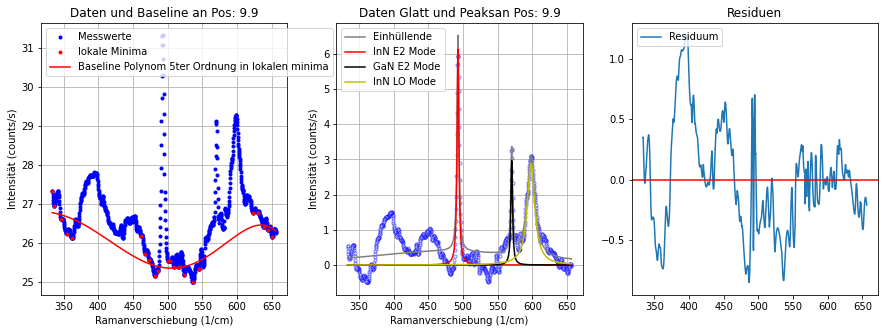

----------------------------------------------------------------------------------------------------
Position: 10.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [25.5039 25.6369 25.7519 ... 26.6989 26.5127 26.3518]
Hintergrund Parameter:  [-1.12231746e-11  2.44941149e-08 -2.06397698e-05  8.37880512e-03
 -1.64031883e+00  1.50000000e+02]
Fitparameter 480: [0.5001433904579942, 255.95778332861778, 470.00000000000006]
Fitparameter InN E2: [5.853371575457246, 2.85496431381095, 492.5763075821016]
Fitparameter InN LO: [2.54113891564862, 12.335226399894083, 598.0897367514671]
Fitparameter GaN E2:  [2.233614978691851, 3.278465842279048, 570.3597888575638]


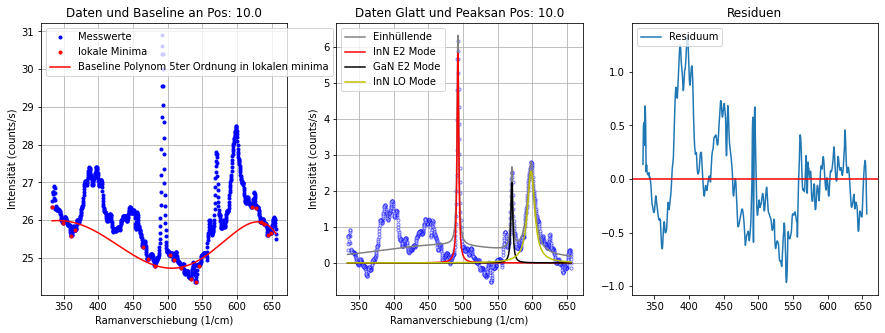

----------------------------------------------------------------------------------------------------
Position: 10.1
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [23.9023 23.8716 23.7735 ... 23.6787 23.7788 23.8801]
Hintergrund Parameter:  [-6.83687804e-12  1.49335683e-08 -1.25601569e-05  5.08911772e-03
 -9.99997429e-01  1.00001388e+02]
Fitparameter 480: [0.40161049070933413, 243.28335616000538, 470.00000000000006]
Fitparameter InN E2: [5.304590126856742, 2.9040021260664557, 492.71091086368773]
Fitparameter InN LO: [2.458760486082127, 14.275310381161384, 598.7931333030267]
Fitparameter GaN E2:  [2.484384268430754, 2.8753763920783033, 570.3089045281512]


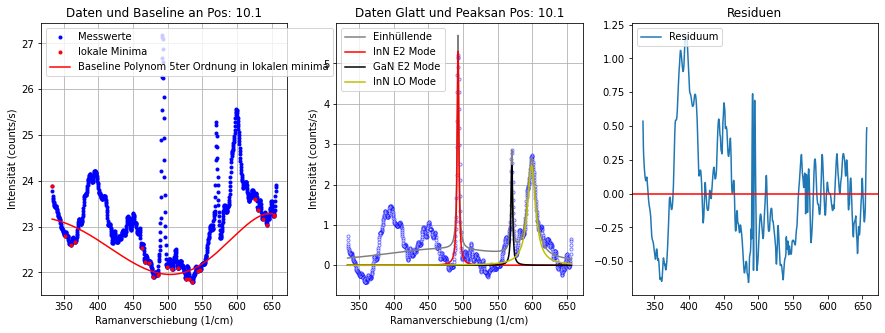

----------------------------------------------------------------------------------------------------
Position: 10.2
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [19.3941 19.4859 19.5223 ... 19.8254 19.8642 19.9951]
Hintergrund Parameter:  [-6.30552559e-12  1.39057351e-08 -1.18712459e-05  4.92108913e-03
 -9.99997707e-01  1.00001448e+02]
Fitparameter 480: [0.266287048749913, 0.2686650064477871, 478.6955075802674]
Fitparameter InN E2: [4.810393728758883, 3.979488872259992, 492.89430690146054]
Fitparameter InN LO: [2.4951902488797577, 17.35959908909921, 598.4572963981233]
Fitparameter GaN E2:  [2.531756330961198, 4.70616205495199, 570.3071410682038]


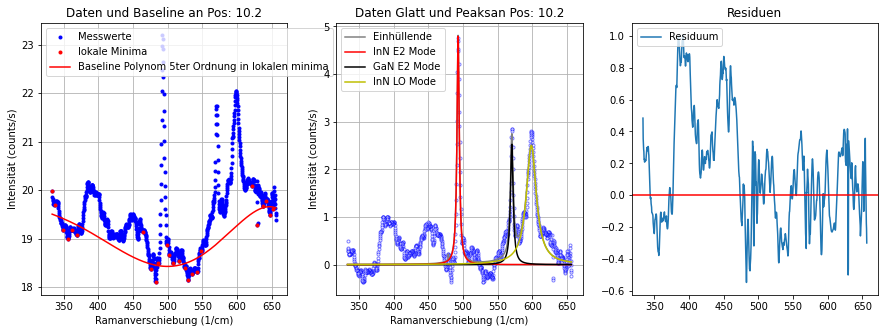

----------------------------------------------------------------------------------------------------
Position: 10.3
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [14.6113 14.5913 14.5661 ... 13.2361 13.2139 13.1766]
Hintergrund Parameter:  [-7.36734657e-12  1.70581466e-08 -1.55602947e-05  7.00810805e-03
 -1.55935904e+00  1.49999997e+02]
Fitparameter 480: [0.09592431833099412, 435.0421553169263, 470.00000000000006]
Fitparameter InN E2: [4.519678909793612, 3.7064327545696325, 492.7830707546459]
Fitparameter InN LO: [2.179878514073507, 13.25492121797127, 597.8033442157787]
Fitparameter GaN E2:  [2.0108128262980136, 3.3812465362226183, 570.2566326080884]


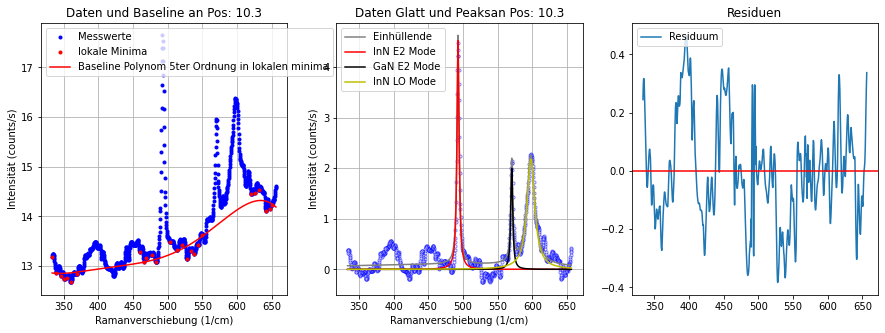

----------------------------------------------------------------------------------------------------
Position: 10.4
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [6.41416 6.46816 6.50193 ... 5.20155 5.18832 5.18187]
Hintergrund Parameter:  [-3.53916978e-12  8.70132262e-09 -8.51668116e-06  4.14852229e-03
 -9.99999203e-01  1.00000966e+02]
Fitparameter 480: [0.1355055567669975, 368.75536806935395, 470.00000000000006]
Fitparameter InN E2: [4.292451156695964, 3.41923358811347, 492.6634020030741]
Fitparameter InN LO: [2.2521274975680687, 13.142363646959852, 597.8836114836137]
Fitparameter GaN E2:  [2.151921635455016, 3.1937302227663893, 570.2700588637075]


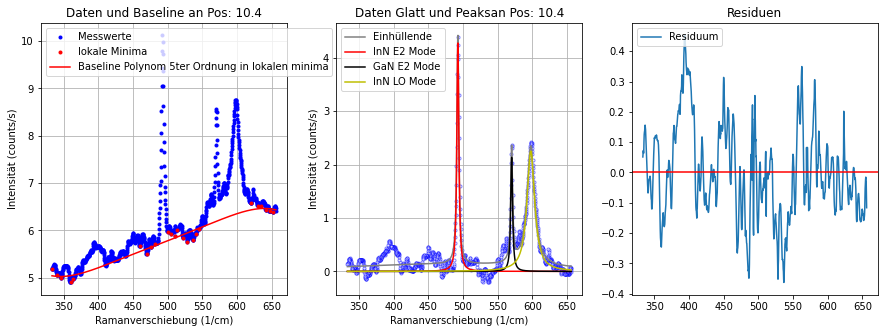

----------------------------------------------------------------------------------------------------
Position: 10.5
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.90663 5.91934 5.92879 ... 4.65058 4.62756 4.60729]
Hintergrund Parameter:  [-5.68312130e-12  1.39577256e-08 -1.36084394e-05  6.56859235e-03
 -1.56031350e+00  1.50000000e+02]
Fitparameter 480: [0.17842479319392204, 1.5075071621854415, 475.7911321148511]
Fitparameter InN E2: [4.159142053048131, 3.9972880569486735, 492.87616916465976]
Fitparameter InN LO: [2.0296107583943948, 12.47381979030582, 598.0159152645509]
Fitparameter GaN E2:  [1.8822529265927257, 3.3642548983853002, 570.3465713543579]


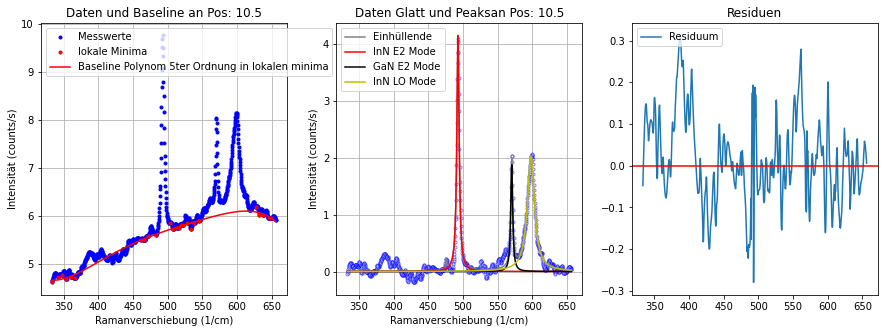

----------------------------------------------------------------------------------------------------
Position: 10.6
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.41798 5.41792 5.40424 ... 4.19062 4.18658 4.13907]
Hintergrund Parameter:  [-3.45961724e-12  8.48305758e-09 -8.34642181e-06  4.10524597e-03
 -1.00000124e+00  9.99987258e+01]
Fitparameter 480: [0.0628498472792086, 462.92754385057805, 470.00000000000006]
Fitparameter InN E2: [3.848990226971632, 3.672937018690539, 492.7978042435737]
Fitparameter InN LO: [1.9349501180247983, 11.042792471461118, 598.2460612599701]
Fitparameter GaN E2:  [2.060131759030941, 2.2989026600817466, 570.4205715011456]


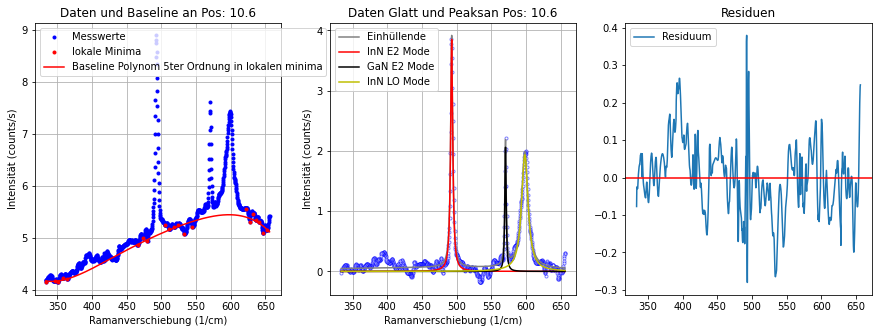

----------------------------------------------------------------------------------------------------
Position: 10.7
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [5.14699 5.16132 5.18017 ... 4.23507 4.24494 4.36044]
Hintergrund Parameter:  [-5.28555324e-12  1.30975172e-08 -1.29230801e-05  6.33156061e-03
 -1.53165770e+00  1.50000000e+02]
Fitparameter 480: [0.1394658826746088, 2.1123016617307138, 476.1924876790523]
Fitparameter InN E2: [3.595437386354771, 3.9020565112253918, 492.82531938930435]
Fitparameter InN LO: [1.766225081915416, 13.069413982685553, 597.9844633924617]
Fitparameter GaN E2:  [1.782102475611288, 2.771908053835396, 570.2374513086754]


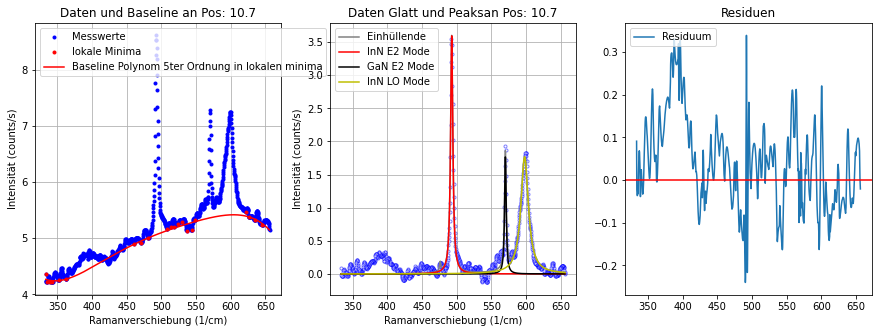

----------------------------------------------------------------------------------------------------
Position: 10.8
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.27175 4.28011 4.29177 ... 3.78403 3.79659 3.66794]
Hintergrund Parameter:  [-3.70746766e-12  9.09967417e-09 -8.89487487e-06  4.31254323e-03
 -1.02944490e+00  9.99999951e+01]
Fitparameter 480: [0.3248950798282798, 0.006446532782650937, 479.1888002089929]
Fitparameter InN E2: [3.3853756314563728, 4.017936417296243, 492.94169915152287]
Fitparameter InN LO: [1.7548318011636987, 12.17269093255097, 598.1217208130445]
Fitparameter GaN E2:  [1.6393011738527443, 2.931557028539466, 570.2621223595454]


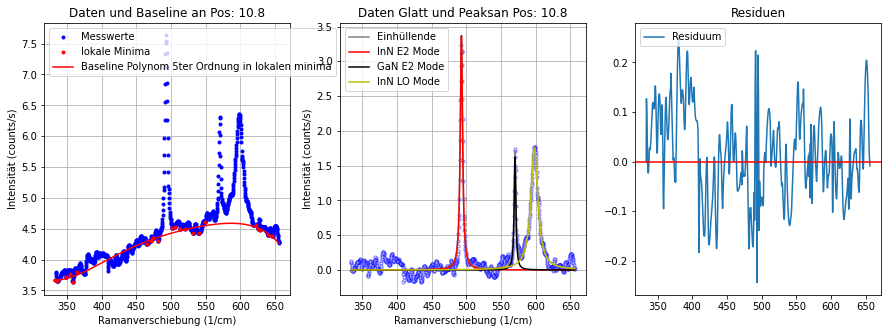

----------------------------------------------------------------------------------------------------
Position: 10.9
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [4.4562  4.40459 4.35089 ... 3.41957 3.36829 3.2997 ]
Hintergrund Parameter:  [-2.60057308e-12  6.95475248e-09 -7.36701680e-06  3.84062583e-03
 -9.77021913e-01  1.00000001e+02]
Fitparameter 480: [1.4970537945886337, 1.9107213864067054, 491.99999999999994]
Fitparameter InN E2: [2.546964246744019, 3.619573431125399, 493.42372600704095]
Fitparameter InN LO: [1.6650246346461366, 15.783040417303747, 598.0631826709871]
Fitparameter GaN E2:  [1.4862187889121727, 3.658233814516159, 570.3573141346247]


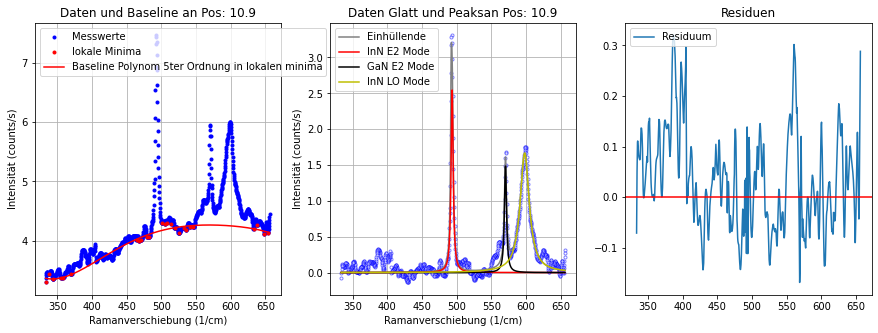

----------------------------------------------------------------------------------------------------
Position: 11.0
x-Daten: [656.14589514 655.84072514 655.53694514 ... 334.02925514 333.70220514
 333.37514514]
y-Daten: [3.80071 3.78247 3.7648  ... 3.08533 3.0421  3.10667]
Hintergrund Parameter:  [-3.02868665e-12  7.79439186e-09 -7.97087165e-06  4.03050952e-03
 -1.00001001e+00  9.99972582e+01]
Fitparameter 480: [0.0550243827838972, 208887.62267422565, 470.00000000000006]
Fitparameter InN E2: [3.1770026534936777, 3.464066752179751, 492.716858827836]
Fitparameter InN LO: [1.6195555449775174, 12.374184347879478, 598.304097882904]
Fitparameter GaN E2:  [1.638126566793592, 2.7165318673206964, 570.4695449918934]
BILD an Pos:  11.0


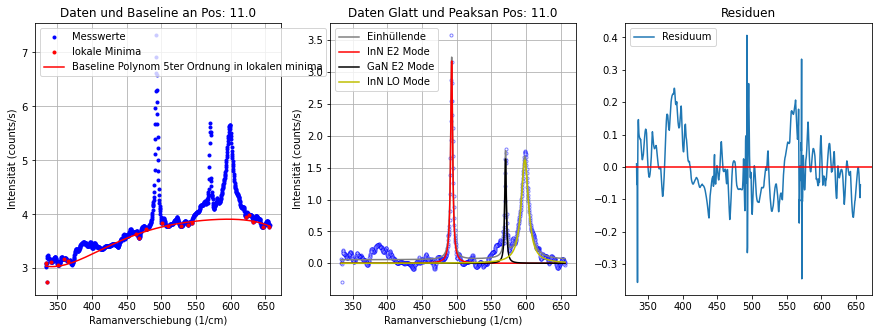

----------------------------------------------------------------------------------------------------


In [140]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
Gauß_Peaks_Liste=[]
InN_E2_Peaks_Liste=[]
InN_LO_Peaks_Liste=[]
Peaks_Liste_480=[]
GaN_E2_Peaks_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_MBE_632nm_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_MBE_632nm_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_MBE_632nm_array_float[0],[0])
        y=np.delete(data_MBE_632nm_array_float[i],[0])
        print("x-Daten:", x)
        #print(x.shape)
        print("y-Daten:", y)
        #print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=6)[0]]
        xzw=x[argrelextrema(y, np.less,order=6)[0]]
        #print(yzw)
        #print(xzw)
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin2=[]
        ymin2=[]
        for k in range(len(xzw)):
            if xzw[k]<=370 or xzw[k]>=460:
                xmin2.append(xzw[k])
                ymin2.append(yzw[k])
        #xmin.append(x[0])
        #ymin.append(y[0]) 
        for j in range(len(xmin2)):
            if xmin2[j]<=550 or xmin2[j]>=620:
                xmin.append(xmin2[j])
                ymin.append(ymin2[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1])
        #print(ymin)
        #print(xmin)
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [-6e-12, 1e-8, -1e-5, 5e-3, -1, 100]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf, 0],[np.inf,np.inf,np.inf,np.inf,0,150])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        #fitten 4 lorentz in 480, InN E2 498, GaN E2 570, InN LO 595
        #L_x4(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4)
        init_vals_L_x4 = [1,1,480, 5,1,498, 1,1,570, 1,1,595]
        param_bounds_L_x4= ([0,0,470, 0,0,485, 0,0,560, 0,0,585],[np.inf,np.inf,492, np.inf,10,505, np.inf,30,580, np.inf,30,605])
        fitParams_L_x4, cov_L_x4 = curve_fit(f=L_x4, xdata=x, ydata=y_glatt, p0=init_vals_L_x4, bounds=param_bounds_L_x4)
        fitParams_L_480=[fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2]]
        fitParams_L_InN_E2=[fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5]]
        fitParams_L_GaN_E2=[fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8]]
        fitParams_L_InN_LO=[fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]]
        print("Fitparameter 480:",fitParams_L_480)
        print("Fitparameter InN E2:",fitParams_L_InN_E2)
        print("Fitparameter InN LO:",fitParams_L_InN_LO)
        print("Fitparameter GaN E2: ", fitParams_L_GaN_E2)
        
        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline Polynom 5ter Ordnung in lokalen minima') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
            # Plot für Daten glatt und peaks
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        plt.plot(x,L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2], fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8],fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), color='gray'  ,markersize=2, label='Einhüllende')
        #plt.plot(x,Lorentz(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2]), color='g'  ,markersize=3, label='480 Mode')
        plt.plot(x,Lorentz(x, fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5]), color='r'  ,markersize=3, label='InN E2 Mode')
        plt.plot(x,Lorentz(x, fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8]), color='black'  ,markersize=3, label='GaN E2 Mode')
        plt.plot(x,Lorentz(x, fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), color='y'  ,markersize=3, label='InN LO Mode')
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend(loc='upper left')
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen')
        plt.plot(x,y_glatt-L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2], fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8],fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend(loc='upper left')
        
        if i == data_MBE_632nm_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/MBE Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/MBE Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == data_MBE_632nm_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/MBE Auswertung D0 632nm Position '+ str(position) + '.png')
    
        plt.show()
     
        #speichern der Peakdaten
        InN_E2_Peaks_Liste.append([position, fitParams_L_InN_E2])
        InN_LO_Peaks_Liste.append([position, fitParams_L_InN_LO])
        Peaks_Liste_480.append([position, fitParams_L_480])
        GaN_E2_Peaks_Liste.append([position, fitParams_L_GaN_E2])
        Baseline_Liste.append([position,fitParams_base])
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

In [141]:
# Verhalten Asymmetrischer Gauß und Baseline

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
#for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
#    Base_Para_3.append(Baseline_Liste[k][1][2])
#    Base_Para_4.append(Baseline_Liste[k][1][3])
#    Base_Para_5.append(Baseline_Liste[k][1][4])
#    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [18.02231518 -1.18423989  8.24139292  0.86676255  4.17866883]
Asym Gauß LO Parameter Amp-R: [6.19332438 1.3077027  6.91927255 1.05273722 1.87433459]
Asym Gauß GaN Parameter Amp-R: [ 5.01606417  1.41669636  8.33848339 -0.85066731  1.70904283]
Gauß E2 Parameter Amp-R: [26.57903224  2.61578008  7.64931718 -0.34022146]
Gauß LO Parameter Amp-R: [9.61944352 2.82462313 7.62917662 0.1408559 ]
Gauß GaN Parameter Amp-R: [ 7.75692075  3.44838494  7.6369043  -0.03559618]


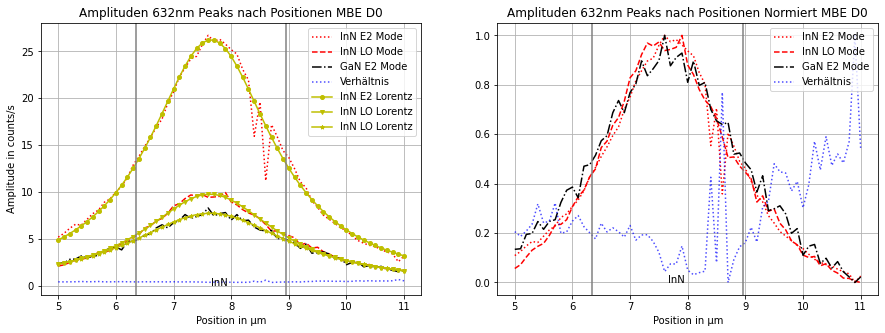

In [142]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_Amp=[]
Peak_InN_LO_Amp=[]
Peak_480_Amp=[]
Peak_GaN_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_Amp.append(InN_E2_Peaks_Liste[i][1][0])
    Peak_InN_LO_Amp.append(InN_LO_Peaks_Liste[i][1][0])
    Peak_480_Amp.append(Peaks_Liste_480[i][1][0])
    Peak_GaN_E2_Amp.append(GaN_E2_Peaks_Liste[i][1][0])
 
    
Verhältnis_InN_LO_E2_Amp=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_Amp.append( Peak_InN_LO_Amp[i]/ Peak_InN_E2_Amp[i] )
    
   

#Fitten Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,7.5,0,10]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,7.5,0,2]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 

init_vals_AG_GaN = [1,1,7.5,0,5]
param_bounds_AG_GaN= ([-np.inf,-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf,np.inf])
fitParams_AG_GaN, cov_AG_GaN = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= Peak_GaN_E2_Amp, p0=init_vals_AG_GaN, bounds=param_bounds_AG_GaN)
print("Asym Gauß GaN Parameter Amp-R:",fitParams_AG_GaN) 


#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,8,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,8,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_InN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 
    
init_vals_G_GaN = [1,1,8,5]
param_bounds_G_GaN= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_GaN, cov_G_GaN = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= Peak_GaN_E2_Amp, p0=init_vals_G_GaN, bounds=param_bounds_G_GaN)
print("Gauß GaN Parameter Amp-R:",fitParams_G_GaN) 



#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden 632nm Peaks nach Positionen MBE D0')
plt.plot(Positionen, Peak_InN_E2_Amp, ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_InN_LO_Amp, '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_GaN_E2_Amp, '-.', color='black'  ,markersize=2, label='GaN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp,':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='InN E2 Fitt')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='r'  ,markersize=2, label='InN LO Fitt')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_GaN[0],fitParams_AG_GaN[1],fitParams_AG_GaN[2],fitParams_AG_GaN[3],fitParams_AG_GaN[4]),'-s', color='black'  ,markersize=2, label='GaN Fitt')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_GaN[0],fitParams_G_GaN[1],fitParams_G_GaN[2],fitParams_G_GaN[3]),'-*', color='y'  ,markersize=4, label='InN LO Lorentz')

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')
        
plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden 632nm Peaks nach Positionen Normiert MBE D0')
plt.plot(Positionen, NormalizeData(Peak_InN_E2_Amp), ':', color='r'  ,markersize=2, label='InN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_Amp), '--', color='r'  ,markersize=2, label='InN LO Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_GaN_E2_Amp), '-.', color='black'  ,markersize=2, label='GaN E2 Mode') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=0,s='InN')

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_632nm/MBE Amplituden Peaks nach Positionen D0 632nm')
plt.show()

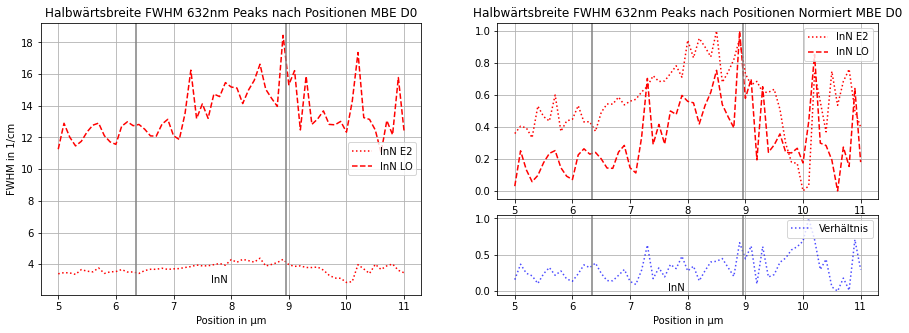

In [143]:
# Halbwärtsbreiten fwhm nach Positionen
 
#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_fwhm=[]
Peak_InN_LO_fwhm=[]
Peak_480_fwhm=[]
Peak_GaN_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_fwhm.append(InN_E2_Peaks_Liste[i][1][1])
    Peak_InN_LO_fwhm.append(InN_LO_Peaks_Liste[i][1][1])
    Peak_480_fwhm.append(Peaks_Liste_480[i][1][1])
    Peak_GaN_E2_fwhm.append(GaN_E2_Peaks_Liste[i][1][1])
 
    
Verhältnis_InN_LO_E2_fwhm=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_fwhm.append( Peak_InN_LO_fwhm[i]/ Peak_InN_E2_fwhm[i] )
    
    
#Plotten
fig = plt.figure(figsize=(15,5))

#plt.subplot(1, 2, 1) 
#plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen MBE D0')
#plt.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_480_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_GaN_E2_fwhm,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_fwhm, ':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
       
#plt.xlabel('Position')
#plt.ylabel('Halbwärtsbreite fwhm')
#plt.grid(True)
#plt.legend(loc='upper right')

#plt.subplot(1, 2, 2) 
#plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen Normiert MBE D0')
#plt.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_480_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen,  NormalizeData(Peak_GaN_E2_fwhm),'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5

#plt.xlabel('Position')
#plt.ylabel('Amplitude')
#plt.grid(True)
#plt.legend(loc='upper right')


gs0 = gridspec.GridSpec(1, 2, figure=fig)
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0])
ax1 = fig.add_subplot(gs00[:, :])
ax1.plot(Positionen, Peak_InN_E2_fwhm, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.plot(Positionen, Peak_InN_LO_fwhm, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#ax1.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='center right')
ax1.set_title("Halbwärtsbreite FWHM 632nm Peaks nach Positionen MBE D0")
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_fwhm),s='InN')


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(3, 3)

ax2 = fig.add_subplot(gs01[:2, :])
ax2.plot(Positionen, NormalizeData(Peak_InN_E2_fwhm), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, NormalizeData(Peak_InN_LO_fwhm), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
ax2.set_title("Halbwärtsbreite FWHM 632nm Peaks nach Positionen Normiert MBE D0")
plt.legend(loc='upper right')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')

ax3 = fig.add_subplot(gs01[-1:,:])
ax3.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_fwhm),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.grid(True)
plt.legend(loc='upper right')
plt.xlabel('Position in \u03bcm')
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=0,s='InN')


plt.savefig('Bilder_Graphen_632nm/MBE Halbwärtsbreite fwhm Peaks nach Positionen D0 632nm')
plt.show()

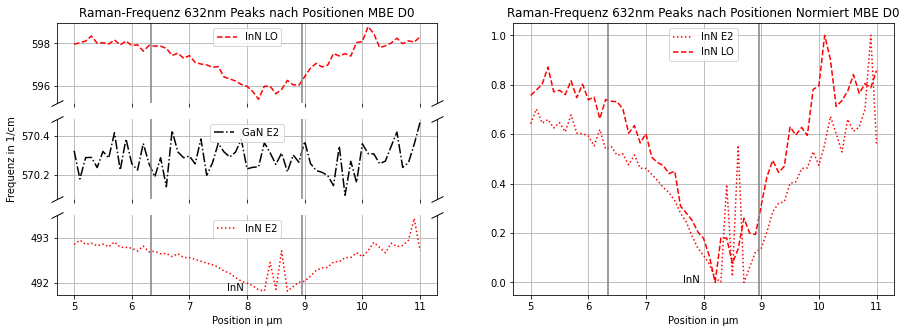

In [144]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
Peak_InN_E2_w=[]
Peak_InN_LO_w=[]
Peak_480_w=[]
Peak_GaN_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Positionen.append(InN_E2_Peaks_Liste[i][0])
    Peak_InN_E2_w.append(InN_E2_Peaks_Liste[i][1][2])
    Peak_InN_LO_w.append(InN_LO_Peaks_Liste[i][1][2])
    Peak_480_w.append(Peaks_Liste_480[i][1][2])
    Peak_GaN_E2_w.append(GaN_E2_Peaks_Liste[i][1][2])
    
Verhältnis_InN_LO_E2_w=[]
for i in range(len(InN_E2_Peaks_Liste)):
    Verhältnis_InN_LO_E2_w.append( Peak_InN_LO_w[i]/ Peak_InN_E2_w[i] )
    
    
    
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, Peak_InN_LO_w, '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, Peak_GaN_E2_w,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, Peak_InN_E2_w, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
ax1.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2],y=min(Peak_InN_E2_w),s='InN')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz in 1/cm')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 632nm Peaks nach Positionen MBE D0")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(Peak_InN_E2_w), ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(Peak_InN_LO_w), '--', color='r'  ,markersize=2, label='InN LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_GaN_E2_w),'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz 632nm Peaks nach Positionen Normiert MBE D0")
ax4.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2],y=0,s='InN')

plt.savefig('Bilder_Graphen_632nm/MBE Raman-Frequenz Peaks nach Positionen D0 632nm')
plt.show()

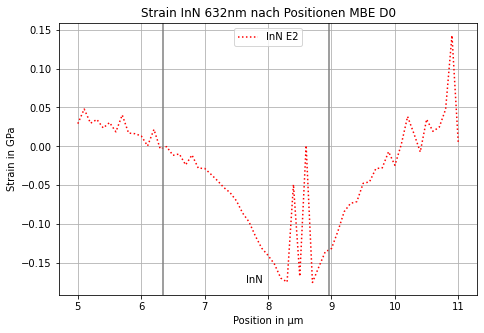

In [145]:
#Aus Raparez 2018
w_0_InN_E2 = 492.7 # +/- 0.2 1/cm
#w_0_InN_LO = 588.1 # +/- 0.2 1/cm

w_per_P_InN_E2 = 5.07 # +/- 0.1 1/cm/GPa für E2 high
#w_per_P_InN_LO = 5.07 # +/- 0.1 1/cm/GPa für A1 LO

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle Reparaz_2018_Comparative study of the pressure dependence of optical-phonon transverse-effective charges and linewidths in wurtzite InN_PRB
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_InN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(Peak_InN_E2_w)):
    Strain_InN_E2_Liste.append(Druck_in_Probe(Peak_InN_E2_w[i], w_0_InN_E2, w_per_P_InN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain InN 632nm nach Positionen MBE D0')

plt.plot(Positionen, Strain_InN_E2_Liste, ':', color='r'  ,markersize=2, label='InN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2]-(fitParams_G_E2[1]/2), ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2],y=min(Strain_InN_E2_Liste),s='InN')
plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_632nm/MBE Strain nach Positionen D0 632nm')
plt.show()

## GaN dotiert mit Ge

Probenoberfläche vor Messung
<img src="Daten_632nm/Ge_Mapping_632nm_Bild1a.jpg" style="width:300px;"/>
Probenoberfläche nach Messung
<img src="Daten_632nm/Ge_Mapping_632nm_Bild1b.jpg" style="width:300px;"/>

### Datenladen

In [146]:
#öffnen und einlesen der Daten aus der txt datei
with open(path + "Ge_Mapping_632nm_Bild1_D0_2x60s.txt") as f1:
        data_GaN_632nm_txt = [[cell.strip() for cell in row.split('\t')] for row in f1]
#print(data_txt)

#Datenumwandlung
data_GaN_632nm_array_str = np.array(data_GaN_632nm_txt)               #in np array umwandeln um listen von listen zu entkommen
data_GaN_632nm_array_str[0][0] = 0                          #überschreiben des '' zu '0' da ansonsten nicht weiter zu bearbeiten !!!!!!!!!!!!!!!

data_GaN_632nm_array_float = data_GaN_632nm_array_str.astype(float)   #str zu float in Arrayform
print(data_GaN_632nm_array_float)

#Abziehen der Verschiebung von 1 Zeile da diese die Ramanfrequenzen enthält
for k in range(len(data_GaN_632nm_array_float[0])):
    data_GaN_632nm_array_float[0][k]=data_GaN_632nm_array_float[0][k]-Verschiebung_A_plane
print(data_GaN_632nm_array_float)

[[  0.      755.22382 754.92389 ... 438.68582 438.36453 438.04324]
 [  6.       18.7909   19.0771  ...  15.492    15.4794   15.4626 ]
 [  6.1      20.1466   20.2081  ...  16.4529   16.3942   16.3199 ]
 ...
 [ 12.8       6.08909   6.04378 ...   5.89456   5.86857   5.76527]
 [ 12.9       5.92716   5.90882 ...   5.83852   5.83181   5.81063]
 [ 13.        5.61351   5.60892 ...   5.61686   5.5791    5.51583]]
[[ -1.35381074 753.87000926 753.57007926 ... 437.33200926 437.01071926
  436.68942926]
 [  6.          18.7909      19.0771     ...  15.492       15.4794
   15.4626    ]
 [  6.1         20.1466      20.2081     ...  16.4529      16.3942
   16.3199    ]
 ...
 [ 12.8          6.08909      6.04378    ...   5.89456      5.86857
    5.76527   ]
 [ 12.9          5.92716      5.90882    ...   5.83852      5.83181
    5.81063   ]
 [ 13.           5.61351      5.60892    ...   5.61686      5.5791
    5.51583   ]]


### Fitten und Plotten

Position: 6.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [18.7909 19.0771 19.3108 ... 15.492  15.4794 15.4626]
(1024,)
Hintergrund Parameter:  [ 8.47942570e-12 -1.98839753e-08  1.73363560e-05 -6.69420948e-03
  9.99948418e-01 -3.12476129e-04]
Fitparameter Saphir 418: [0.4560632453151504, 10.428418313332825, 429.99996106456103]
Fitparameter GaN A1 LPP 531: [6.120564569495361, 16.40546112023141, 524.5153197175922]
Fitparameter GaN E2 568: [122.60353333388056, 2.599497906952763, 571.23331973054]
Fitparameter Saphir 650: [1.3261162254215038, 5.4600224003595885, 658.1519760853457]
Fitparameter GaN 650: [1.2990637443741635, 54.80235409821565, 658.2559152214894]
Fitparameter GaN LO 741: [12.134149893334536, 6.195576784430724, 736.7023425712955]


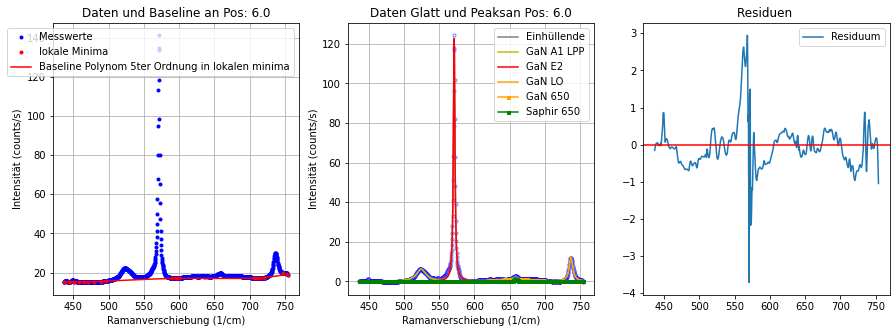

----------------------------------------------------------------------------------------------------
Position: 6.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [20.1466 20.2081 20.2779 ... 16.4529 16.3942 16.3199]
(1024,)
Hintergrund Parameter:  [ 8.31767852e-12 -1.95737238e-08  1.71343772e-05 -6.64692091e-03
  9.99991613e-01 -4.78716466e-04]
Fitparameter Saphir 418: [68.97660108513773, 1.5678317887782132, 424.5356365882169]
Fitparameter GaN A1 LPP 531: [6.560980483012793, 17.092379220225943, 524.3661887691109]
Fitparameter GaN E2 568: [134.73479494547274, 2.596876425271863, 571.2418449185126]
Fitparameter Saphir 650: [1.407028610945543, 4.970030420600599, 657.7480893646216]
Fitparameter GaN 650: [1.343659828459469, 51.26515996461187, 656.8177897623486]
Fitparameter GaN LO 741: [13.330952257409278, 5.98049076972074, 736.6799781258243]
BILD an Pos:  6.1


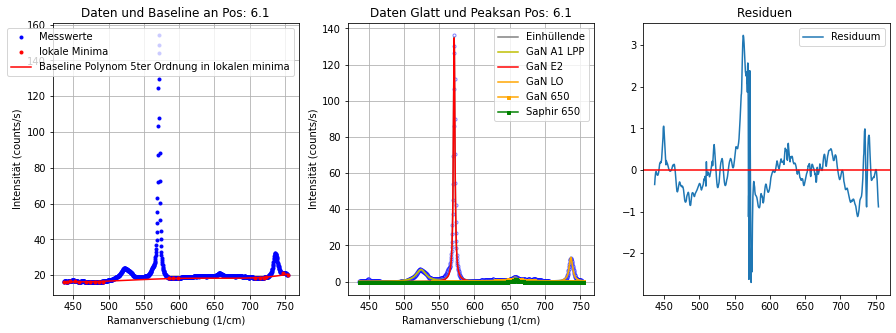

----------------------------------------------------------------------------------------------------
Position: 6.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [21.5947 21.7463 21.8572 ... 17.7982 17.7662 17.7475]
(1024,)
Hintergrund Parameter:  [ 7.68387072e-12 -1.84014851e-08  1.64110642e-05 -6.49467691e-03
  9.99991660e-01 -4.79590229e-04]
Fitparameter Saphir 418: [65.97305812647663, 1.1734739106746912, 426.7285310676311]
Fitparameter GaN A1 LPP 531: [6.849299746978085, 19.285135057664014, 524.3983258021548]
Fitparameter GaN E2 568: [146.43841684170323, 2.5947041532114996, 571.2484902890877]
Fitparameter Saphir 650: [1.9181200875829945, 5.756595865161496, 657.9544028903113]
Fitparameter GaN 650: [1.1444877635335173, 70.875831722243, 650.7975555413979]
Fitparameter GaN LO 741: [14.890451483672269, 6.3447757270339, 736.7635244779725]


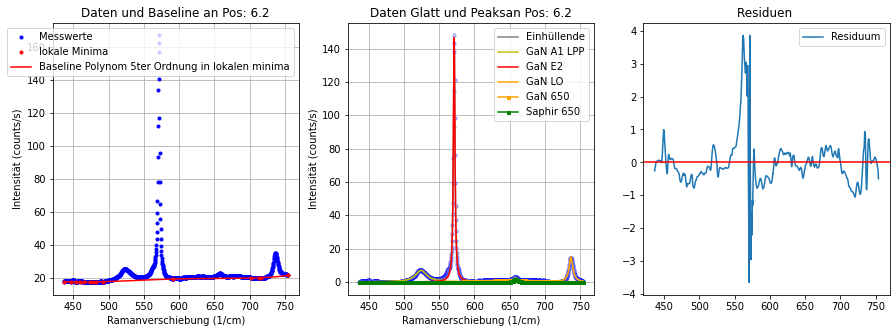

----------------------------------------------------------------------------------------------------
Position: 6.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [22.9337 23.2261 23.4611 ... 18.7919 19.0278 19.1509]
(1024,)
Hintergrund Parameter:  [ 8.10635425e-12 -1.91305235e-08  1.68105110e-05 -6.55921975e-03
  9.99995240e-01 -8.28552826e-04]
Fitparameter Saphir 418: [112.0620470187095, 0.9639705648513773, 424.8768419395937]
Fitparameter GaN A1 LPP 531: [7.583273219247283, 17.524580329419454, 524.2558023416428]
Fitparameter GaN E2 568: [160.36686699020981, 2.5779472530523395, 571.2358720200579]
Fitparameter Saphir 650: [2.5661185483236983, 1.054466962583561e-05, 648.5892914444466]
Fitparameter GaN 650: [2.132684738042685, 44.338140747143775, 657.4338306942759]
Fitparameter GaN LO 741: [16.111715685480696, 6.29646279510646, 736.7364655545024]


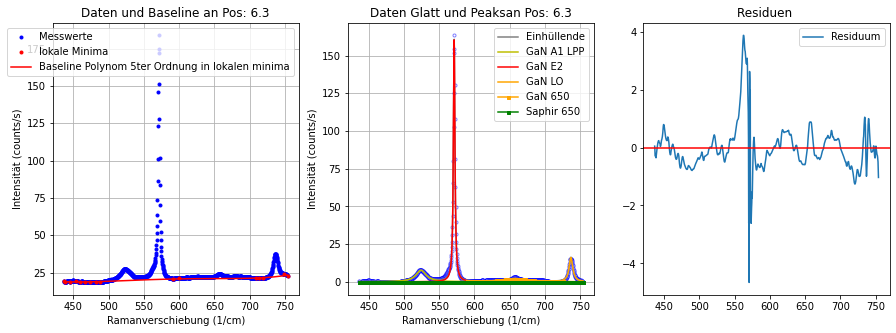

----------------------------------------------------------------------------------------------------
Position: 6.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [24.3375 24.366  24.4091 ... 20.0237 19.9543 19.8646]
(1024,)
Hintergrund Parameter:  [ 7.84877616e-12 -1.86835061e-08  1.65457702e-05 -6.50180609e-03
  9.99999994e-01 -8.50634920e-08]
Fitparameter Saphir 418: [159.23727101591192, 1.0735520746590521, 423.648088617046]
Fitparameter GaN A1 LPP 531: [7.79688798422001, 18.541147906115594, 524.3458907669776]
Fitparameter GaN E2 568: [170.26091813789174, 2.5847211871553966, 571.2478642834427]
Fitparameter Saphir 650: [0.00015481688809641155, 1.4554556928993477e-06, 645.005122631604]
Fitparameter GaN 650: [2.072771865390137, 35.989610666819, 659.0721396081115]
Fitparameter GaN LO 741: [17.69417410224174, 6.483627046128902, 736.7309802547182]


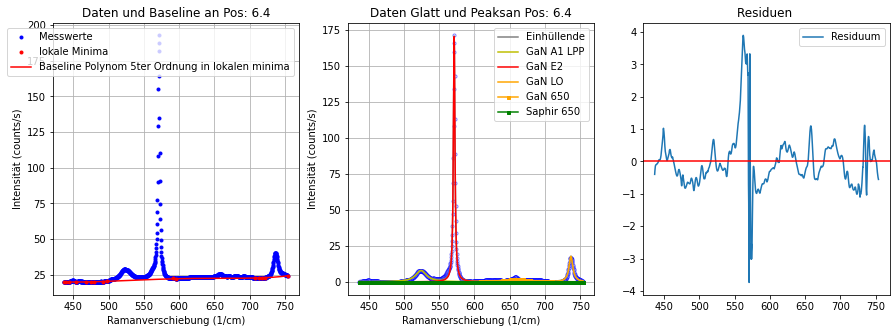

----------------------------------------------------------------------------------------------------
Position: 6.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [25.5037 25.5267 25.6226 ... 20.9575 20.925  20.935 ]
(1024,)
Hintergrund Parameter:  [ 8.04194549e-12 -1.89991269e-08  1.67064837e-05 -6.52365177e-03
  9.99999430e-01 -6.62209239e-06]
Fitparameter Saphir 418: [106.81587887467427, 1.0502687514954074, 427.9528776762169]
Fitparameter GaN A1 LPP 531: [8.124920186056372, 17.29696151182762, 524.4359645102883]
Fitparameter GaN E2 568: [183.3209457475193, 2.563483322269527, 571.2576291336225]
Fitparameter Saphir 650: [2.0462841100887457, 5.450381076189398, 657.6313100773565]
Fitparameter GaN 650: [1.274520958238617, 46.53127336544407, 659.2775505857251]
Fitparameter GaN LO 741: [19.055663936217872, 5.989431184056327, 736.6964556042685]


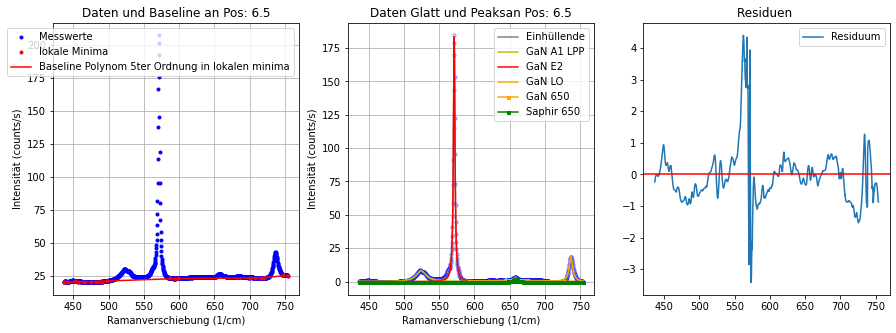

----------------------------------------------------------------------------------------------------
Position: 6.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [27.3344 27.4225 27.5129 ... 22.6326 22.5252 22.4082]
(1024,)
Hintergrund Parameter:  [ 8.35110327e-12 -1.95082694e-08  1.69622615e-05 -6.55573537e-03
  9.99986249e-01 -3.12925380e-04]
Fitparameter Saphir 418: [0.9120190808420473, 19.86282939875245, 429.99999995967795]
Fitparameter GaN A1 LPP 531: [8.83683999942269, 17.4059572521694, 524.4452383821402]
Fitparameter GaN E2 568: [202.72597337948793, 2.562263409846243, 571.2792440866086]
Fitparameter Saphir 650: [2.2242069671250086, 5.413881310675411, 657.7848057575318]
Fitparameter GaN 650: [1.6805186994481003, 48.66382735788567, 660.188982421964]
Fitparameter GaN LO 741: [21.132545992120743, 5.992357018517899, 736.7091487810346]


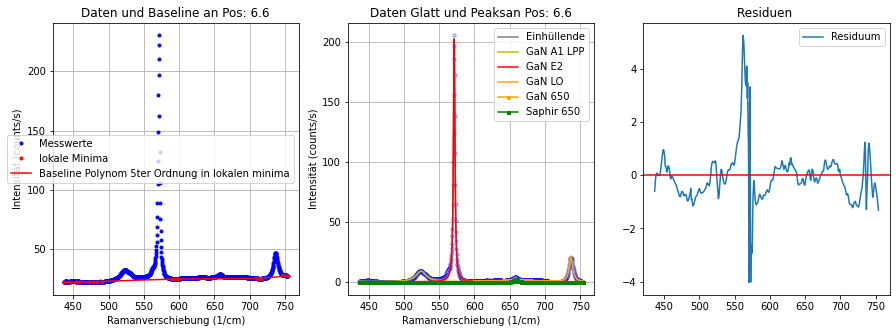

----------------------------------------------------------------------------------------------------
Position: 6.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [29.0979 29.167  29.2225 ... 24.4641 24.3827 24.2746]
(1024,)
Hintergrund Parameter:  [ 7.26135424e-12 -1.75185569e-08  1.57516235e-05 -6.30522636e-03
  9.99983279e-01 -3.06724888e-04]
Fitparameter Saphir 418: [120.90566869158044, 0.5866478910465293, 429.99997608504674]
Fitparameter GaN A1 LPP 531: [9.774335674646526, 19.430916721905295, 524.5874147240089]
Fitparameter GaN E2 568: [224.80462530072947, 2.553695759941607, 571.2800054884628]
Fitparameter Saphir 650: [1.061092790983854, 4.2158190630171814e-08, 649.9084214721743]
Fitparameter GaN 650: [2.486912837122356, 35.909193773649356, 658.3386460673561]
Fitparameter GaN LO 741: [23.85102203972132, 6.4767017775782145, 736.7328681279763]


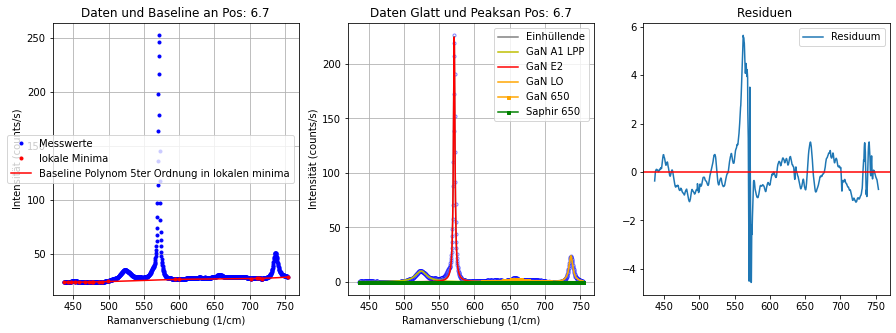

----------------------------------------------------------------------------------------------------
Position: 6.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [31.2658 31.2985 31.3293 ... 26.03   26.0469 26.0675]
(1024,)
Hintergrund Parameter:  [ 7.27860090e-12 -1.74069202e-08  1.55070031e-05 -6.15216697e-03
  9.73125170e-01 -1.51565856e-01]
Fitparameter Saphir 418: [159.31583813032913, 0.7821240743291699, 429.99999919277354]
Fitparameter GaN A1 LPP 531: [10.398103073855456, 19.242506098164515, 524.5010198012592]
Fitparameter GaN E2 568: [244.47049146861102, 2.5512094156966425, 571.2892965633131]
Fitparameter Saphir 650: [1.8322117305537382, 5.981744555195885e-07, 650.4475466964356]
Fitparameter GaN 650: [3.1505391891103667, 22.663767390042363, 658.9083391758766]
Fitparameter GaN LO 741: [26.02128811354504, 6.3589544784351455, 736.7620791068284]


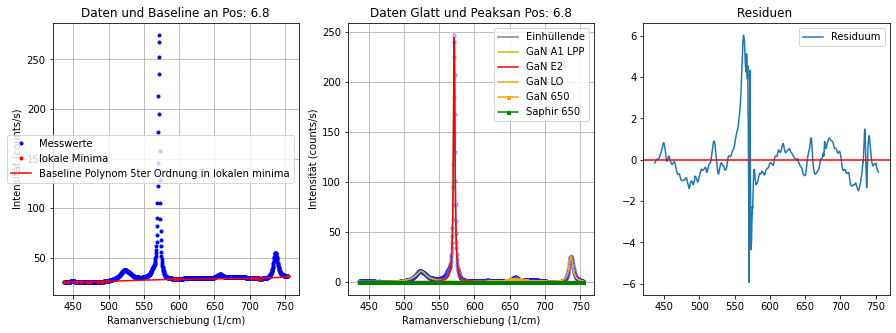

----------------------------------------------------------------------------------------------------
Position: 6.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [31.2231 31.5182 31.7867 ... 26.8549 26.7041 26.6467]
(1024,)
Hintergrund Parameter:  [ 6.87641066e-12 -1.68650555e-08  1.53641465e-05 -6.21571198e-03
  9.99999524e-01 -6.93278143e-06]
Fitparameter Saphir 418: [0.839635213691095, 15.978888377309401, 429.99999988848947]
Fitparameter GaN A1 LPP 531: [11.072335136044419, 19.400028665424987, 524.5238238839621]
Fitparameter GaN E2 568: [258.31056903675994, 2.5610822520928282, 571.2951665688789]
Fitparameter Saphir 650: [3.5813995083624515, 7.525193158709593, 657.3899773633382]
Fitparameter GaN 650: [0.9625908499556962, 38.063642486906275, 669.9999999999999]
Fitparameter GaN LO 741: [28.049351414585143, 6.688183288969389, 736.7884467286991]


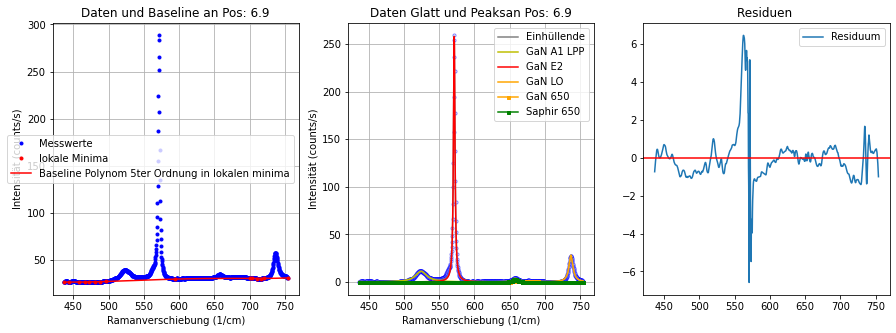

----------------------------------------------------------------------------------------------------
Position: 7.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [33.5662 33.6737 33.78   ... 27.8633 27.7086 27.6431]
(1024,)
Hintergrund Parameter:  [ 7.03530278e-12 -1.71343780e-08  1.55053143e-05 -6.23338205e-03
  9.99987462e-01 -3.11850352e-04]
Fitparameter Saphir 418: [0.49425642497327366, 18.321582994736694, 429.99999999999994]
Fitparameter GaN A1 LPP 531: [11.52095050301966, 19.15134356333776, 524.6687947154895]
Fitparameter GaN E2 568: [276.2960206439093, 2.537190963967937, 571.2953176760772]
Fitparameter Saphir 650: [3.744394442933483, 7.589252639465819, 657.6134400510875]
Fitparameter GaN 650: [0.6717764463310226, 23.580325058595395, 669.9999989203753]
Fitparameter GaN LO 741: [29.506723030470038, 6.359617254409893, 736.7502221291857]


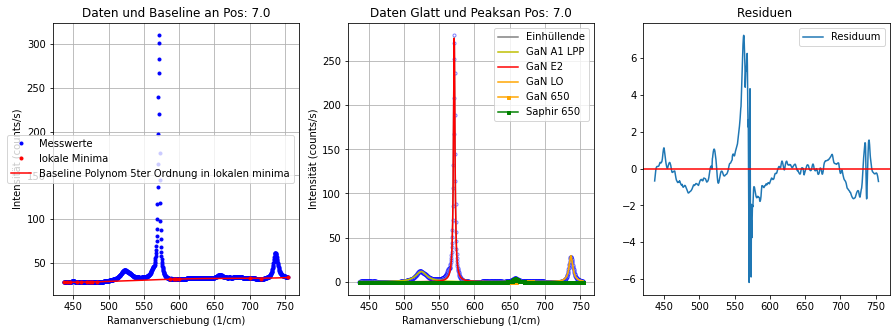

----------------------------------------------------------------------------------------------------
Position: 7.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [34.8469 35.1406 35.3459 ... 29.5054 29.3567 29.2069]
(1024,)
Hintergrund Parameter:  [ 6.91464394e-12 -1.68680262e-08  1.53076158e-05 -6.18186877e-03
  9.99999989e-01 -9.01744887e-06]
Fitparameter Saphir 418: [1.0855038515364313, 12.73585671175516, 429.9999999997215]
Fitparameter GaN A1 LPP 531: [12.793279311923365, 19.985642651156187, 524.7006182514062]
Fitparameter GaN E2 568: [301.8452927856714, 2.5467317081236986, 571.3111722092552]
Fitparameter Saphir 650: [3.477136687054653, 6.028892200145511, 657.3395067464089]
Fitparameter GaN 650: [1.4964746355660308, 44.00619262956775, 663.8923836533031]
Fitparameter GaN LO 741: [32.387939054746596, 6.448441028257303, 736.7654925711436]


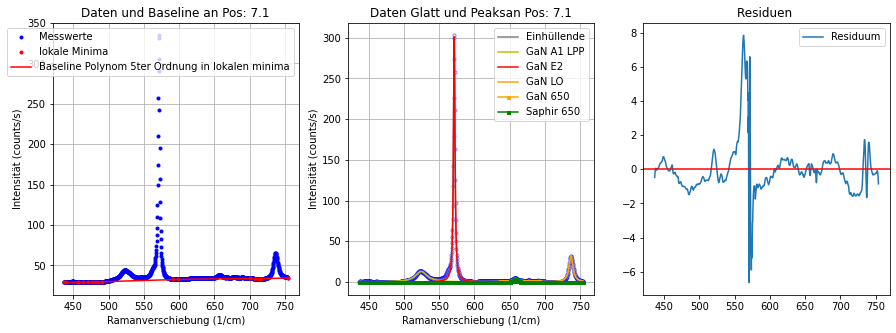

----------------------------------------------------------------------------------------------------
Position: 7.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [35.8077 35.9353 36.0672 ... 30.9157 30.7188 30.4431]
(1024,)
Hintergrund Parameter:  [ 6.89178936e-12 -1.68303923e-08  1.52712836e-05 -6.16424022e-03
  9.99954633e-01 -3.43322115e-04]
Fitparameter Saphir 418: [407.55740044410993, 0.47523260223329244, 429.99999999999994]
Fitparameter GaN A1 LPP 531: [13.880096584399329, 18.707043554400983, 524.553810609699]
Fitparameter GaN E2 568: [329.5950159135086, 2.529908509614569, 571.3091124400866]
Fitparameter Saphir 650: [4.102133460992878, 6.843057175317245, 657.5583251576257]
Fitparameter GaN 650: [1.3874433403328799, 33.28225300799422, 669.9999999999999]
Fitparameter GaN LO 741: [35.69490138104665, 6.551581619930831, 736.729363357374]


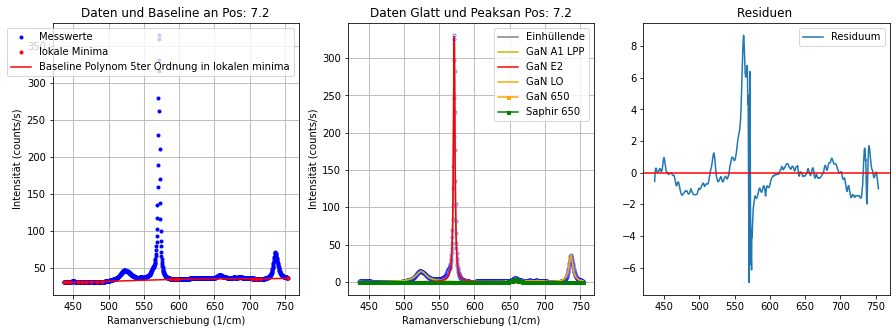

----------------------------------------------------------------------------------------------------
Position: 7.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [37.2419 37.2891 37.445  ... 31.8478 31.8689 31.9565]
(1024,)
Hintergrund Parameter:  [ 6.36339981e-12 -1.58184363e-08  1.46282839e-05 -6.02588567e-03
  9.99982787e-01 -5.59051670e-04]
Fitparameter Saphir 418: [10.100779929348079, 0.27974759773174845, 429.99999999999994]
Fitparameter GaN A1 LPP 531: [15.158763287344065, 20.074189312677337, 524.771959838266]
Fitparameter GaN E2 568: [355.79261479559614, 2.531391165266762, 571.3159834610996]
Fitparameter Saphir 650: [4.250659046522088, 7.636909979576799, 657.3566677732318]
Fitparameter GaN 650: [1.417843671181475, 36.1886089220574, 669.9999999999999]
Fitparameter GaN LO 741: [38.35682193081975, 6.433513081215336, 736.75842585851]


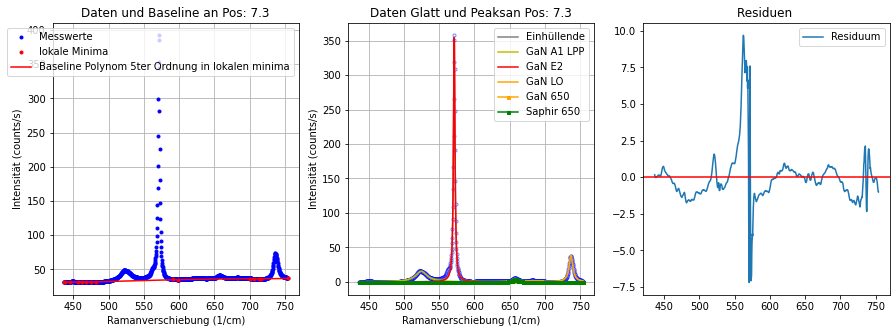

----------------------------------------------------------------------------------------------------
Position: 7.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [37.8546 38.0808 38.2778 ... 32.3485 32.3321 32.2068]
(1024,)
Hintergrund Parameter:  [ 6.11306929e-12 -1.52946463e-08  1.42697418e-05 -5.94470575e-03
  9.99994776e-01 -3.07053100e-04]
Fitparameter Saphir 418: [0.16045181104886438, 10.085355685149132, 429.99999999572333]
Fitparameter GaN A1 LPP 531: [16.194962811754927, 22.04620480328975, 524.9376611362468]
Fitparameter GaN E2 568: [380.40429794371704, 2.5307550605968068, 571.3141038596923]
Fitparameter Saphir 650: [7.430932483763578e-05, 7.622798019003627e-07, 645.0305585094525]
Fitparameter GaN 650: [3.999328297690173, 30.180028521300812, 659.4726371242839]
Fitparameter GaN LO 741: [40.817464099154456, 6.445952916656768, 736.7440284634412]


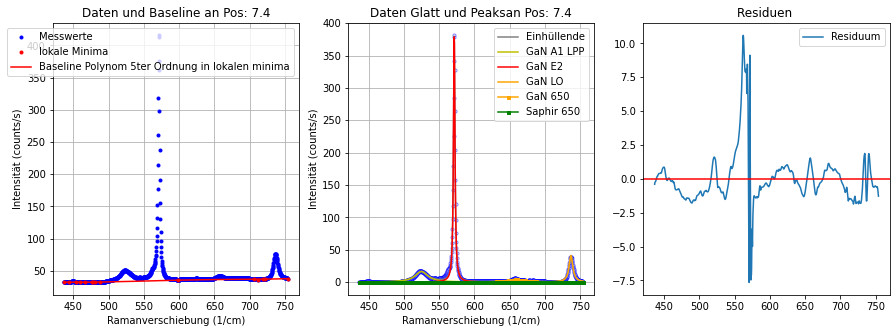

----------------------------------------------------------------------------------------------------
Position: 7.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [38.5494 38.6845 38.8829 ... 33.4374 33.5276 33.6553]
(1024,)
Hintergrund Parameter:  [ 6.27165366e-12 -1.56792687e-08  1.45468400e-05 -6.00239404e-03
  9.99993429e-01 -3.08997745e-04]
Fitparameter Saphir 418: [591.5324068898174, 0.34436153362007527, 429.99999999999994]
Fitparameter GaN A1 LPP 531: [17.77397004851773, 20.25498157917387, 524.6861042941562]
Fitparameter GaN E2 568: [408.44307326018327, 2.5210211283869284, 571.3106130230793]
Fitparameter Saphir 650: [4.712388120904783, 7.460567889999534, 657.2244752281729]
Fitparameter GaN 650: [1.634482789944714, 34.36153735767088, 669.9999999999999]
Fitparameter GaN LO 741: [44.59111914327015, 6.428273721660234, 736.7561466921254]


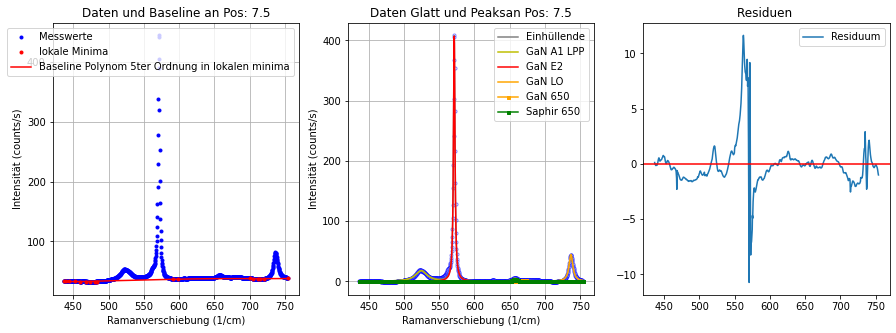

----------------------------------------------------------------------------------------------------
Position: 7.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [38.962  39.2904 39.6258 ... 34.1606 34.1385 34.1808]
(1024,)
Hintergrund Parameter:  [ 5.84475980e-12 -1.48674718e-08  1.40296680e-05 -5.88979570e-03
  9.99944914e-01 -3.40718669e-04]
Fitparameter Saphir 418: [9.857683433974008e-27, 12.821548731327997, 429.33038358151464]
Fitparameter GaN A1 LPP 531: [19.513299648896382, 20.627647224047376, 524.7021783408449]
Fitparameter GaN E2 568: [438.24309476875874, 2.5237982403010033, 571.3048373367996]
Fitparameter Saphir 650: [4.616859761792631, 8.011286519836897, 657.5069268639961]
Fitparameter GaN 650: [1.8677458192425265, 33.47483891976058, 669.9999999999999]
Fitparameter GaN LO 741: [47.187686244674794, 6.489238263322608, 736.7196516818316]


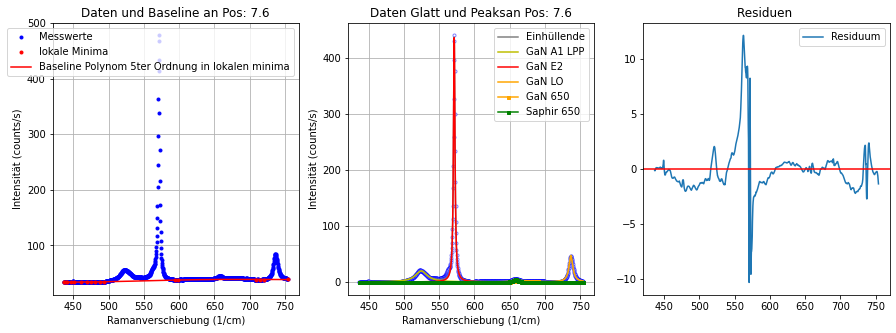

----------------------------------------------------------------------------------------------------
Position: 7.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [39.4188 39.6536 39.8376 ... 35.2169 35.2569 35.2465]
(1024,)
Hintergrund Parameter:  [ 6.25558578e-12 -1.56685547e-08  1.45296526e-05 -5.98675343e-03
  9.99995673e-01 -8.80681098e-04]
Fitparameter Saphir 418: [1.429049173485482e-17, 7.1379505969229164, 415.0301192496961]
Fitparameter GaN A1 LPP 531: [21.578877729510786, 19.36468893293586, 524.51469176884]
Fitparameter GaN E2 568: [472.9952479614175, 2.5047105088319817, 571.3039570690456]
Fitparameter Saphir 650: [4.945189822021668, 7.494969312959092, 657.0861723171666]
Fitparameter GaN 650: [1.8704578775202207, 29.155352237878525, 669.9999965166533]
Fitparameter GaN LO 741: [50.86807657340914, 6.5069880462067715, 736.7445262150881]


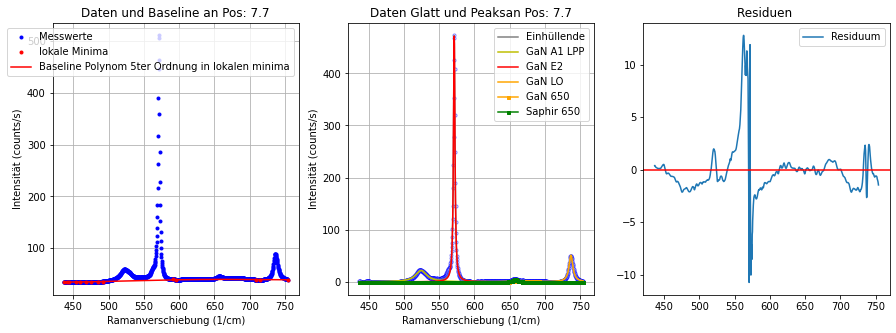

----------------------------------------------------------------------------------------------------
Position: 7.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [39.3011 39.6323 39.9471 ... 35.6031 35.6348 35.7021]
(1024,)
Hintergrund Parameter:  [ 5.50123950e-12 -1.42604215e-08  1.36611412e-05 -5.80943378e-03
  9.99991283e-01 -3.25537785e-04]
Fitparameter Saphir 418: [3.1898823399541793e-38, 8.976439070625757, 417.1083732932189]
Fitparameter GaN A1 LPP 531: [23.43326059301552, 20.505310633910156, 524.699414439586]
Fitparameter GaN E2 568: [494.894865871203, 2.5231552558055306, 571.2992875677595]
Fitparameter Saphir 650: [4.436881287634873, 6.928116892173369, 657.2445763528918]
Fitparameter GaN 650: [2.2279084562054443, 36.47004464826902, 664.4620857797905]
Fitparameter GaN LO 741: [53.333764868635384, 6.540700864678974, 736.7546591887622]


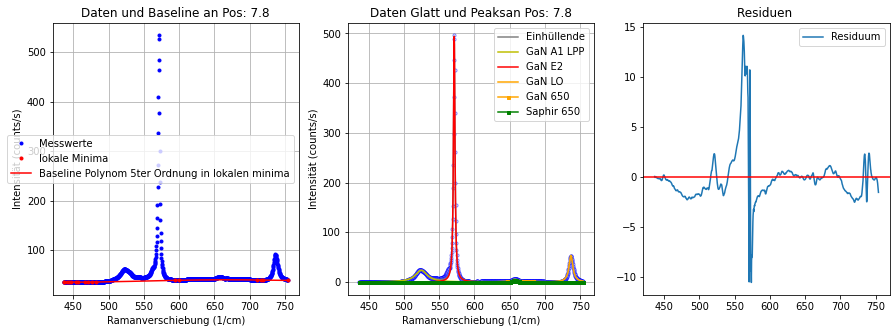

----------------------------------------------------------------------------------------------------
Position: 7.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [39.6864 39.8671 40.0436 ... 36.1218 36.3071 36.5331]
(1024,)
Hintergrund Parameter:  [ 5.38642504e-12 -1.39974135e-08  1.34707630e-05 -5.76531354e-03
  9.99999217e-01 -6.80745625e-06]
Fitparameter Saphir 418: [2.151383850304442e-05, 0.002135875450651919, 415.0000769755036]
Fitparameter GaN A1 LPP 531: [24.80583738456194, 21.10486869580114, 524.9706854347577]
Fitparameter GaN E2 568: [516.057636767654, 2.523861005625724, 571.2943733826517]
Fitparameter Saphir 650: [3.6794321689723235, 6.185767982858508, 657.8122742265948]
Fitparameter GaN 650: [2.8416585464674102, 38.0540095742207, 660.7553263695943]
Fitparameter GaN LO 741: [54.878555054453194, 6.38548528422389, 736.7353988981934]


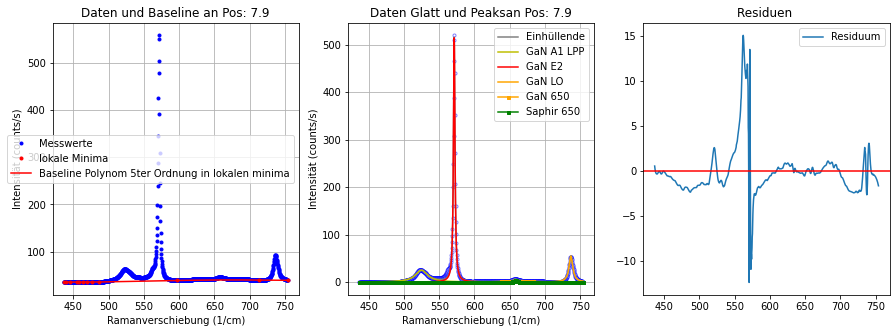

----------------------------------------------------------------------------------------------------
Position: 8.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [39.8161 39.8877 39.9726 ... 36.0968 36.2092 36.3346]
(1024,)
Hintergrund Parameter:  [ 6.23595638e-12 -1.56278787e-08  1.44887118e-05 -5.97031227e-03
  9.99993866e-01 -3.22593884e-04]
Fitparameter Saphir 418: [7.055516983550085e-17, 1.7844213534314246, 416.16043918396036]
Fitparameter GaN A1 LPP 531: [26.96736759645317, 19.81049603360069, 524.6731656869888]
Fitparameter GaN E2 568: [538.8511044297702, 2.52449337845132, 571.2873943579822]
Fitparameter Saphir 650: [4.362191747678845, 9.847260631579644, 656.8474188710331]
Fitparameter GaN 650: [2.5102021818964104, 28.76002594402337, 669.9999999999999]
Fitparameter GaN LO 741: [57.129059672691106, 6.414577214611841, 736.7349638385118]


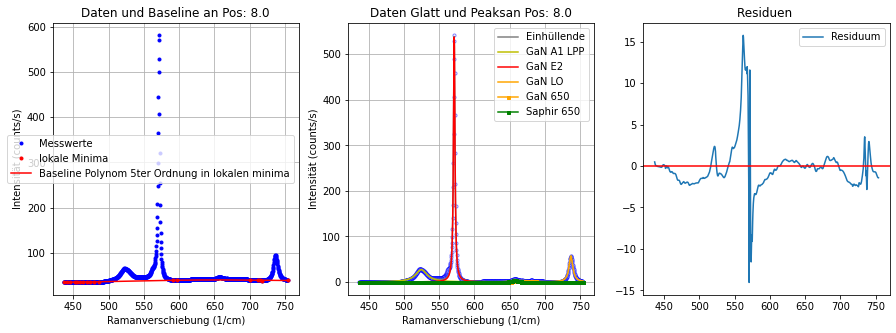

----------------------------------------------------------------------------------------------------
Position: 8.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [39.3787 39.7288 39.9073 ... 36.3798 36.4431 36.5975]
(1024,)
Hintergrund Parameter:  [ 6.32119435e-12 -1.57849063e-08  1.45769234e-05 -5.98463305e-03
  9.99993969e-01 -3.20204417e-04]
Fitparameter Saphir 418: [8.613715822825292e-22, 15.726975156785919, 419.4441036678059]
Fitparameter GaN A1 LPP 531: [29.62258041175158, 19.752668391282494, 524.7419737403435]
Fitparameter GaN E2 568: [566.0252129006585, 2.53156917441027, 571.273874762189]
Fitparameter Saphir 650: [4.726780032895142, 9.325391362554067, 657.2301640952041]
Fitparameter GaN 650: [2.7541907635980074, 30.890661272858683, 669.9999999999999]
Fitparameter GaN LO 741: [59.65910322384757, 6.392823724577169, 736.7437451049361]


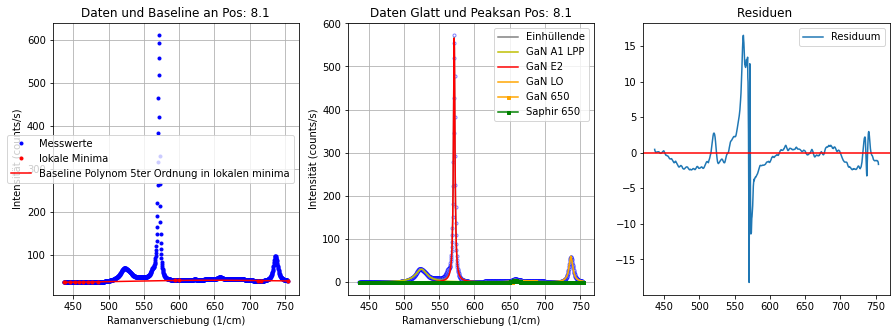

----------------------------------------------------------------------------------------------------
Position: 8.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [39.176  39.2895 39.4865 ... 36.5926 36.5624 36.4525]
(1024,)
Hintergrund Parameter:  [ 6.84456027e-12 -1.67512973e-08  1.51507841e-05 -6.09232048e-03
  9.99999991e-01 -4.14432826e-06]
Fitparameter Saphir 418: [5.986924122116568e-07, 0.005715966565224884, 415.0004051992871]
Fitparameter GaN A1 LPP 531: [32.257639076475094, 19.071295047848793, 524.6427600673978]
Fitparameter GaN E2 568: [585.8985123868271, 2.53296906711712, 571.276083104207]
Fitparameter Saphir 650: [4.688382525942526, 8.79396140658391, 656.7819927085301]
Fitparameter GaN 650: [3.41110277952584, 33.037660157903545, 669.9899736806707]
Fitparameter GaN LO 741: [60.35723589588781, 6.407609342313211, 736.7382384436843]


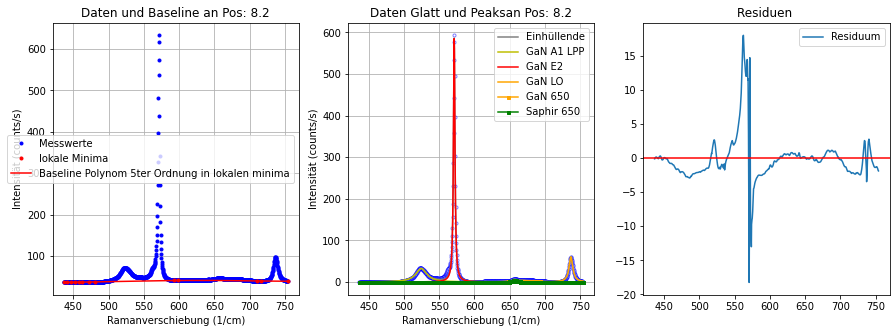

----------------------------------------------------------------------------------------------------
Position: 8.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [38.7163 38.8381 38.963  ... 37.1976 37.0875 36.9259]
(1024,)
Hintergrund Parameter:  [ 6.49519894e-12 -1.61097683e-08  1.47642212e-05 -6.01652489e-03
  9.99990510e-01 -3.20290655e-04]
Fitparameter Saphir 418: [863.4478604958749, 0.23773324103703597, 429.99999999999994]
Fitparameter GaN A1 LPP 531: [35.90023892864326, 20.08997338435462, 524.7502714996336]
Fitparameter GaN E2 568: [603.3613608787872, 2.5735554770756432, 571.2559557647321]
Fitparameter Saphir 650: [3.2168649758611867, 6.834735062079483, 656.6073965422777]
Fitparameter GaN 650: [4.504434966572286, 38.230345630736416, 665.7232363403228]
Fitparameter GaN LO 741: [61.633929816290696, 6.286310609911914, 736.7138561623273]


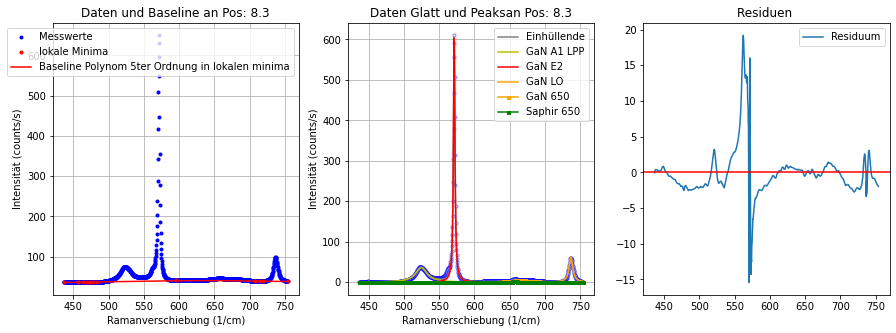

----------------------------------------------------------------------------------------------------
Position: 8.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [37.3862 37.4866 37.5985 ... 36.9545 37.06   37.1168]
(1024,)
Hintergrund Parameter:  [ 5.69608955e-12 -1.46148811e-08  1.37911344e-05 -5.76979733e-03
  9.82880013e-01 -1.55401693e-01]
Fitparameter Saphir 418: [1.0601810021895036e-15, 6.5609594271315865, 415.05272951792506]
Fitparameter GaN A1 LPP 531: [38.4616897186028, 19.406563292904107, 524.7563594639668]
Fitparameter GaN E2 568: [611.5896346561611, 2.5823403272970977, 571.252293285764]
Fitparameter Saphir 650: [4.544413652592545, 9.838293680767714, 656.702635310793]
Fitparameter GaN 650: [3.5334899163585556, 29.063979355032874, 669.9999992778046]
Fitparameter GaN LO 741: [61.07150048284754, 6.264078225247089, 736.6994029517642]


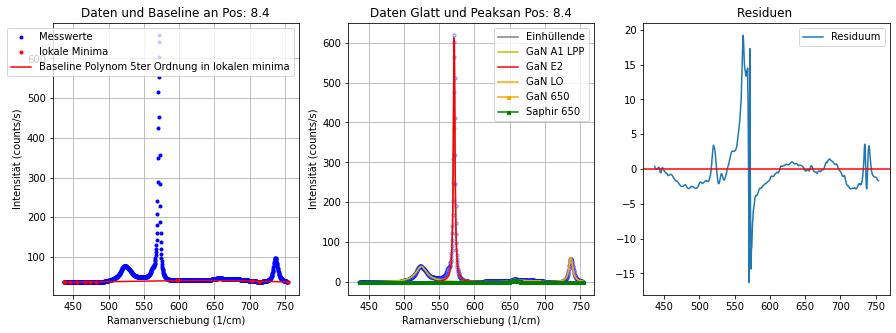

----------------------------------------------------------------------------------------------------
Position: 8.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [37.0767 37.0938 37.1369 ... 36.6602 36.5897 36.3652]
(1024,)
Hintergrund Parameter:  [ 7.27558713e-12 -1.75689435e-08  1.56447159e-05 -6.18838709e-03
  9.99995007e-01 -5.94556487e-03]
Fitparameter Saphir 418: [512.7498313724295, 0.005916394215603908, 415.00111977824747]
Fitparameter GaN A1 LPP 531: [41.22024915277447, 18.545700449698227, 524.7144431427845]
Fitparameter GaN E2 568: [618.8706492991856, 2.601151798897714, 571.2420281402818]
Fitparameter Saphir 650: [0.0005641072588651258, 6.033743981066648e-08, 645.0260937780021]
Fitparameter GaN 650: [5.96528333882716, 35.22878956371494, 662.9995862889734]
Fitparameter GaN LO 741: [59.19099379044064, 6.220109081308892, 736.7108849399253]


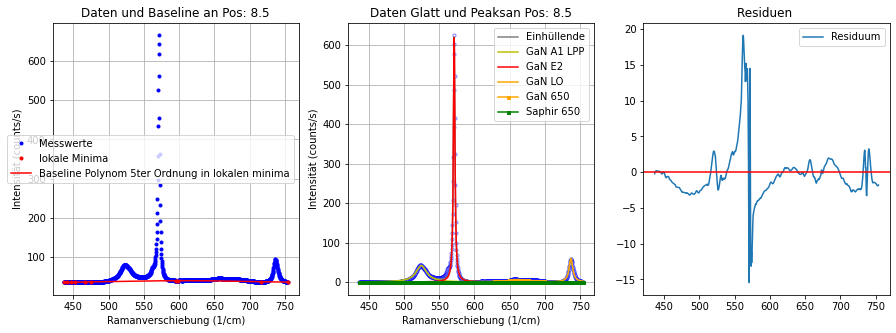

----------------------------------------------------------------------------------------------------
Position: 8.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [36.796  36.8728 36.9277 ... 37.5757 37.6037 37.6924]
(1024,)
Hintergrund Parameter:  [ 6.29728197e-12 -1.57418070e-08  1.44674064e-05 -5.89942019e-03
  9.83919052e-01 -1.49946995e-01]
Fitparameter Saphir 418: [3.936739024439915e-10, 0.0001019896788905239, 415.00001394709585]
Fitparameter GaN A1 LPP 531: [44.47802453336445, 18.878719673204312, 524.8032086874204]
Fitparameter GaN E2 568: [621.4102236260014, 2.63379168128808, 571.2365740400897]
Fitparameter Saphir 650: [0.00022881331732872018, 3.891201409775449e-06, 659.8650887208414]
Fitparameter GaN 650: [6.097200113233748, 36.27068607504905, 663.3722951888327]
Fitparameter GaN LO 741: [57.192491478828536, 6.20922493461325, 736.7188994977917]


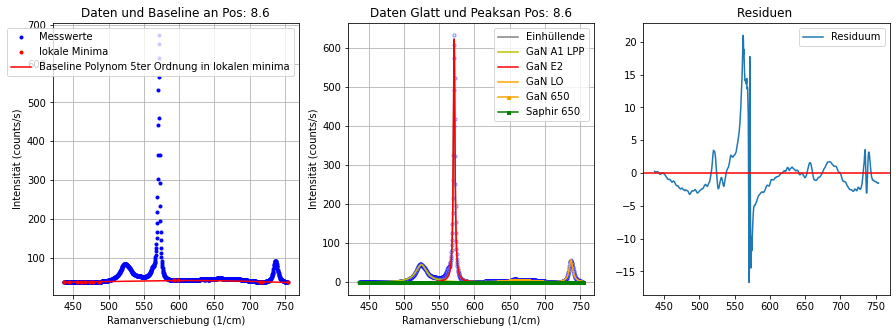

----------------------------------------------------------------------------------------------------
Position: 8.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [36.6432 36.6983 36.9609 ... 38.6062 38.5609 38.498 ]
(1024,)
Hintergrund Parameter:  [ 6.58165914e-12 -1.61675054e-08  1.46466764e-05 -5.91274103e-03
  9.82898843e-01 -1.02037271e-01]
Fitparameter Saphir 418: [2.3507715214128915e-11, 0.04338033246662433, 429.99963970156654]
Fitparameter GaN A1 LPP 531: [47.883580608731044, 19.00497010580542, 524.8587794838215]
Fitparameter GaN E2 568: [616.8394123124351, 2.6757676410508777, 571.2182532581421]
Fitparameter Saphir 650: [0.9637842087386382, 0.03261608767395067, 650.209680090354]
Fitparameter GaN 650: [7.179321083904874, 42.49780019652043, 663.8934535277419]
Fitparameter GaN LO 741: [54.771710841726964, 6.105034214731122, 736.7172503437289]


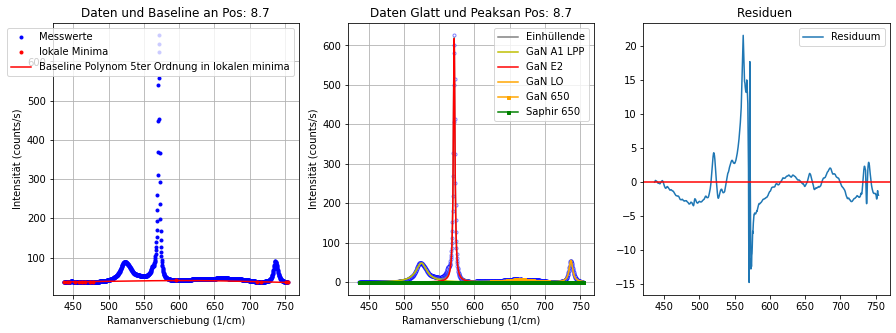

----------------------------------------------------------------------------------------------------
Position: 8.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [36.1603 36.3904 36.5488 ... 38.6427 38.4843 38.2613]
(1024,)
Hintergrund Parameter:  [ 7.05543451e-12 -1.72675917e-08  1.54953703e-05 -6.15432562e-03
  9.99993214e-01 -6.56118820e-04]
Fitparameter Saphir 418: [220.93296280799018, 1.4999910097156716e-06, 424.9279287080892]
Fitparameter GaN A1 LPP 531: [49.49806053156304, 18.334760952051464, 524.7644024522464]
Fitparameter GaN E2 568: [604.580256248849, 2.7026895549197834, 571.2088581559294]
Fitparameter Saphir 650: [3.2026692873358704, 9.999985719323565, 656.3315653930158]
Fitparameter GaN 650: [5.72616364740738, 35.124647588643796, 669.9999999999968]
Fitparameter GaN LO 741: [52.5903947069415, 6.133005592771651, 736.6995980950982]


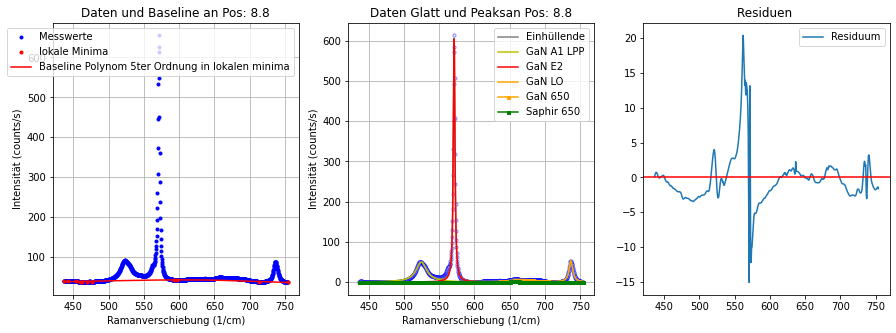

----------------------------------------------------------------------------------------------------
Position: 8.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [35.4023 35.5549 35.8224 ... 38.9897 38.9941 39.028 ]
(1024,)
Hintergrund Parameter:  [ 5.97148439e-12 -1.53085665e-08  1.43279412e-05 -5.92455021e-03
  9.99699222e-01 -3.10818609e-03]
Fitparameter Saphir 418: [0.02081610062473265, 0.006214740651493578, 429.9997517155476]
Fitparameter GaN A1 LPP 531: [52.07278309298232, 18.161604163737962, 524.778178651177]
Fitparameter GaN E2 568: [593.6466850492749, 2.7434678981961484, 571.2022283353155]
Fitparameter Saphir 650: [1.4999296859685773, 0.11197204036769574, 650.2169327507137]
Fitparameter GaN 650: [6.530834874964885, 36.6157143608695, 666.3365152332952]
Fitparameter GaN LO 741: [49.53395575529039, 6.1472335127967614, 736.7230904607455]


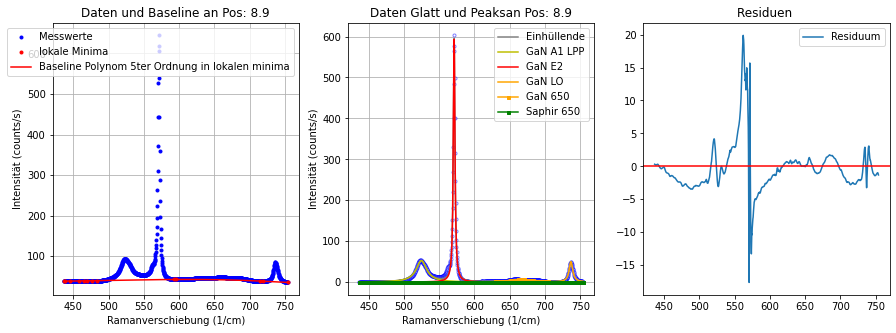

----------------------------------------------------------------------------------------------------
Position: 9.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [34.4184 34.848  35.1243 ... 39.1453 39.089  39.0553]
(1024,)
Hintergrund Parameter:  [ 6.27538602e-12 -1.59292812e-08  1.47292779e-05 -6.00649835e-03
  9.99974138e-01 -3.38307926e-04]
Fitparameter Saphir 418: [3.519548104228811e-14, 10.470903423310313, 418.4317989716997]
Fitparameter GaN A1 LPP 531: [53.52999428542844, 17.978148799249205, 524.7987256548749]
Fitparameter GaN E2 568: [582.6893606365622, 2.7710324035335607, 571.1909975100135]
Fitparameter Saphir 650: [2.228724698358881, 9.999999999986807, 655.2866106109867]
Fitparameter GaN 650: [6.334478619134286, 36.094878033317606, 669.9999999999998]
Fitparameter GaN LO 741: [46.494641531527265, 6.255800444050114, 736.7230981988674]


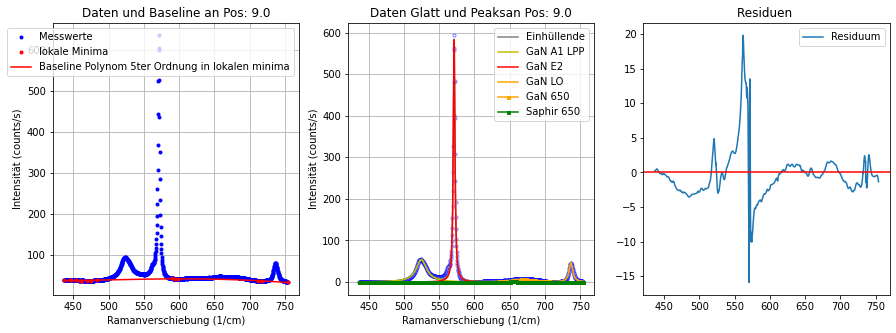

----------------------------------------------------------------------------------------------------
Position: 9.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [35.2541 35.1027 35.0279 ... 39.5503 39.4937 38.7859]
(1024,)
Hintergrund Parameter:  [ 6.84156304e-12 -1.68669011e-08  1.52310132e-05 -6.09274970e-03
  9.99981998e-01 -3.36124302e-04]
Fitparameter Saphir 418: [5.972821895805796e-23, 3.1692932303180434, 428.13632159640423]
Fitparameter GaN A1 LPP 531: [55.07938468154085, 17.783124489273675, 524.8422180211087]
Fitparameter GaN E2 568: [566.7458077831354, 2.8071817583838103, 571.179676171615]
Fitparameter Saphir 650: [1.8708743591931412, 9.999999999999998, 645.0000000146148]
Fitparameter GaN 650: [7.5694129596199735, 36.89317029673784, 669.1349338317588]
Fitparameter GaN LO 741: [42.29795573471796, 6.009816834543558, 736.6798967646326]


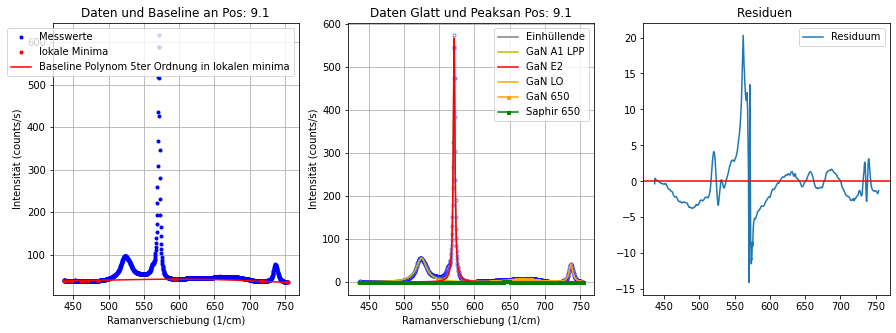

----------------------------------------------------------------------------------------------------
Position: 9.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [34.029  34.2918 34.4692 ... 39.0385 38.9668 38.8839]
(1024,)
Hintergrund Parameter:  [ 5.69772645e-12 -1.48317141e-08  1.40454861e-05 -5.86657575e-03
  9.99053915e-01 -4.57142262e-03]
Fitparameter Saphir 418: [3.0735966364795708e-12, 0.00033840650764917213, 415.05481253412415]
Fitparameter GaN A1 LPP 531: [56.46531165553016, 18.15438046223194, 524.9175801213828]
Fitparameter GaN E2 568: [553.1932337592726, 2.8354459773891425, 571.1676615731667]
Fitparameter Saphir 650: [1.4152230572532383, 0.05705206360154283, 650.2252653570998]
Fitparameter GaN 650: [7.463272617897998, 40.85248660592381, 666.5885510833032]
Fitparameter GaN LO 741: [39.70551664503192, 6.028709326062236, 736.6872111102788]


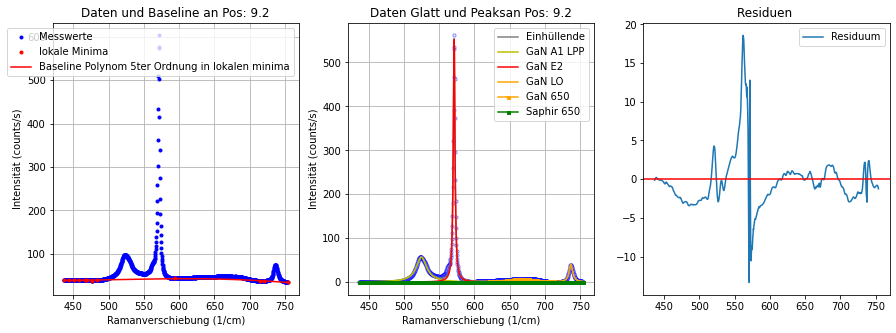

----------------------------------------------------------------------------------------------------
Position: 9.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [34.225  34.4064 34.564  ... 39.0856 38.9127 38.8393]
(1024,)
Hintergrund Parameter:  [ 6.87375655e-12 -1.69692386e-08  1.52827646e-05 -6.07357980e-03
  9.88164783e-01 -6.81858539e-04]
Fitparameter Saphir 418: [730.299918183911, 2.638903805755797e-06, 429.42580955809535]
Fitparameter GaN A1 LPP 531: [57.23338212337177, 17.448859846174308, 524.8537132210664]
Fitparameter GaN E2 568: [537.8505881770055, 2.8513344313135667, 571.1609942597019]
Fitparameter Saphir 650: [1.9477398964962058, 9.999999999999998, 645.0000006716043]
Fitparameter GaN 650: [7.834291948873691, 37.04220807254624, 669.9999999999999]
Fitparameter GaN LO 741: [36.90230525020379, 5.916407880540921, 736.6824558401729]


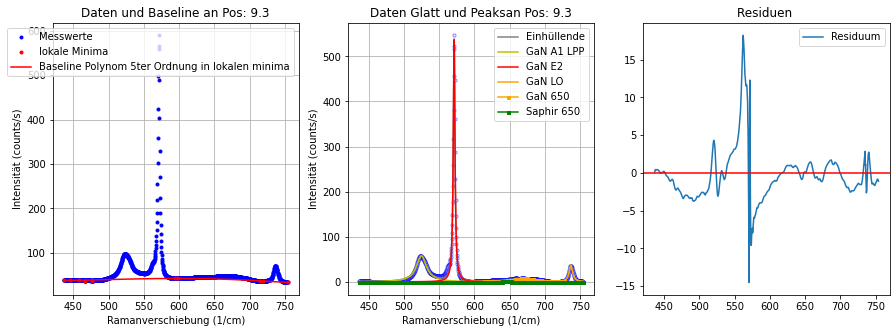

----------------------------------------------------------------------------------------------------
Position: 9.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [33.4914 33.6835 33.8355 ... 38.7339 38.6524 38.5739]
(1024,)
Hintergrund Parameter:  [ 5.67762123e-12 -1.48868996e-08  1.41375444e-05 -5.89831383e-03
  9.99934398e-01 -4.99485482e-04]
Fitparameter Saphir 418: [8.765589522742011e-20, 19.062524810971123, 415.0224214999185]
Fitparameter GaN A1 LPP 531: [57.798596425680785, 17.753258337774664, 524.9124133921189]
Fitparameter GaN E2 568: [516.7355852169321, 2.899692913320111, 571.1491478257238]
Fitparameter Saphir 650: [1.8647535306586571, 9.999999999999998, 653.9959361357618]
Fitparameter GaN 650: [6.899653317756454, 36.26862689899146, 669.9999999999999]
Fitparameter GaN LO 741: [33.57218331907306, 5.754107948705649, 736.6992436705573]
BILD an Pos:  9.4


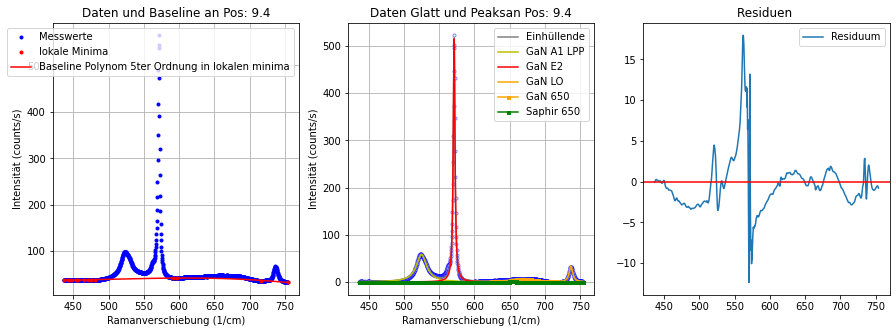

----------------------------------------------------------------------------------------------------
Position: 9.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [32.8138 32.766  32.7197 ... 38.7668 38.8525 38.9491]
(1024,)
Hintergrund Parameter:  [ 4.98661805e-12 -1.36328123e-08  1.33987670e-05 -5.75911713e-03
  9.99981628e-01 -3.37969154e-04]
Fitparameter Saphir 418: [0.0007628146283906734, 7.376230649454524e-07, 415.0000974047423]
Fitparameter GaN A1 LPP 531: [57.70951425506995, 17.87326520644125, 524.9596208301532]
Fitparameter GaN E2 568: [497.16653852759214, 2.935799669340485, 571.14809831186]
Fitparameter Saphir 650: [1.5508978239845355, 0.08990686403423667, 650.2083480550718]
Fitparameter GaN 650: [7.051226415281435, 36.92624830269676, 667.7575217542711]
Fitparameter GaN LO 741: [30.913077990898127, 5.648745895016898, 736.7025245647658]


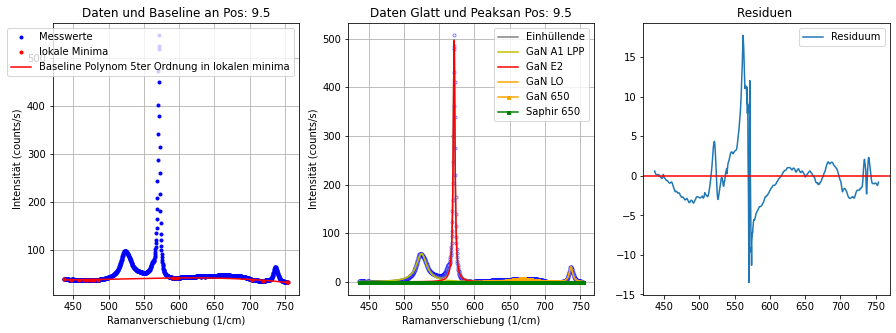

----------------------------------------------------------------------------------------------------
Position: 9.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [31.9353 32.0724 32.2021 ... 37.8411 37.8246 37.8274]
(1024,)
Hintergrund Parameter:  [ 4.96543596e-12 -1.36163991e-08  1.34059915e-05 -5.76651822e-03
  9.99999323e-01 -7.46928948e-06]
Fitparameter Saphir 418: [3.0275442074615024e-28, 0.011943381066815029, 419.2180226414081]
Fitparameter GaN A1 LPP 531: [57.596549471836, 17.65019153750714, 524.9812802377268]
Fitparameter GaN E2 568: [477.08730214977106, 2.9689755384193743, 571.1440176513022]
Fitparameter Saphir 650: [1.9688439059613874, 9.999999999999998, 645.000000395821]
Fitparameter GaN 650: [7.086168010008594, 34.26784981145544, 669.9999999999999]
Fitparameter GaN LO 741: [28.327921107750065, 5.750840510779487, 736.6973156715695]


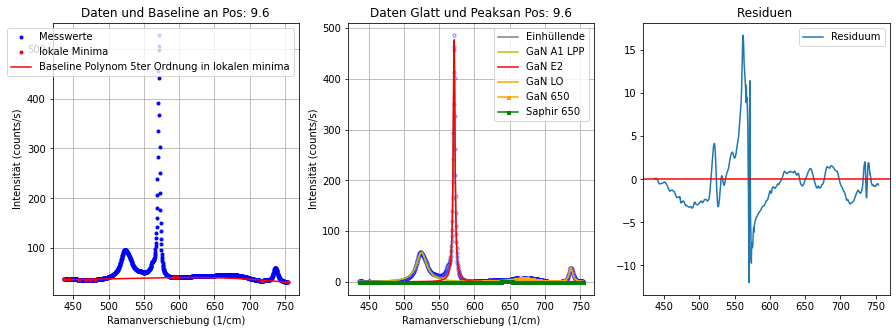

----------------------------------------------------------------------------------------------------
Position: 9.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [31.1643 31.2563 31.3736 ... 37.0487 36.9792 36.9073]
(1024,)
Hintergrund Parameter:  [ 5.01273255e-12 -1.37205059e-08  1.34858769e-05 -5.78918556e-03
  9.99989440e-01 -6.26059546e-04]
Fitparameter Saphir 418: [0.17939044536073823, 0.0037145589936301545, 415.00037498089995]
Fitparameter GaN A1 LPP 531: [56.99416534686485, 17.496138198283102, 524.9895614039209]
Fitparameter GaN E2 568: [449.09397175347016, 3.0198516672755353, 571.1352897164986]
Fitparameter Saphir 650: [6.339379299543244, 0.08404952457433824, 650.2087387429151]
Fitparameter GaN 650: [7.269622884518034, 40.2005853722095, 668.45245233924]
Fitparameter GaN LO 741: [24.54620284564698, 5.794412828989963, 736.7094811518729]


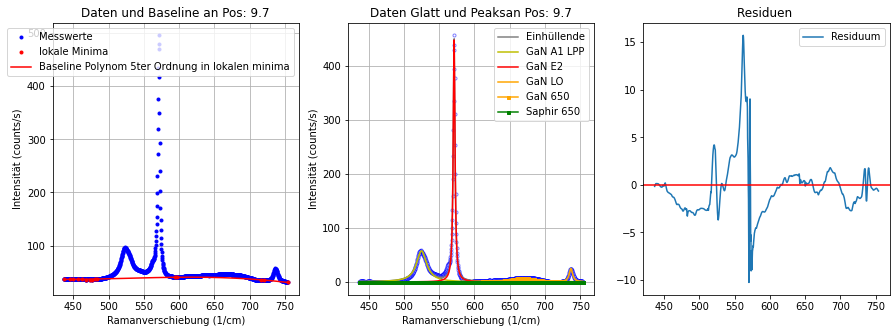

----------------------------------------------------------------------------------------------------
Position: 9.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [30.5391 30.4821 30.5274 ... 36.0581 36.0182 35.9682]
(1024,)
Hintergrund Parameter:  [ 5.46539492e-12 -1.45248405e-08  1.39675280e-05 -5.88987528e-03
  9.99999384e-01 -7.95199451e-06]
Fitparameter Saphir 418: [6.379362207184783e-14, 19.9005, 417.465752519612]
Fitparameter GaN A1 LPP 531: [54.63379713552112, 17.48499870140007, 525.0242475430288]
Fitparameter GaN E2 568: [423.0943173936691, 3.0348750031370124, 571.1282663762755]
Fitparameter Saphir 650: [1.827338887978388, 9.999999999999904, 645.0000013193096]
Fitparameter GaN 650: [7.304439158953683, 36.63688207678004, 669.9999999999999]
Fitparameter GaN LO 741: [21.778810239519494, 5.495907058954769, 736.6921904932912]


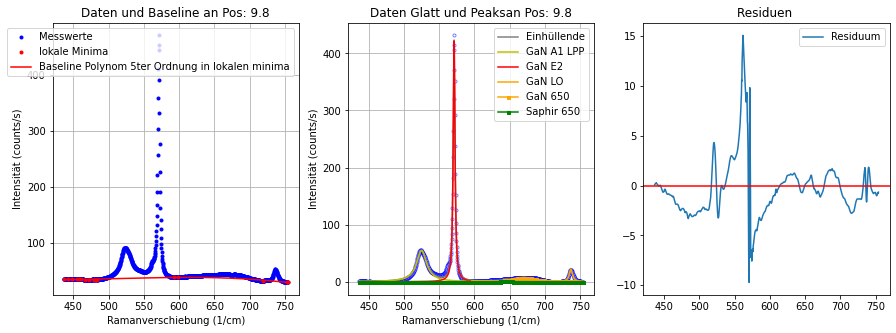

----------------------------------------------------------------------------------------------------
Position: 9.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [29.5351 29.6855 29.8185 ... 35.3824 35.3398 35.286 ]
(1024,)
Hintergrund Parameter:  [ 5.05110877e-12 -1.38646011e-08  1.36380122e-05 -5.84087670e-03
  9.99985000e-01 -3.19543201e-04]
Fitparameter Saphir 418: [1.1384354458083316e-08, 0.0550656303732886, 415.04766194214915]
Fitparameter GaN A1 LPP 531: [54.16860968652893, 17.28475602727382, 525.002682025181]
Fitparameter GaN E2 568: [412.03551423611225, 3.041697657251625, 571.122153596701]
Fitparameter Saphir 650: [1.6236847435167046, 9.99999999999994, 645.0006277938112]
Fitparameter GaN 650: [6.616828378904868, 33.57713387020226, 669.9999999999999]
Fitparameter GaN LO 741: [20.698907692226303, 5.557314597189832, 736.7252295018808]


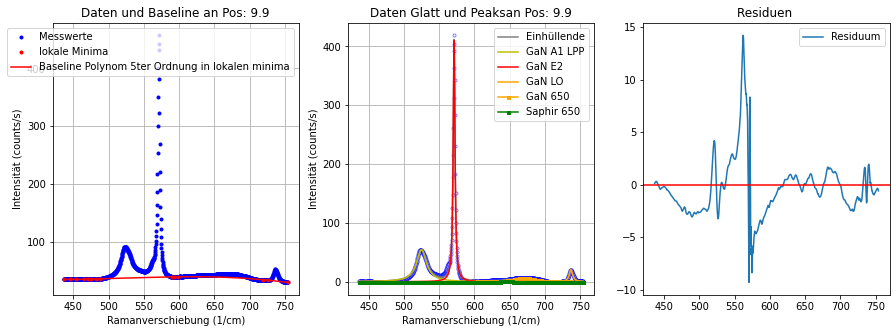

----------------------------------------------------------------------------------------------------
Position: 10.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [28.9071 29.1124 29.2944 ... 33.9146 33.7264 33.4414]
(1024,)
Hintergrund Parameter:  [ 6.05376408e-12 -1.55283774e-08  1.44580287e-05 -5.90788551e-03
  9.73134024e-01 -1.62815616e-01]
Fitparameter Saphir 418: [1.500584099785514e-21, 6.582890738905574, 429.94299064166614]
Fitparameter GaN A1 LPP 531: [52.18728693340047, 16.829238828219005, 525.0490822512626]
Fitparameter GaN E2 568: [386.4531815114119, 3.0661472343922576, 571.1251861168771]
Fitparameter Saphir 650: [1.3481335457723356, 9.999999988533297, 645.0000107881648]
Fitparameter GaN 650: [7.044585002532402, 37.645933083207545, 669.9999999999999]
Fitparameter GaN LO 741: [18.309840555547463, 5.484931533315004, 736.7106190206373]


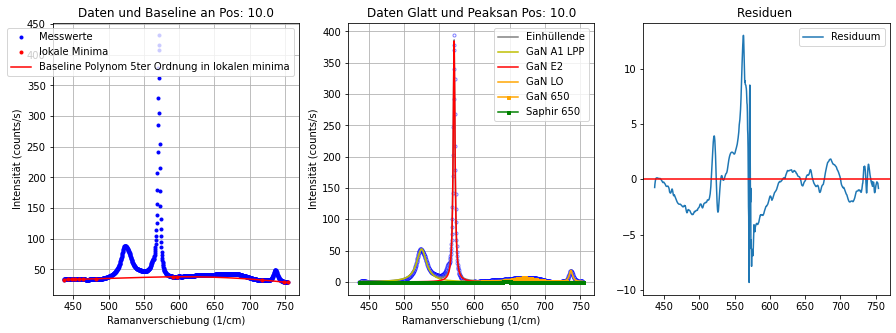

----------------------------------------------------------------------------------------------------
Position: 10.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [26.6998 26.7701 26.8849 ... 31.9113 31.8412 31.7029]
(1024,)
Hintergrund Parameter:  [ 4.81744761e-12 -1.34414593e-08  1.34240194e-05 -5.82442182e-03
  9.99999987e-01 -5.75085316e-07]
Fitparameter Saphir 418: [1.6156512414731187e-57, 11.514696002636784, 415.074626875]
Fitparameter GaN A1 LPP 531: [48.98186899025964, 17.613651129756875, 525.0949773761705]
Fitparameter GaN E2 568: [357.77753564236116, 3.0944611522645653, 571.1168290472757]
Fitparameter Saphir 650: [1.5462980561966324, 9.999999999999984, 645.0000130795704]
Fitparameter GaN 650: [6.05590956264076, 35.10502945457755, 669.9999999999999]
Fitparameter GaN LO 741: [16.350020942813387, 5.358606654824244, 736.7527848592814]


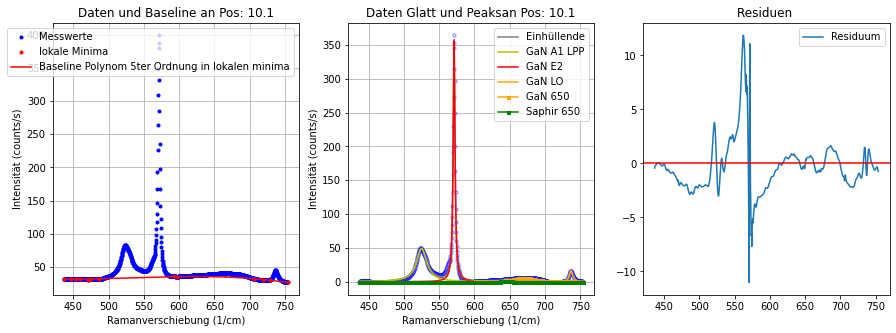

----------------------------------------------------------------------------------------------------
Position: 10.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [26.4311 26.5112 26.5982 ... 31.1691 31.1079 31.0662]
(1024,)
Hintergrund Parameter:  [ 5.39791997e-12 -1.44590042e-08  1.40156438e-05 -5.94133573e-03
  9.99928819e-01 -3.35666526e-04]
Fitparameter Saphir 418: [1.2196172323403226e-16, 19.923125207421236, 424.6607350478308]
Fitparameter GaN A1 LPP 531: [47.71223423538126, 17.473733001434677, 525.0848509089766]
Fitparameter GaN E2 568: [345.53192640873306, 3.0901705898871485, 571.117275336044]
Fitparameter Saphir 650: [1.687084730460815, 9.99999999999986, 645.0000089667285]
Fitparameter GaN 650: [6.422700765982265, 37.64363506052112, 669.9999999999999]
Fitparameter GaN LO 741: [15.526423823320162, 5.270149933888127, 736.7680103895998]


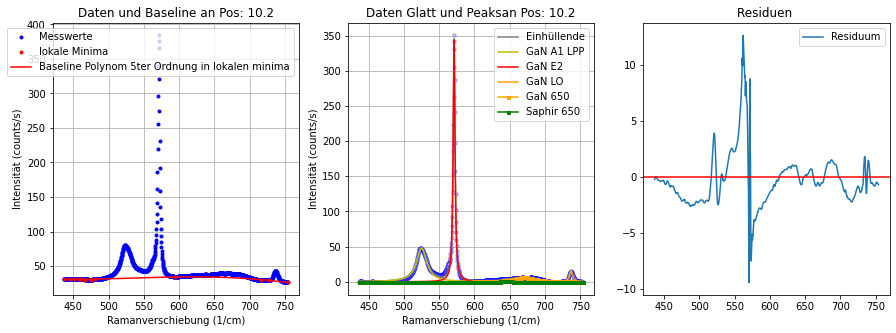

----------------------------------------------------------------------------------------------------
Position: 10.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [25.4367 25.4487 25.5509 ... 29.809  29.8223 29.8332]
(1024,)
Hintergrund Parameter:  [ 5.49969200e-12 -1.46509450e-08  1.41517394e-05 -5.98052745e-03
  9.99999996e-01 -1.07961229e-06]
Fitparameter Saphir 418: [3.718876522529679e-30, 3.6896541264379907, 420.5882496737337]
Fitparameter GaN A1 LPP 531: [44.60671255181042, 17.334367552719044, 525.116916061082]
Fitparameter GaN E2 568: [315.3996823637904, 3.1181928269858603, 571.1127865689516]
Fitparameter Saphir 650: [1.4291951045263072, 9.999999999999122, 645.000000003278]
Fitparameter GaN 650: [5.925068049439665, 38.319080376227355, 669.9999999999999]
Fitparameter GaN LO 741: [13.39889857594282, 5.256290211690075, 736.7606208353708]


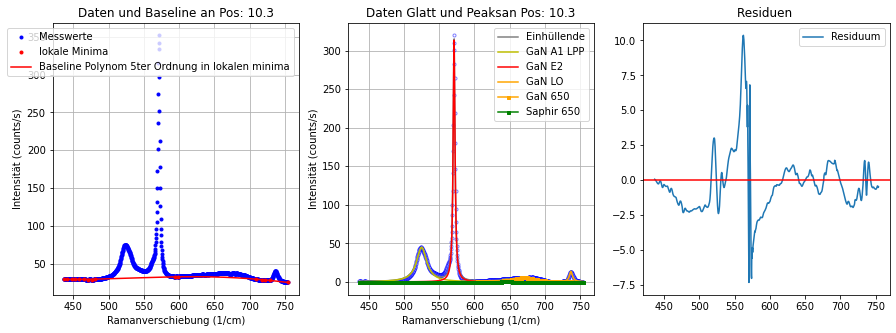

----------------------------------------------------------------------------------------------------
Position: 10.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [23.862  23.8998 23.9433 ... 27.5412 27.5108 27.4808]
(1024,)
Hintergrund Parameter:  [ 5.17709428e-12 -1.41360116e-08  1.39150323e-05 -5.95933238e-03
  1.00000000e+00 -9.37749098e-10]
Fitparameter Saphir 418: [1.5096328604981888e-17, 0.5435283606363225, 429.95807367752445]
Fitparameter GaN A1 LPP 531: [42.33878423068352, 17.506753665222575, 525.1590017512748]
Fitparameter GaN E2 568: [296.74949805826475, 3.130324383524442, 571.1100282018106]
Fitparameter Saphir 650: [1.3374865865866228, 9.999503198115685, 645.0190423255572]
Fitparameter GaN 650: [5.283115570668611, 32.464074814669104, 669.9999953879806]
Fitparameter GaN LO 741: [12.879667349542405, 5.064746774319391, 736.8212495123886]


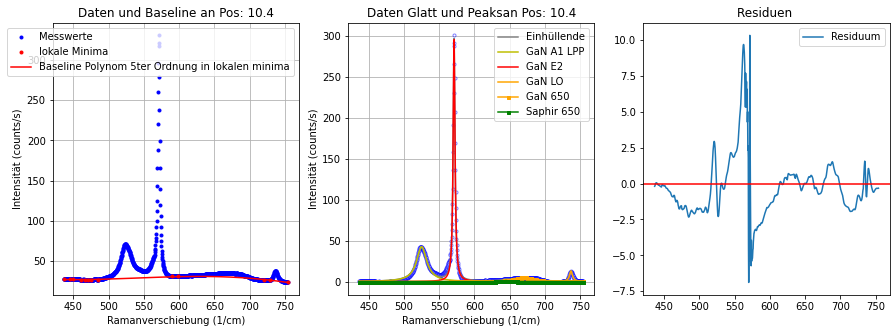

----------------------------------------------------------------------------------------------------
Position: 10.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [23.5137 23.6722 23.7781 ... 27.3276 27.3681 27.4188]
(1024,)
Hintergrund Parameter:  [ 4.91693765e-12 -1.36488684e-08  1.36189204e-05 -5.90208976e-03
  1.00000000e+00 -6.90629178e-09]
Fitparameter Saphir 418: [6.94836426804914e-13, 8.955506205651831, 415.075]
Fitparameter GaN A1 LPP 531: [40.59234608558177, 17.575666065401265, 525.1669757353908]
Fitparameter GaN E2 568: [284.8658671711348, 3.1329564900501685, 571.1124295873907]
Fitparameter Saphir 650: [1.2133383205506985, 9.999999998556559, 645.0000046407383]
Fitparameter GaN 650: [5.002834515401168, 34.71954571743128, 669.9999999999999]
Fitparameter GaN LO 741: [11.872829889979748, 5.228184665943681, 736.8012152449238]


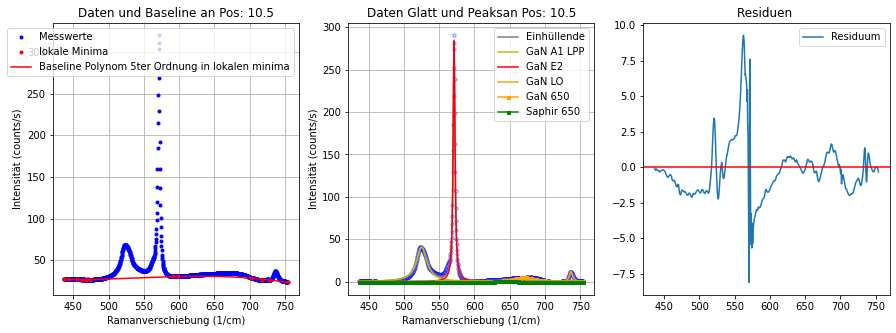

----------------------------------------------------------------------------------------------------
Position: 10.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [21.382  21.4822 21.5599 ... 24.5322 24.6076 24.6125]
(1024,)
Hintergrund Parameter:  [ 6.19954696e-12 -1.59652889e-08  1.50170640e-05 -6.19232297e-03
  9.99805298e-01 -4.12571027e-03]
Fitparameter Saphir 418: [4.7124707762444564e-27, 18.173768325029332, 415.075]
Fitparameter GaN A1 LPP 531: [36.88864154516726, 17.086161054176745, 525.124833755943]
Fitparameter GaN E2 568: [257.7225127055645, 3.130162690276973, 571.1073382434324]
Fitparameter Saphir 650: [1.0453722358415065, 9.999999999961602, 645.0000001237258]
Fitparameter GaN 650: [5.246340689992513, 37.29174122800963, 669.9999999999999]
Fitparameter GaN LO 741: [11.133708072719145, 5.153648657980326, 736.7305434515686]


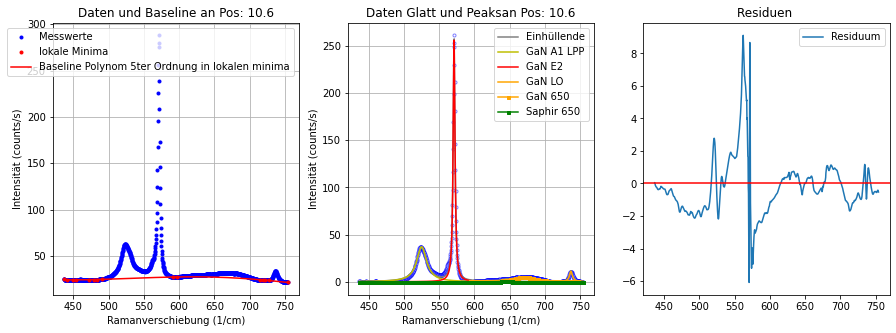

----------------------------------------------------------------------------------------------------
Position: 10.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [20.236  20.2882 20.3925 ... 23.2009 23.172  23.1782]
(1024,)
Hintergrund Parameter:  [ 6.16993338e-12 -1.59149496e-08  1.50055109e-05 -6.20161313e-03
  9.99999477e-01 -7.07577722e-06]
Fitparameter Saphir 418: [4.106902242961231e-28, 19.919753072657862, 420.3587763430715]
Fitparameter GaN A1 LPP 531: [34.70802545738483, 16.868456694778178, 525.0855507168831]
Fitparameter GaN E2 568: [241.48624936422917, 3.1451347868691863, 571.1045991149684]
Fitparameter Saphir 650: [1.0067916659154383, 9.999999999992975, 645.0000001318846]
Fitparameter GaN 650: [4.8957415337130135, 38.313642654742694, 669.9999999999999]
Fitparameter GaN LO 741: [10.296417869311146, 5.091868687896871, 736.7287484119661]


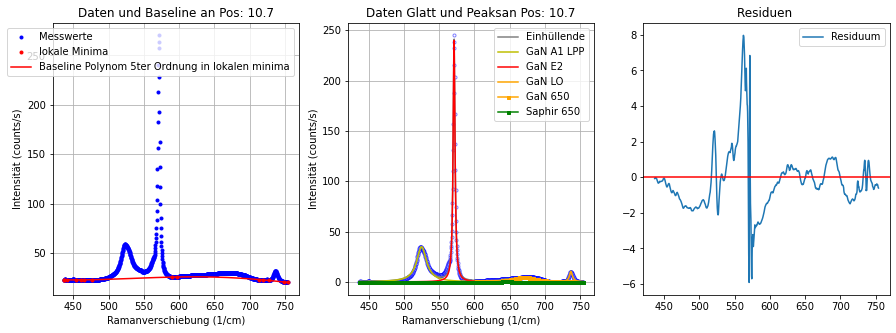

----------------------------------------------------------------------------------------------------
Position: 10.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [18.8407 18.8439 18.8504 ... 20.9455 20.9299 20.9194]
(1024,)
Hintergrund Parameter:  [ 6.08641624e-12 -1.58121663e-08  1.49994424e-05 -6.22247544e-03
  9.99981141e-01 -3.05058029e-04]
Fitparameter Saphir 418: [5.8035056217005e-38, 0.004988103407670197, 415.075]
Fitparameter GaN A1 LPP 531: [30.876461419332912, 17.159181477777782, 525.1369597725235]
Fitparameter GaN E2 568: [218.38417466822662, 3.1002661829892695, 571.1073669035529]
Fitparameter Saphir 650: [0.8087707658583935, 9.99999999999998, 645.0000339629613]
Fitparameter GaN 650: [4.027352044384128, 34.699233633140956, 669.9999999999999]
Fitparameter GaN LO 741: [9.191338521318784, 5.065123632248387, 736.8420731504608]


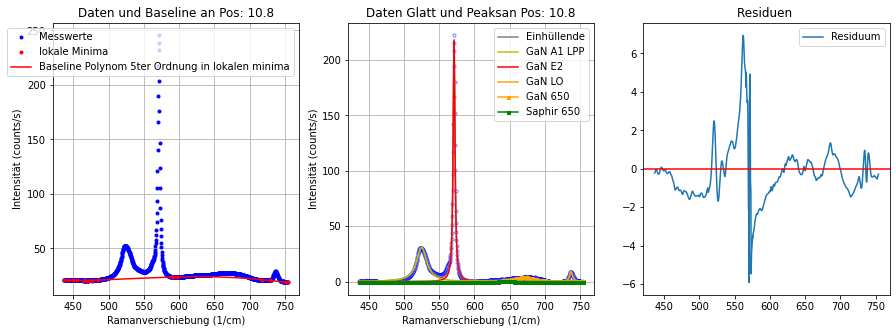

----------------------------------------------------------------------------------------------------
Position: 10.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [17.6395 18.015  18.1053 ... 19.6615 19.6363 19.606 ]
(1024,)
Hintergrund Parameter:  [ 6.43437418e-12 -1.64363603e-08  1.53778778e-05 -6.30379333e-03
  9.99999377e-01 -5.75390427e-06]
Fitparameter Saphir 418: [2.0368286475769074e-16, 0.03678793768693822, 423.22010284502187]
Fitparameter GaN A1 LPP 531: [29.729760413239976, 17.050823848486015, 525.126558137756]
Fitparameter GaN E2 568: [206.5027683954984, 3.1387393715902143, 571.1059587598219]
Fitparameter Saphir 650: [0.8233393008141987, 9.9999997188812, 645.0000053359277]
Fitparameter GaN 650: [4.1584558020865225, 38.801865758043235, 669.9999999999999]
Fitparameter GaN LO 741: [8.755795356766765, 5.369425628832785, 736.7951472843903]


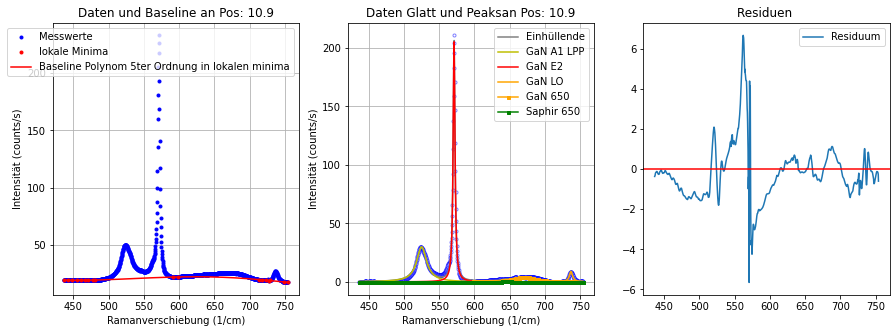

----------------------------------------------------------------------------------------------------
Position: 11.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [16.5918 16.6767 16.7626 ... 18.4684 18.4408 18.4345]
(1024,)
Hintergrund Parameter:  [ 5.56008916e-12 -1.44936441e-08  1.38709363e-05 -5.87057768e-03
  9.96412100e-01 -1.34604506e+01]
Fitparameter Saphir 418: [3.4467056470431288e-18, 5.197526247093757, 418.2326037625028]
Fitparameter GaN A1 LPP 531: [26.931644694080788, 16.954129047265766, 525.1184186417587]
Fitparameter GaN E2 568: [189.78885758065888, 3.117540139728524, 571.1065655270478]
Fitparameter Saphir 650: [0.7322526492312041, 9.999999987612126, 645.000000019059]
Fitparameter GaN 650: [3.5844492205037155, 36.63197822889842, 669.9999999999999]
Fitparameter GaN LO 741: [8.166967466506252, 5.468474997245123, 736.7689247771103]


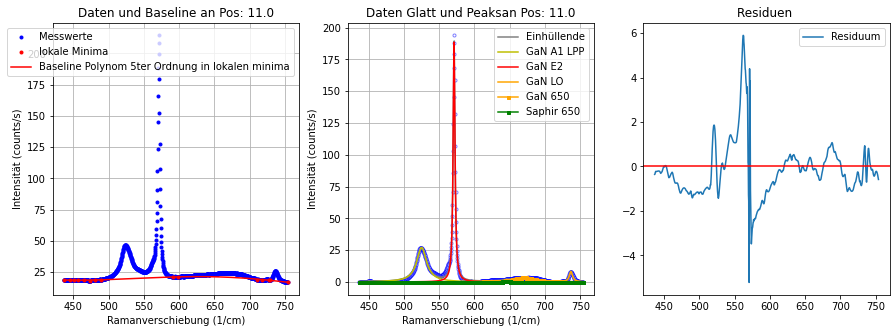

----------------------------------------------------------------------------------------------------
Position: 11.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [14.9705 15.1075 15.1645 ... 16.7691 16.7804 16.7482]
(1024,)
Hintergrund Parameter:  [ 6.64120831e-12 -1.68274845e-08  1.56534883e-05 -6.38275228e-03
  9.99977373e-01 -4.15485494e-04]
Fitparameter Saphir 418: [7.63513806578731e-24, 0.019401995703745456, 421.5914323182548]
Fitparameter GaN A1 LPP 531: [24.249139635078826, 17.11452671706854, 525.1294511587251]
Fitparameter GaN E2 568: [172.55020926652054, 3.1041003327869503, 571.1234569956592]
Fitparameter Saphir 650: [0.6067389900105724, 9.999990622028571, 645.0000062440675]
Fitparameter GaN 650: [3.5038794540335645, 38.282565910164, 669.9999999999999]
Fitparameter GaN LO 741: [7.973081894575252, 5.381944171761724, 736.7759383546518]


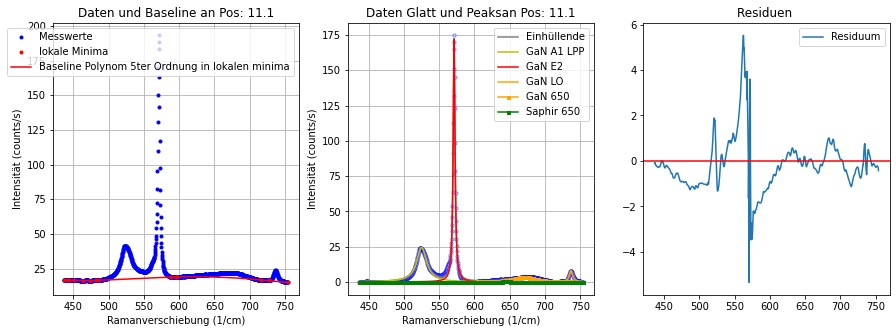

----------------------------------------------------------------------------------------------------
Position: 11.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [14.4918 14.567  14.6453 ... 15.6919 15.6289 15.6064]
(1024,)
Hintergrund Parameter:  [ 6.75208894e-12 -1.70281608e-08  1.57832714e-05 -6.41458133e-03
  9.99995856e-01 -4.40549357e-04]
Fitparameter Saphir 418: [6.0252049722466265e-09, 0.0004436497186052213, 415.00081063713435]
Fitparameter GaN A1 LPP 531: [22.841206382422758, 17.022247812019422, 525.0505986745778]
Fitparameter GaN E2 568: [163.91807561656088, 3.080339780673172, 571.1155889360887]
Fitparameter Saphir 650: [0.22986089898701526, 0.0021350789921948474, 648.6796248326167]
Fitparameter GaN 650: [3.0426028822134374, 39.8532300468118, 669.9995997775635]
Fitparameter GaN LO 741: [7.305120783155882, 5.288250389297432, 736.7716243003555]


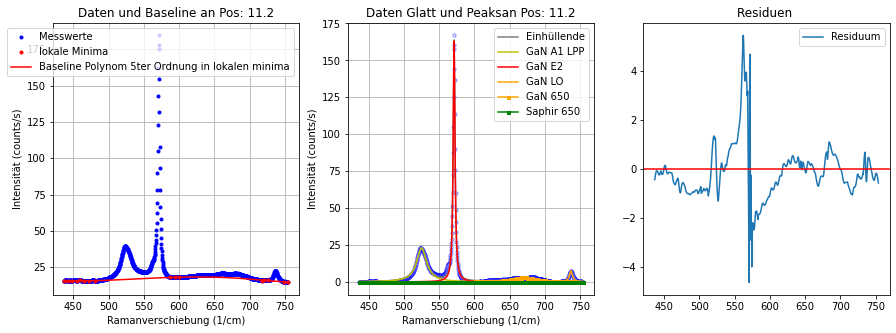

----------------------------------------------------------------------------------------------------
Position: 11.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [13.5296 13.537  13.6092 ... 14.3809 14.3421 14.2946]
(1024,)
Hintergrund Parameter:  [ 6.25270898e-12 -1.57977294e-08  1.47493955e-05 -6.10173950e-03
  9.99999596e-01 -1.17678230e+01]
Fitparameter Saphir 418: [3.887674978703639e-13, 16.11028883813817, 429.96999735085814]
Fitparameter GaN A1 LPP 531: [20.31796100678576, 17.208724061714257, 525.0544197388542]
Fitparameter GaN E2 568: [146.98971864374622, 3.098080028835401, 571.1109406824158]
Fitparameter Saphir 650: [0.6418471659081988, 0.006507271847769962, 649.8760857832532]
Fitparameter GaN 650: [3.0064777900244786, 41.62321807477877, 669.9994196728904]
Fitparameter GaN LO 741: [6.87452899380334, 5.062448999523916, 736.7555740144888]


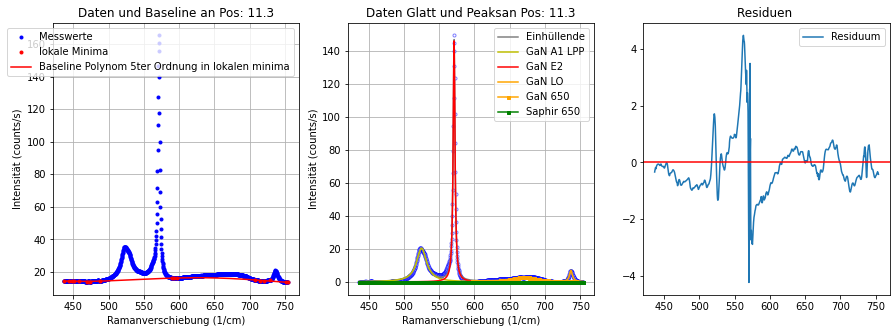

----------------------------------------------------------------------------------------------------
Position: 11.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [12.6564 12.8686 13.0119 ... 13.4669 13.4998 13.5152]
(1024,)
Hintergrund Parameter:  [ 6.25182555e-12 -1.57659668e-08  1.46960141e-05 -6.07312473e-03
  9.96594688e-01 -1.34871818e+01]
Fitparameter Saphir 418: [7.886138320818399e-23, 19.933359457128475, 426.13686130149057]
Fitparameter GaN A1 LPP 531: [19.71700171159382, 16.91415489840135, 525.1001349579393]
Fitparameter GaN E2 568: [142.52448613470872, 3.077033724163906, 571.1150737974917]
Fitparameter Saphir 650: [0.4930973747865838, 9.99999999998824, 645.0000001030581]
Fitparameter GaN 650: [2.789043855171921, 37.75923548828394, 669.9999999999999]
Fitparameter GaN LO 741: [6.657663751951441, 5.259446678078872, 736.6482661057958]


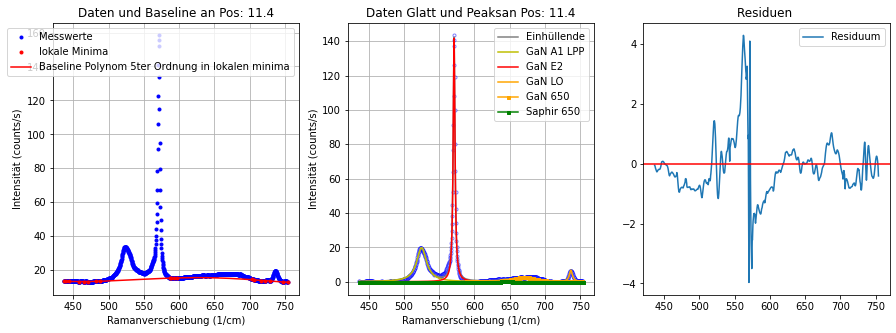

----------------------------------------------------------------------------------------------------
Position: 11.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [11.7321 11.8538 11.9982 ... 12.7348 12.7754 12.829 ]
(1024,)
Hintergrund Parameter:  [ 5.51069596e-12 -1.40757307e-08  1.32133546e-05 -5.43654583e-03
  8.55396763e-01 -6.33896361e-07]
Fitparameter Saphir 418: [1.2259312538940234e-20, 8.50355114559316, 423.69326161054096]
Fitparameter GaN A1 LPP 531: [17.66943749343849, 17.40426988621854, 525.0358772360066]
Fitparameter GaN E2 568: [129.91806951375335, 3.0882056472771815, 571.1086671686694]
Fitparameter Saphir 650: [0.49899580028693263, 9.999999999999904, 652.9900510818102]
Fitparameter GaN 650: [2.3526023556723907, 37.96711487254408, 669.9999999999999]
Fitparameter GaN LO 741: [6.318026841831683, 5.714894414498348, 736.7943350814181]


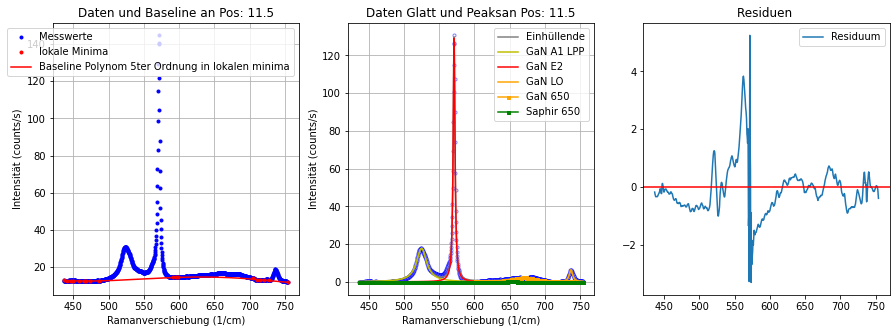

----------------------------------------------------------------------------------------------------
Position: 11.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [10.9813 11.12   11.2745 ... 11.928  12.0003 12.0889]
(1024,)
Hintergrund Parameter:  [ 5.83892333e-12 -1.46714019e-08  1.35873491e-05 -5.52615591e-03
  8.58914050e-01 -1.37018546e-06]
Fitparameter Saphir 418: [5.486349171797885e-11, 9.036367373482793, 419.21685768284914]
Fitparameter GaN A1 LPP 531: [16.506204783550615, 17.492395284267914, 525.0880341836859]
Fitparameter GaN E2 568: [122.04985099182906, 3.057892758046411, 571.1222902515076]
Fitparameter Saphir 650: [0.4395378058954182, 9.999999999390166, 645.0000000001432]
Fitparameter GaN 650: [2.3437820631093467, 40.105288656378676, 669.9999999999999]
Fitparameter GaN LO 741: [6.113789177565392, 5.481012067728231, 736.7506933498861]


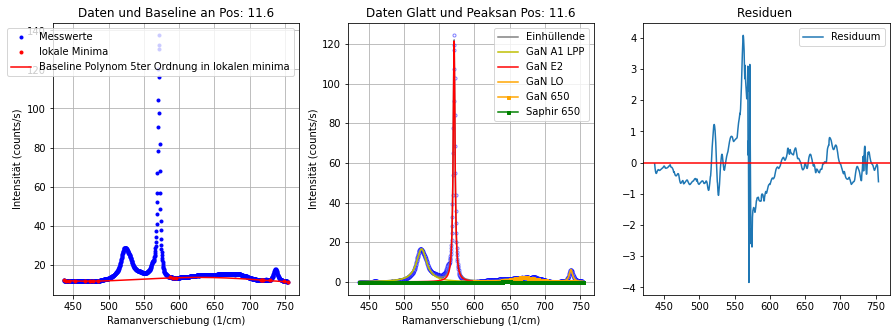

----------------------------------------------------------------------------------------------------
Position: 11.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [10.6815 10.7278 10.7311 ... 11.0796 11.1231 11.1727]
(1024,)
Hintergrund Parameter:  [ 3.93061201e-12 -9.71815666e-09  8.84481118e-06 -3.54069876e-03
  5.50836627e-01 -4.36007929e-06]
Fitparameter Saphir 418: [7.2462961007503985e-31, 0.0041002871249151696, 415.0648793411667]
Fitparameter GaN A1 LPP 531: [14.60485978081717, 16.673225462251747, 525.0340163796918]
Fitparameter GaN E2 568: [111.71254384793257, 3.0422339784462413, 571.1187373129501]
Fitparameter Saphir 650: [0.2635362422030126, 9.999999974752022, 645.0000637307634]
Fitparameter GaN 650: [2.2748269049129823, 41.23614242625849, 669.9999999999999]
Fitparameter GaN LO 741: [5.584688631830182, 5.385152217971109, 736.7781964368878]


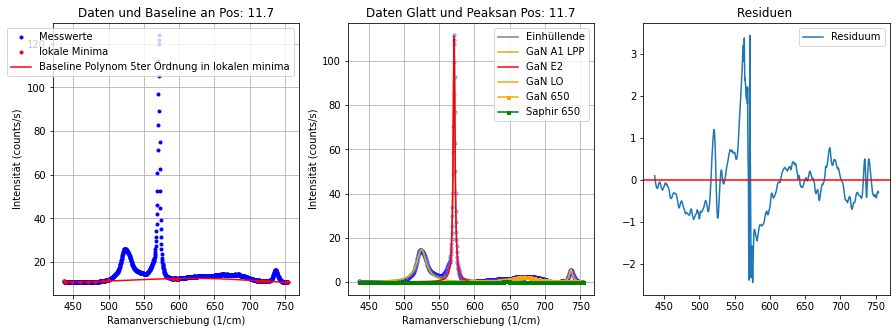

----------------------------------------------------------------------------------------------------
Position: 11.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [9.45878 9.40965 9.37234 ... 9.66203 9.64329 9.6223 ]
(1024,)
Hintergrund Parameter:  [ 4.26304705e-12 -1.05359353e-08  9.59983852e-06 -3.84624670e-03
  5.93348688e-01 -4.16784000e-07]
Fitparameter Saphir 418: [7.049455670961499e-16, 12.69710886153243, 423.81929945598625]
Fitparameter GaN A1 LPP 531: [12.979659061266283, 17.071787466604235, 525.0449412476347]
Fitparameter GaN E2 568: [99.33467864390995, 3.0489354965478377, 571.1101248174224]
Fitparameter Saphir 650: [0.4288583376178557, 9.999999999971426, 645.0000000051392]
Fitparameter GaN 650: [2.0900196153122605, 41.804441769783466, 669.9999999999999]
Fitparameter GaN LO 741: [5.212997840422861, 5.666032303213529, 736.747243017149]


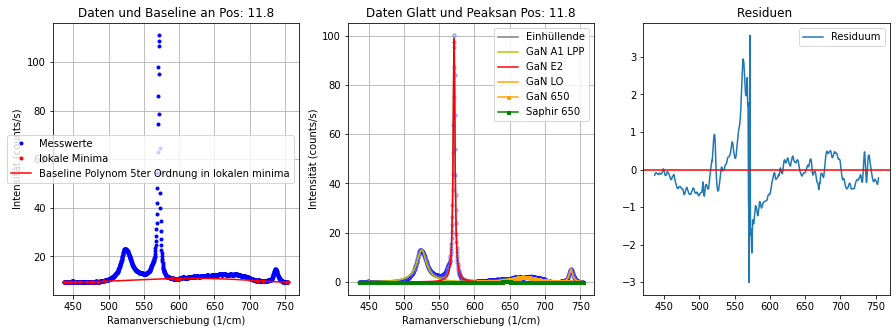

----------------------------------------------------------------------------------------------------
Position: 11.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [9.31776 9.3532  9.37207 ... 9.32181 9.32582 9.32717]
(1024,)
Hintergrund Parameter:  [ 2.39580443e-12 -6.09548891e-09  5.69066730e-06 -2.33498713e-03
  3.76220368e-01 -4.01320634e-06]
Fitparameter Saphir 418: [2.469429017271409, 2.0849894943301893e-05, 415.0750000000628]
Fitparameter GaN A1 LPP 531: [12.10539332283428, 17.03172588791565, 525.0285512630843]
Fitparameter GaN E2 568: [95.81619657385376, 2.9817152343636897, 571.1282243532629]
Fitparameter Saphir 650: [1.1695632324166152, 0.0005288374766985953, 651.2336069699375]
Fitparameter GaN 650: [1.7509576694452258, 41.02293704873985, 668.8248612028518]
Fitparameter GaN LO 741: [4.933027292268406, 5.126724863437095, 736.7615762051439]


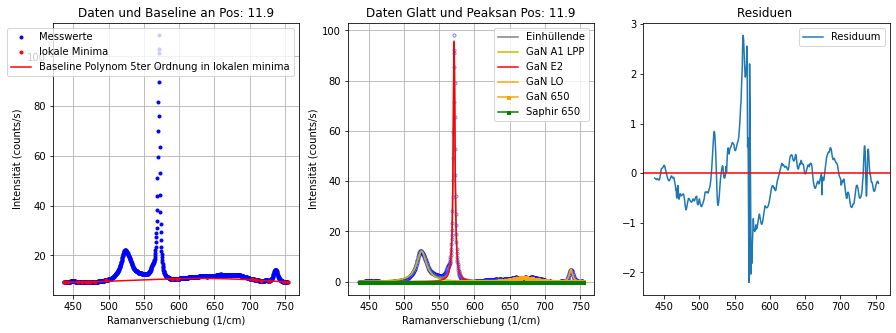

----------------------------------------------------------------------------------------------------
Position: 12.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [8.38647 8.40525 8.40655 ... 8.46468 8.4263  8.39282]
(1024,)
Hintergrund Parameter:  [ 4.33562659e-12 -1.12227203e-08  1.09559307e-05 -4.94941881e-03
  9.99999997e-01 -5.75028641e+01]
Fitparameter Saphir 418: [1.1374280451661443e-12, 19.933223478423194, 428.0287939619241]
Fitparameter GaN A1 LPP 531: [11.061149009811112, 16.668915827729162, 524.9357814723803]
Fitparameter GaN E2 568: [87.32145205429292, 2.9849344821670134, 571.1366803592352]
Fitparameter Saphir 650: [0.43052561545484314, 9.999999982176558, 645.0000008469506]
Fitparameter GaN 650: [1.5906900539931084, 36.48839179384986, 669.9999999999999]
Fitparameter GaN LO 741: [4.701774667605585, 5.738912629329507, 736.765346736642]


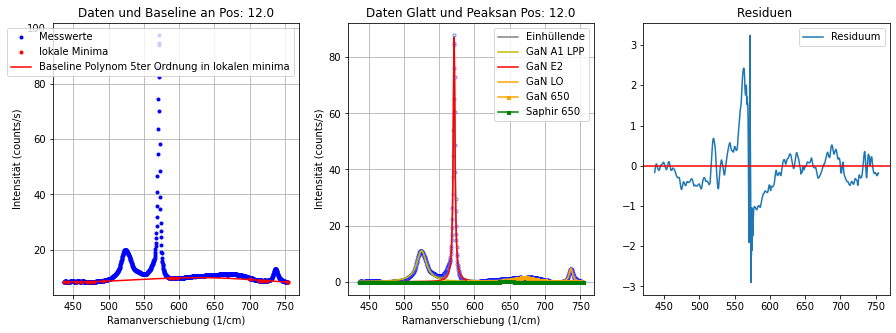

----------------------------------------------------------------------------------------------------
Position: 12.1
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [7.86073 7.97423 8.07276 ... 8.24041 8.19983 8.07116]
(1024,)
Hintergrund Parameter:  [ 2.41708701e-12 -6.18553967e-09  5.82027152e-06 -2.40758975e-03
  3.87293500e-01 -3.81362527e-07]
Fitparameter Saphir 418: [1.0175201993815133e-18, 4.684327652263666, 415.0730873972494]
Fitparameter GaN A1 LPP 531: [10.45138866680053, 17.42426391467837, 525.0167661550933]
Fitparameter GaN E2 568: [82.50914787011457, 3.010047901573532, 571.1292896033044]
Fitparameter Saphir 650: [1.8696194994068958, 0.04252857160470788, 649.9113137000045]
Fitparameter GaN 650: [1.5749009781003966, 45.303156109741465, 668.709329450772]
Fitparameter GaN LO 741: [4.485524529087852, 5.439519858621136, 736.7369429142786]


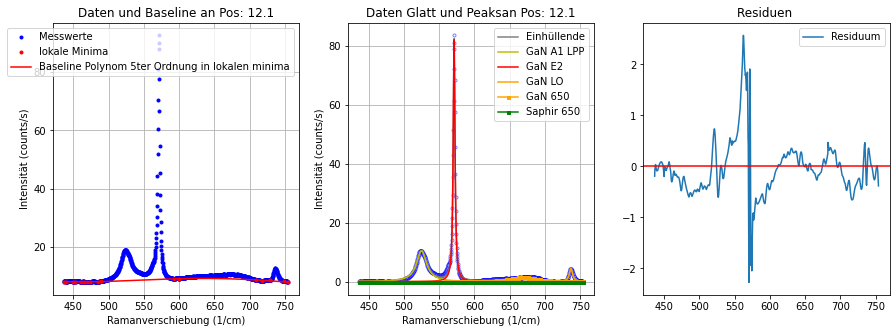

----------------------------------------------------------------------------------------------------
Position: 12.2
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [7.88552 7.84431 7.8068  ... 7.67923 7.66467 7.68829]
(1024,)
Hintergrund Parameter:  [ 2.89314965e-12 -7.17504300e-09  6.56834377e-06 -2.64908359e-03
  4.14171067e-01 -6.08850023e-07]
Fitparameter Saphir 418: [52.947424203131845, 1.086273156061766e-11, 415.10809105936875]
Fitparameter GaN A1 LPP 531: [9.49753828084135, 17.14616868987941, 524.9069759018402]
Fitparameter GaN E2 568: [77.13130656045706, 2.9995705020743375, 571.1346730202195]
Fitparameter Saphir 650: [0.633715016550312, 1.5759908344927974e-11, 650.756879035595]
Fitparameter GaN 650: [1.4522599188516494, 45.389633316037575, 667.8105961848764]
Fitparameter GaN LO 741: [3.963651950496206, 5.611396681474318, 736.7211147174789]


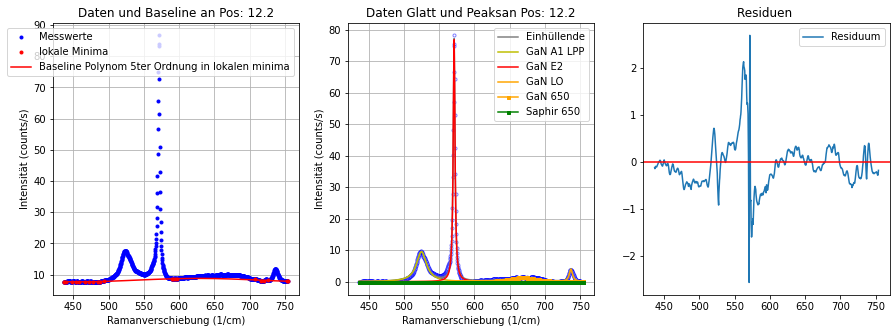

----------------------------------------------------------------------------------------------------
Position: 12.3
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [7.19873 7.22932 7.24055 ... 7.32941 7.32586 7.30096]
(1024,)
Hintergrund Parameter:  [ 3.47133576e-12 -8.64152861e-09  7.93344341e-06 -3.20011739e-03
  4.94448553e-01 -2.20186286e-07]
Fitparameter Saphir 418: [133.07406376768097, 3.3634992221786374e-10, 429.925]
Fitparameter GaN A1 LPP 531: [9.110949024545576, 16.680694778483442, 524.89608768672]
Fitparameter GaN E2 568: [71.76679716063266, 2.974346016291611, 571.1462925237923]
Fitparameter Saphir 650: [0.048716068716543895, 0.00047234178817824086, 649.9291325683961]
Fitparameter GaN 650: [1.2303846485833367, 39.36784735726424, 669.9950234061728]
Fitparameter GaN LO 741: [4.19010982295296, 5.653361182422084, 736.6801380279026]


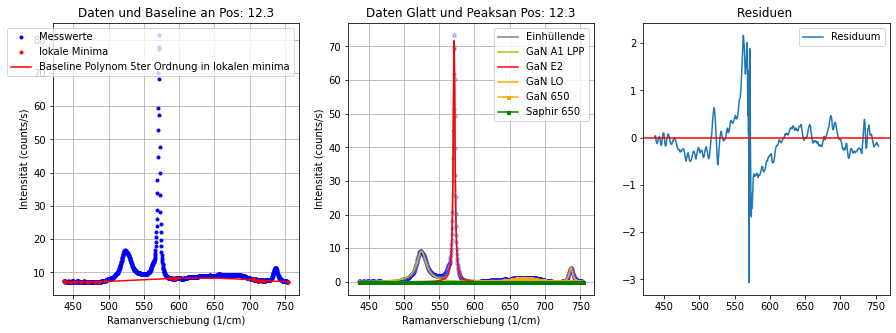

----------------------------------------------------------------------------------------------------
Position: 12.4
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [6.97713 6.91975 6.9747  ... 7.02693 7.04131 7.05713]
(1024,)
Hintergrund Parameter:  [ 4.07187822e-12 -1.06176538e-08  1.04473577e-05 -4.74546542e-03
  9.53098522e-01 -5.27216133e+01]
Fitparameter Saphir 418: [1.7648177313189022e-25, 2.9083622320593685, 415.075]
Fitparameter GaN A1 LPP 531: [8.548793619667126, 17.31836571465588, 525.009745423579]
Fitparameter GaN E2 568: [68.22130801686671, 3.007687543067901, 571.1467538286868]
Fitparameter Saphir 650: [0.286898213332294, 9.99999993431816, 645.0000017030626]
Fitparameter GaN 650: [1.1241098355894654, 36.18281547622482, 669.9999999999999]
Fitparameter GaN LO 741: [3.8970257383181184, 5.713873503215294, 736.9242958651826]


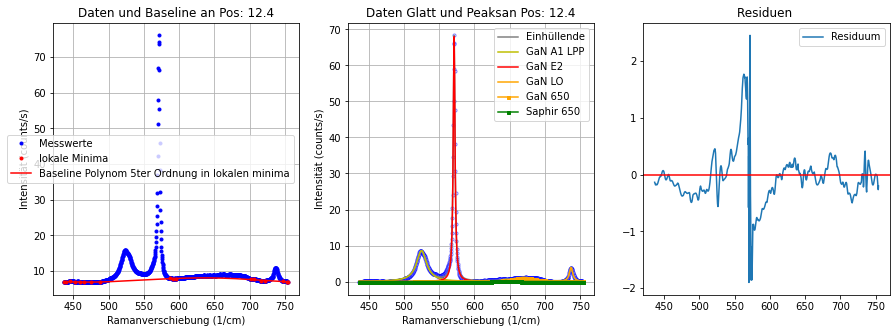

----------------------------------------------------------------------------------------------------
Position: 12.5
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [6.60806 6.62507 6.677   ... 6.68524 6.6008  6.46885]
(1024,)
Hintergrund Parameter:  [ 3.50093686e-12 -9.35966389e-09  9.52201844e-06 -4.54957608e-03
  1.00000000e+00 -7.06858218e+01]
Fitparameter Saphir 418: [6.215180582049387e-32, 11.373096321109616, 415.075]
Fitparameter GaN A1 LPP 531: [8.079078747894402, 17.593805744001433, 525.0314869975138]
Fitparameter GaN E2 568: [64.78713043488195, 2.996977313275538, 571.132161442941]
Fitparameter Saphir 650: [0.2919777234007725, 9.99999860319466, 645.0000035945935]
Fitparameter GaN 650: [1.1665406191800138, 38.545366920256114, 669.9999999996378]
Fitparameter GaN LO 741: [3.821090086065472, 5.8220075509296265, 736.7641425200364]


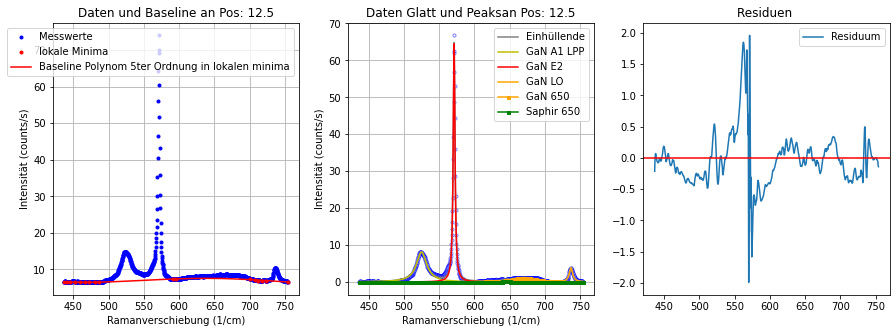

----------------------------------------------------------------------------------------------------
Position: 12.6
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [6.61168 6.60499 6.62255 ... 6.35917 6.31653 6.28761]
(1024,)
Hintergrund Parameter:  [ 3.49541330e-12 -9.18262661e-09  9.25662400e-06 -4.43736995e-03
  9.99999999e-01 -7.64754124e+01]
Fitparameter Saphir 418: [2.8814964469359454e-14, 19.644618685743794, 429.9944897289532]
Fitparameter GaN A1 LPP 531: [7.518191478859526, 17.34169412864395, 525.0243420517229]
Fitparameter GaN E2 568: [63.1787526217166, 2.9131161565471166, 571.1364787040726]
Fitparameter Saphir 650: [0.2713584032018156, 0.0023665971128314527, 649.9798573120913]
Fitparameter GaN 650: [1.2502001374750873, 48.529486057167254, 668.5841548486561]
Fitparameter GaN LO 741: [3.5710356625539736, 5.587409564204444, 736.8979315257606]


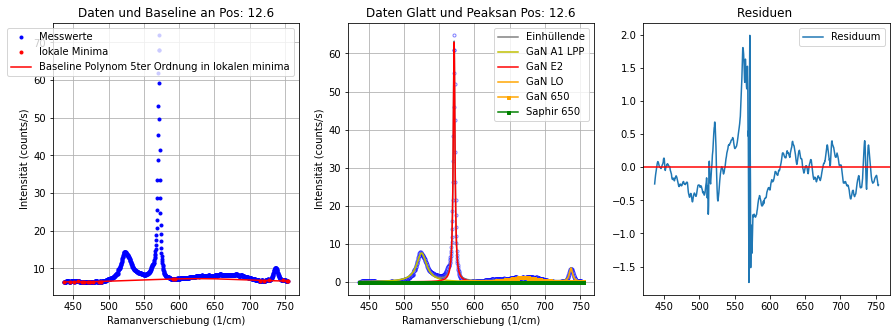

----------------------------------------------------------------------------------------------------
Position: 12.7
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [6.10224 6.12488 6.14959 ... 6.06623 6.07323 6.03554]
(1024,)
Hintergrund Parameter:  [ 2.49043769e-12 -6.26182762e-09  5.80709819e-06 -2.36761403e-03
  3.71283467e-01 -1.04039067e-07]
Fitparameter Saphir 418: [3.47046930156246e-37, 0.36629804317563364, 415.075]
Fitparameter GaN A1 LPP 531: [7.075137943846274, 17.540873556233986, 524.9719643677557]
Fitparameter GaN E2 568: [59.131948906947784, 2.92602405449165, 571.128232605115]
Fitparameter Saphir 650: [0.3706566680827011, 9.999999999999998, 645.000024305002]
Fitparameter GaN 650: [0.930272663725643, 36.49269874723755, 669.9161156715127]
Fitparameter GaN LO 741: [3.3939961604689217, 5.4461771863443165, 736.7043145973098]


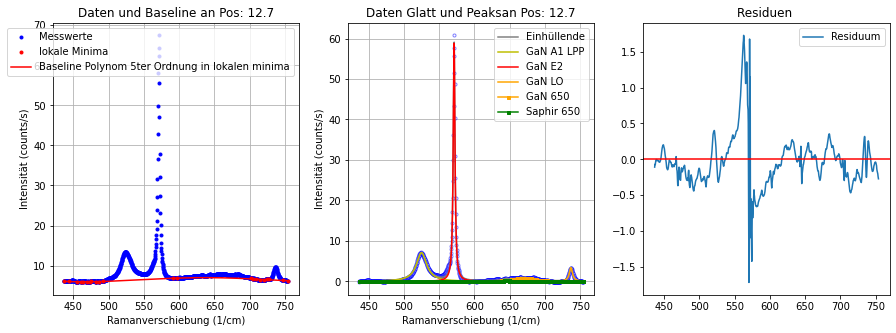

----------------------------------------------------------------------------------------------------
Position: 12.8
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [6.08909 6.04378 6.04721 ... 5.89456 5.86857 5.76527]
(1024,)
Hintergrund Parameter:  [ 2.56298094e-12 -6.28227076e-09  5.69288964e-06 -2.27371598e-03
  3.50573749e-01 -1.74899194e-07]
Fitparameter Saphir 418: [3.962568399624912e-09, 0.01139402160345604, 415.000374984347]
Fitparameter GaN A1 LPP 531: [6.711353906589489, 17.31870741048447, 524.977293269147]
Fitparameter GaN E2 568: [56.47483330812654, 2.938437798441375, 571.1349327834505]
Fitparameter Saphir 650: [1.2459437788296819, 0.011762510608100855, 649.9385463491863]
Fitparameter GaN 650: [1.0616162633539747, 47.025757709666564, 667.7556226057062]
Fitparameter GaN LO 741: [3.3174266286625373, 5.320005651965173, 736.8279310289365]


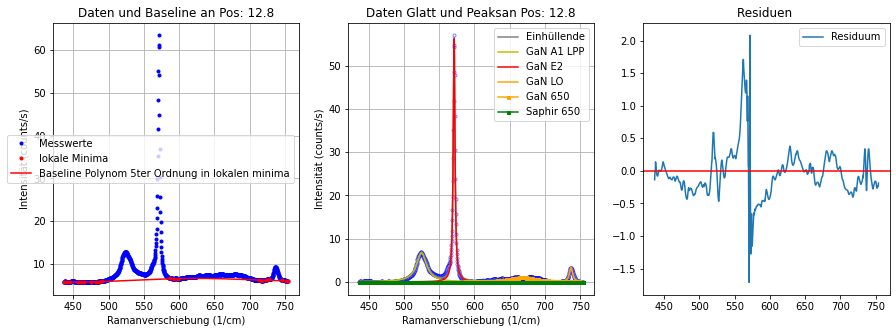

----------------------------------------------------------------------------------------------------
Position: 12.9
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [5.92716 5.90882 5.90322 ... 5.83852 5.83181 5.81063]
(1024,)
Hintergrund Parameter:  [ 1.99847797e-12 -4.87819175e-09  4.39313405e-06 -1.74412503e-03
  2.70536712e-01 -2.43912492e-07]
Fitparameter Saphir 418: [0.0002177461661075613, 0.11118828251242979, 429.9999347379335]
Fitparameter GaN A1 LPP 531: [6.524843582605788, 16.868256825582574, 524.8907228187658]
Fitparameter GaN E2 568: [55.82609640633243, 2.9512396304034936, 571.136775538301]
Fitparameter Saphir 650: [0.23050778145122613, 9.999999999999998, 645.0000000000001]
Fitparameter GaN 650: [1.030160128647743, 40.48963956157308, 669.9999999999999]
Fitparameter GaN LO 741: [3.23360863692202, 5.871167654155487, 736.7026577448978]


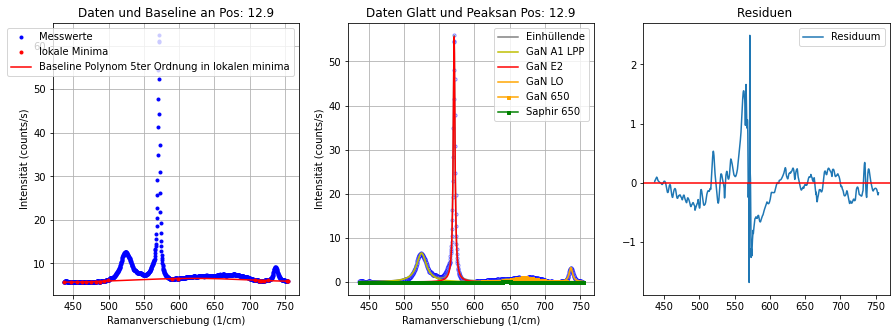

----------------------------------------------------------------------------------------------------
Position: 13.0
x-Daten: [753.87000926 753.57007926 753.27161926 ... 437.33200926 437.01071926
 436.68942926]
(1024,)
y-Daten: [5.61351 5.60892 5.61006 ... 5.61686 5.5791  5.51583]
(1024,)
Hintergrund Parameter:  [ 2.69833924e-12 -6.55469366e-09  5.89060790e-06 -2.33395568e-03
  3.55966920e-01 -5.78563700e-08]
Fitparameter Saphir 418: [5.903108416974789e-28, 0.04395620608103279, 423.5370314957392]
Fitparameter GaN A1 LPP 531: [5.974956878431241, 16.459662613301436, 524.8446837392722]
Fitparameter GaN E2 568: [49.97313137587243, 2.9579256811282284, 571.1396985925162]
Fitparameter Saphir 650: [0.21858749512883913, 9.999999999976291, 645.000015698483]
Fitparameter GaN 650: [0.9754201609970953, 41.076639055315034, 669.9999999999999]
Fitparameter GaN LO 741: [3.0223139866659214, 5.64721332450536, 736.7597006386686]
BILD an Pos:  13.0


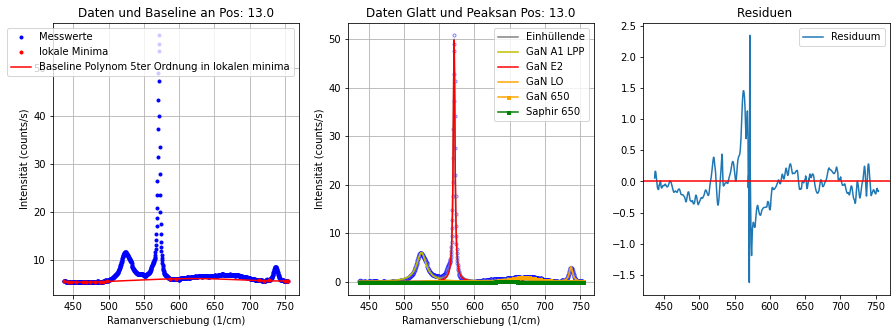

----------------------------------------------------------------------------------------------------


In [147]:
# alle Einzelmessungen mit 5-Polynom baseline aus lokalen min auswerten --> peaks fitten

#Listen für weitere Auswertung
GaN_A1_Peaks_Liste=[]
GaN_E2_Peaks_Liste=[]
GaN_LO_Peaks_Liste=[]
Saphir_418_Peaks_Liste=[]
Saphir_571_Peaks_Liste=[]
Saphir_650_Peaks_Liste=[]
GaN_650_Peaks_Liste=[]
Baseline_Liste=[]

#Schleife für fitten peaks und Baselinekorrektur
for i in range(data_GaN_632nm_array_float.shape[0]):
    if i==0: pass
    else:
        # Punkt/Position der messung
        position = data_GaN_632nm_array_float[i][0]
        print("Position:", position) 
        
        #daten zum Plotten kreieren, lösen der nutzlosen/störenden Positionswerte für Plot
        x=np.delete(data_GaN_632nm_array_float[0],[0])
        y=np.delete(data_GaN_632nm_array_float[i],[0])
        print("x-Daten:", x)
        print(x.shape)
        print("y-Daten:", y)
        print(y.shape)
        
        # lokale minima für baseline alle paar messpunkte entnehmen, problembereich entfernen
        yzw=y[argrelextrema(y, np.less,order=4)[0]]
        xzw=x[argrelextrema(y, np.less,order=4)[0]]
        #print(yzw)
        #print(xzw)
        
        
        #minima an problematischen stellen nicht mitnehmen
        xmin=[]
        ymin=[]
        xmin2=[]
        ymin2=[]
        xmin.append(x[0])
        ymin.append(y[0]) 
        
        for k in range(len(xzw)):
            if xzw[k]<=600 or xzw[k]>=700:
                xmin2.append(xzw[k])
                ymin2.append(yzw[k])
        for j in range(len(xmin2)):
            if xmin2[j]<=500 or xmin2[j]>=580:
                xmin.append(xmin2[j])
                ymin.append(ymin2[j])
        xmin.append(x[len(x)-1])
        ymin.append(y[len(y)-1])        
        #print("xmin:", xmin)
        #print("ymin:",ymin)
        
        
        # Hintergrund mit Baseline Funktion aus lokalen Minima erstellen und als liste Speichern zu den jeweiligen x Werten
        init_vals_base = [0.1, 0.1, 0.1, 0.1, 0.8, -66]
        param_bounds_base = ([-np.inf,-np.inf,-np.inf,-np.inf,0,-np.inf],[np.inf,np.inf,np.inf,np.inf,1,0])
        fitParams_base, cov_base = curve_fit(f=Polynom_5_Grad, xdata=xmin, ydata=ymin, p0=init_vals_base, bounds=param_bounds_base)
        ybase=Polynom_5_Grad(x, fitParams_base[0], fitParams_base[1], fitParams_base[2], fitParams_base[3], fitParams_base[4], fitParams_base[5])
        print("Hintergrund Parameter: ", fitParams_base)
        
        # Hintergrund von Messdaten entfernen --> glatt
        y_glatt=y-ybase
        #print(y)
        #print(ybase)
        #print(y_glatt)
        
        #fitten 4 lorentz in 1_ A1 LPP 534, 2_ E2 576, 3_Saphir 571, 4_ LO 744
        #L_x4(x,A1,D1,W1, A2,D2,W2, A3,D3,W3)
        #init_vals_L_x4 = [9,17,534, 200,3,573, 50,5,569, 5,5,744]
        #param_bounds_L_x4= ([0,0,520, 0,0,565, 0,0,561, 0,0,730],[2000,20,540, 2000,5,576, 200,10,571, 2000,10,750])
        #fitParams_L_x4, cov_L_x4 = curve_fit(f=L_x4, xdata=x, ydata=y_glatt, p0=init_vals_L_x4, bounds=param_bounds_L_x4)
        #fitParams_L_GaN_A1=[fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2]]
        #fitParams_L_GaN_E2=[fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5]]
        #fitParams_L_Saphir_571=[fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8]]
        #fitParams_L_GaN_LO=[fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]]
        #print("Fitparameter GaN A1 LPP 534:",fitParams_L_GaN_A1)
        #print("Fitparameter GaN E2 571:",fitParams_L_GaN_E2)
        #print("Fitparameter GaN LO 744:",fitParams_L_GaN_LO)
        #print("Fitparameter Saphir 571:",fitParams_L_Saphir_571)
        
        #fitten 3 lorentz in 1_ A1 LPP 534, 2_ E2 576, 4_ LO 744
        #L_x3(x,A1,D1,W1, A2,D2,W2, A3,D3,W3)
        #init_vals_L_x3 = [9,17,534, 200,3,573, 5,5,744]
        #param_bounds_L_x3= ([0,0,520, 0,0,561, 0,0,730],[2000,20,540, 2000,5,576, 2000,10,750])
        #fitParams_L_x3, cov_L_x3 = curve_fit(f=L_x3, xdata=x, ydata=y_glatt, p0=init_vals_L_x3, bounds=param_bounds_L_x3)
        #fitParams_L_GaN_A1=[fitParams_L_x3[0],fitParams_L_x3[1],fitParams_L_x3[2]]
        #fitParams_L_GaN_E2=[fitParams_L_x3[3],fitParams_L_x3[4],fitParams_L_x3[5]]
        #fitParams_L_GaN_LO=[fitParams_L_x3[6],fitParams_L_x3[7],fitParams_L_x3[8]]
        #print("Fitparameter GaN A1 LPP 534:",fitParams_L_GaN_A1)
        #print("Fitparameter GaN E2 571:",fitParams_L_GaN_E2)
        #print("Fitparameter GaN LO 744:",fitParams_L_GaN_LO)

        #fitten 6 lorentz in Saphir 418, GaN A1 LPP 531, GaN_ E2 568, Saphir schmal 650, GaN 650 breit ,GaN LO 741
        #L_x6(x,A1,D1,W1, A2,D2,W2, A3,D3,W3, A4,D4,W4, A5,D5,W5, A6,D6,W6):
        # 6 Lorentzpeaks
        #return Lorentz(x,A1,D1,W1) + Lorentz(x,A2,D2,W2) + Lorentz(x,A3,D3,W3) + Lorentz(x,A4,D4,W4) + Lorentz(x,A5,D5,W5) + Lorentz(x,A6,D6,W6)
        init_vals_L_x6 = [1,1,426, 9,17,531, 115,3,568, 10,0.1,650, 1,20,650, 5,5,741]
        param_bounds_L_x6= ([0,0,415, 0,0,520, 0,0,562, 0,0,645, 0,10,640, 0,0,730],
                            [np.inf,20,430, 2000,30,540, 2000,30,575, 2000,10,660, 2000,100,670, 2000,30,750])
        fitParams_L_x6, cov_L_x6 = curve_fit(f=L_x6, xdata=x, ydata=y_glatt, p0=init_vals_L_x6, bounds=param_bounds_L_x6)
        fitParams_L_Saphir_418=[fitParams_L_x6[0],fitParams_L_x6[1],fitParams_L_x6[2]]
        fitParams_L_GaN_A1=[fitParams_L_x6[3],fitParams_L_x6[4],fitParams_L_x6[5]]
        fitParams_L_GaN_E2=[fitParams_L_x6[6],fitParams_L_x6[7],fitParams_L_x6[8]]
        fitParams_L_Saphir_650=[fitParams_L_x6[9],fitParams_L_x6[10],fitParams_L_x6[11]]
        fitParams_L_GaN_650=[fitParams_L_x6[12],fitParams_L_x6[13],fitParams_L_x6[14]]
        fitParams_L_GaN_LO=[fitParams_L_x6[15],fitParams_L_x6[16],fitParams_L_x6[17]]
        print("Fitparameter Saphir 418:",fitParams_L_Saphir_418)
        print("Fitparameter GaN A1 LPP 531:",fitParams_L_GaN_A1)
        print("Fitparameter GaN E2 568:",fitParams_L_GaN_E2)
        print("Fitparameter Saphir 650:",fitParams_L_Saphir_650)
        print("Fitparameter GaN 650:",fitParams_L_GaN_650)
        print("Fitparameter GaN LO 741:",fitParams_L_GaN_LO)
        
        #fitten Saphir 418
        #def Lorentz(x,a,d,w):
        #init_vals_Saphir_418 = [1,1,426]
        #param_bounds_Saphir_418 = ([0,0,410],[np.inf,5,430])
        #fitParams_Saphir_418, cov_Saphir_418 = curve_fit(f=Lorentz, xdata=x, ydata=y_glatt, p0=init_vals_Saphir_418, bounds=param_bounds_Saphir_418)
        #print("Fitparameter Saphir 418:",fitParams_Saphir_418)
        

        #plot 
        fig = plt.figure(figsize=(15,5))
            # Plot 1 für Daten roh und baseline
        plt.subplot(1, 3, 1) 
        plt.title('Daten und Baseline an Pos: '+str(position))
        plt.plot(x,y,'o', color='b'  ,markersize=3, label='Messwerte') #, markerfacecolor='w', alpha=0.5
        plt.plot(xmin,ymin,'o', color='r'  ,markersize=3, label='lokale Minima') #, markerfacecolor='w', alpha=0.5
        plt.plot(x, ybase,'r', label='Baseline Polynom 5ter Ordnung in lokalen minima') 
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend()
            # Plot für Daten glatt und peaks        
        plt.subplot(1, 3, 2)
        plt.title('Daten Glatt und Peaksan Pos: '+str(position) )
        plt.plot(x,y_glatt,'o', color='b'  ,markersize=3, markerfacecolor='w', alpha=0.5) #
        #plt.plot(x,L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2], fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8], fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), color='gray'  ,markersize=2, label='Einhüllende')
        #plt.plot(x,L_x3(x, fitParams_L_x3[0],fitParams_L_x3[1],fitParams_L_x3[2], fitParams_L_x3[3],fitParams_L_x3[4],fitParams_L_x3[5],fitParams_L_x3[6],fitParams_L_x3[7],fitParams_L_x3[8]), color='gray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,L_x6(x, fitParams_L_x6[0],fitParams_L_x6[1],fitParams_L_x6[2],fitParams_L_x6[3],fitParams_L_x6[4],fitParams_L_x6[5],fitParams_L_x6[6],fitParams_L_x6[7],fitParams_L_x6[8],fitParams_L_x6[9],fitParams_L_x6[10],fitParams_L_x6[11],fitParams_L_x6[12],fitParams_L_x6[13],fitParams_L_x6[14],fitParams_L_x6[15],fitParams_L_x6[16],fitParams_L_x6[17]), color='gray'  ,markersize=2, label='Einhüllende')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_A1[0],fitParams_L_GaN_A1[1],fitParams_L_GaN_A1[2]), color='y'  ,markersize=3, label='GaN A1 LPP')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_E2[0],fitParams_L_GaN_E2[1],fitParams_L_GaN_E2[2]), color='r'  ,markersize=3, label='GaN E2')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_LO[0],fitParams_L_GaN_LO[1],fitParams_L_GaN_LO[2]), color='orange'  ,markersize=3, label='GaN LO')
        #plt.plot(x,Lorentz(x, fitParams_Saphir_418[0],fitParams_Saphir_418[1],fitParams_Saphir_418[2]), color='g'  ,markersize=3, label='Saphir 418 cmE-1')
        #plt.plot(x,Lorentz(x, fitParams_L_Saphir_571[0],fitParams_L_Saphir_571[1],fitParams_L_Saphir_571[2]), '--', color='g'  ,markersize=3, label='Saphir 571')
        plt.plot(x,Lorentz(x, fitParams_L_GaN_650[0],fitParams_L_GaN_650[1],fitParams_L_GaN_650[2]),'-s', color='orange'  ,markersize=3, label='GaN 650')
        plt.plot(x,Lorentz(x, fitParams_L_Saphir_650[0],fitParams_L_Saphir_650[1],fitParams_L_Saphir_650[2]),'-s', color='g'  ,markersize=3, label='Saphir 650')
        
       
        plt.xlabel('Ramanverschiebung (1/cm)')
        plt.ylabel('Intensität (counts/s)')
        plt.grid(True)
        plt.legend()
            # Plot Residuen Fitt
        plt.subplot(1, 3, 3)
        plt.title('Residuen ')
       
        #plt.plot(x,y_glatt- L_x3(x, fitParams_L_x3[0],fitParams_L_x3[1],fitParams_L_x3[2], fitParams_L_x3[3],fitParams_L_x3[4],fitParams_L_x3[5],fitParams_L_x3[6],fitParams_L_x3[7],fitParams_L_x3[8]), label=("a-plane Residuum"))
        #plt.plot(x,y_glatt-L_x4(x, fitParams_L_x4[0],fitParams_L_x4[1],fitParams_L_x4[2], fitParams_L_x4[3],fitParams_L_x4[4],fitParams_L_x4[5],fitParams_L_x4[6],fitParams_L_x4[7],fitParams_L_x4[8], fitParams_L_x4[9],fitParams_L_x4[10],fitParams_L_x4[11]), label=("a-plane Residuum"))
        #plt.plot(x,y_glatt-L_x2(x, fitParams_L_x2[0],fitParams_L_x2[1],fitParams_L_x2[2], fitParams_L_x2[3],fitParams_L_x2[4],fitParams_L_x2[5]), label=("a-plane Residuum"))
        plt.plot(x,y_glatt-L_x6(x, fitParams_L_x6[0],fitParams_L_x6[1],fitParams_L_x6[2],fitParams_L_x6[3],fitParams_L_x6[4],fitParams_L_x6[5],fitParams_L_x6[6],fitParams_L_x6[7],fitParams_L_x6[8],fitParams_L_x6[9],fitParams_L_x6[10],fitParams_L_x6[11],fitParams_L_x6[12],fitParams_L_x6[13],fitParams_L_x6[14],fitParams_L_x6[15],fitParams_L_x6[16],fitParams_L_x6[17]), label=("Residuum"))
        plt.axhline(y = 0, color = 'r', linestyle = '-')
        #plt.grid(True)
        plt.legend()
        
        if i == data_GaN_632nm_array_float.shape[0]/2-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/Ge Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == 2:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/Ge Auswertung D0 632nm Position '+ str(position) + '.png')
        if i == data_GaN_632nm_array_float.shape[0]-1:
            print("BILD an Pos: ", position)
            plt.savefig('Bilder_Graphen_632nm/Ge Auswertung D0 632nm Position '+ str(position) + '.png')
    
        plt.show()
     
        #speichern der Peakdaten
        GaN_A1_Peaks_Liste.append([position, fitParams_L_GaN_A1])
        GaN_E2_Peaks_Liste.append([position, fitParams_L_GaN_E2])
        GaN_LO_Peaks_Liste.append([position, fitParams_L_GaN_LO])
        #Saphir_418_Peaks_Liste.append([position, fitParams_Saphir_418])
        #Saphir_571_Peaks_Liste.append([position, fitParams_L_Saphir_571])
        Saphir_650_Peaks_Liste.append([position, fitParams_L_Saphir_650])
        GaN_650_Peaks_Liste.append([position, fitParams_L_GaN_650])
        Baseline_Liste.append([position,fitParams_base])
        print("----------------------------------------------------------------------------------------------------")
        
#fig.savefig('Beispiel Auswertung, Intensität nach Ramanverschiebung mit Peaks')

#print(InN_E2_Peaks_Liste)

In [148]:
# Verhalten Asymmetrischer Gauß und Baseline

#print("Baseline:")
#Positionen=[]
#Base_Para_1=[]
#Base_Para_2=[]
#Base_Para_3=[]
#Base_Para_4=[]
#Base_Para_5=[]
#Base_Para_6=[]
##for k in range(len(Baseline_Liste)):
#    Positionen.append(Baseline_Liste[k][0])
#    Base_Para_1.append(Baseline_Liste[k][1][0])
#    Base_Para_2.append(Baseline_Liste[k][1][1])
#    Base_Para_3.append(Baseline_Liste[k][1][2])
#    Base_Para_4.append(Baseline_Liste[k][1][3])
#    Base_Para_5.append(Baseline_Liste[k][1][4])
#    Base_Para_6.append(Baseline_Liste[k][1][5])

#Plotten
#plt.title('Baseline Parameter 1 nach Positionen')
#plt.plot(Positionen, Base_Para_1 ,markersize=2, label='Parameter 1') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 2 nach Positionen')
#plt.plot(Positionen, Base_Para_2 ,markersize=2, label='Parameter 2') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 3 nach Positionen')
#plt.plot(Positionen, Base_Para_3 ,markersize=2, label='Parameter 3') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 4 nach Positionen')
#plt.plot(Positionen, Base_Para_4 ,markersize=2, label='Parameter 4') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 5 nach Positionen')
#plt.plot(Positionen, Base_Para_5 ,markersize=2, label='Parameter 5') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

#plt.title('Baseline Parameter 6 nach Positionen')
#plt.plot(Positionen, Base_Para_6 ,markersize=2, label='Parameter 6') 
#plt.xlabel('Position')
#plt.ylabel('Parameter')
#plt.grid(True)
#plt.legend()
#plt.show()

Asym Gauß E2 Parameter Amp-R: [434.21509701   1.6643644    7.76564711   1.16063023  55.74265088]
Asym Gauß LO Parameter Amp-R: [45.52077255  1.22171028  8.8723113  -0.86028075  5.37685069]
Asym Gauß A1 Parameter Amp-R: [46.26776332  1.23642654  8.97771949  0.60028752  6.68873348]
Gauß E2 Parameter Amp-R: [678.78835954  -3.4662865    8.6958416  -57.15407081]
Gauß LO Parameter Amp-R: [63.50254033 -2.50536788  8.26599905 -2.08855174]
Gauß A1 Parameter Amp-R: [64.09405821  3.06012216  9.47253956 -5.29988812]


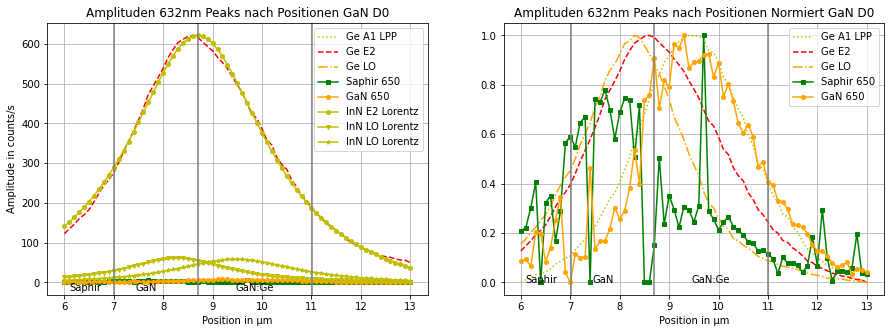

In [149]:
# Amplituden nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
GaN_A1_Amp=[]
GaN_E2_Amp=[]
GaN_LO_Amp=[]
#Peak_Saphir_418_Amp=[]
Peak_Saphir_571_Amp=[]
Peak_Saphir_650_Amp=[]
GaN_650_Amp=[]
for i in range(len(GaN_A1_Peaks_Liste)):
    Positionen.append(GaN_A1_Peaks_Liste[i][0])
    GaN_A1_Amp.append(GaN_A1_Peaks_Liste[i][1][0])
    #print("test: ",Ge_A1_Peaks_Liste)
    GaN_E2_Amp.append(GaN_E2_Peaks_Liste[i][1][0])
    GaN_LO_Amp.append(GaN_LO_Peaks_Liste[i][1][0])
    #Peak_Saphir_418_Amp.append(Saphir_418_Peaks_Liste[i][1][0])
    #Peak_Saphir_571_Amp.append(Saphir_571_Peaks_Liste[i][1][0])
    Peak_Saphir_650_Amp.append(Saphir_650_Peaks_Liste[i][1][0])
    GaN_650_Amp.append(GaN_650_Peaks_Liste[i][1][0])
    
    
    
    
#Fitten Gauß in Amplitudenverlauf für Tiefenauflösung durch FWHM
#asymmgauss(x,amp,fwhm, pos, shape):
#scew normal distribution
#normpdf = amp * np.exp(-(np.power((x-pos),2)  /  (2 * np.power(fwhm,2))))
#normcdf = 0.5 * (1+sp.erf(shape*((x-pos)/fwhm)/np.sqrt(2)))
#return 2*normpdf*normcdf

init_vals_AG_E2 = [1,1,8.5,0,90]
param_bounds_AG_E2= ([-np.inf,-np.inf,-np.inf,-np.inf,0],[np.inf,np.inf,np.inf,np.inf,100])
fitParams_AG_E2, cov_AG_E2 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata=  GaN_E2_Amp, p0=init_vals_AG_E2, bounds=param_bounds_AG_E2)
print("Asym Gauß E2 Parameter Amp-R:",fitParams_AG_E2) 

init_vals_AG_LO = [1,1,8.5,0,1]
param_bounds_AG_LO= ([-np.inf,-np.inf,-np.inf,-np.inf,0],[np.inf,np.inf,np.inf,np.inf,100])
fitParams_AG_LO, cov_AG_LO = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= GaN_LO_Amp, p0=init_vals_AG_LO, bounds=param_bounds_AG_LO)
print("Asym Gauß LO Parameter Amp-R:",fitParams_AG_LO) 

init_vals_AG_A1 = [1,1,9,0,1]
param_bounds_AG_A1= ([-np.inf,-np.inf,-np.inf,-np.inf,0],[np.inf,np.inf,np.inf,np.inf,100])
fitParams_AG_A1, cov_AG_A1 = curve_fit(f=asymmgauss_und_Konstante, xdata=Positionen, ydata= GaN_A1_Amp, p0=init_vals_AG_A1, bounds=param_bounds_AG_A1)
print("Asym Gauß A1 Parameter Amp-R:",fitParams_AG_A1) 
    
    
#Fitten Lorentz in Amplitudenverlauf für Tiefenauflösung durch FWHM
#Lorentz_und_Konstante(x,a,d,w,h):
# a Amplitude, d Halbwärtsbreite, w mittelpunkt , x variable, h höhe
# y = a/(1+ ((x-w) / (d/2) )**2)
#    return  a/(1+ ((x-w) / (d/2) )**2) + h
    
init_vals_G_E2 = [1,1,9,2]
param_bounds_G_E2= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_E2, cov_G_E2 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= GaN_E2_Amp, p0=init_vals_G_E2, bounds=param_bounds_G_E2)
print("Gauß E2 Parameter Amp-R:",fitParams_G_E2) 
    
init_vals_G_LO = [1,1,9,2]
param_bounds_G_LO= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_LO, cov_G_LO = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= GaN_LO_Amp, p0=init_vals_G_LO, bounds=param_bounds_G_LO)
print("Gauß LO Parameter Amp-R:",fitParams_G_LO) 
    
init_vals_G_A1 = [1,1,9,5]
param_bounds_G_A1= ([-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,np.inf])
fitParams_G_A1, cov_G_A1 = curve_fit(f=Lorentz_und_Konstante, xdata=Positionen, ydata= GaN_A1_Amp, p0=init_vals_G_A1, bounds=param_bounds_G_A1)
print("Gauß A1 Parameter Amp-R:",fitParams_G_A1) 


#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Amplituden 632nm Peaks nach Positionen GaN D0')
plt.plot(Positionen, GaN_A1_Amp, ':', color='y'  ,markersize=3, label='Ge A1 LPP') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_E2_Amp, '--', color='r'  ,markersize=3, label='Ge E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_LO_Amp, '-.', color='orange'  ,markersize=3, label='Ge LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Verhältnis_InN_LO_E2_Amp, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_418_Amp,'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_571_Amp,'--', color='g'  ,markersize=2, label='Saphir 571 ') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_650_Amp,'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_650_Amp, '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_E2[0],fitParams_AG_E2[1],fitParams_AG_E2[2],fitParams_AG_E2[3],fitParams_AG_E2[4]),'-o', color='r'  ,markersize=2, label='GaN E2 Fitt')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_LO[0],fitParams_AG_LO[1],fitParams_AG_LO[2],fitParams_AG_LO[3],fitParams_AG_LO[4]),'-s', color='orange'  ,markersize=2, label='GaN LO Fitt')
#plt.plot(Positionen, asymmgauss_und_Konstante(Positionen,fitParams_AG_A1[0],fitParams_AG_A1[1],fitParams_AG_A1[2],fitParams_AG_A1[3],fitParams_AG_A1[4]),'-s', color='y'  ,markersize=2, label='GaN A1 Fitt')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_E2[0],fitParams_G_E2[1],fitParams_G_E2[2],fitParams_G_E2[3]),'-o', color='y'  ,markersize=4, label='InN E2 Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_LO[0],fitParams_G_LO[1],fitParams_G_LO[2],fitParams_G_LO[3]),'-v', color='y'  ,markersize=4, label='InN LO Lorentz')
plt.plot(Positionen, Lorentz_und_Konstante(Positionen,fitParams_G_A1[0],fitParams_G_A1[1],fitParams_G_A1[2],fitParams_G_A1[3]),'-*', color='y'  ,markersize=4, label='InN LO Lorentz')

plt.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=-20,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=-20,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-20,s='Saphir')

plt.xlabel('Position in \u03bcm')
plt.ylabel('Amplitude in counts/s')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Amplituden 632nm Peaks nach Positionen Normiert GaN D0')
plt.plot(Positionen, NormalizeData(GaN_A1_Amp), ':', color='y'  ,markersize=3, label='Ge A1 LPP') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_E2_Amp), '--', color='r'  ,markersize=3, label='Ge E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_LO_Amp), '-.', color='orange'  ,markersize=3, label='Ge LO') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp), color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_Amp),'-.', color='g'  ,markersize=2, label='Saphir 418 Mode') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_571_Amp),'--', color='g'  ,markersize=2, label='Saphir 571') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen,  NormalizeData(Peak_Saphir_650_Amp),'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen,  NormalizeData(GaN_650_Amp), '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=0,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=0,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=0,s='Saphir')
 
plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_632nm/GaN Amplituden Peaks nach Positionen D0 632nm')
plt.show()



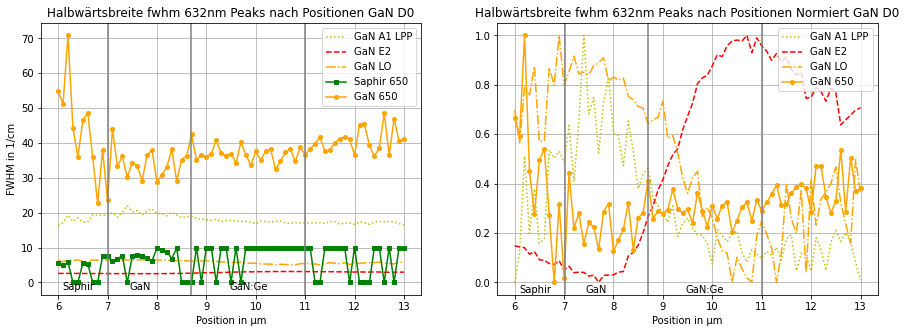

In [150]:
# Halbwärtsbreiten fwhm nach Positionen
 
#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
Positionen=[]
GaN_A1_fwhm=[]
GaN_E2_fwhm=[]
GaN_LO_fwhm=[]
#Peak_Saphir_418_fwhm=[]
#Peak_Saphir_571_fwhm=[] 
Peak_Saphir_650_fwhm=[]
GaN_650_fwhm=[]
for i in range(len(GaN_A1_Peaks_Liste)):
    Positionen.append(GaN_A1_Peaks_Liste[i][0])
    GaN_A1_fwhm.append(GaN_A1_Peaks_Liste[i][1][1])
    GaN_E2_fwhm.append(GaN_E2_Peaks_Liste[i][1][1])
    GaN_LO_fwhm.append(GaN_LO_Peaks_Liste[i][1][1])
    #Peak_Saphir_418_fwhm.append(Saphir_418_Peaks_Liste[i][1][1])
    #Peak_Saphir_571_fwhm.append(Saphir_571_Peaks_Liste[i][1][1])
    Peak_Saphir_650_fwhm.append(Saphir_650_Peaks_Liste[i][1][1])
    GaN_650_fwhm.append(GaN_650_Peaks_Liste[i][1][1])
    
#Plotten
fig = plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1) 
plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen GaN D0')
plt.plot(Positionen, GaN_A1_fwhm, ':', color='y'  ,markersize=3, label='GaN A1 LPP') # 534 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_E2_fwhm, '--', color='r'  ,markersize=3, label='GaN E2') # 571 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_LO_fwhm, '-.', color='orange'  ,markersize=3, label='GaN LO') #744 cmE-1, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_418_fwhm,'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Peak_Saphir_571_fwhm,'--', color='g'  ,markersize=2, label='Saphir 571') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, Peak_Saphir_650_fwhm,'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, GaN_650_fwhm, '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5
        
plt.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=-2,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=-2,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-2,s='Saphir')

plt.xlabel('Position in \u03bcm')
plt.ylabel('FWHM in 1/cm')
plt.grid(True)
plt.legend(loc='upper right')


plt.subplot(1, 2, 2) 
plt.title('Halbwärtsbreite fwhm 632nm Peaks nach Positionen Normiert GaN D0')
plt.plot(Positionen, NormalizeData(GaN_A1_fwhm), ':', color='y'  ,markersize=3, label='GaN A1 LPP') # 534 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_E2_fwhm), '--', color='r'  ,markersize=3, label='GaN E2') #571 cmE-1, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_LO_fwhm), '-.', color='orange'  ,markersize=3, label='GaN LO') # 744 cmE-1, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_Amp), color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_418_fwhm),'-.', color='g'  ,markersize=2, label='Saphir 418') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Peak_Saphir_571_fwhm),'--', color='g'  ,markersize=2, label='Saphir 571') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen,  NormalizeData(Peak_Saphir_650_fwhm),'-s', color='g'  ,markersize=4, label='Saphir 650') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen,  NormalizeData(GaN_650_fwhm), '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

plt.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=-0.04,s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=-0.04,s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-0.04,s='Saphir')

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Amplitude')
plt.grid(True)
plt.legend(loc='upper right')

plt.savefig('Bilder_Graphen_632nm/GaN Halbwärtsbreite fwhm Peaks nach Positionen D0 632nm')
plt.show()

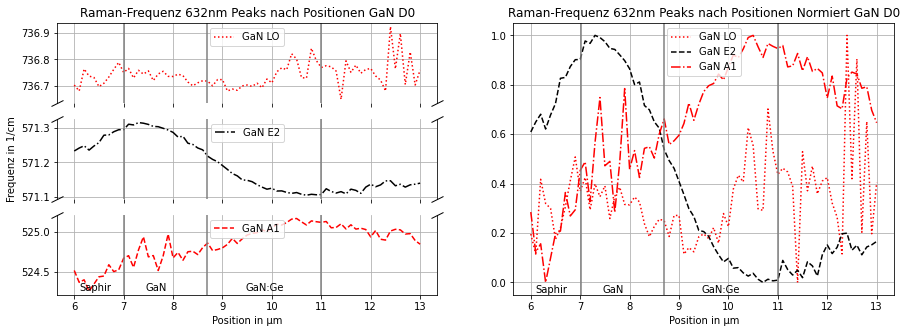

In [151]:
#Raman-Frequenz Peaks nach Positionen

#Daten Vorbereiten --> vereinfachbar durch geänderte speicherung bei Einzelmessungen --> noch verbessern
 
Positionen=[]
GaN_A1_w=[]
GaN_E2_w=[]
GaN_LO_w=[]
#Peak_Saphir_418_w=[]
#Peak_Saphir_571_w=[] 
Peak_Saphir_650_w=[]
GaN_650_w=[]

for i in range(len(GaN_A1_Peaks_Liste)):
    Positionen.append(GaN_A1_Peaks_Liste[i][0])
    GaN_A1_w.append(GaN_A1_Peaks_Liste[i][1][2])
    GaN_E2_w.append(GaN_E2_Peaks_Liste[i][1][2])
    GaN_LO_w.append(GaN_LO_Peaks_Liste[i][1][2])
    #Peak_Saphir_418_w.append(Saphir_418_Peaks_Liste[i][1][2])
    #Peak_Saphir_571_w.append(Saphir_571_Peaks_Liste[i][1][2])
    Peak_Saphir_650_w.append(Saphir_650_Peaks_Liste[i][1][2])
    GaN_650_w.append(GaN_650_Peaks_Liste[i][1][2])

   
# Plotten mit achsenunterbrechung 
fig = plt.figure(figsize=(15,5))

gs0 = gridspec.GridSpec(1, 2, figure=fig) # 2 grundbilder
gs00 = gridspec.GridSpecFromSubplotSpec(3, 3, subplot_spec=gs0[0]) # 3 bilder in bild 1

ax1 = fig.add_subplot(gs00[-3:-2, :])
ax2 = fig.add_subplot(gs00[-2:-1, :])
ax3 = fig.add_subplot(gs00[-1:, :])
ax1.plot(Positionen, GaN_LO_w, ':', color='r'  ,markersize=2, label='GaN LO') #, markerfacecolor='w', alpha=0.5
ax2.plot(Positionen, GaN_E2_w,'-.', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
ax3.plot(Positionen, GaN_A1_w, '--', color='r'  ,markersize=2, label='GaN A1') #, markerfacecolor='w', alpha=0.5
ax1.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax1.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax2.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax3.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax3.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=min(GaN_A1_w),s='GaN:Ge')
ax3.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=min(GaN_A1_w),s='GaN')
ax3.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=min(GaN_A1_w),s='Saphir')

# hide the spines between ax and ax2
ax1.spines["bottom"].set_visible(False)
ax2.spines["bottom"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax3.spines["top"].set_visible(False)
d = .5  # proportion of vertical to horizontal extent of the slanted line
kwargs = dict(marker=[(-1, -d), (1, d)], markersize=12,
              linestyle="none", color='k', mec='k', mew=1, clip_on=False)
ax1.plot([0, 1], [0, 0], transform=ax1.transAxes, **kwargs)
ax2.plot([0, 1], [1, 1], transform=ax2.transAxes, **kwargs)
ax2.plot([0, 1], [0, 0], transform=ax2.transAxes, **kwargs)
ax3.plot([0, 1], [1, 1], transform=ax3.transAxes, **kwargs)
ax1.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.tick_params(labelbottom=False)  # don't put tick labels at the bottom
ax2.set_ylabel('Frequenz in 1/cm')
ax3.set_xlabel('Position in \u03bcm')
ax1.legend(loc='upper center')
ax2.legend(loc='upper center')
ax3.legend(loc='upper center')
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
ax1.set_title("Raman-Frequenz 632nm Peaks nach Positionen GaN D0")


# the following syntax does the same as the GridSpecFromSubplotSpec call above:
gs01 = gs0[1].subgridspec(1, 1) # 1 bilder in bild 2

ax4 = fig.add_subplot(gs01[:, :])
plt.plot(Positionen, NormalizeData(GaN_LO_w),':', color='r'  ,markersize=2, label='GaN LO') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_E2_w), '--', color='black'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
plt.plot(Positionen, NormalizeData(GaN_A1_w), '-.', color='r'  ,markersize=2, label='GaN A1') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(Verhältnis_InN_LO_E2_w),':', alpha=0.7, color='b'  ,markersize=2, label='Verhältnis') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, NormalizeData(GaN_650_w), '-o', color='orange'  ,markersize=4, label='GaN 650') #, markerfacecolor='w', alpha=0.5

plt.xlabel('Position in \u03bcm')
#plt.ylabel('Raman-Frequenz')
plt.grid(True)
plt.legend(loc='upper center')
ax4.set_title("Raman-Frequenz 632nm Peaks nach Positionen Normiert GaN D0")
ax4.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
ax4.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
ax4.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=-0.04,s='GaN:Ge')
ax4.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=-0.04,s='GaN')
ax4.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=-0.04,s='Saphir')

plt.savefig('Bilder_Graphen_632nm/GaN Raman-Frequenz Peaks nach Positionen D0 632nm')
plt.show()

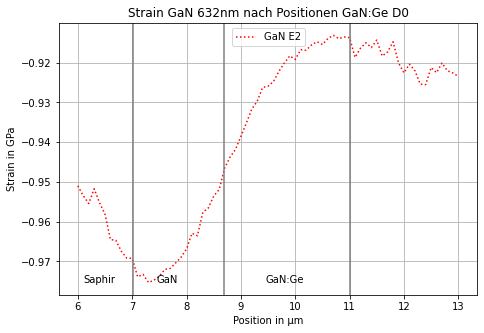

In [152]:
#Aus I. R. Ahmad, N. Faleev_2004_Dependence of the stress-temperature coefficient on dislocation density in epitaxial GaN grown on alpha-Al2O3 and 6H-SiC substrates
w_0_GaN_E2 = 568 # +/- 0.4 1/cm

w_per_P_GaN_E2 = -3.4 # +/- 0.3 1/cm/GPa für E2 high 

#Druck_in_Probe(w_s, w_0, w_per_P):
#aus Quelle I. R. Ahmad, N. Faleev_2004_Dependence of the stress-temperature coefficient on dislocation density in epitaxial GaN grown on alpha-Al2O3 and 6H-SiC substrates
#rückentwickelt aus Formel w_s = w_0 + (\par w / \par P) * P
#return (w_s - w_0) / w_per_P

Strain_GaN_E2_Liste=[]
#Strain_InN_LO_Liste=[]
for i in range(len(GaN_E2_w)):
    Strain_GaN_E2_Liste.append(Druck_in_Probe(GaN_E2_w[i], w_0_GaN_E2, w_per_P_GaN_E2)) # Strain in GPa für InN E2
#    Strain_InN_LO_Liste.append(Druck_in_Probe(Peak_InN_LO_w[i], w_0_InN_LO, w_per_P_InN_LO))
    
#print(Strain_InN_E2_Liste)
#print(Strain_InN_LO_Liste)



fig = plt.figure(figsize=(7.5,5))
plt.title('Strain GaN 632nm nach Positionen GaN:Ge D0')

plt.plot(Positionen, Strain_GaN_E2_Liste, ':', color='r'  ,markersize=2, label='GaN E2') #, markerfacecolor='w', alpha=0.5
#plt.plot(Positionen, Strain_InN_LO_Liste, '--', color='r'  ,markersize=2, label='InN LO') #nicht plotten da für LO auch noch andere Einflüsse die nicht einfach beachtet werden können
plt.axvline(x=fitParams_G_A1[2]+(fitParams_G_A1[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_LO[2]+(fitParams_G_LO[1]/2), ymin=0, ymax=1, color='gray')
plt.axvline(x=fitParams_G_E2[2], ymin=0, ymax=1, color='gray')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_A1[1]/4),y=min(Strain_GaN_E2_Liste),s='GaN:Ge')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_LO[1]/2),y=min(Strain_GaN_E2_Liste),s='GaN')
plt.text(x=fitParams_G_E2[2]+(fitParams_G_E2[1]/2)+(fitParams_G_E2[1]/4),y=min(Strain_GaN_E2_Liste),s='Saphir')
  
plt.xlabel('Position in \u03bcm')
plt.ylabel('Strain in GPa')
plt.grid(True)
plt.legend(loc='upper center')
plt.savefig('Bilder_Graphen_632nm/GaN Strain nach Positionen D0 632nm')
plt.show()